In [1]:
import sys
print(sys.version)

3.6.5 |Anaconda custom (64-bit)| (default, Mar 29 2018, 13:14:23) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]


In [2]:
"""
Created on April 9 2018
@author: Neven Caplar
@contact: ncaplar@princeton.edu

These comments are theoretically the only ones you need to read to run the notebook

1. Specify the directory in which you want to run the analysis below (PSF_DIRECTORY)
2. Name and place the data in DATA_FOLDER. The data is avaliable at https://github.com/nevencaplar/PFS_Work_In_Progress/tree/master/CutsForTigerMay2
3. TESTING_FOLDER will be filled during the run with images from the analysis analysis

4. (OPTIONAL)Next cell contains some extensions that I use that make life much easier when using jupyter notebook 
    Without them this notebook becomes reallllly huge and hard to deal with
    These can be downloaded from https://github.com/ipython-contrib/jupyter_contrib_nbextensions

"""
############################################################
# name your directory where you want to have files!
PSF_DIRECTORY='/Users/nevencaplar/Documents/PFS/'
# place cutouts in this folder - name as you wish
DATA_FOLDER=PSF_DIRECTORY+'TigerAnalysis/CutsForTigerMay2/'
############################################################
    

TESTING_FOLDER=PSF_DIRECTORY+'Testing/'
TESTING_PUPIL_IMAGES_FOLDER=TESTING_FOLDER+'Pupil_Images/'
TESTING_WAVEFRONT_IMAGES_FOLDER=TESTING_FOLDER+'Wavefront_Images/'
TESTING_FINAL_IMAGES_FOLDER=TESTING_FOLDER+'Final_Images/'
import os

for i in [PSF_DIRECTORY,DATA_FOLDER,TESTING_PUPIL_IMAGES_FOLDER,TESTING_WAVEFRONT_IMAGES_FOLDER,TESTING_FINAL_IMAGES_FOLDER]:
    if not os.path.exists(i):
        os.makedirs(i)  

In [3]:
%%javascript
try {
  require(['base/js/utils'], function (utils) {
    utils.load_extension('code_prettify/code_prettify');
    utils.load_extension('collapsible_headings/main'); 
    utils.load_extension('codefolding/edit'); 
    utils.load_extension('codefolding/main'); 
    utils.load_extension('execute_time/ExecuteTime');   
    utils.load_extension('toc2/main'); 
  });
}
catch (err) {
  console.log('toc2 load error:', err);
}

<IPython.core.display.Javascript object>

In [4]:
# make notebook nice and wide to fill the entire screen
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [5]:
%load_ext autoreload
%autoreload 2

#import Zernike_Module
#from Zernike_Module import LNP_PFS,LN_PFS_single,create_parInit,downsample_manual_function,Zernike_Analysis,PFSPupilFactory,custom_fftconvolve,stepK,maxK,sky_scale,sky_size,create_x,remove_pupil_parameters_from_all_parameters

#Zernike_Module_lastOct15_beforeScatterChange
import Zernike_Module
from Zernike_Module import *

In [6]:
#general import statments
from __future__ import absolute_import, division, print_function
import galsim
import numpy as np
np.set_printoptions(suppress=True)
np.seterr(divide='ignore', invalid='ignore')
import pandas as pd
import io
import math
import pickle

#tqdm is not necesarry, it is the monitor evaluation of the 'for' loops
from tqdm import tqdm

# lsst stack
#import lsst.afw
#from lsst.afw.cameraGeom import PupilFactory
#from lsst.afw.geom import Angle, degrees
#from lsst.afw import geom
#from lsst.afw.geom import Point2D

# astropy
import astropy
import astropy.convolution
from astropy.convolution import Gaussian2DKernel

# scipy and skimage
#from scipy.ndimage import gaussian_filter
import scipy.misc
import skimage.transform

#lmfit
import lmfit

#matplotlib
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
matplotlib.rcParams.update({'font.size': 18})
%config InlineBackend.rc = {}
%matplotlib inline
%config IPython.matplotlib.backend = "retina"

from shutil import copy
from scipy.optimize import curve_fit

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c

## unit test

In [9]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

sci_image_unit=np.ones((50,50))
var_image_unit=np.ones((50,50))
#array([     0.85110826,      0.73047372,     -0.31672873,     -0.00539844, -0.32264156,     -0.04922217,     -0.49565709,      0.18057418,
#            0.79993531,      0.10032969,      0.08769052,      0.25372595,          0.06064503,      0.21049747,   
#           0.45840763,      2.05047984,  0.30893478,     -0.13166649, 
#           -0.06752367,     -0.13093007,            0.89197452, 
#           0.10757197,   0.60969064,      1.06409559,   0.14192374, 
#           109336.61223169,   2.41053199,      0.00379578,
#            0.4673993 ,      1.88555321,      0.99733826])
allparameters_proposal=np.array([24,0.09,0.02,-0.1,0.0,0.1,0.02,0.2,
                                 0.7,0.1,0.3,0.0,0.07,0.0,
                                 0.17,0.67,1,1,
                                 0.0,-0.0,0.80,
                                 0.01,0.51,1.06,0.28,
                                 50000,2.5,0.027,
                                 0.37,1.85,1.0])
print('version of the code is: '+str(Zernike_Module.__version__))
model = LN_PFS_single(sci_image_unit,var_image_unit,dithering=1,save=1)   

res=model(allparameters_proposal,return_Image=True)
print(res[0])
#assert res=-4808.04
#print('ok')

version of the code is: 0.21c
extraZernike: None
zmax: 11
31
-3291.813787780913


In [10]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')

optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')



res_iapetus=res[1]

In [11]:
res_iapetus051=res_iapetus

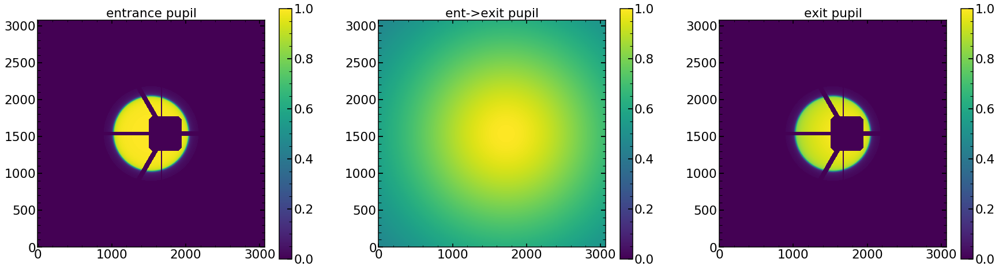

In [12]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

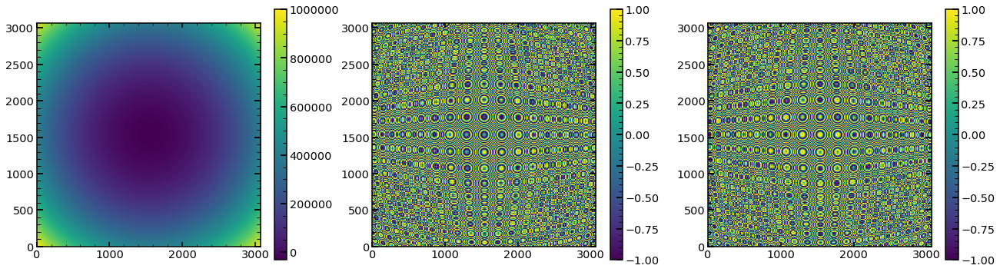

In [13]:
matplotlib.rcParams.update({'font.size': 12})

plt.figure(figsize=(30,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()


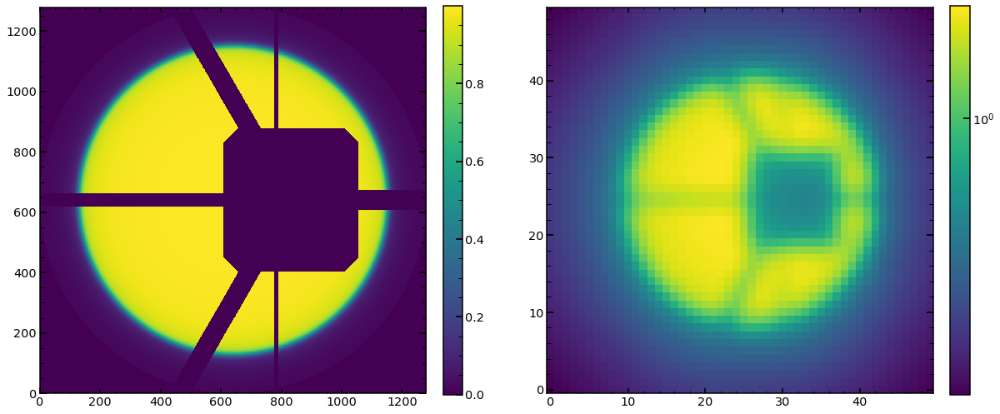

In [14]:
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(pupililluminated,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)
plt.imshow(res_iapetus,norm=LogNorm(),origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([1,10**-2,10**-3,10**-4,10**-5,10,10**2,10**3,10**4,10**5])

# Apr 04 - defocus

## First script

In [16]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)

In [17]:
list_of_HgAr_to_analyze=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=16)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<800)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]

list_of_HgAr_to_not_analyze_2_3=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=3)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]

list_of_HgAr_to_not_analyze_727=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['wavelength']=='727.47876')]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_2_3)
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_727)
print(len(list_of_HgAr_to_analyze))

28


In [306]:
list_of_Ne_to_analyze_all=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=16)&(finalNe_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalNe_Feb2019['close'].values.astype(int)==1)]


list_of_Ne_to_not_analyze_2_3=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=3)&(finalNe_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalNe_Feb2019['close'].values.astype(int)==1)]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_Ne_to_analyze=np.setdiff1d(list_of_Ne_to_analyze_all,list_of_Ne_to_not_analyze_2_3)

print(len(list_of_Ne_to_analyze))

56


In [308]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger01'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T01S'+str(single_spot)+'Apr.sh \n')

file.close()

In [309]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T02S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger02'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T02S'+str(single_spot)+'Apr.sh \n')

file.close()

In [424]:
list_of_HgAr_to_analyze=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=16)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>800)]

list_of_HgAr_to_not_analyze_2_3=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=3)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]

list_of_HgAr_to_not_analyze_727=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['wavelength']=='727.47876')]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_2_3)
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_727)
print(len(list_of_HgAr_to_analyze))

28


In [425]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T03S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger03'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T03S'+str(single_spot)+'Apr.sh \n')

file.close()

## Looking at the single image

### which images are avaliable

In [146]:
import glob
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr04/chainApr04_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr04/chainApr04_Single_P_*5HgArEmcee3.npy', recursive=True)

In [147]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-14]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[0])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [148]:
single_string

'1172415'

In [149]:
arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [189]:
arranged_by_spot_number_Ne

array([[12391,    10],
       [12349,    10],
       [12355,    10],
       [12367,    10],
       [12367,    10],
       [12343,    10],
       [12343,    10],
       [12307,    10],
       [12367,    10],
       [12355,    10],
       [12361,    10],
       [12349,    10],
       [12319,    10],
       [12361,    10],
       [12313,    10],
       [12397,    10],
       [12355,    10],
       [12403,    10],
       [12397,    10],
       [12397,    10],
       [12349,    10],
       [12343,    10],
       [12343,    10],
       [12313,    10],
       [12361,    10],
       [12307,    10],
       [12403,    10],
       [12403,    10],
       [12307,    10],
       [12349,    10],
       [12313,    11],
       [12355,    11],
       [12403,    11],
       [12349,    11],
       [12397,    11],
       [12355,    11],
       [12367,    11],
       [12313,    11],
       [12361,    11],
       [12403,    11],
       [12397,    11],
       [12313,    11],
       [12349,    11],
       [123

### continue

In [54]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr04'
obs=11796
single_number='66'
image_index=int(single_number)
eps=5
arc='HgAr'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m4


fiber                           5
xc                           1525
yc                           1957
wavelength               795.0522
close                           1
lamp                         HgAr
xc_effective                 1525
old_index_approx               42
superold_index_approx        53.0
Name: 66, dtype: object

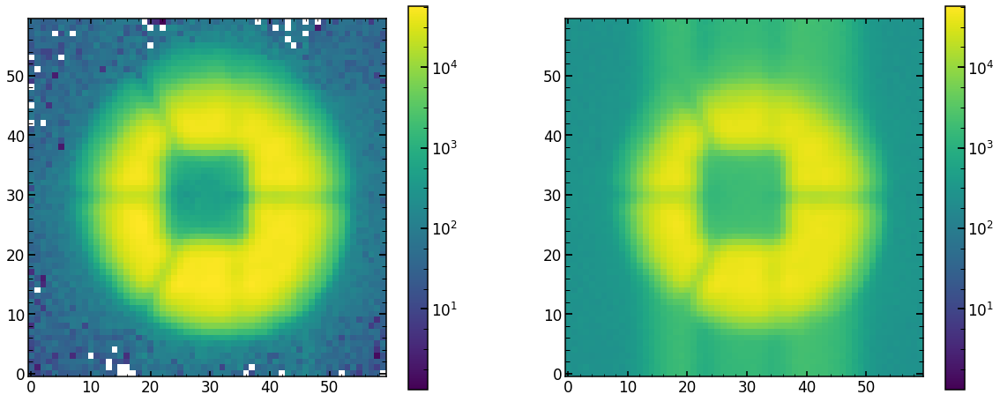

In [55]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [56]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 74630.51898903011
minimal chi2 reduced is: 41.456109005053285


In [57]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6        z7        z8        z9       z10  \
0  30.082424 -0.395703 -0.765217  0.263883  0.132105 -0.100907 -0.292817   

        z11  
0 -0.317235  
        z12       z13      z14       z15       z16       z17      z18  \
0 -0.064322 -0.031533  0.03564  0.022221  0.004029  0.056499  0.02276   

       z19       z20      z21  
0 -0.02238 -0.000557  0.03251  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.051449  0.682374   0.079125 -0.058149  0.020144  0.059626      0.02078   

   radiometricEffect  radiometricExponent    x_ilum   ...     frd_sigma  \
0           0.000004             0.000004  0.973495   ...      0.053318   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.998846  1.018683            0.180201   74763.523264   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r     flux  
0          2.543565              0.003487      0.379942  1.816552  0.99557

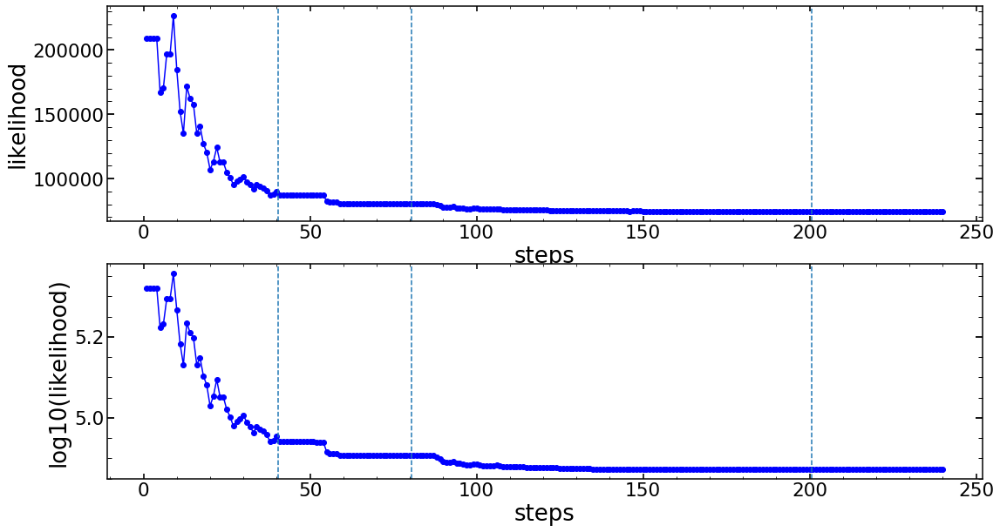

In [58]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [59]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

None
zmax: 22


-74630.5672073621

In [60]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

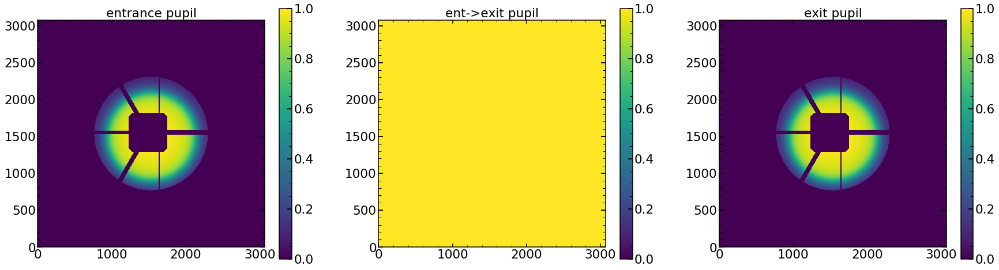

In [61]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

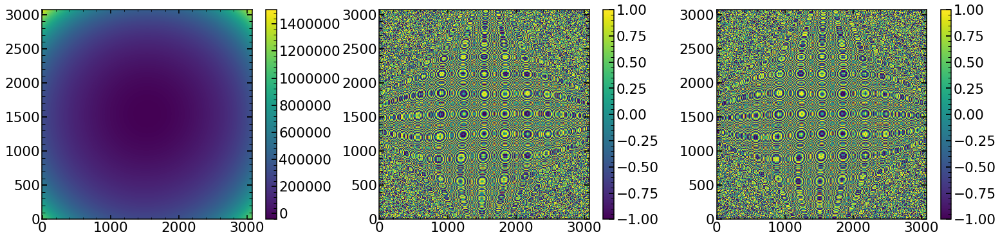

In [62]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

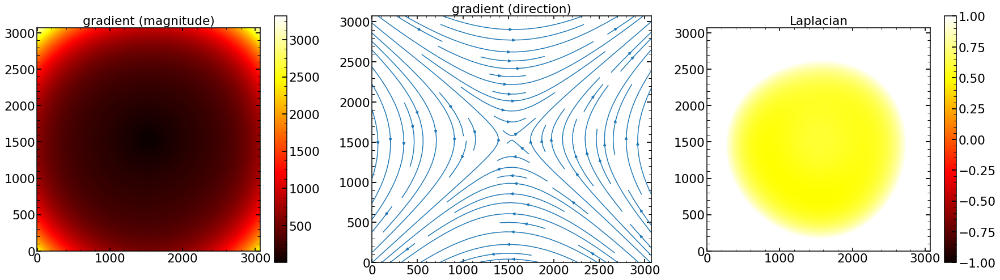

In [63]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

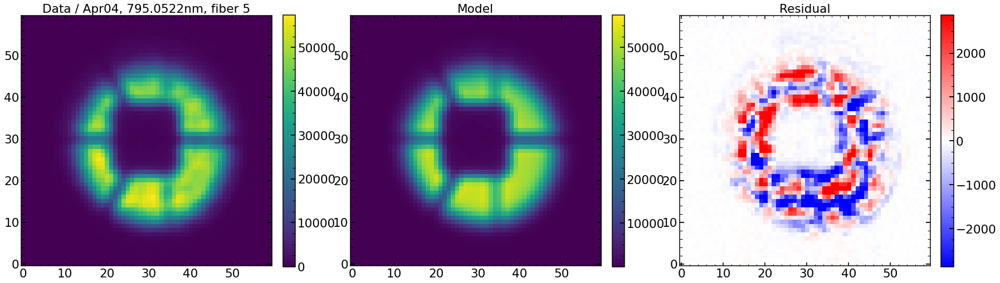

In [64]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 41.45613601496704
Abs of residual divided by total flux is: 0.05016217783897354
Abs of residual divided by largest value of a flux in the image is: 0.10042315157446852


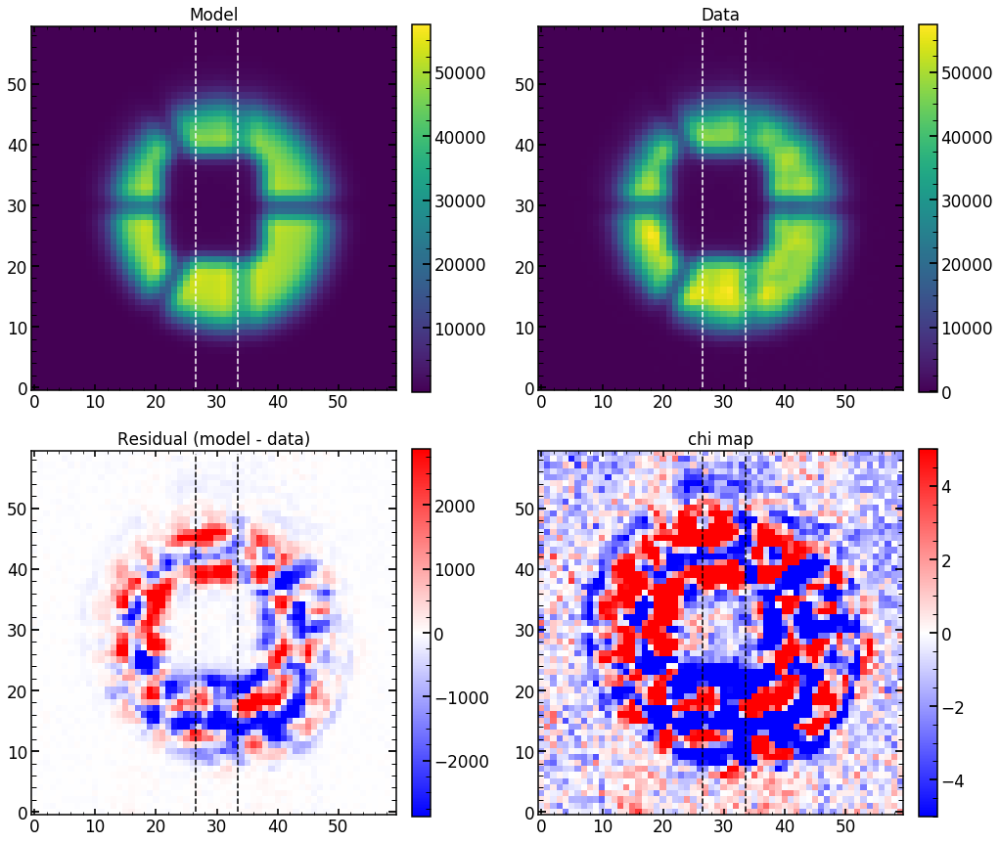

In [65]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

41.45613601496704
chi**2 reduced is: 41.45613601496704
Abs of residual divided by total flux is: 0.05016217783897354
Abs of residual divided by largest value of a flux in the image is: 0.10042315157446852


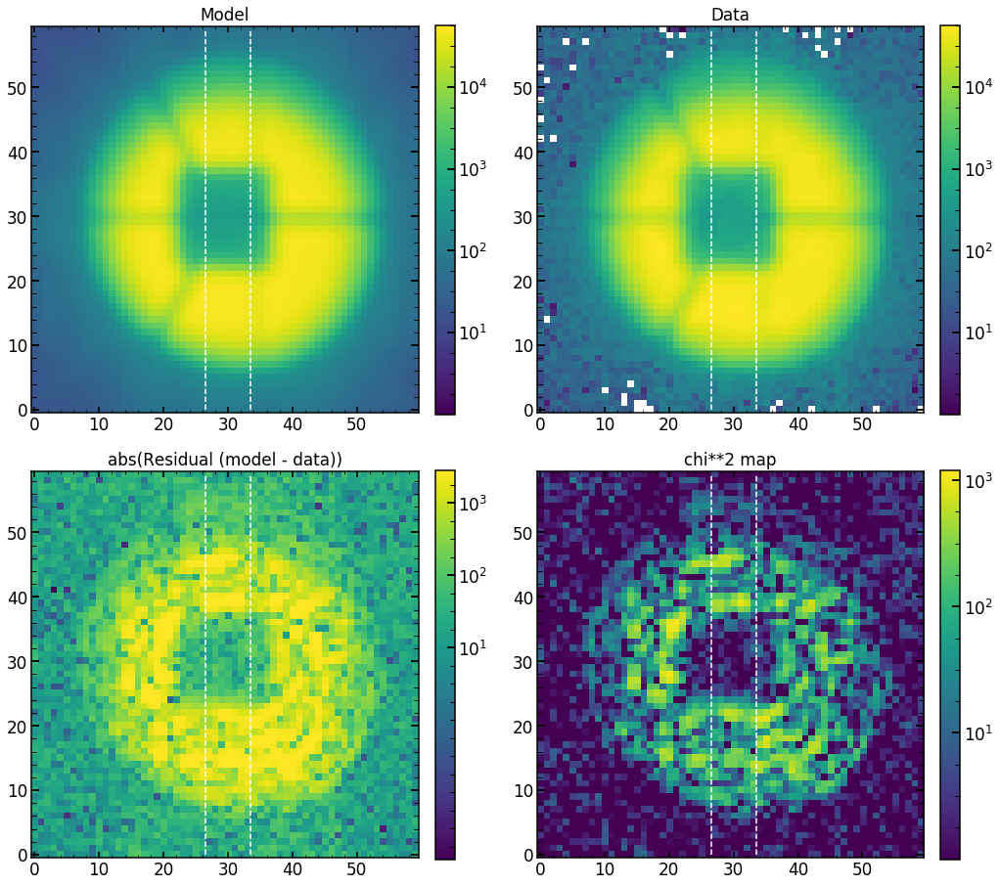

In [66]:
single_analysis.create_basic_comparison_plot_log()

41.45613601496704
chi**2 reduced is: 41.45613601496704
Abs of residual divided by total flux is: 0.05016217783897354
Abs of residual divided by largest value of a flux in the image is: 0.10042315157446852


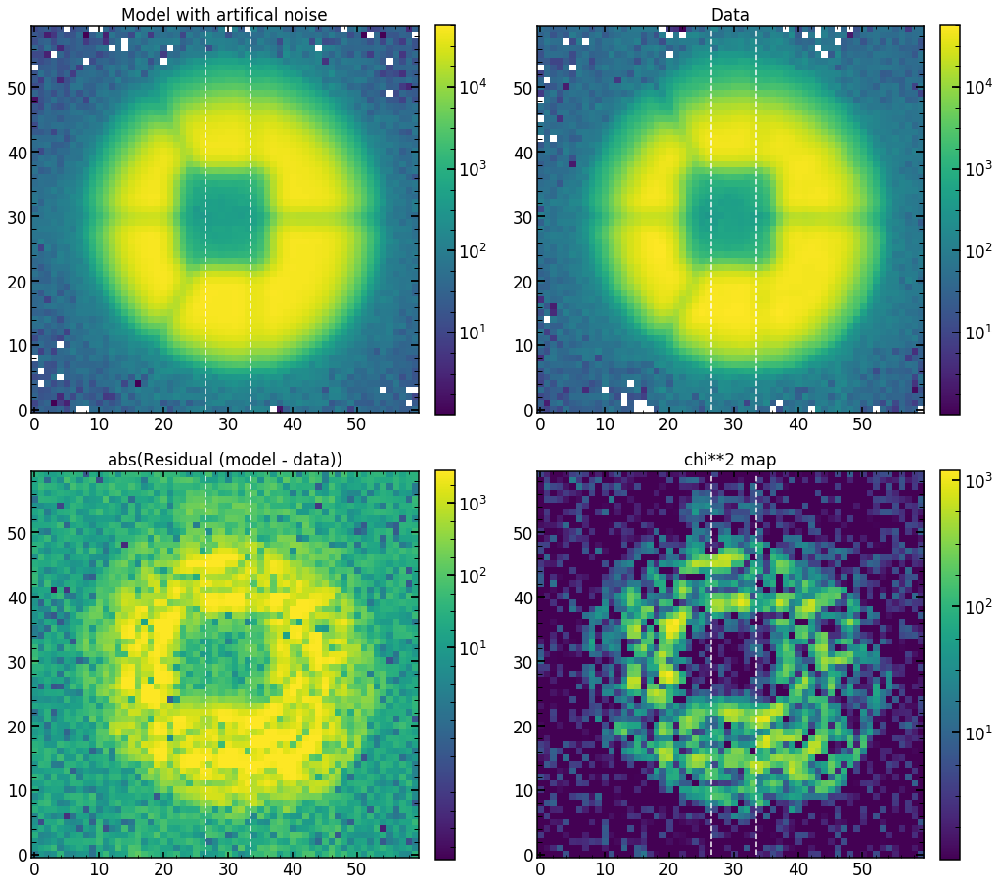

In [67]:
single_analysis.create_basic_comparison_plot_log_artifical()

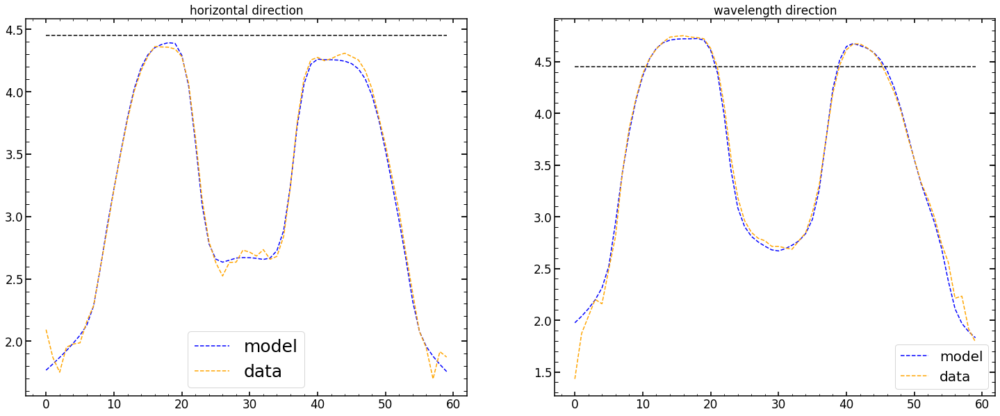

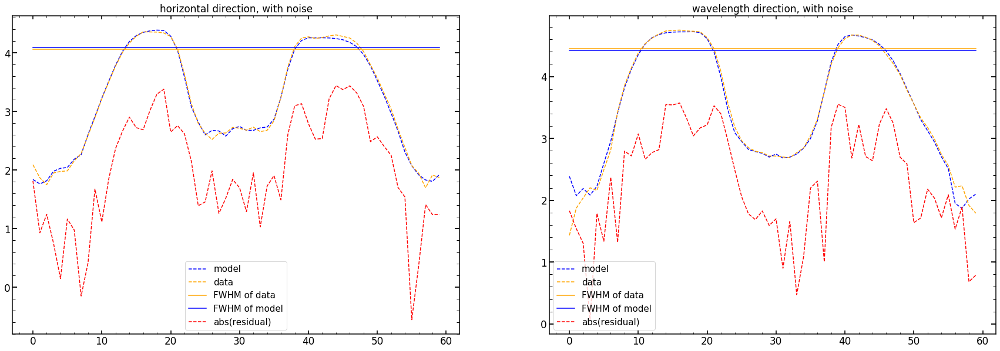

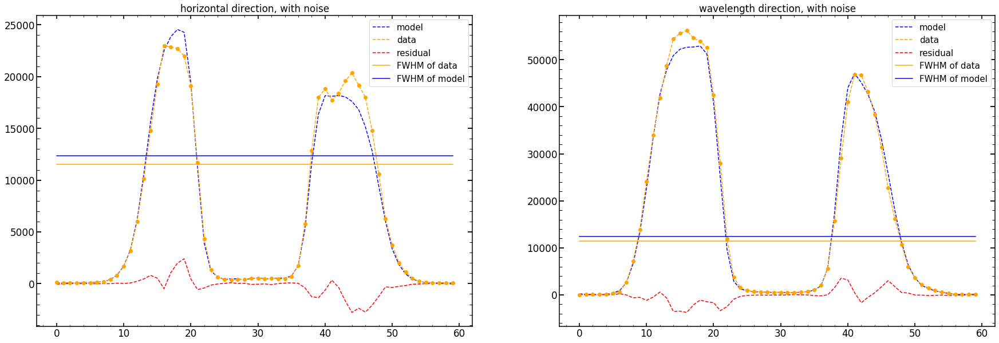

In [68]:
single_analysis.create_cut_plots()

## Codes

In [17]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns11=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns11_analysis=columns+['chi2','chi2max']

columns22=['z4','z5','z6','z7','z8','z9','z10','z11',
           'z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns22_analysis=columns22+['chi2','chi2max']

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c

In [19]:
def create_minchain_err(chain0,likechain0,sci_image,var_image,old=0):
    minchain_err_test=[]
    if len(chain0[0][0])==42:
        columns=columns22
        
    else:
        columns=columns11
    
    
    
    for var_number in range(len(columns)):
        #ravel likelihood
        likechain0_Emcee3_ravel=np.ravel(likechain0)

        # connect chain and lnchain
        chain0_Emcee3_ravel=np.ravel(chain0[:,:,var_number])
        chain0_Emcee3_ravel_argsort=np.argsort(chain0_Emcee3_ravel)  
        chain0_Emcee3_ravel_sort=chain0_Emcee3_ravel[chain0_Emcee3_ravel_argsort]
        likechain0_Emcee3_ravel_sort=likechain0_Emcee3_ravel[chain0_Emcee3_ravel_argsort]

        # move to chi2 space
        chi2_Emcee3_ravel_sort=-(np.array(likechain0_Emcee3_ravel_sort)*(2)-np.log(2*np.pi*np.sum(var_image)))/(sci_image.shape[0])**2
        min_chi2_Emcee3_ravel_sort=np.min(chi2_Emcee3_ravel_sort)

        # simplest standard deviation
        std_chain=np.std(chain0_Emcee3_ravel_sort)

        #best solution
        mean_chain=chain0_Emcee3_ravel_sort[chi2_Emcee3_ravel_sort==np.min(chi2_Emcee3_ravel_sort)][0]

        # step size
        step=std_chain/10

        # create result 3*std in each direction
        try:
            res=[]
            if step==0:
                step=10e-17
            for i in np.arange(mean_chain-30*step,mean_chain+30*step,step):
                selected_chi2_Emcee3_ravel_sort=chi2_Emcee3_ravel_sort[(np.array(chain0_Emcee3_ravel_sort<i+step)&np.array(chain0_Emcee3_ravel_sort>i))]
                if len(selected_chi2_Emcee3_ravel_sort>10):   
                    res.append([i+step/2,np.min(chi2_Emcee3_ravel_sort[(np.array(chain0_Emcee3_ravel_sort<i+step)&np.array(chain0_Emcee3_ravel_sort>i))])])

            res=np.array(res)

            #print(columns[var_number]+' min : '+str(mean_chain))
            #print(columns[var_number]+' std : '+str(std_chain))

            # find low limit and high limit
            res_within2_chi=res[res[:,1]<min_chi2_Emcee3_ravel_sort*2]
            minchain_err_element=[-np.abs(mean_chain-res_within2_chi[0,0]),np.abs(res_within2_chi[-1,0]-mean_chain)]
        except IndexError:
            if var_number!=25:
                print(columns[var_number]+': failed!')
                minchain_err_element=[-mean_chain,mean_chain]

        minchain_err_test.append(minchain_err_element)
        #print(columns[var_number]+' min_err : '+str(minchain_err_element[0]))
        #print(columns[var_number]+' max_err : '+str(minchain_err_element[1]))
    if old==1:
        minchain_err_test=np.mean(np.abs(np.array(minchain_err_test)),axis=1)
        #print(minchain_err_test)
        return minchain_err_test
    else:       
        return np.array(minchain_err_test)
    
    
import scipy.optimize as optimize
def curve_fit_custom_lin(V,index_arr,z4_arr,z4_arr_err_low,z4_arr_err_up):
    a,b=V
    yfit=lin_fit_1D(index_arr,a,b)
    weight=np.ones_like(yfit)
    weight[yfit>z4_arr]=z4_arr_err_up[yfit>z4_arr] # if the fit point is above the measure, use upper weight
    weight[yfit<=z4_arr]=z4_arr_err_low[yfit<=z4_arr] # else use lower weight
    return (yfit-z4_arr)**2/weight**2

def curve_fit_custom_con(V,index_arr,z4_arr,z4_arr_err_low,z4_arr_err_up):
    a=V
    yfit=lin_fit_1DConstant(index_arr,a)
    weight=np.ones_like(yfit)
    weight[yfit>z4_arr]=z4_arr_err_up[yfit>z4_arr] # if the fit point is above the measure, use upper weight
    weight[yfit<=z4_arr]=z4_arr_err_low[yfit<=z4_arr] # else use lower weight
    return (yfit-z4_arr)**2/weight**2 

In [20]:
def create_results_of_fit_single(date,single_number,arc=None,zMax=None):
    """create solution from a single image, create error and lower and upper erros

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
    @returns       results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper to be fed to solution_at_0_and_plots
    """
    print(zMax)
    if arc is None:
        arc='HgAr'
        
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
        
    if zMax==22:
        columns_analysis=columns22_analysis
    else:
        columns_analysis=columns11_analysis
    
    results_of_fit_single=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single_lower=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single_upper=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)

    # arrange all results in one pandas 
    #date='Sep19'
    #date='Sep27'
    RESULT_FOLDER='/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/'

    single_defocus_list=obs_possibilites

    #single_number=55
    image_index=single_number
    method='P'
    eps=5

    res_likelihood=[]

    for single_defocus in range(0,len(single_defocus_list)):
        try:
            obs=single_defocus_list[single_defocus]
            try:
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                print(str(single_number)+' obs (Emcee3): '+str(obs)+' is found!')
            except:    
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                print(str(single_number)+'obs (Emcee2): '+str(obs)+' is found!')

            if obs==8600:
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
            else:       
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
                #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

 
            likechain0=likechain

            chain0=chain
            minchain=chain0[np.abs(likechain0)==np.min(np.abs(likechain0))][0]
            chi2reduced=2*np.min(np.abs(likechain0))/(sci_image.shape[0])**2
            #print(" test0")

            """
            minchain_err=[]
            for i in range(len(columns)):
                #minchain_err=np.append(minchain_err,np.std(chain0[:,:,i].flatten()))
                minchain_err=np.append(minchain_err,np.sqrt(chi2reduced)*np.std(chain0[:,:,i].flatten()))

            minchain_err=np.array(minchain_err)
            """
            minchain_err_old=create_minchain_err(chain0,likechain0,sci_image,var_image,old=1)
            #print(minchain_err_old)
            #print(" test1")
            minchain_err=create_minchain_err(chain0,likechain0,sci_image,var_image)
            #print(" test2")
            results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain,np.array([chi2reduced,np.mean(sci_image**2/var_image)])),axis=0)
            #print(" test3")
            #print(results_of_fit_single.iloc[single_defocus])
            err_results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain_err_old,np.array([1,1])),axis=0)
            #print(" test4")
            err_results_of_fit_single_lower.iloc[single_defocus]=np.concatenate((minchain_err[:,0],np.array([1,1])),axis=0)
            #print(" test5")
            err_results_of_fit_single_upper.iloc[single_defocus]=np.concatenate((minchain_err[:,1],np.array([1,1])),axis=0)
            #print(" test6")
        
        except:
            ValueError
            print(str(single_number)+' '+str(obs)+' '+str(arc)+' is NOT found or failed!')
    #results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    #err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    #err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    #err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]              
    
    return results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper


def create_results_of_fit_single_focus(date,single_number,arc=None,zMax=None):
    """create solution from a single image, create error and lower and upper erros

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
    @returns       results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper to be fed to solution_at_0_and_plots
    """
    print(zMax)
    if arc is None:
        arc='HgAr'
        
    if arc=='HgAr':
        obs_possibilites=np.array([11748])
    elif arc=='Ne':
        obs_possibilites=np.array([12355])
        
    if zMax==22:
        columns_analysis=columns22_analysis
    else:
        columns_analysis=columns11_analysis        
        
    if arc=='HgAr':
        labels=['11748']
    elif arc=='Ne':
        labels=['12355']

    results_of_fit_single=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single_lower=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single_upper=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)

    # arrange all results in one pandas 
    #date='Sep19'
    #date='Sep27'
    RESULT_FOLDER='/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/'

    single_defocus_list=obs_possibilites

    #single_number=55
    image_index=single_number
    method='P'
    eps=5

    res_likelihood=[]

    for single_defocus in range(0,len(single_defocus_list)):
        try:
            obs=single_defocus_list[single_defocus]
            try:
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                print(str(single_number)+' obs (Emcee3): '+str(obs)+' is found!')
            except:    
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                print(str(single_number)+'obs (Emcee2): '+str(obs)+' is found!')

            if obs==8600:
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
            else:       
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
                #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

 
            likechain0=likechain

            chain0=chain
            minchain=chain0[np.abs(likechain0)==np.min(np.abs(likechain0))][0]
            chi2reduced=2*np.min(np.abs(likechain0))/(sci_image.shape[0])**2
            #print(" test0")

            """
            minchain_err=[]
            for i in range(len(columns)):
                #minchain_err=np.append(minchain_err,np.std(chain0[:,:,i].flatten()))
                minchain_err=np.append(minchain_err,np.sqrt(chi2reduced)*np.std(chain0[:,:,i].flatten()))

            minchain_err=np.array(minchain_err)
            """
            minchain_err_old=create_minchain_err(chain0,likechain0,sci_image,var_image,old=1)
            #print(minchain_err_old)
            #print(" test1")
            minchain_err=create_minchain_err(chain0,likechain0,sci_image,var_image)
            #print(" test2")
            results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain,np.array([chi2reduced,np.mean(sci_image**2/var_image)])),axis=0)
            #print(" test3")
            #print(results_of_fit_single.iloc[single_defocus])
            err_results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain_err_old,np.array([1,1])),axis=0)
            #print(" test4")
            err_results_of_fit_single_lower.iloc[single_defocus]=np.concatenate((minchain_err[:,0],np.array([1,1])),axis=0)
            #print(" test5")
            err_results_of_fit_single_upper.iloc[single_defocus]=np.concatenate((minchain_err[:,1],np.array([1,1])),axis=0)
            #print(" test6")
        
        except:
            ValueError
            print(str(single_number)+' '+str(obs)+' '+str(arc)+' is NOT found or failed!')
    #results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    #err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    #err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    #err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]              
    
    return results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper

In [21]:
def solution_at_0_and_plots(date,single_number,arc,results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,plot=True,zMax=None):
    """create solution at the focus and plot dependence with defocu

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
  
    """    
    
    if zMax==22:
        columns_analysis=columns22_analysis
        columns=columns22
        z_addition_factor=11
    else:
        columns_analysis=columns11_analysis
        columns=columns11
        z_addition_factor=0
    
    results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]    
    
    if len(results_of_fit_single)<=6:
        if zMax==22:
            solution_at_0=np.full(31+11,0)

        else:
            solution_at_0=np.full(31,0)       

        return solution_at_0
    else:
        IMAGES_FOLDER='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/'

        solution_at_0=[]

        for q in columns_analysis:

            z4_arr=np.array(results_of_fit_single[q])
            z4_arr_err=np.array(err_results_of_fit_single[q])
            z4_arr_err_up=np.array(err_results_of_fit_single_upper[q])
            z4_arr_err_low=np.array(err_results_of_fit_single_lower[q])
            index_arr=results_of_fit_single[q].index.values.astype(float)
            #print(q)
            #print(index_arr)
            #print(z4_arr)
            #print(z4_arr_err)
            #print(z4_arr_err_up)
            #print(z4_arr_err_low)
            
            z4_arr_no0=z4_arr[np.abs(index_arr)>0.5]
            z4_arr_no0_err=z4_arr_err[np.abs(index_arr)>0.5]
            z4_arr_no0_err_up=z4_arr_err_up[np.abs(index_arr)>0.5]
            z4_arr_no0_err_low=z4_arr_err_low[np.abs(index_arr)>0.5]
            index_arr_no0=index_arr[np.abs(index_arr)>0.5]
            #print(q)
            #print(index_arr_no0)
            #print(z4_arr_no0)
            #print(z4_arr_no0_err)
            #print(z4_arr_no0_err_up)
            #print(z4_arr_no0_err_low)
            
            
            z4_arr_only0=z4_arr[np.abs(index_arr)<=0.5]
            z4_arr_only0_err=z4_arr_err[np.abs(index_arr)<=0.5]
            z4_arr_only0_err_up=z4_arr_err_up[np.abs(index_arr)<=0.5] 
            z4_arr_only0_err_low=z4_arr_err_low[np.abs(index_arr)<=0.5]
            index_arr_only0=index_arr[np.abs(index_arr)<=0.5]

            fit_res=[]
            interim_zero_solutions=[]

            
            if q in columns[:8+z_addition_factor]:
                # these variables are fit via linear fit, without values at focus
                # it is z4-z11
                # for loop below removes 2 points from the fit that create largest deviations from median result in focus
                for l in range(len(index_arr_no0)):
                    #print('good_index'+str(np.delete(index_arr_no0,l)))
                    #print('index_arr_no0'+str(np.delete(z4_arr_no0,l)))
                    #print('z4_arr_no0_err_low'+str(np.delete(z4_arr_no0_err_low,l)))
                    #print('z4_arr_no0_err_up'+str(np.delete(z4_arr_no0_err_up,l)))
                    popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,lin_fit_1D(0,popt[0],popt[1])])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                second_max_dif=np.sort(interim_zero_solutions_arr_dif)[-2]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<second_max_dif]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                #print('good_index'+str(good_index))
                #print('index_arr_no0'+str(index_arr_no0))
                #print('z4_arr_no0_err_low'+str(z4_arr_no0_err_low))
                #print('z4_arr_no0_err_up'+str(z4_arr_no0_err_up))
                popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                #print(popt)
                for i in np.linspace(-4.5,4.5,19):
                    fit_res.append(lin_fit_1D(i,popt[0],popt[1]))
                solution_at_0.append(fit_res[9])

            interim_zero_solutions=[]
            if q in columns[8+z_addition_factor:25+z_addition_factor]:
                # these variables are set at mean value (constant fit), without values at focus
                # these are variables that describe the pupil
                for l in range(len(index_arr_no0)):
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,popt[0]])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                third_max_dif=np.sort(interim_zero_solutions_arr_dif)[-3]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<=(third_max_dif*1.1)]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                solution_at_0.append(fit_res[9])

            if q in np.concatenate((np.array(columns[25+z_addition_factor:]),np.array(['chi2','chi2max'])),axis=0):
                # these variables are set at value as measured at 0 - (perhaps is should be close to 0)
                if z4_arr_only0.size==1:
                    for i in np.linspace(-4.5,4.5,19):
                        fit_res.append(z4_arr_only0) 
                    solution_at_0.append(fit_res[9])
                else:
                    # these variables are set at mean value (constant fit), without values at focus
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(index_arr_only0, z4_arr_only0, z4_arr_only0_err_low,z4_arr_only0_err_up))[0]
                    fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                    solution_at_0.append(fit_res[9])


            #making plots here
            ######
            #print(q)
            #print(fit_res)
            plt.figure(figsize=(20,10))
            plt.errorbar(index_arr,z4_arr,yerr=[np.abs(z4_arr_err_low),z4_arr_err_up],color='blue',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='single fit results')
            plt.plot(np.linspace(-4.5,4.5,19),fit_res,color='orange',label='fit')
            if q in columns[:8]:
                plt.plot(np.linspace(-4.5,4.5,19),np.zeros((19,1)),':',color='black')
            plt.plot([0], [fit_res[9]], marker='o', markersize=10, color="red",label='prediction for focus')
            #print('prediction for focus: '+str(q)+' '+str(fit_res[9]))
            plt.title(q,size=40)
            plt.legend(fontsize=25)
            plt.xlabel('defocus lab [mm]',size=30)
            plt.ylabel('defocus model',size=30)
            #print(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'+str(arc)+str(q))

            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(q)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(q)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(q)+'/'+str(arc)+str(single_number))

            plt.close()   
            ######

        solution_at_0=np.array(solution_at_0)[:len(solution_at_0)-2]
        return solution_at_0

In [22]:
def residual_1D(sci_image,var_image,res_iapetus):

    #sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')    
    multiplicative_factor_to_renormalize_to_50000=np.max(sci_image)/50000
    sci_image_smaller=sci_image[:,8:14]/multiplicative_factor_to_renormalize_to_50000
    var_image_smaller=var_image[:,8:14]/multiplicative_factor_to_renormalize_to_50000

    residual_initial_smaller=sci_image_smaller-res_iapetus[:,8:14]/multiplicative_factor_to_renormalize_to_50000
    #residual_RF_smaller=chi_RF_corrected_image[:,8:14]*np.sqrt(var_image_smaller)

    #################################
    # step 5 from Horne, very simplified
    inputimage_smaller=sci_image_smaller
    Px=np.sum(inputimage_smaller,axis=0)/np.sum(inputimage_smaller)
    var_inputimage_smaller=var_image_smaller
    #################################
    # Equation 8 from Horne with modification from Robert abut variance for extraction of signal
    # note that this uses profile from full thing, and not "residual profile"

    # nominator
    weighted_inputimage_smaller=inputimage_smaller*Px/(1)
    # denominator
    weights_array=np.ones((inputimage_smaller.shape[0],inputimage_smaller.shape[1]))*Px**2

    init_lamda=np.array(list(map(np.sum, weighted_inputimage_smaller)))/(np.array(list(map(np.sum,weights_array))))
    init_lamda_boxcar=np.array(list(map(np.sum, inputimage_smaller)))
    # Equation 8.5 from Horne
    var_f_std_lamda=1/np.sum(np.array(Px**2/(var_inputimage_smaller)),axis=1)
    std_init_lamda=np.sqrt(var_f_std_lamda)
    std_init_lamda_boxcar=np.sqrt(np.array(list(map(np.sum, var_inputimage_smaller))))


    #################################
    # Equation 8 from Horne with modification from Robert abut variance for initial removal
    # note that this uses profile from full thing, and not "residual profile"

    # nominator
    weighted_inputimage_smaller=residual_initial_smaller*Px/(1)
    # denominator
    weights_array=np.ones((residual_initial_smaller.shape[0],residual_initial_smaller.shape[1]))*Px**2

    init_removal_lamda=np.array(list(map(np.sum, weighted_inputimage_smaller)))/(np.array(list(map(np.sum,weights_array))))
    init_removal_lamda_boxcar=np.array(list(map(np.sum, residual_initial_smaller)))
    # Equation 8.5 from Horne
    var_init_removal_lamda=1/np.sum(np.array(Px**2/(var_inputimage_smaller)),axis=1)
    std_init_removal_lamda=np.sqrt(var_init_removal_lamda)
    return init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda

def chi_50000(sci_image,var_image,res_iapetus):

    #sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')    
    multiplicative_factor_to_renormalize_to_50000=np.max(sci_image)/50000
    sci_image_renormalized=sci_image/multiplicative_factor_to_renormalize_to_50000
    var_image_renormalized=var_image/multiplicative_factor_to_renormalize_to_50000
    res_iapetus_renormalized=res_iapetus/multiplicative_factor_to_renormalize_to_50000
    

    return np.mean((sci_image_renormalized-res_iapetus_renormalized)**2/var_image_renormalized)

In [23]:
def add_artificial_noise(sci_image,var_image,res_iapetus):
    
    """
    add extra noise so that it has comparable noise as if the max flux in the image (in the single pixel) is 40000
    
    
    """

    
    multi_factor=np.max(sci_image)/40000
    Max_SN_now=np.max(sci_image)/np.max(np.sqrt(var_image))
    dif_in_SN=Max_SN_now/200
    artifical_noise=np.zeros_like(res_iapetus)
    artifical_noise=np.array(artifical_noise)
    for i in range(len(artifical_noise)):
        for j in range(len(artifical_noise)):
            artifical_noise[i,j]=np.random.randn()*np.sqrt((dif_in_SN**2-1)*var_image[i,j])   
            
    if dif_in_SN>1:        
        return (sci_image+artifical_noise),((dif_in_SN**2)*var_image),res_iapetus
    else:
        return (sci_image),((dif_in_SN**2)*var_image),res_iapetus     

## Creation of pandas dataframe

In [124]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('Apr04',single_number,'HgAr',22)
    solution_at_0=solution_at_0_and_plots('Apr04',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]



22
0 11796 HgAr is NOT found or failed!
0 11790 HgAr is NOT found or failed!
0 11784 HgAr is NOT found or failed!
0 11778 HgAr is NOT found or failed!
0 11772 HgAr is NOT found or failed!
0 11766 HgAr is NOT found or failed!
0 11760 HgAr is NOT found or failed!
0 11754 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11694 HgAr is NOT found or failed!
0 11700 HgAr is NOT found or failed!
0 11706 HgAr is NOT found or failed!
0 11712 HgAr is NOT found or failed!
0 11718 HgAr is NOT found or failed!
0 11724 HgAr is NOT found or failed!
0 11730 HgAr is NOT found or failed!
0 11736 HgAr is NOT found or failed!
22
1 11796 HgAr is NOT found or failed!
1 11790 HgAr is NOT found or failed!
1 11784 HgAr is NOT found or failed!
1 11778 HgAr is NOT found or failed!
1 11772 HgAr is NOT found or failed!
1 11766 HgAr is NOT found or failed!
1 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
sli

[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.40753569 0.47582235 0.43655346 0.43655346 0.21654806 0.73142448
 1.07423496 1.21613641 1.35347026]
[0.10382173 0.0654845  0.09683368 0.09683368 0.24111338 0.08868916
 0.24049179 0.20966616 0.32834315]
[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.11264848 -0.13760819 -0.12815844 -0.12815844 -0.02137249  0.11015277
  0.15327783  0.18093851  0.21688602]
[0.10608654 0.07175899 0.08995478 0.08995478 0.08815739 0.09294098
 0.18856776 0.19687536 0.34524961]
[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.65428119 0.65516464 0.72631656 0.72631656 0.43514593 0.6539595
 0.51964759 0.48460577 0.46471228]
[0.09921085 0.07166119 0.09677749 0.09677749 0.09279908 0.08338484
 0.1770527  0.15469625 0.23908651]
[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.93328263 1.01057512 1.10855916 1.10855916 0.72035644 1.15341003
 0.99739962 1.0068821  1.01302099]
[0.10280814 0.06918539 0.05938125 0.05938125 0.15090648 0.08979947
 0.16787503 0.18684837 

[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[1.00190743 1.00190745 1.00190746 1.00190746 1.00190748 1.0019075
 1.00190756 1.00190757 1.00190759]
[1.00190743 1.00190745 1.00190746 1.00190746 1.00190748 1.0019075
 1.00190756 1.00190757 1.00190759]
[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.57261    0.57261002 0.57261003 0.57261003 0.57261005 0.57261006
 0.57261013 0.57261014 0.57261016]
[0.57261    0.         0.57261003 0.57261003 0.57261005 0.57261006
 0.57261013 0.57261014 0.        ]
[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[97100.69832553 97100.69832553 97100.69832553 97100.69832553
 97100.69832553 97100.69832553 97100.69832553 97100.69832553
 97100.69832553]
[97100.69832553 97100.69832553 97100.69832553 97100.69832553
 97100.69832553 97100.69832553 97100.69832553 97100.69832553
 97100.69832553]
[-1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[2.39238827 2.39238798 2.39238769 2.39238769 2.39238741 2.39238712
 2.39238597 2.39238568 2.3923854 ]
[2.39238827 2.39238798 2.3

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
6 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_il

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.03871656  0.04366613  0.03022035  0.0402942  -0.245884   -0.245884
  0.1473532  -0.00485787  0.00581891  0.03706319  0.03042502]
[0.2439595  0.17266305 0.03919728 0.05429948 0.15535122 0.15535122
 0.13249284 0.05158663 0.10216115 0.08793743 0.16067178]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.00932324  0.00022903  0.01254357 -0.00889689  0.66191282  0.66191282
  0.08104254 -0.03394096 -0.01214938 -0.0045949   0.00563841]
[0.17287701 0.21460609 0.06071859 0.05543658 0.17783999 0.17783999
 0.16000007 0.04545265 0.13386839 0.0893656  0.13847991]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.01899265 -0.01074212  0.01707333  0.05827425 -0.3671228  -0.3671228
  0.16667173  0.19368737  0.05070242  0.03811075  0.04123876]
[0.09719994 0.09167649 0.03625862 0.0377715  0.07879337 0.07879337
 0.04487019 0.05410261 0.07918439 0.06498364 0.10141711]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. 

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[2.48161013 2.48160928 2.48160501 2.48160416 2.48160331 2.48160331
 2.48160245 2.4816016  2.48159819 2.48159734 2.48159648]
[2.48161013 2.48160928 2.48160501 2.48160416 2.48160331 2.48160331
 0.         2.4816016  2.48159819 2.48159734 2.48159648]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00289917 0.00289832 0.00289405 0.0028932  0.00289235 0.00289235
 0.0028915  0.00289064 0.00288723 0.00288638 0.00288553]
[0.         0.00289832 0.00289405 0.0028932  0.         0.
 0.0028915  0.00289064 0.00288723 0.00288638 0.00288553]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.37997281 0.3799728  0.37997276 0.37997275 0.37997274 0.37997274
 0.37997273 0.37997272 0.37997268 0.37997267 0.37997266]
[0.         0.         0.37997276 0.37997275 0.37997274 0.37997274
 0.37997273 0.37997272 0.37997268 0.37997267 0.37997266]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[1.82888477 1.82888477 1.82888477 1.

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[-2.43195398 -2.21965085 -2.03848301 -1.26947385 -1.09252479 -1.47231953
 -1.47231953 -0.64617921  0.21957363  0.38344513]
[0.37685292 0.33726903 0.29061614 0.10609543 0.0807517  0.18064956
 0.18064956 0.20552205 0.3359493  0.43405466]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[-1.15681865 -1.00559683 -0.80118288 -0.32518614 -0.24289834 -0.35543509
 -0.35543509  0.61603323  0.86821337  1.0064391 ]
[0.38757547 0.41990989 0.24356223 0.13579625 0.11754034 0.19680534
 0.19680534 0.69660486 0.32813435 0.21799749]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[-0.00600374 -0.06038668 -0.15233788 -0.26652917 -0.29224941 -0.21043381
 -0.21043381 -0.00917076 -0.30558997 -0.33725007]
[0.25129939 0.28335193 0.22073445 0.09581732 0.06182831 0.09326546
 0.09326546 0.57561319 0.20284043 0.2275491 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[0.58131776 0.60359468 0.6432795  0.81504207 0.84392347 1.27014643
 1.27014643 1.026

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[0.79749163 0.79749161 0.7974916  0.79749153 0.79749152 0.7974915
 0.7974915  0.79749149 0.79749141 0.79749139]
[0.         0.         0.7974916  0.79749153 0.79749152 0.7974915
 0.7974915  0.         0.         0.79749139]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[0.08737507 0.08737507 0.08737507 0.08737507 0.08737507 0.08737507
 0.08737507 0.08737507 0.08737507 0.08737507]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[0.570028 0.570028 0.570028 0.570028 0.570028 0.570028 0.570028 0.570028
 0.570028 0.570028]
[0.       0.       0.       0.       0.       0.570028 0.570028 0.
 0.       0.570028]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  3.   3.5]
[1.02650718 1.02650718 1.02650719 1.0265072  1.0265072  1.0265072
 1.0265072  1.0265072  1.02650722 1.02650722]
[0.         0.         0.         0.         1.0265072  1.0265072
 1.0265072  0.         1.02650722 1.02650722]
[-4.  -3.5 -3.  -1.

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
11 obs (Emcee3): 11748 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: fa

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.05024119 -0.05857926 -0.05515778 -0.08755718 -0.0547847   0.1357836
  0.1357836  -0.23103849 -0.01266957 -0.02271962]
[0.09138718 0.08711849 0.11946404 0.04748968 0.03864491 0.15243681
 0.15243681 0.31273927 0.12341166 0.12897867]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.0116312  -0.0249338  -0.03946327  0.00167112  0.036831    0.08218497
  0.08218497 -0.3840944   0.0518561   0.04225919]
[0.07640784 0.08338442 0.10710462 0.05449755 0.05573139 0.07570934
 0.07570934 0.18437007 0.05749172 0.08872   ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[ 0.05078923  0.04104379  0.04729778  0.08746211  0.06670485  0.08073647
  0.08073647 -0.37540038  0.21094225 -0.07088703]
[0.08552911 0.07578538 0.08170878 0.04357284 0.0313443  0.06853565
 0.06853565 0.09618734 0.14451466 0.08758751]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.70170384 0.70170384 0.70170384 0.70170384 0.70170384 0.70170384
 0.70170384 0.7017

dxFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
fiber_r: failed!
13 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
13 obs (Emcee3): 11784 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
sl

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
13 11736 HgAr is NOT found or failed!
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 32.65608674  28.86238664  25.07702437  10.0018601    6.18511273
   2.41781335   2.41781335   0.95633537  -4.9664255  -19.9598724
 -23.69203338]
[0.61602185 0.51042212 0.42362958 0.12189207 0.12214129 0.20725239
 0.20725239 0.40336887 0.1502351  0.36561047 0.48449172]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.48420523 -0.34503138 -0.20129866  0.34672294  0.44616754  0.63378292
  0.63378292  0.13222197  0.74515536  1.18219875  1.31856526]
[0.50713168 0.31237134 0.

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00005312 0.00005311 0.00005311 0.00005308 0.00005308 0.00005307
 0.00005307 0.00005307 0.00005306 0.00005304 0.00005303]
[0.         0.         0.         0.         0.05540451 0.05540451
 0.05540451 0.05540451 0.05540451 0.         0.05540452]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00005309 0.00005308 0.00005308 0.00005308 0.00005307 0.00005307
 0.00005307 0.00005307 0.00005307 0.00005306 0.00005306]
[0.00005309 0.00005308 0.00005308 0.00005308 0.00005307 0.00005307
 0.00005307 0.00005307 0.00005307 0.00005306 0.00005306]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.9745519  0.97455188 0.97455187 0.97455181 0.9745518  0.97455178
 0.97455178 0.97455177 0.97455175 0.9745517  0.97455168]
[0.9745519  0.         0.97455187 0.97455181 0.9745518  0.97455178
 0.97455178 0.97455177 0.97455175 0.9745517  0.97455168]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.94834354 0.94834352 0.948

strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
18 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude:

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.33341285 -0.2700759   0.06461988  0.12733406  0.32697657  0.32697657
  0.3206542   0.46478262  0.84741805  1.02506377]
[0.30524893 0.22100559 0.07840603 0.08045988 0.07392044 0.07392044
 0.13353816 0.09161953 0.13132881 0.16462093]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.39404761 0.36588684 0.2741585  0.29907361 0.34265677 0.34265677
 0.05567042 0.12546876 0.07244119 0.03589414]
[0.20290074 0.15750744 0.05126428 0.07979951 0.25719056 0.25719056
 0.07632197 0.06018311 0.11994964 0.12031244]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.39077923 0.41901414 0.52429754 0.59958516 0.47999961 0.47999961
 0.8783038  0.64345065 0.72927568 0.77573724]
[0.16234808 0.1862376  0.06607006 0.05673165 0.07218601 0.07218601
 0.06550826 0.07116963 0.09381269 0.13779314]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.1227025  -0.10375721 -0.05947758 -0.04379181 -0.36092204 -0.36092204
 -0.09541501 -0.06793974 -0.051

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.79749279 0.79749278 0.79749275 0.79749275 0.79749274 0.79749274
 0.79749273 0.79749272 0.79749269 0.79749268]
[0.79749279 0.         0.79749275 0.79749275 0.79749274 0.79749274
 0.79749273 0.79749272 0.79749269 0.79749268]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.07822441 0.07822441 0.07822441 0.07822441 0.07822441 0.07822441
 0.07822441 0.07822441 0.07822441 0.07822441]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.99708861 0.99708861 0.99708861 0.99708861 0.99708861 0.99708861
 0.99708861 0.99708861 0.99708861 0.99708861]
[0.         0.         0.99708861 0.99708861 0.99708861 0.99708861
 0.99708861 0.99708861 0.99708861 0.99708861]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.99774627 0.99774628 0.99774632 0.99774633 0.99774633 0.99774633
 0.99774634 0.99774635 0.99774639 0.9977464 ]
[0.99774627 0.99774628 0.99774632 0.99774633 0.99774633 0.99774633
 0.99774634 0.9

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
21 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: faile

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.09908099 0.09908097 0.0990809  0.09908089 0.09908087 0.09908087
 0.09908086 0.09908084 0.09908079 0.09908077]
[0.09908099 0.09908097 0.0990809  0.09908089 0.09908087 0.09908087
 0.09908086 0.         0.09908079 0.09908077]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.17073311 -0.17073311 -0.1707331  -0.1707331  -0.1707331  -0.1707331
 -0.17073309 -0.17073309 -0.17073309 -0.17073308]
[0.         0.         0.1707331  0.1707331  0.1707331  0.1707331
 0.         0.         0.17073309 0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.182218   0.182218   0.18221801 0.18221801 0.18221801 0.18221801
 0.18221802 0.18221802 0.18221802 0.18221803]
[0.         0.182218   0.18221801 0.18221801 0.18221801 0.18221801
 0.18221802 0.18221802 0.18221802 0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.06135925 0.06135925 0.06135924 0.06135924 0.06135923 0.06135923
 0.06135923 0.06135923 0.06135922 0.061

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
pixel_effect: failed!
fiber_r: failed!
23 11784 HgAr is NOT found or failed!
23 11778 HgAr is NOT found or failed!
23 11772 HgAr is NOT found or failed!
23 11766 HgAr is NOT found or failed!
23 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-1.70268621 -1.52377452 -0.71727835 -0.57033445 -0.4375522  -0.4375522
  0.65317136 -0.28501272  0.6872508   0.88428484  1.06296465]
[0.1387063  0.1784168  0.05225151 0.06916408 0.14568224 0.14568224
 0.33888813 0.30077318 0.28645762 0.17299822 0.22338451]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.10307499 -0.20052621 -0.53985821 -0.54657602 -0.52813423 -0.52813423
 -0.0235498  -1.26692303 -0.44225577 -0.47087944 -0.50947641]
[0.09148807 0.12516732 0.06377417 0.04528461 0.14563543 0.14563543
 0.23906606 0.21261966 0.25722466 0.13271369 0.19297097]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.58068279 0.58107676 0.72363361 0.74778846 0.95792164 0.95792164
 1.10756842 0.22484436 0.45111229 0.51850388 0.54365126]
[0.12029839 0.11471918 0.04468968 0.04645463 0.12380253 0.12380253
 0.15901863 0.28373785 0.27551322 0.16902283 0.1790542 ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.247

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00578541 0.00578541 0.00578541 0.00578541 0.00578541 0.00578541
 0.00578541 0.00578541 0.00578541 0.00578541 0.00578541]
[0.00578541 0.00578541 0.00578541 0.00578541 0.00578541 0.00578541
 0.00578541 0.00578541 0.00578541 0.         0.00578541]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.07383372 -0.07383372 -0.07383372 -0.07383372 -0.07383372 -0.07383372
 -0.07383372 -0.07383372 -0.07383372 -0.07383372 -0.07383372]
[0.07383372 0.07383372 0.07383372 0.07383372 0.07383372 0.07383372
 0.07383372 0.07383372 0.07383372 0.07383372 0.07383372]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.79749725 0.79749723 0.79749714 0.79749713 0.79749711 0.79749711
 0.79749709 0.79749707 0.797497   0.79749699 0.79749697]
[0.79749725 0.         0.79749714 0.79749713 0.         0.
 0.79749709 0.79749707 0.797497   0.79749699 0.79749697]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.07822441 0.07822441 0.

39 11748 HgAr is NOT found or failed!
39 11748 HgAr is NOT found or failed!
39 11694 HgAr is NOT found or failed!
39 11700 HgAr is NOT found or failed!
39 11706 HgAr is NOT found or failed!
39 11712 HgAr is NOT found or failed!
39 11718 HgAr is NOT found or failed!
39 11724 HgAr is NOT found or failed!
39 11730 HgAr is NOT found or failed!
39 11736 HgAr is NOT found or failed!
22
40 11796 HgAr is NOT found or failed!
40 11790 HgAr is NOT found or failed!
40 11784 HgAr is NOT found or failed!
40 11778 HgAr is NOT found or failed!
40 11772 HgAr is NOT found or failed!
40 11766 HgAr is NOT found or failed!
40 11760 HgAr is NOT found or failed!
40 11754 HgAr is NOT found or failed!
40 11748 HgAr is NOT found or failed!
40 11748 HgAr is NOT found or failed!
40 11694 HgAr is NOT found or failed!
40 11700 HgAr is NOT found or failed!
40 11706 HgAr is NOT found or failed!
40 11712 HgAr is NOT found or failed!
40 11718 HgAr is NOT found or failed!
40 11724 HgAr is NOT found or failed!
40 11730 

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
49 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx

[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 0.01307971 -0.01158227 -0.02617668  0.07397305  0.07397305  0.11298688
 -0.03808283 -0.03774525 -0.0443807 ]
[0.09341259 0.03864517 0.0520094  0.10640559 0.10640559 0.09693047
 0.030812   0.07637894 0.10182556]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 0.01543248 -0.00868598 -0.01224848  0.00846139  0.00846139  0.0777473
 -0.02581186 -0.02962676 -0.03824393]
[0.10057269 0.04855188 0.05117416 0.04937108 0.04937108 0.09421958
 0.03232385 0.0978315  0.13333   ]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.02564796 -0.0339033  -0.01324797  0.04978476  0.04978476 -0.158659
 -0.02413245 -0.02201135 -0.02949283]
[0.09554731 0.03766832 0.0626357  0.19024078 0.19024078 0.14888336
 0.0461854  0.09467865 0.10954167]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 0.02409624  0.05121252  0.06754418  0.00977085  0.00977085  0.08969225
  0.00426716 -0.01032305 -0.00969753]
[0.12846821 0.07951112 0.05041788 0.11489632 0.11489632 0.0726585

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
54 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_loren

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 30.86014932  27.05988922   8.18329169   4.38029152   0.59900744
   0.59900744   0.65041632  -6.70357107 -21.74158938 -25.49512013
 -29.21041869]
[0.45300129 0.38293892 0.09692031 0.13160267 0.24050849 0.24050849
 0.31028278 0.10508463 0.36477413 0.39713962 0.45150061]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.60943837 -0.5193488  -0.1702162  -0.17521553 -0.21257091 -0.21257091
 -0.09214078  0.05773749  0.32560732  0.39681154  0.46631468]
[0.20060914 0.15962428 0.05777629 0.0822331  0.10405457 0.1040

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00000728 0.00000727 0.00000726 0.00000725 0.00000725 0.00000725
 0.00000725 0.00000724 0.00000723 0.00000723 0.00000722]
[0.         0.02727882 0.02727884 0.02727884 0.02727885 0.02727885
 0.02727885 0.02727885 0.02727887 0.02727887 0.02727888]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00000727 0.00000727 0.00000726 0.00000725 0.00000725 0.00000725
 0.00000725 0.00000724 0.00000723 0.00000723 0.00000722]
[0.00000727 0.00000727 0.00000726 0.00000725 0.00000725 0.00000725
 0.00000725 0.00000724 0.00000723 0.00000723 0.00000722]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.97377573 0.97377573 0.9737757  0.9737757  0.97377569 0.97377569
 0.97377569 0.97377568 0.97377566 0.97377566 0.97377565]
[0.97377573 0.97377573 0.9737757  0.9737757  0.97377569 0.97377569
 0.97377569 0.97377568 0.97377566 0.         0.97377565]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.9483434  0.94834339 0.948

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
fiber_r: failed!
57 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
57 obs (Emcee3): 11748 is found!
hs

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.00697639  0.01665881  0.06771379  0.07023924 -0.01582719 -0.01582719
  0.18327258  0.01812802  0.02145604  0.03340908  0.03807514]
[0.12853649 0.13994849 0.07749239 0.06982787 0.10810563 0.10810563
 0.09705347 0.07203546 0.10289834 0.13462176 0.160649  ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.04030026 0.02088568 0.05597017 0.03183504 0.01620077 0.01620077
 0.06850681 0.00066192 0.01427763 0.00600146 0.00605808]
[0.17618861 0.12662759 0.05421642 0.07157623 0.11175905 0.11175905
 0.10292948 0.08782779 0.11326717 0.12987934 0.1792384 ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.00525358  0.00198994  0.02299037  0.01756921  0.01584612  0.01584612
 -0.08726911 -0.05117972 -0.01574138 -0.0098586  -0.0083394 ]
[0.18379034 0.15714377 0.0553308  0.0867431  0.17496865 0.17496865
 0.11472967 0.07964694 0.14785116 0.14722688 0.18631636]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.01

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[1.80492703 1.80492703 1.80492703 1.80492703 1.80492703 1.80492703
 1.80492703 1.80492703 1.80492703 1.80492703 1.80492703]
[1.80492703 0.         1.80492703 1.80492703 1.80492703 1.80492703
 0.         1.80492703 0.         0.         0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.99507856 0.99572975 0.99917984 1.00020557 0.99859963 0.99859963
 1.00077152 0.99953287 0.99641962 0.99578469 0.99463597]
[0.00739299 0.00669149 0.00243357 0.00541821 0.01064805 0.01064805
 0.00630813 0.00618336 0.00745687 0.00795994 0.00866659]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[324.84050382 347.22990098  62.88442788  18.91042214  35.39567778
  35.39567778  21.35468062  68.78634623 257.51461023 235.35934123
 358.19069988]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[58703.28125    65025.81640625 44504.75390625 15641.28613281
  8106.93359375  8106.93359375 13

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
59 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: 

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.06487158 0.06487159 0.06487159 0.06487161 0.06487162 0.06487162
 0.06487162 0.06487163 0.06487163 0.06487165 0.06487166]
[0.06487158 0.06487159 0.         0.06487161 0.06487162 0.
 0.         0.         0.         0.         0.06487166]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.06518508 0.06518509 0.0651851  0.06518516 0.06518517 0.06518519
 0.06518519 0.0651852  0.06518521 0.06518527 0.06518528]
[0.06518508 0.06518509 0.0651851  0.         0.06518517 0.
 0.         0.         0.06518521 0.06518527 0.06518528]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00002346 0.00002346 0.00002345 0.00002343 0.00002343 0.00002342
 0.00002342 0.00002342 0.00002341 0.00002339 0.00002338]
[0.06518508 0.06518509 0.0651851  0.         0.06518517 0.
 0.         0.         0.06518521 0.         0.06518528]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00002352 0.00002351 0.0000235  0.00002345 0.00002

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
61 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber:

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.39247412 -0.38079965 -0.30971549 -0.30717267 -0.22975039 -0.22975039
 -0.28848825 -0.28251832 -0.24199073 -0.20322442 -0.18424764]
[0.27011529 0.20462775 0.05233994 0.08697712 0.12550305 0.12550305
 0.08216212 0.07357954 0.1967114  0.15080392 0.16268538]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.25244147 -0.29099996 -0.32732718 -0.41331331 -0.04087841 -0.04087841
 -0.33396859 -0.36887764 -0.43062439 -0.48699964 -0.50209887]
[0.14605816 0.12411343 0.07030014 0.08919995 0.08350112 0.08350112
 0.08101238 0.07032062 0.16516078 0.13995242 0.17152091]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.05804695  0.05221614  0.01043264  0.03466498  0.04246757  0.04246757
 -0.086794    0.01004018  0.00322373 -0.00634835 -0.01196373]
[0.15019558 0.08750235 0.03991464 0.057778   0.06828132 0.06828132
 0.05349835 0.05030147 0.1119661  0.08429509 0.10478713]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.99884611 0.99884611 0.99884611 0.99884611 0.99884611 0.99884611
 0.99884611 0.99884611 0.99884611 0.99884611 0.99884611]
[0.99884611 0.99884611 0.99884611 0.99884611 0.99884611 0.99884611
 0.99884611 0.99884611 0.99884611 0.         0.99884611]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[1.0316361  1.03163611 1.03163616 1.03163617 1.03163618 1.03163618
 1.03163619 1.03163619 1.03163623 1.03163624 1.03163625]
[1.0316361  1.03163611 1.03163616 1.03163617 1.03163618 1.03163618
 1.03163619 1.03163619 1.03163623 1.03163624 1.03163625]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.1792815  0.17928151 0.17928155 0.17928156 0.17928157 0.17928157
 0.17928158 0.17928159 0.17928163 0.17928164 0.17928164]
[0.1792815  0.17928151 0.17928155 0.17928156 0.17928157 0.17928157
 0.17928158 0.17928159 0.17928163 0.17928164 0.17928164]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[97100.69832553 97100.698325

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
66 obs (Emcee3): 11748 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[ 0.02222138  0.02166076  0.00477894 -0.01068669  0.15244444  0.15244444
  0.00169844  0.00042041 -0.00304179 -0.00263777]
[0.10160854 0.15590792 0.04391326 0.0507655  0.07693445 0.07693445
 0.03727881 0.06019053 0.06703414 0.1350953 ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[ 0.0040289   0.00230102  0.04715866 -0.06569133  0.02256057  0.02256057
 -0.02817466 -0.01013675 -0.02140477 -0.02420402]
[0.08719698 0.09530653 0.05365222 0.05786869 0.0603812  0.0603812
 0.05784114 0.03087059 0.06981337 0.08289489]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[ 0.05649905  0.0426728  -0.00543578  0.07724806  0.15137678  0.15137678
  0.0330894   0.01651208 -0.02629868 -0.02505963]
[0.12195545 0.07926754 0.05372729 0.06554809 0.06596453 0.06596453
 0.08728323 0.03516418 0.05518172 0.07270251]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[ 0.0227596   0.01881508 -0.003347   -0.01110759 -0.0604717  -0.0604717
 -0.01180568 

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.9955698  0.99765308 1.00024245 1.00066889 0.99984636 0.99984636
 1.00072777 1.00118853 0.99681375 0.99668461]
[0.01223525 0.00676919 0.00171716 0.00204856 0.00310105 0.00310105
 0.00772466 0.00467648 0.00571295 0.01102743]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[41.46142623 38.9865932   7.04440751  3.28660131  2.72906876  2.72906876
  2.1379898   4.67267177 26.19637852 38.66110601]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[10799.37207031 12080.56347656  8546.97851562  2983.06005859
  1540.50842285  1540.50842285  2649.02246094  5312.36035156
  8266.44238281 10684.36035156]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
22
67 11796 HgAr is NOT found or failed!
67 11790 HgAr is NOT found or failed!
67 11784 HgAr is NOT found or failed!
67 11778 HgAr is NOT found or failed!
67 11772 HgAr is NOT found or failed!
67 11766 HgAr is NOT found or failed!
67 11760 HgAr is NOT found or failed!
67 11754

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
69 obs (Emcee3): 11736 is found!
strutFrac: failed!
grating_lines: failed!
strutFrac: failed!
grating_lines: failed!
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 30.62901216  26.79347339   7.96441277   4.05417744   0.57785708
   0.57785708  -3.31230482  -7.11821953 -22.0989517  -25.90054842
 -29.60535761]
[0.39931841 0.40165929 0.07834481 0.1185429  0.44762151 0.44762151
 0.22687276 0.16317474 0.37914933 0.41092419 0.44767046]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-1.10219058 -1.03683815 -0.69447092 -0.6220684  -0.30825534 -0.30825534
 -0.53597666 -0.52973533 -0.30832964 -0.19839137 -0.15261705]
[0.30915256 0.3412662  0.06521522 0.08576823 0.1968336  0.1968336
 0.09615849 0.13318726 0.26065431 0.27104236 0.36273362]
[-4.  -3.5 -1.  -0

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00001022 0.00001021 0.00001018 0.00001017 0.00001016 0.00001016
 0.00001015 0.00001014 0.00001011 0.0000101  0.0000101 ]
[0.         0.00001021 0.00001018 0.00001017 0.         0.
 0.00001015 0.         0.00001011 0.0000101  0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.97350748 0.97350749 0.9735075  0.97350751 0.97350751 0.97350751
 0.97350751 0.97350752 0.97350753 0.97350753 0.97350754]
[0.         0.97350749 0.         0.97350751 0.         0.
 0.         0.97350752 0.97350753 0.         0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.94834784 0.94834785 0.94834786 0.94834787 0.94834787 0.94834787
 0.94834787 0.94834788 0.94834789 0.9483479  0.9483479 ]
[0.         0.94834785 0.         0.94834787 0.         0.
 0.         0.94834788 0.94834789 0.         0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00984495 0.00984495 0.00984495 0.00984495 0.00984

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
71 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[ 0.04038454  0.03249685  0.0245944  -0.00168584 -0.02897798 -0.02897798
  0.01190665 -0.0201166   0.07116162]
[0.07645856 0.06777959 0.04477266 0.04129135 0.07414551 0.07414551
 0.09454877 0.0426695  0.07331802]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[ 0.02221432  0.01827373  0.03752618  0.01055728 -0.04399373 -0.04399373
  0.2294043  -0.04099873  0.01545035]
[0.07567554 0.05966771 0.02915481 0.04692901 0.10051249 0.10051249
 0.08414129 0.03054234 0.08236882]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[-0.03950565 -0.03376953 -0.05501509 -0.10542288 -0.12042502 -0.12042502
  0.09520945  0.0030536  -0.05707183]
[0.07469107 0.08013958 0.03298352 0.0416293  0.11127691 0.11127691
 0.21987314 0.04323013 0.0887877 ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[-0.03927729 -0.04155863 -0.03328283 -0.01823358 -0.04733373 -0.04733373
 -0.11745493 -0.02516275 -0.0414271 ]
[0.0826893  0.06848915 0.04174462 0.04761857 0.07512011 0.0751

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
73 11790 HgAr is NOT found or failed!
73 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: faile

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.06111996 -0.06440746 -0.07049882 -0.05527198 -0.03440754 -0.03440754
 -0.04652804 -0.04041154 -0.05077662]
[0.13316837 0.13088617 0.05133579 0.13063528 0.08326102 0.08326102
 0.08754132 0.05636623 0.11838473]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.36561724 -0.33256817 -0.29260347 -0.27078041 -0.10708179 -0.10708179
 -0.21570864 -0.23080559 -0.20443041]
[0.17726617 0.1272048  0.06259549 0.09079454 0.12857542 0.12857542
 0.06931795 0.09002778 0.12379781]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.26157214 -0.29234077 -0.379467   -0.35431556 -0.25931599 -0.25931599
 -0.38129181 -0.38914826 -0.53224014]
[0.14309877 0.11570703 0.06382649 0.12453365 0.06077719 0.06077719
 0.07147175 0.07099186 0.10515785]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[ 0.04115239  0.04130054  0.03390805 -0.03040924  0.3061599   0.3061599
 -0.03204322  0.01995567  0.02681059]
[0.09645894 0.08640127 0.03386896 0.06636217 0.06049831 0.06049

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[2.4581715  2.45817231 2.45817394 2.45817434 2.45817475 2.45817475
 2.45817515 2.45817556 2.45817759]
[2.4581715  2.45817231 2.45817394 2.45817434 2.45817475 2.45817475
 2.45817515 2.45817556 2.45817759]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.00302844 0.00302925 0.00303087 0.00303128 0.00303168 0.00303168
 0.00303209 0.00303249 0.00303452]
[0.00302844 0.         0.00303087 0.00303128 0.00303168 0.00303168
 0.00303209 0.         0.00303452]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.37996171 0.37996169 0.37996166 0.37996165 0.37996164 0.37996164
 0.37996163 0.37996162 0.37996158]
[0.37996171 0.         0.37996166 0.37996165 0.37996164 0.37996164
 0.37996163 0.37996162 0.37996158]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[1.84103356 1.84103356 1.84103356 1.84103356 1.84103356 1.84103356
 1.84103356 1.84103356 1.84103356]
[1.84103356 1.84103356 1.84103356 1.84103356 1.84103356 1.84103356
 1.84103356 1.84103356 1.841033

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
78 obs (Emcee3): 11748 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHo

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[-0.00406816 -0.01307359 -0.01087897 -0.03112764 -0.0357066   0.17417572
  0.17417572 -0.01518631 -0.00760577 -0.01037803]
[0.09608711 0.07639454 0.09275252 0.03276726 0.04876169 0.12485121
 0.12485121 0.05834467 0.03294898 0.16148919]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[0.05051574 0.04535507 0.04632072 0.02813179 0.02013005 0.08286811
 0.08286811 0.02989801 0.03861439 0.01652819]
[0.10675833 0.07450189 0.08108673 0.02874994 0.07305967 0.06761978
 0.06761978 0.07873229 0.05048134 0.13145119]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[ 0.05199392  0.03309516  0.02438724 -0.07284574 -0.07822936 -0.01204469
 -0.01204469 -0.02276203 -0.02793356 -0.08364148]
[0.08573798 0.07293644 0.06873814 0.06120106 0.09841809 0.05001307
 0.05001307 0.06635661 0.03716767 0.11430496]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   4. ]
[0.68143747 0.68143747 0.68143746 0.68143745 0.68143745 0.68143745
 0.68143745 0.68143744 0.68

dyFocal: failed!
slitFrac_dy: failed!
x_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
81 obs (Emcee3): 11790 is found!
hscFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
fiber_r: failed!
81 11784 HgAr is NOT found or failed!
81 11778 HgAr is NOT found or failed!
81 11772 HgAr is NOT found or failed!
81 11766 HgAr is NOT found or failed!
81 obs (Emcee3): 11760 is found!
dxFocal: failed!
dyFocal: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: fai

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.35325508 -0.34680622 -0.30368477 -0.3249569  -0.08546262 -0.08546262
 -0.32582957 -0.24027751 -0.25631306 -0.25697399 -0.23880949]
[0.39506653 0.32696636 0.07938917 0.0961513  0.19575213 0.19575213
 0.19287849 0.10140137 0.2779847  0.4778198  0.40176237]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.06638778  0.00324587 -0.08554336 -0.04260108  0.04539394  0.04539394
 -0.02222195 -0.30063994 -0.40900919 -0.4681127  -0.49521469]
[0.2469527  0.19980691 0.05527292 0.11018701 0.22676955 0.22676955
 0.16980448 0.09690751 0.2138547  0.2592132  0.22884063]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.01132078  0.01154424 -0.00392263 -0.02276769 -0.01735999 -0.01735999
 -0.08016227  0.01431113  0.03979187  0.04107415  0.03047883]
[0.17178363 0.16267676 0.04071184 0.07304976 0.24497897 0.24497897
 0.07304152 0.07660711 0.15602634 0.19991185 0.2632476 ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.99886375 0.99886375 0.99886375 0.99886375 0.99886375 0.99886375
 0.99886375 0.99886375 0.99886375 0.99886375 0.99886375]
[0.         0.         0.99886375 0.         0.99886375 0.99886375
 0.         0.99886375 0.99886375 0.99886375 0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[1.05377212 1.05377211 1.05377209 1.05377209 1.05377209 1.05377209
 1.05377208 1.05377208 1.05377206 1.05377206 1.05377206]
[1.05377212 0.         1.05377209 1.05377209 0.         0.
 1.05377208 1.05377208 1.05377206 1.05377206 0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.14884343 0.14884342 0.1488434  0.1488434  0.1488434  0.1488434
 0.14884339 0.14884339 0.14884337 0.14884337 0.14884336]
[0.14884343 0.14884342 0.1488434  0.1488434  0.         0.
 0.         0.14884339 0.14884337 0.14884337 0.14884336]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[59160.42813677 59160.42813677 59160.42813677

dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
fiber_r: failed!
83 obs (Emcee3): 11748 is found!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
fiber_r: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
fiber_r: failed!
83 obs (Emcee3): 11694 is found!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
ef

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.0096126  -0.02660408 -0.05694037 -0.00357965  0.00741358 -0.09427678
 -0.09427678  0.04315533 -0.02397751  0.04484193  0.04693997]
[0.07541972 0.07427508 0.15388697 0.02882644 0.08416383 0.09316838
 0.09316838 0.12445339 0.04282721 0.06160446 0.0690182 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.00115439  0.00448116  0.01901818  0.04669168  0.04807273 -0.05935471
 -0.05935471  0.33303619 -0.02282955  0.00765565  0.02183721]
[0.08414163 0.07907784 0.13832239 0.04925349 0.06047479 0.12535318
 0.12535318 0.12161655 0.0327345  0.06131469 0.06670021]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.00544861  0.00893535  0.0086636  -0.02510069 -0.07644258 -0.00060429
 -0.00060429 -0.66540956 -0.00670191 -0.03087565 -0.04595062]
[0.05619701 0.06349733 0.15338562 0.03952372 0.06210028 0.10269469
 0.10269469 0.24297391 0.04440641 0.07579523 0.08483715]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[1.84103356 1.84103356 1.84103356 1.84103356 1.84103356 1.84103356
 1.84103356 1.84103356 1.84103356 1.84103356 1.84103356]
[1.84103356 1.84103356 1.84103356 1.84103356 1.84103356 1.84103356
 1.84103356 1.84103356 1.84103356 1.84103356 1.84103356]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.99157741 0.99378656 0.99848601 0.99783191 0.9961131  0.99587058
 0.99587058 0.99850191 0.99839991 0.99315451 0.9898418 ]
[0.00342455 0.01042745 0.00545273 0.00507766 0.00185764 0.00460472
 0.00460472 0.00893297 0.00500916 0.00453107 0.0035607 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[23.96155683 21.76189267 23.3666804   3.87930125  1.86890731  2.13348725
  2.13348725  2.6507964   3.81235111 18.35421219 20.85055485]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[3308.08886719 3681.10449219 4268.70898438 2511.13574219  871.2131958
  444.12490845  444.12490845  739.08

scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
85 11730 HgAr is NOT found or failed!
85 11736 HgAr is NOT found or failed!
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[ 25.83655003  22.15707463   7.25679297   3.35704033  -0.18361405
  -0.18361405  -3.79983705  -7.48463672 -22.2885765 ]
[0.33554931 0.2644536  0.13545539 0.19983075 0.35684194 0.35684194
 0.13131279 0.15799991 0.41628766]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[ 0.03081237  0.03187052  0.01845824 -0.05329405 -0.16793368 -0.16793368
 -0.07677237 -0.0929164  -0.07586749]
[0.15854648 0.23801

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.0756537 -0.0756537 -0.0756537 -0.0756537 -0.0756537 -0.0756537
 -0.0756537 -0.0756537 -0.0756537]
[0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.79748217 0.79748217 0.7974822  0.7974822  0.79748221 0.79748221
 0.79748221 0.79748222 0.79748224]
[0.79748217 0.79748217 0.7974822  0.7974822  0.79748221 0.79748221
 0.79748221 0.79748222 0.79748224]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.05528783 0.05528783 0.05528783 0.05528783 0.05528783 0.05528783
 0.05528783 0.05528783 0.05528783]
[0.05528783 0.05528783 0.05528783 0.05528783 0.         0.
 0.05528783 0.05528783 0.05528783]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.9997216 0.9997216 0.9997216 0.9997216 0.9997216 0.9997216 0.9997216
 0.9997216 0.9997216]
[0.9997216 0.9997216 0.9997216 0.9997216 0.9997216 0.9997216 0.9997216
 0.9997216 0.9997216]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[1.03248639 1.0324864  1.03248642 1.03248643 1.0

strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
90 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illuminati

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[ 0.0403352   0.03420763  0.02452912 -0.00985412 -0.01612027  0.23624623
  0.23624623  0.01387714 -0.01492632 -0.02187472]
[0.099397   0.08550176 0.09271191 0.08692968 0.09406691 0.20076365
 0.20076365 0.05884655 0.05503179 0.10682527]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[ 0.08372849  0.08399021  0.08559702  0.11950431 -0.057488    0.03485855
  0.03485855  0.02350568  0.0237867   0.01813638]
[0.11253197 0.0855814  0.08821347 0.08011746 0.07228887 0.05308649
 0.05308649 0.0457449  0.04516426 0.07422906]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.15013448 0.13519504 0.13178797 0.05125299 0.0133589  0.11826701
 0.11826701 0.06138382 0.07386441 0.00402063]
[0.11073306 0.13245153 0.0900606  0.12305554 0.07604778 0.05459167
 0.05459167 0.04989044 0.06435136 0.06693099]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.05111926 -0.05110335 -0.05398696 -0.02127207  0.12585518 -0.11377375
 -0.11377375 -0.01741

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.99387983 0.99681659 0.99617516 0.99947324 0.99931    0.99784124
 0.99784124 0.99974617 1.00025963 0.99764599]
[0.01179041 0.00994196 0.01073269 0.00334151 0.0034271  0.00414971
 0.00414971 0.00167012 0.00417287 0.00897174]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[46.20718374 40.73393001 41.23658118 14.19153853  5.31934089  5.72867927
  5.72867927  3.28344755  7.14647813 26.27548258]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[ 9022.04492188 10051.63085938 11737.03710938  7075.04248047
  2501.46337891  1297.13562012  1297.13562012  2201.32324219
  4380.85253906  7439.00732422]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
22
91 11796 HgAr is NOT found or failed!
91 11790 HgAr is NOT found or failed!
91 11784 HgAr is NOT found or failed!
91 11778 HgAr is NOT found or failed!
91 11772 HgAr is NOT found or failed!
91 11766 HgAr is NOT found or failed!
91 11760 HgAr is NOT found or failed!
91 11754

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-2.09567488 -1.93373452 -1.1629022  -1.01585368 -0.54330865 -0.54330865
 -0.49109459 -0.34196272  0.29647267  0.37599976  0.52227728]
[0.45163623 0.35268159 0.14242019 0.13828642 0.44011482 0.44011482
 0.08413334 0.14338924 0.30438363 0.33732557 0.33232956]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.33312598  0.28724138  0.00400061 -0.28077559 -0.04847385 -0.04847385
  0.13130405  0.08231135 -0.04444979 -0.11726791 -0.14755392]
[0.23189998 0.22358865 0.09037139 0.16667588 0.50884757 0.50884757
 0.09235843 0.0925037  0.24077662 0.24443099 0.29373911]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.20803132 0.1842887  0.11682599 0.17803201 0.02981576 0.02981576
 0.12181423 0.14856921 0.08936912 0.06177058 0.04990674]
[0.25985424 0.2079552  0.08752117 0.29471856 0.16209404 0.16209404
 0.09022344 0.09596606 0.21014457 0.26394314 0.21774878]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.16

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.0452801 -0.0452801 -0.0452801 -0.0452801 -0.0452801 -0.0452801
 -0.0452801 -0.0452801 -0.0452801 -0.0452801 -0.0452801]
[0.0452801 0.0452801 0.        0.        0.0452801 0.0452801 0.0452801
 0.0452801 0.0452801 0.        0.       ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.0756537 -0.0756537 -0.0756537 -0.0756537 -0.0756537 -0.0756537
 -0.0756537 -0.0756537 -0.0756537 -0.0756537 -0.0756537]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.79747986 0.79747985 0.79747982 0.79747981 0.79747981 0.79747981
 0.7974798  0.79747979 0.79747977 0.79747976 0.79747975]
[0.         0.         0.79747982 0.79747981 0.         0.
 0.7974798  0.79747979 0.79747977 0.         0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.05528783 0.05528783 0.05528783 0.05528783 0.05528783 0.05528783
 0.05528783 0.05528783 0.05528783 0.05528783 0.05528783]
[0.         

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
95 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
95 obs (Emcee3): 11694 is fo

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.01878018 -0.01348837  0.01597172  0.60922523 -0.05686628 -0.05686628
  0.03399335 -0.05849345 -0.03333752 -0.01407008]
[0.07823215 0.09338464 0.05194174 0.07411877 0.08506926 0.08506926
 0.22221995 0.03120811 0.0651984  0.08924431]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 0.02259789  0.02509725 -0.02844352 -0.38261268  0.0493055   0.0493055
  0.15851757 -0.01394056 -0.03867521 -0.06393165]
[0.05767234 0.0705661  0.0393414  0.06579091 0.12942439 0.12942439
 0.13366296 0.03697831 0.08195497 0.07597635]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.02664042 -0.03085516 -0.02087377 -0.01473673  0.0179024   0.0179024
 -1.58056306 -0.05574993 -0.02705235 -0.03003219]
[0.07338096 0.08738955 0.04017911 0.08253948 0.13792265 0.13792265
 0.66420097 0.06598215 0.09706252 0.09434577]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.01053706  0.00438928  0.0199851  -0.13360574  0.06445106  0.06445106
 -1.17679309 

22
96 11796 HgAr is NOT found or failed!
96 11790 HgAr is NOT found or failed!
96 11784 HgAr is NOT found or failed!
96 11778 HgAr is NOT found or failed!
96 11772 HgAr is NOT found or failed!
96 11766 HgAr is NOT found or failed!
96 11760 HgAr is NOT found or failed!
96 11754 HgAr is NOT found or failed!
96 11748 HgAr is NOT found or failed!
96 11748 HgAr is NOT found or failed!
96 11694 HgAr is NOT found or failed!
96 11700 HgAr is NOT found or failed!
96 11706 HgAr is NOT found or failed!
96 11712 HgAr is NOT found or failed!
96 11718 HgAr is NOT found or failed!
96 11724 HgAr is NOT found or failed!
96 11730 HgAr is NOT found or failed!
96 11736 HgAr is NOT found or failed!
22
97 11796 HgAr is NOT found or failed!
97 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: fa

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
97 11736 HgAr is NOT found or failed!
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 25.59930633  21.86290077   6.89913567   3.09919631  -0.36726745
  -0.36726745  -4.21722466  -7.94810059 -22.75065512 -26.46240544]
[0.31742184 0.2364824  0.07465788 0.16800638 0.28711135 0.28711135
 0.11868433 0.13264115 0.43039721 0.5134095 ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.04188189 -0.06074166 -0.15158052 -0.22652393 -0.18845875 -0.18845875
 -0.33119011 -0.36856669 -0.38219955 -0.37138374]
[0.15713831 0.13871497 0.06238107 0.0709034  0.28187912 0.28187912
 0.0761461  0.06682565 0.16897417 0.24737274]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5 

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.94833949 0.94833949 0.94833946 0.94833946 0.94833945 0.94833945
 0.94833945 0.94833944 0.94833942 0.94833941]
[0.94833949 0.94833949 0.94833946 0.94833946 0.         0.
 0.94833945 0.94833944 0.94833942 0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.01184317 -0.01184317 -0.01184317 -0.01184317 -0.01184317 -0.01184317
 -0.01184317 -0.01184317 -0.01184317 -0.01184317]
[0.01184317 0.01184317 0.01184317 0.01184317 0.01184317 0.01184317
 0.01184317 0.01184317 0.01184317 0.01184317]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.06050223 -0.06050223 -0.06050223 -0.06050223 -0.06050223 -0.06050223
 -0.06050223 -0.06050223 -0.06050223 -0.06050223]
[0.06050223 0.06050223 0.06050223 0.06050223 0.06050223 0.06050223
 0.06050223 0.06050223 0.06050223 0.06050223]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.79747978 0.79747978 0.79747981 0.79747982 0.79747982 0.79747982
 0.79747983 0.79747984 0.79747987 0

dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
pixel_effect: failed!
fiber_r: failed!
102 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitH

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.99108022 -0.91331894 -0.84071813 -0.6228592  -0.55829393 -0.55099418
 -0.55099418 -0.32678006 -0.28872661  0.12937488  0.22366777]
[0.24148252 0.15730624 0.15620881 0.06408195 0.0712924  0.13655246
 0.13655246 0.04580827 0.08649418 0.17062831 0.20193171]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.29992448 0.2878268  0.28373549 0.23583175 0.29105243 0.42473239
 0.42473239 0.18125561 0.19827032 0.23385528 0.2259433 ]
[0.14514706 0.13617553 0.10212064 0.06789104 0.1055202  0.08737449
 0.08737449 0.03936323 0.06104506 0.123875   0.16171126]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.00853365 -0.01302815 -0.01299741 -0.12385074 -0.00100835  0.13834248
  0.13834248  0.00291614 -0.01863097 -0.02073577 -0.01685949]
[0.128895   0.10578376 0.13299234 0.07023291 0.07050657 0.09719005
 0.09719005 0.04027812 0.06785146 0.12960275 0.1654146 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[ 0.01

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.01184317 -0.01184317 -0.01184317 -0.01184317 -0.01184317 -0.01184317
 -0.01184317 -0.01184317 -0.01184317 -0.01184317 -0.01184317]
[0.01184317 0.01184317 0.01184317 0.01184317 0.01184317 0.
 0.         0.01184317 0.01184317 0.01184317 0.01184317]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.06050223 -0.06050223 -0.06050223 -0.06050223 -0.06050223 -0.06050223
 -0.06050223 -0.06050223 -0.06050223 -0.06050223 -0.06050223]
[0.06050223 0.06050223 0.06050223 0.06050223 0.06050223 0.06050223
 0.06050223 0.06050223 0.06050223 0.06050223 0.06050223]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.79746551 0.79746551 0.79746551 0.79746552 0.79746552 0.79746552
 0.79746552 0.79746552 0.79746552 0.79746553 0.79746553]
[0.79746551 0.79746551 0.79746551 0.79746552 0.79746552 0.79746552
 0.79746552 0.79746552 0.79746552 0.79746553 0.79746553]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.09595368 0.

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
pixel_effect: failed!
fiber_r: failed!
105 obs (Emcee3): 11748 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
pixel_effect: failed!
fiber_r: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
pixel_effect: failed!
fiber_r: failed!
105 11694 HgAr is NOT found or failed!
105 obs (Emcee3): 11700 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilu

[-3.5 -3.  -1.  -0.5  0.   0.   1.   3.5  4. ]
[0.06157944 0.06157945 0.06157948 0.06157948 0.06157949 0.06157949
 0.0615795  0.06157954 0.06157955]
[0.         0.         0.06157948 0.         0.06157949 0.06157949
 0.         0.06157954 0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   1.   3.5  4. ]
[0.03340375 0.03340376 0.03340378 0.03340379 0.03340379 0.03340379
 0.0334038  0.03340383 0.03340384]
[0.         0.         0.         0.03340379 0.         0.
 0.         0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   1.   3.5  4. ]
[0.00001483 0.00001483 0.00001483 0.00001483 0.00001483 0.00001483
 0.00001483 0.00001482 0.00001482]
[0.         0.         0.         0.03340379 0.         0.
 0.         0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   1.   3.5  4. ]
[0.00001486 0.00001486 0.00001484 0.00001483 0.00001483 0.00001483
 0.00001482 0.00001479 0.00001479]
[0.         0.         0.00001484 0.00001483 0.         0.
 0.00001482 0.         0.        ]
[-3.5 -3.  -1.  -0.5

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
107 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fib

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.0269611  -0.01038778 -0.00029308  0.03221184 -0.27937534  0.11219078
  0.11219078 -0.02789969 -0.00941677  0.03090392]
[0.09461613 0.07344499 0.15973319 0.04737713 0.1328779  0.1591052
 0.1591052  0.11092448 0.03721159 0.09160785]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.02076295 -0.02117483 -0.02754226 -0.04395719 -0.02203898 -0.0906591
 -0.0906591   0.06092466  0.02167262 -0.01660702]
[0.07874329 0.06777234 0.06568202 0.03029294 0.10555371 0.12946992
 0.12946992 0.08379824 0.03475311 0.05316116]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.00973894 -0.01534785 -0.00247188 -0.00063253 -0.07783393 -0.29387009
 -0.29387009  0.40073129 -0.01843468  0.03557435]
[0.0831998  0.05772152 0.06380566 0.0297351  0.08400428 0.14274776
 0.14274776 0.10475003 0.0376803  0.06976256]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[ 0.0004271   0.0036265   0.00410744  0.04114804 -0.01266034  0.05310667
  0.05310667 

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.98768597 0.99101691 0.99122847 0.99677505 0.99624681 0.99780522
 0.99780522 0.99659257 0.99915615 0.9855898 ]
[0.00963215 0.00674709 0.00680223 0.00623875 0.00223157 0.00536027
 0.00536027 0.00819368 0.00670669 0.0047356 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[30.74480837 27.25203198 28.47183291  4.16189098  2.09901277  1.938333
  1.938333    2.47547232  4.00313806 26.38598492]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[3272.60717773 3635.26171875 4225.28222656 2490.10009766  864.28912354
  440.88183594  440.88183594  722.13232422 1476.80456543 2507.22802734]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
22
108 11796 HgAr is NOT found or failed!
108 11790 HgAr is NOT found or failed!
108 11784 HgAr is NOT found or failed!
108 11778 HgAr is NOT found or failed!
108 11772 HgAr is NOT found or failed!
108 11766 HgAr is NOT found or failed!
108 11760 HgAr is NOT found or failed!
108 11754 HgAr

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
109 obs (Emcee3): 11730 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
gra

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.08197835 0.08197836 0.08197839 0.0819784  0.08197841 0.08197841
 0.08197842 0.08197842 0.08197845 0.08197846 0.08197847]
[0.08197835 0.         0.08197839 0.         0.08197841 0.08197841
 0.08197842 0.08197842 0.         0.         0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.01306468 0.01306469 0.01306471 0.01306472 0.01306472 0.01306472
 0.01306473 0.01306473 0.01306475 0.01306476 0.01306476]
[0.01306468 0.01306469 0.01306471 0.01306472 0.01306472 0.01306472
 0.         0.01306473 0.01306475 0.01306476 0.01306476]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.08254527 -0.08254526 -0.08254524 -0.08254523 -0.08254523 -0.08254523
 -0.08254522 -0.08254522 -0.0825452  -0.08254519 -0.08254519]
[0.08254527 0.08254526 0.08254524 0.08254523 0.08254523 0.08254523
 0.         0.         0.         0.         0.08254519]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.06134063 0.061

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
114 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
114 obs (Emcee3): 11

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.235521   0.22865244 0.22106701 0.19017947 0.16885505 0.42837098
 0.42837098 0.13779056 0.12558962 0.18896123]
[0.11091493 0.16330551 0.13902841 0.10471351 0.19896785 0.10571385
 0.10571385 0.06487675 0.09020012 0.12201629]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.07214776 -0.09220763 -0.10295524 -0.06811397 -0.24493511  0.07696495
  0.07696495 -0.0702769  -0.0746293  -0.11987591]
[0.13630983 0.1520164  0.11385678 0.09407074 0.25157418 0.11714088
 0.11714088 0.06209779 0.08235432 0.12188845]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.07512473 -0.05993403 -0.04469469 -0.05973212 -0.22236489 -0.09001331
 -0.09001331 -0.01085103 -0.02639975 -0.0805108 ]
[0.19125567 0.19788636 0.15619042 0.09095889 0.13147676 0.13110639
 0.13110639 0.0512695  0.06709865 0.13671117]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.26345097 -0.27083199 -0.26590591 -0.22723986 -0.32853618 -0.51748847
 -0.51748847 -0.31692

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.99973079 0.99973079 0.99973079 0.99973079 0.99973079 0.99973079
 0.99973079 0.99973079 0.99973079 0.99973079]
[0.99973079 0.99973079 0.99973079 0.99973079 0.99973079 0.99973079
 0.99973079 0.99973079 0.99973079 0.99973079]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[1.01674942 1.01674942 1.01674942 1.01674942 1.01674942 1.01674942
 1.01674942 1.01674942 1.01674942 1.01674941]
[1.01674942 1.01674942 0.         1.01674942 1.01674942 1.01674942
 1.01674942 1.01674942 1.01674942 1.01674941]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.06853894 -0.06853894 -0.06853894 -0.06853894 -0.06853894 -0.06853894
 -0.06853894 -0.06853894 -0.06853894 -0.06853895]
[0.         0.         0.06853894 0.         0.06853894 0.06853894
 0.06853894 0.         0.06853894 0.        ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[74763.52326433 74763.52326433 74763.52326433 74763.52326433
 74763.52326433 74763.52326433 74763.523264

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
117 11706 HgAr is NOT found or failed!
117 11712 HgAr is NOT found or failed!
117 11718 HgAr is NOT found or failed!
117 11724 HgAr is NOT found or failed!
117 obs (Emcee3): 11730 is found!
hscFrac: failed!
dyFocal: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
hscFrac: failed!
dyFocal: failed!
x_ilum: failed!
det_vert: f

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.0000165 0.0000165 0.0000165 0.0000165 0.0000165 0.0000165 0.0000165
 0.0000165 0.0000165 0.0000165]
[0.         0.         0.         0.         0.03250677 0.03250677
 0.         0.         0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.00001653 0.00001653 0.00001651 0.00001651 0.0000165  0.0000165
 0.0000165  0.00001649 0.00001647 0.00001647]
[0.         0.         0.00001651 0.         0.0000165  0.0000165
 0.         0.         0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.97272244 0.97272245 0.97272248 0.97272248 0.97272249 0.97272249
 0.9727225  0.97272251 0.97272254 0.97272255]
[0.         0.         0.97272248 0.         0.97272249 0.97272249
 0.         0.97272251 0.97272254 0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.94833535 0.94833535 0.94833538 0.94833539 0.9483354  0.9483354
 0.9483354  0.94833541 0.94833545 0.94833546]
[0.94833535 0.

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
119 obs (Emcee3): 11748 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumin

[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.14088124  0.22120566  0.11310279  0.19471682  0.19471682 -0.19435992
 -0.10589778 -0.07234379 -0.12737876 -0.12789264]
[0.1151032  0.0518692  0.12515493 0.20627085 0.20627085 0.07009835
 0.04842913 0.12810438 0.14470148 0.11769125]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.10708458  0.08241769 -0.32455358 -0.29220409 -0.29220409  0.00475508
  0.04268715  0.02490869  0.0215299   0.01919611]
[0.08789858 0.04467725 0.05932395 0.13996549 0.13996549 0.04042577
 0.02901291 0.07744824 0.10799381 0.11686651]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.07400922 -0.04976857 -0.4133333  -0.01402487 -0.01402487  0.01717533
 -0.00675171 -0.00936799 -0.01384197 -0.01252945]
[0.08987463 0.03268416 0.07980058 0.14339992 0.14339992 0.05095168
 0.04736159 0.06385885 0.12195963 0.07800994]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.04922452  0.01242495  0.75939345 -0.00809459 -0.00809459 -0.0005057
  0.03541811

[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[2.52124978 2.52124648 2.52124566 2.52124483 2.52124483 2.52124401
 2.52124318 2.52123989 2.52123906 2.52123824]
[2.52124978 2.52124648 2.52124566 2.52124483 2.52124483 2.52124401
 2.52124318 2.52123989 2.52123906 2.52123824]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00638617 0.00638288 0.00638205 0.00638123 0.00638123 0.00638041
 0.00637958 0.00637629 0.00637546 0.00637464]
[0.00638617 0.00638288 0.00638205 0.00638123 0.00638123 0.00638041
 0.00637958 0.00637629 0.00637546 0.00637464]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.37997836 0.3799784  0.37997841 0.37997842 0.37997842 0.37997843
 0.37997844 0.37997848 0.37997849 0.37997851]
[0.37997836 0.3799784  0.37997841 0.37997842 0.37997842 0.37997843
 0.37997844 0.37997848 0.37997849 0.37997851]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[1.82086875 1.82086875 1.82086875 1.82086875 1.82086875 1.82086875
 1.82086875 1.82086875 1.82086875 1.82086875]
[

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
121 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
ef

[-3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.06121839 0.06121837 0.06121837 0.06121836 0.06121836 0.06121836
 0.06121835 0.06121834 0.06121833 0.06121833]
[0.         0.06121837 0.06121837 0.06121836 0.06121836 0.06121836
 0.06121835 0.06121834 0.06121833 0.        ]
[-3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00275093 0.00275088 0.00275088 0.00275087 0.00275087 0.00275086
 0.00275085 0.00275082 0.00275081 0.0027508 ]
[0.00275093 0.00275088 0.         0.00275087 0.00275087 0.00275086
 0.00275085 0.00275082 0.         0.0027508 ]
[-3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00001062 0.00001063 0.00001064 0.00001064 0.00001064 0.00001064
 0.00001064 0.00001066 0.00001066 0.00001066]
[0.00275093 0.00275088 0.         0.00275087 0.00275087 0.
 0.00275085 0.00275082 0.         0.0027508 ]
[-3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00001059 0.00001063 0.00001063 0.00001064 0.00001064 0.00001065
 0.00001066 0.00001069 0.00001069 0.0000107 ]
[0.000010

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
126 11790 HgAr is NOT found or failed!
126obs (Emcee2): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: fail

hscFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 29.54462638  21.84614567   6.44508419   2.38506272  -1.13541331
  -1.13541331  -5.08474215  -8.92388153 -24.11796648 -27.92160982
 -31.67875722]
[0.40474788 0.25371472 0.08944319 0.20948249 0.36154963 0.36154963
 0.12682817 0.16752275 0.55431715 0.59333919 0.80991257]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.19282561  0.07148404 -0.17603377 -0.20816137 -0.3632385  -0.3632385
 -0.39462368 -0.46382324 -0.65087557 -0.69731859 -0.73342316]
[0.1544348  0.20077368 0.07115808 0.10905661 0.10381134 0.10381134
 0.07192359 0.08350786 0.22296441 0.41050876 0.24327

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00000137 0.00000137 0.00000138 0.00000138 0.00000139 0.00000139
 0.00000139 0.00000139 0.0000014  0.0000014  0.00000141]
[0.00000137 0.         0.00000138 0.00000138 0.00000139 0.00000139
 0.00000139 0.00000139 0.0000014  0.         0.00000141]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.97248742 0.97248742 0.97248743 0.97248743 0.97248743 0.97248743
 0.97248743 0.97248743 0.97248744 0.97248744 0.97248744]
[0.97248742 0.97248742 0.97248743 0.97248743 0.97248743 0.97248743
 0.97248743 0.97248743 0.97248744 0.97248744 0.        ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.94833994 0.94833995 0.94833995 0.94833995 0.94833996 0.94833996
 0.94833996 0.94833996 0.94833997 0.94833997 0.94833997]
[0.94833994 0.94833995 0.94833995 0.94833995 0.94833996 0.94833996
 0.94833996 0.94833996 0.         0.94833997 0.94833997]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.0276859 -0.0276859 -0.02

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
129 obs (Emcee3): 11754 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
129 obs (Emcee3): 11748 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
x_fiber: fai

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 0.02331277  0.02647311  0.03456148  0.03567292 -0.02585696  0.17242773
  0.17242773  0.01461784  0.01459878  0.03163303  0.04068734]
[0.14525854 0.11726316 0.0848205  0.0421033  0.24717472 0.10761614
 0.10761614 0.05964809 0.05211177 0.13775163 0.17528133]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 0.00467521  0.0021229  -0.00335107  0.01952527 -0.02704745  0.03849582
  0.03849582 -0.00533934 -0.0066416   0.0141467   0.01107901]
[0.12222469 0.13254953 0.10310656 0.03298015 0.11767716 0.23519328
 0.23519328 0.05755135 0.06094622 0.18025093 0.18192936]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.00097202 -0.00326848  0.02019076 -0.02479947  0.05257227 -0.10080224
 -0.10080224  0.00866207  0.00439024 -0.00301833 -0.00411253]
[0.12505074 0.08134149 0.11491053 0.0501095  0.11447859 0.12121714
 0.12121714 0.0381092  0.055266   0.16103683 0.2383856 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[1.79440131 1.79440131 1.79440131 1.79440131 1.79440131 1.79440131
 1.79440131 1.79440131 1.79440131 1.79440131 1.79440131]
[1.79440131 0.         1.79440131 1.79440131 1.79440131 0.
 0.         1.79440131 1.79440131 0.         1.79440131]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.99415846 0.99531212 0.99794512 0.99942427 0.99980297 0.9993554
 0.9993554  1.00024108 0.99877546 0.99219526 0.98898966]
[0.00795228 0.00771708 0.00380551 0.00492466 0.00872052 0.00467733
 0.00467733 0.00205985 0.00524691 0.00854492 0.00551719]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[273.69974779 275.20861086 255.73163733  39.95234926  17.86896832
  19.36888232  19.36888232  11.81289667  52.29722404 332.42567568
 511.96758949]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[44783.8046875  49642.15234375 57359.92578125 34068.1015625
 11970.20703125  6160.44140625  6160.441406

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
131 11706 HgAr is NOT found or failed!
131 11712 HgAr is NOT found or failed!
131 11718 HgAr is NOT found or failed!
131 obs (Emcee3): 11724 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFoca

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.09112604 0.09112604 0.09112603 0.091126   0.09112599 0.09112599
 0.09112599 0.09112598 0.09112597 0.09112594 0.09112594]
[0.09112604 0.09112604 0.09112603 0.091126   0.09112599 0.
 0.         0.09112598 0.09112597 0.09112594 0.09112594]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.0414301  0.04143009 0.04143008 0.04143003 0.04143002 0.04143001
 0.04143001 0.04143    0.04142998 0.04142994 0.04142993]
[0.         0.04143009 0.04143008 0.         0.         0.04143001
 0.04143001 0.         0.         0.04142994 0.04142993]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.22347301 0.223473   0.22347299 0.22347294 0.22347293 0.22347292
 0.22347292 0.22347291 0.22347289 0.22347285 0.22347284]
[0.22347301 0.         0.22347299 0.22347294 0.22347293 0.22347292
 0.22347292 0.22347291 0.22347289 0.22347285 0.22347284]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.06349443 0.06349444 0.06349446 0.

dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
133 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
fiber_r: failed!
133 ob

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.28737135 -0.3120485  -0.3456955  -0.47222371 -0.61033464 -0.58215955
 -0.58215955 -0.59409851 -0.59996441 -0.6583146 ]
[0.28009378 0.22597056 0.18901506 0.08133608 0.06799752 0.12487021
 0.12487021 0.07403228 0.08945525 0.17185054]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-1.04069374 -0.99537993 -0.9646126  -0.84209887 -1.03039098 -0.77874606
 -0.77874606 -0.61522389 -0.59475063 -0.44356173]
[0.39084933 0.17357414 0.17292916 0.09572752 0.08951271 0.09269197
 0.09269197 0.06923955 0.0915679  0.2096816 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.64445227 0.62982077 0.62102123 0.51544307 0.45742523 0.74065778
 0.74065778 0.46375758 0.46015397 0.43197911]
[0.17528755 0.16099483 0.12837016 0.08614084 0.0786074  0.08021135
 0.08021135 0.06511982 0.05677076 0.1849401 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.23695788 -0.23561517 -0.23170091 -0.20132011 -0.22473355 -0.1974258
 -0.1974258  -0.242327

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[-0.0565624 -0.0565624 -0.0565624 -0.0565624 -0.0565624 -0.0565624
 -0.0565624 -0.0565624 -0.0565624 -0.0565624]
[0.0565624 0.0565624 0.0565624 0.0565624 0.0565624 0.0565624 0.0565624
 0.0565624 0.0565624 0.0565624]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.79747707 0.79747708 0.79747709 0.79747713 0.79747714 0.79747715
 0.79747715 0.79747716 0.79747717 0.79747721]
[0.79747707 0.79747708 0.79747709 0.79747713 0.79747714 0.79747715
 0.79747715 0.79747716 0.79747717 0.79747721]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.07948428 0.07948428 0.07948428 0.07948428 0.07948428 0.07948428
 0.07948428 0.07948428 0.07948428 0.07948428]
[0.07948428 0.07948428 0.07948428 0.07948428 0.07948428 0.07948428
 0.07948428 0.07948428 0.07948428 0.        ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3. ]
[0.99980395 0.99980395 0.99980395 0.99980395 0.99980395 0.99980395
 0.99980395 0.99980395 0.99980395 0.99980395]
[0.99980395

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
138 11778 HgAr is NOT found or failed!
138 11772 HgAr is NOT found or failed!
138 11766 HgAr is NOT found or failed!
138 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: f

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-1.0042758  -0.92194971 -0.81984483 -0.59101863 -0.61005739 -0.49497799
 -0.49497799 -0.18836511 -0.14817159  0.13334699  0.19982312]
[0.15155674 0.15002252 0.17023534 0.06745389 0.10493521 0.13476144
 0.13476144 0.0674542  0.0634098  0.17338515 0.13398511]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.4193167  0.38933519 0.36584591 0.27670012 0.16517426 0.68990033
 0.68990033 0.20535227 0.18217359 0.15573206 0.13929489]
[0.1236948  0.13616075 0.14496235 0.08585511 0.10964843 0.10437114
 0.10437114 0.0670354  0.04696209 0.15849726 0.20840713]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.14853185 -0.1525207  -0.144753   -0.2142444  -0.14308903 -0.5612062
 -0.5612062  -0.12207662 -0.10885435 -0.11826752 -0.12567568]
[0.11694523 0.13351406 0.14143057 0.10372222 0.10348447 0.09117262
 0.09117262 0.0494889  0.06332407 0.13403785 0.2074565 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.133

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00129748 0.00129748 0.00129748 0.00129748 0.00129748 0.00129748
 0.00129748 0.00129748 0.00129748 0.00129748 0.00129748]
[0.00129748 0.00129748 0.00129748 0.00129748 0.00129748 0.00129748
 0.00129748 0.00129748 0.00129748 0.         0.00129748]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.0565624 -0.0565624 -0.0565624 -0.0565624 -0.0565624 -0.0565624
 -0.0565624 -0.0565624 -0.0565624 -0.0565624 -0.0565624]
[0.0565624 0.0565624 0.0565624 0.0565624 0.0565624 0.0565624 0.0565624
 0.0565624 0.0565624 0.0565624 0.0565624]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.79746882 0.79746882 0.79746882 0.79746884 0.79746884 0.79746885
 0.79746885 0.79746885 0.79746885 0.79746887 0.79746887]
[0.79746882 0.79746882 0.79746882 0.79746884 0.79746884 0.79746885
 0.79746885 0.79746885 0.79746885 0.79746887 0.79746887]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.07948428 0.07948428 0.07948428 0.079

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
141 obs (Emcee3): 11748 is found!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: fail

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.03593684  0.04227492  0.03947441  0.05381946 -0.0072176   0.02163288
  0.02163288  0.00784407  0.01118184  0.04403933  0.04949568]
[0.12020064 0.09262702 0.10686256 0.0716645  0.10085113 0.2056935
 0.2056935  0.03132614 0.06170449 0.15927526 0.18600922]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.00914407 -0.01106102 -0.02124697 -0.00581349 -0.06982408  0.27632288
  0.27632288 -0.00912698 -0.00653402  0.01703381  0.01716099]
[0.13959309 0.15370494 0.13538824 0.04143373 0.09085778 0.17900754
 0.17900754 0.05150431 0.07182861 0.13210528 0.15622234]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.00166373  0.00199927  0.01678431 -0.02500036  0.13651955 -0.08722398
 -0.08722398  0.01056993  0.00789856 -0.00046929 -0.00316303]
[0.16747195 0.13679779 0.13218215 0.05423806 0.18989622 0.12477884
 0.12477884 0.05054876 0.05931249 0.15914298 0.19539524]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[1.80805215 1.80805215 1.80805215 1.80805215 1.80805215 1.80805215
 1.80805215 1.80805215 1.80805215 1.80805215 1.80805215]
[1.80805215 0.         1.80805215 1.80805215 1.80805215 1.80805215
 1.80805215 1.80805215 1.80805215 0.         0.        ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.99287474 0.99425926 0.99794295 0.99916334 1.00028957 0.99939738
 0.99939738 1.00040157 0.99904256 0.99127733 0.98946952]
[0.00593797 0.00811709 0.0032124  0.00444879 0.00602362 0.00408324
 0.00408324 0.01011714 0.00434414 0.00991515 0.00702105]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[317.54264064 314.52559093 292.05697449  51.20457479  17.46914321
  18.09351768  18.09351768  11.05938048  45.58699472 346.46914036
 364.15714728]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[42929.875      47589.7421875  55156.37109375 32679.09960938
 11369.6640625   5794.57519531  5

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
143 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!


[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.09066765 0.09066764 0.09066761 0.09066761 0.0906676  0.0906676
 0.09066759 0.09066759 0.09066756 0.09066756 0.09066755]
[0.09066765 0.09066764 0.09066761 0.09066761 0.         0.
 0.09066759 0.09066759 0.09066756 0.09066756 0.        ]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.06033096 0.06033095 0.06033088 0.06033087 0.06033086 0.06033086
 0.06033085 0.06033083 0.06033078 0.06033077 0.06033076]
[0.06033096 0.06033095 0.06033088 0.06033087 0.06033086 0.06033086
 0.06033085 0.06033083 0.06033078 0.06033077 0.06033076]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.22346426 0.22346424 0.22346418 0.22346417 0.22346416 0.22346416
 0.22346414 0.22346413 0.22346408 0.22346407 0.22346405]
[0.22346426 0.22346424 0.22346418 0.         0.         0.
 0.22346414 0.22346413 0.22346408 0.22346407 0.22346405]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.06304337 0.06304338 0.06304345 0.06304346 

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
145 obs (Emcee3): 11790 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplit

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-1.08246616 -1.03084436 -0.99739115 -0.83659482 -0.8895823  -0.63236506
 -0.63236506 -0.63706987 -0.59709979 -0.370144  ]
[0.33514778 0.31791011 0.20400442 0.06501614 0.07513331 0.07089686
 0.07089686 0.08526075 0.07243093 0.28720414]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.64128162 0.61316731 0.60834297 0.50111507 0.39058932 0.44879327
 0.44879327 0.41974192 0.407377   0.38555761]
[0.16128924 0.21792666 0.16029141 0.05610892 0.10491643 0.06704895
 0.06704895 0.07476628 0.05911608 0.23522277]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.22266811 -0.21494438 -0.2011415  -0.25471297 -0.07728723 -0.41809609
 -0.41809609 -0.29801833 -0.30750024 -0.27443855]
[0.21616689 0.15050401 0.12577509 0.06242662 0.07537209 0.07540408
 0.07540408 0.06234349 0.05999397 0.15445777]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[-0.07710792 -0.06761453 -0.06114646 -0.05063455 -0.1623163   0.0103218
  0.0103218  -0.078231

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.79747744 0.79747745 0.79747746 0.79747751 0.79747752 0.79747753
 0.79747753 0.79747754 0.79747755 0.7974776 ]
[0.79747744 0.79747745 0.79747746 0.79747751 0.79747752 0.79747753
 0.79747753 0.79747754 0.79747755 0.7974776 ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.07594697 0.07594697 0.07594697 0.07594697 0.07594697 0.07594697
 0.07594697 0.07594697 0.07594697 0.07594697]
[0.07594697 0.07594697 0.07594697 0.07594697 0.07594697 0.07594697
 0.07594697 0.07594697 0.07594697 0.        ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[0.99992705 0.99992705 0.99992705 0.99992705 0.99992705 0.99992705
 0.99992705 0.99992705 0.99992705 0.99992705]
[0.99992705 0.99992705 0.99992705 0.99992705 0.99992705 0.99992705
 0.99992705 0.99992705 0.99992705 0.99992705]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5]
[1.01807617 1.01807617 1.01807617 1.01807618 1.01807618 1.01807619
 1.01807619 1.01807619 1.01807619 1.0180762 ]
[

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
150 obs (Emcee3): 11754 is found!
hscFrac: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!


[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.0467574   0.04623728  0.07630872  0.03455475 -0.10166489 -0.10166489
 -0.0014701  -0.01309289  0.00670465  0.01845763]
[0.0828326  0.10477733 0.05079896 0.0825363  0.05666937 0.05666937
 0.04347824 0.03165546 0.08857719 0.1263978 ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.04074552  0.02924814  0.00161052  0.03798567  0.24997823  0.24997823
  0.01379967  0.01692872 -0.00556449 -0.01225248]
[0.1460545  0.11546132 0.06081978 0.08342102 0.05090074 0.05090074
 0.03549892 0.03603606 0.12704492 0.14021968]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.01552219 -0.01942642 -0.05586983 -0.09214875 -0.42036351 -0.42036351
  0.04925034  0.01755229  0.00911041  0.00126371]
[0.11600547 0.17816735 0.0811653  0.06656203 0.13009803 0.13009803
 0.03492288 0.03238362 0.09997407 0.10326007]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.00795359 -0.00689166 -0.08124188  0.10529628 -0.02332189 -0.02332189
 -0.0309499

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.003779   0.00377947 0.00378139 0.00378186 0.00378234 0.00378234
 0.00378282 0.0037833  0.00378521 0.00378569]
[0.003779   0.00377947 0.         0.00378186 0.00378234 0.00378234
 0.00378282 0.         0.00378521 0.00378569]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.37994421 0.37994421 0.37994423 0.37994423 0.37994423 0.37994423
 0.37994424 0.37994424 0.37994425 0.37994426]
[0.         0.37994421 0.37994423 0.37994423 0.37994423 0.37994423
 0.37994424 0.37994424 0.         0.37994426]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[1.79773744 1.79773744 1.79773744 1.79773744 1.79773744 1.79773744
 1.79773744 1.79773744 1.79773744 1.79773744]
[0.         1.79773744 1.79773744 0.         1.79773744 1.79773744
 1.79773744 1.79773744 0.         1.79773744]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.99747106 0.9971255  0.99972399 0.99983025 0.99869162 0.99869162
 1.00012922 0.99989294 0.99507361 0.99257335]
[

hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
153 11730 HgAr is NOT found or failed!
153 obs (Emcee3): 11736 is found!
radiometricExponent: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
radiometricExponent: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[ 29.49586401  25.60824136  21.71116405   6.2889226    1.98438844
   0.276

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.03031335 0.03031335 0.03031335 0.03031336 0.03031336 0.03031336
 0.03031336 0.03031337 0.03031337 0.03031338 0.03031338]
[0.         0.         0.03031335 0.03031336 0.03031336 0.03031336
 0.03031336 0.03031337 0.03031337 0.         0.        ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.00002889 0.00002889 0.0000289  0.0000289  0.00002891 0.00002891
 0.00002891 0.00002891 0.00002891 0.00002892 0.00002893]
[0.         0.         0.03031335 0.         0.         0.03031336
 0.03031336 0.03031337 0.03031337 0.         0.        ]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.00002892 0.00002892 0.00002892 0.00002891 0.00002891 0.00002891
 0.00002891 0.00002891 0.00002891 0.0000289  0.00002889]
[0.         0.         0.00002892 0.00002891 0.00002891 0.
 0.         0.00002891 0.00002891 0.0000289  0.00002889]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.97212234 0.97212235 0.97212236 0.

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
155 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
ra

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.16112229  0.19069886  0.2610545   0.16979546  0.26581576  0.26581576
  1.68134465 -0.02401948  0.06018466  0.04227422]
[0.09940511 0.08087726 0.05543376 0.06890098 0.13127896 0.13127896
 0.66627203 0.03667063 0.07814372 0.08144213]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.01381522 0.02517724 0.02495002 0.15298497 0.52788723 0.52788723
 0.06320397 0.02644753 0.03151901 0.02129115]
[0.05424848 0.07040246 0.05389028 0.05318506 0.19795038 0.19795038
 0.06456979 0.03105035 0.08087246 0.06718211]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.11920473 -0.11952653 -0.13085445  0.29727125 -0.46737693 -0.46737693
 -0.13568976 -0.02501716 -0.03243256 -0.02697127]
[0.07732729 0.09912337 0.03619247 0.1870635  0.14294358 0.14294358
 0.0425581  0.02924686 0.04779233 0.04799381]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.04354513 -0.04150095 -0.00886632  0.44654901  0.50840318  0.50840318
  0.08191666  0.06794

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[2.51395922 2.51395869 2.51395656 2.51395603 2.5139555  2.5139555
 2.51395497 2.51395444 2.51395231 2.51395178]
[2.51395922 2.51395869 2.51395656 2.51395603 2.5139555  2.5139555
 0.         2.51395444 2.51395231 2.51395178]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00641575 0.00641522 0.0064131  0.00641257 0.00641204 0.00641204
 0.00641151 0.00641098 0.00640886 0.00640833]
[0.         0.00641522 0.0064131  0.00641257 0.         0.
 0.00641151 0.00641098 0.00640886 0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.37999659 0.3799966  0.37999666 0.37999667 0.37999668 0.37999668
 0.3799967  0.37999671 0.37999677 0.37999678]
[0.37999659 0.3799966  0.37999666 0.37999667 0.37999668 0.37999668
 0.3799967  0.37999671 0.37999677 0.37999678]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[1.79773744 1.79773744 1.79773744 1.79773744 1.79773744 1.79773744
 1.79773744 1.79773744 1.79773744 1.79773744]
[1.79773744

157 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
157 11706 HgAr is NOT found or failed!
157 11712 HgAr is NOT found or failed!
157 11718 HgAr is NOT found or failed!
157 obs (Emcee3):

[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.68908587 0.68908587 0.68908587 0.68908587 0.68908587 0.68908587
 0.68908587 0.68908587 0.68908587 0.68908587 0.68908587]
[0.68908587 0.68908587 0.68908587 0.68908587 0.68908587 0.68908587
 0.68908587 0.68908587 0.68908587 0.68908587 0.68908587]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.08551143 0.08551144 0.08551145 0.0855115  0.08551152 0.08551153
 0.08551153 0.08551154 0.08551156 0.08551161 0.08551163]
[0.08551143 0.08551144 0.08551145 0.0855115  0.08551152 0.
 0.         0.         0.08551156 0.         0.08551163]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[0.10033793 0.10033793 0.10033793 0.10033793 0.10033793 0.10033793
 0.10033793 0.10033793 0.10033793 0.10033792 0.10033792]
[0.10033793 0.         0.10033793 0.10033793 0.         0.10033793
 0.10033793 0.10033793 0.10033793 0.10033792 0.10033792]
[-4.  -3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   4. ]
[-0.08585318 -0.08585319 -0.08585319

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
162obs (Emcee2): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fib

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 24.76622406  20.93543881   5.64763201   1.76168508  -1.9767629
  -1.9767629   -5.80047985  -9.5868748  -24.70423629 -28.50356242
 -32.25376223]
[0.34009034 0.3096457

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00026844 0.00026843 0.0002684  0.0002684  0.00026839 0.00026839
 0.00026838 0.00026837 0.00026835 0.00026834 0.00026833]
[0.00026844 0.00026843 0.0002684  0.         0.00026839 0.00026839
 0.00026838 0.00026837 0.00026835 0.00026834 0.00026833]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00001437 0.00001437 0.0000144  0.0000144  0.00001441 0.00001441
 0.00001441 0.00001442 0.00001444 0.00001445 0.00001445]
[0.00026844 0.00026843 0.0002684  0.         0.00026839 0.00026839
 0.00026838 0.00026837 0.         0.00026834 0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00001437 0.00001437 0.0000144  0.0000144  0.00001441 0.00001441
 0.00001442 0.00001442 0.00001445 0.00001445 0.00001446]
[0.         0.00001437 0.0000144  0.0000144  0.00001441 0.00001441
 0.00001442 0.00001442 0.00001445 0.00001445 0.00001446]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.97158008 0.97158009 0.971

fiber_r: failed!
165 11778 HgAr is NOT found or failed!
165 11772 HgAr is NOT found or failed!
165 11766 HgAr is NOT found or failed!
165 obs (Emcee3): 11760 is found!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
165 obs (Emcee3): 11754 is found!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: faile

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.12344687 -0.08228945 -0.14543041  0.3311876  -0.00722872 -0.00722872
 -0.06105301 -0.06574393 -0.08886977 -0.08317706 -0.07621635]
[0.16350987 0.13435321 0.04141301 0.20148461 0.06653327 0.06653327
 0.0402416  0.05982287 0.14935636 0.25946641 0.22513086]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.0210113   0.0582136   0.03095986 -0.4747514   0.01871709  0.01871709
  0.05004475  0.061613    0.06186176  0.05350332  0.04467312]
[0.29749025 0.15251184 0.04780359 0.39426928 0.18195821 0.18195821
 0.0531653  0.06349712 0.26627538 0.306719   0.32594007]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.00138993 -0.01482379  0.01769551  0.08738417  0.08028994  0.08028994
  0.04370061  0.04764122  0.04382093  0.04111218  0.03894906]
[0.27721195 0.14641708 0.04868668 0.20905101 0.07432716 0.07432716
 0.03740263 0.10940218 0.39746917 0.26435601 0.27321583]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[59160.42813677 59160.42813677 59160.42813677 59160.42813677
 59160.42813677 59160.42813677 59160.42813677 59160.42813677
 59160.42813677 59160.42813677 59160.42813677]
[59160.42813677 59160.42813677 59160.42813677 59160.42813677
 59160.42813677 59160.42813677 59160.42813677 59160.42813677
 59160.42813677 59160.42813677 59160.42813677]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[2.5379881  2.53798813 2.53798825 2.53798829 2.53798832 2.53798832
 2.53798835 2.53798838 2.53798851 2.53798854 2.53798857]
[2.5379881  2.53798813 2.53798825 2.53798829 2.53798832 2.53798832
 2.53798835 2.53798838 0.         2.53798854 0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00530197 0.005302   0.00530213 0.00530216 0.00530219 0.00530219
 0.00530222 0.00530225 0.00530238 0.00530241 0.00530244]
[0.         0.005302   0.00530213 0.         0.         0.
 0.00530222 0.00530225 0.         0.00530241 0.        ]
[-3

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
167 11706 HgAr is NOT found or failed!
167 11712 HgAr is NOT found or failed!
167 11718 HgAr is NOT found or failed!
167 obs (Emcee3): 11724 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFoca

[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.0908793  0.09087928 0.09087928 0.09087928 0.09087928 0.09087928
 0.09087927 0.09087926 0.09087926 0.09087926]
[0.0908793  0.09087928 0.         0.09087928 0.09087928 0.09087928
 0.09087927 0.         0.09087926 0.09087926]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.12415229 0.12415222 0.12415221 0.12415219 0.12415219 0.12415218
 0.12415216 0.1241521  0.12415208 0.12415206]
[0.         0.12415222 0.12415221 0.         0.         0.12415218
 0.         0.1241521  0.12415208 0.12415206]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.2280628  0.22806273 0.22806271 0.2280627  0.2280627  0.22806268
 0.22806267 0.2280626  0.22806258 0.22806257]
[0.2280628  0.22806273 0.22806271 0.2280627  0.2280627  0.22806268
 0.22806267 0.2280626  0.22806258 0.22806257]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.0609547  0.06095477 0.06095478 0.0609548  0.0609548  0.06095481
 0.06095483 0.0609549  0.06095491 0.06095493]
[

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
169 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fi

[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.57344453 -0.54542439 -0.39104586 -0.63784433 -0.63784433 -0.59670835
 -0.61921401 -0.5758128  -0.56086086 -0.55060656]
[0.12892902 0.06891964 0.11025288 0.07388242 0.07388242 0.05153413
 0.06901239 0.1426025  0.13059358 0.13889711]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.01523045  0.02194731 -0.2181374   0.00375532  0.00375532  0.04689352
  0.03922773  0.03117369  0.01840393  0.01517279]
[0.10628485 0.04624669 0.1031317  0.06501365 0.06501365 0.06510362
 0.05434162 0.23819954 0.14209517 0.26216634]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.26588451 -0.21862283 -0.07638238 -0.20102968 -0.20102968 -0.15020916
 -0.14039556 -0.09244859 -0.06219343 -0.0342358 ]
[0.1600822  0.0618357  0.06812686 0.08292949 0.08292949 0.06182859
 0.05253908 0.2092431  0.13330678 0.27315793]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.11467289 -0.15259621 -0.19198787 -0.19646486 -0.19646486 -0.20407391
 -0.2022693

[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.99927573 0.99927573 0.99927573 0.99927573 0.99927573 0.99927573
 0.99927573 0.99927573 0.99927573 0.99927573]
[0.99927573 0.99927573 0.99927573 0.99927573 0.99927573 0.99927573
 0.99927573 0.99927573 0.99927573 0.99927573]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.98820229 0.98820228 0.98820228 0.98820228 0.98820228 0.98820228
 0.98820227 0.98820227 0.98820226 0.98820226]
[0.         0.98820228 0.98820228 0.98820228 0.98820228 0.98820228
 0.98820227 0.98820227 0.98820226 0.        ]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.50770941 -0.50770941 -0.50770942 -0.50770942 -0.50770942 -0.50770942
 -0.50770942 -0.50770943 -0.50770943 -0.50770944]
[0.50770941 0.50770941 0.50770942 0.50770942 0.50770942 0.50770942
 0.50770942 0.50770943 0.50770943 0.50770944]
[-3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[97100.69832553 97100.69832553 97100.69832553 97100.69832553
 97100.69832553 97100.69832553 97100.698325

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
174 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.03806023  0.05979252  0.12380199 -0.00980009  0.20143752  0.20143752
 -0.05086926 -0.04053737  0.00588178  0.01869981]
[0.14229878 0.11137885 0.07412593 0.08106388 0.07252637 0.07252637
 0.03518467 0.04140177 0.13471677 0.15383083]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.08984436 0.05871016 0.07122666 0.05445908 0.12925289 0.12925289
 0.04989192 0.04422123 0.03496197 0.01857322]
[0.10548719 0.16509099 0.06922761 0.1606005  0.08465974 0.08465974
 0.03643456 0.06016789 0.16788849 0.14362518]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.03204211  0.02086581  0.01969301  0.03521201 -0.42241199 -0.42241199
  0.03832703  0.03815493  0.03249276  0.01179745]
[0.13435521 0.096389   0.08509081 0.16086772 0.17825797 0.17825797
 0.04406628 0.0584567  0.16978781 0.23387314]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.03318415  0.03632209  0.21462149  0.07783152 -0.02702573 -0.02702573
 -0.00404189  0.00317

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.00377082 0.00377254 0.00377599 0.00377685 0.00377772 0.00377772
 0.00377858 0.00377944 0.00378289 0.00378375]
[0.         0.00377254 0.00377599 0.00377685 0.00377772 0.00377772
 0.00377858 0.00377944 0.00378289 0.        ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.3799632  0.37996322 0.37996325 0.37996326 0.37996327 0.37996327
 0.37996327 0.37996328 0.37996331 0.37996332]
[0.3799632  0.37996322 0.37996325 0.37996326 0.37996327 0.37996327
 0.37996327 0.37996328 0.37996331 0.        ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[1.80903818 1.80903818 1.80903818 1.80903818 1.80903818 1.80903818
 1.80903818 1.80903818 1.80903818 1.80903818]
[1.80903818 1.80903818 1.80903818 1.80903818 0.         0.
 1.80903818 1.80903818 0.         1.80903818]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.98919707 0.99314471 0.99956154 1.00155367 0.99997262 0.99997262
 0.99911405 0.99893673 0.99236402 0.98977024]
[0.008519

hscFrac: failed!
dyFocal: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
pixel_effect: failed!
fiber_r: failed!
177 obs (Emcee3): 11730 is found!
dyFocal: failed!
slitFrac: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
dyFocal: failed!
slitFrac: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
177 obs (Emcee3): 11736 is found!
dyFocal: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
dyFocal: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 28.0049749   20.33400284   4.97096823   0.38170249  -2.47272767
  -2.47272767  -6.39202135 -10.21900243 -25.35769817 -29.15666088
 -32.90536289]
[0.8544865  0.55284607 0.11134723 0.42915856 0.27759862 0.27759862
 0.12401412 0.20720209 0.64

[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.03413101 0.034131   0.034131   0.03413099 0.03413099 0.03413099
 0.03413099 0.03413099 0.03413098 0.03413098 0.03413098]
[0.03413101 0.034131   0.         0.03413099 0.         0.
 0.         0.         0.         0.         0.        ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00005597 0.00005598 0.000056   0.00005601 0.00005601 0.00005601
 0.00005602 0.00005602 0.00005605 0.00005605 0.00005606]
[0.       0.034131 0.       0.       0.       0.       0.       0.
 0.       0.       0.      ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.000056   0.000056   0.00005601 0.00005601 0.00005601 0.00005601
 0.00005601 0.00005602 0.00005602 0.00005602 0.00005602]
[0.         0.         0.         0.00005601 0.00005601 0.00005601
 0.00005601 0.00005602 0.         0.         0.        ]
[-4.  -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.97131177 0.9713118  0.97131186 0.97131187 0.97131188 0.971311

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
179 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
eff

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[ 0.38218872  0.25700425 -0.223493   -0.51689437 -0.10507352 -0.10507352
 -0.15639591 -0.28819439 -0.5574281  -0.61587958 -0.69964547]
[0.23260189 0.16571523 0.08083333 0.10135705 0.22690389 0.22690389
 0.05586066 0.04179303 0.32490614 0.12800607 0.13518428]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.31313173 -0.3213353  -0.47956207 -0.59636091 -0.05345328 -0.05345328
 -0.02988911 -0.14558207 -0.36347777 -0.35377174 -0.38673147]
[0.27656606 0.15638137 0.08130556 0.11387919 0.14211388 0.14211388
 0.0589785  0.04857145 0.25315702 0.12835953 0.14901828]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.39560705 -0.38446486 -0.31255842 -0.11179858 -0.84790488 -0.84790488
 -0.31490272 -0.26052187 -0.17655532 -0.15985364 -0.14332888]
[0.2636443  0.22943448 0.08957075 0.11062119 0.14784475 0.14784475
 0.07441793 0.05389746 0.33229263 0.20620728 0.19913778]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  

[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[-0.13449467 -0.13449467 -0.13449467 -0.13449467 -0.13449467 -0.13449467
 -0.13449467 -0.13449467 -0.13449467 -0.13449467 -0.13449467]
[0.13449467 0.13449467 0.13449467 0.         0.13449467 0.13449467
 0.13449467 0.13449467 0.13449467 0.13449467 0.13449467]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.79756078 0.79756078 0.79756077 0.79756077 0.79756077 0.79756077
 0.79756077 0.79756077 0.79756076 0.79756076 0.79756076]
[0.79756078 0.79756078 0.79756077 0.79756077 0.79756077 0.79756077
 0.79756077 0.79756077 0.79756076 0.79756076 0.79756076]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.11467223 0.11467223 0.11467223 0.11467223 0.11467223 0.11467223
 0.11467223 0.11467223 0.11467223 0.11467223 0.11467223]
[0.11467223 0.         0.11467223 0.         0.11467223 0.11467223
 0.11467223 0.11467223 0.11467223 0.11467223 0.11467223]
[-4.  -3.5 -1.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.99927573 0.999

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
181 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricE

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.13148681  0.10858964  0.0790821   0.02223896  0.01525442  0.01525442
  0.00068302 -0.01761807 -0.09879952 -0.1140783 ]
[0.09160178 0.08475785 0.05340323 0.12639925 0.03828061 0.03828061
 0.02396692 0.0366565  0.08419823 0.08002662]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.01063111 -0.00248257  0.01962015  0.05768057 -0.02921457 -0.02921457
  0.00279438  0.01653765 -0.00334062 -0.01385736]
[0.12329136 0.08337055 0.06327927 0.07884189 0.04079505 0.04079505
 0.02227728 0.04221039 0.07948672 0.0948738 ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[ 0.01707065  0.02277572 -0.01017559 -0.07422716 -0.01077446 -0.01077446
  0.00905279  0.01192777  0.03339384  0.04081956]
[0.08912664 0.12882244 0.03428519 0.06411502 0.05758879 0.05758879
 0.02119637 0.03233858 0.08902503 0.08379489]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[-0.01382947 -0.00128501 -0.05408582 -0.00825965 -0.00480948 -0.00480948
 -0.0234046

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[38.80248671 35.54415954  4.36871023  2.86674493  1.96698557  1.96698557
  1.75517299  5.26270722 26.35305479 31.41962607]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[5920.86865234 6918.73388672 4237.40820312 1490.14562988  757.88830566
  757.88830566 1263.45019531 2548.796875   4369.36425781 4078.43212891]
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
22
182 11796 HgAr is NOT found or failed!
182 11790 HgAr is NOT found or failed!
182 11784 HgAr is NOT found or failed!
182 11778 HgAr is NOT found or failed!
182 11772 HgAr is NOT found or failed!
182 11766 HgAr is NOT found or failed!
182 11760 HgAr is NOT found or failed!
182 11754 HgAr is NOT found or failed!
182 11748 HgAr is NOT found or failed!
182 11748 HgAr is NOT found or failed!
182 11694 HgAr is NOT found or failed!
182 11700 HgAr is NOT found or failed!
182 11706 HgAr is NOT found or failed!
182 11712 HgAr is NOT found or failed!
182 11718 HgAr is

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
186 obs (Emcee3): 11730 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
fr

[-3.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.0000277  0.00002774 0.00002775 0.00002775 0.00002776 0.00002777
 0.0000278  0.0000278  0.00002781]
[0.         0.         0.00161326 0.00161326 0.         0.00161324
 0.0016132  0.00161319 0.00161318]
[-3.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.00002771 0.00002775 0.00002776 0.00002776 0.00002776 0.00002777
 0.00002781 0.00002781 0.00002782]
[0.00002771 0.         0.00002776 0.00002776 0.00002776 0.00002777
 0.00002781 0.00002781 0.00002782]
[-3.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.97107358 0.97107362 0.97107363 0.97107363 0.97107364 0.97107365
 0.97107368 0.97107369 0.9710737 ]
[0.97107358 0.         0.97107363 0.97107363 0.97107364 0.97107365
 0.97107368 0.97107369 0.9710737 ]
[-3.  -0.5  0.   0.   0.5  1.   3.   3.5  4. ]
[0.94837211 0.94837216 0.94837217 0.94837217 0.94837218 0.94837218
 0.94837222 0.94837223 0.94837224]
[0.94837211 0.         0.94837217 0.94837217 0.94837218 0.94837218
 0.94837222 0.94837223 0.948372

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
189 obs (Emcee3): 11748 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
ef

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.66704195 0.66704196 0.66704203 0.66704204 0.66704206 0.66704206
 0.66704207 0.66704209 0.66704215 0.66704217]
[0.         0.66704196 0.66704203 0.66704204 0.         0.
 0.66704207 0.         0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.08545203 0.08545203 0.08545204 0.08545205 0.08545205 0.08545205
 0.08545205 0.08545206 0.08545207 0.08545207]
[0.08545203 0.         0.08545204 0.         0.08545205 0.08545205
 0.08545205 0.08545206 0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.15988689 0.15988687 0.15988681 0.15988679 0.15988678 0.15988678
 0.15988676 0.15988675 0.15988668 0.15988667]
[0.         0.         0.15988681 0.15988679 0.15988678 0.15988678
 0.15988676 0.15988675 0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.   3.5]
[0.15797715 0.15797713 0.15797707 0.15797705 0.15797704 0.15797704
 0.15797702 0.15797701 0.15797695 0.15797693]
[0.      

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
pixel_effect: failed!
191 11778 HgAr is NOT found or failed!
191 11772 HgAr is NOT found or failed!
191 11766 HgAr is NOT found or failed!
191 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEx

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.86945827 -0.89662689 -0.92859425 -0.46627023 -0.27116471 -0.27116471
 -0.56200459 -0.20237428 -0.17024549 -0.1716283 ]
[0.26640981 0.27421151 0.07357343 0.16430823 0.14046144 0.14046144
 0.1395246  0.12264188 0.21892264 0.33127685]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.41826644 -0.34304373 -0.33924971 -0.45955029 -0.45843346 -0.45843346
 -0.17049541 -0.57074441 -0.32370637 -0.29551797]
[0.38749295 0.2728513  0.088703   0.5950254  0.26527932 0.26527932
 0.22008959 0.1276178  0.32278112 0.61931616]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.06324344 -0.11912185 -0.21016575 -0.10731359  0.42093989  0.42093989
  0.04773848  0.21923792 -0.35086546 -0.41425195]
[0.18353313 0.66001104 0.07047561 0.1357068  0.30240717 0.30240717
 0.44607265 0.18912756 0.37023269 0.52384125]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[0.05824947 0.07610592 0.29732942 0.32596538 0.67654867 0.67654867
 1.44919266 0.937

[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[1.03777948 1.03777946 1.03777938 1.03777936 1.03777934 1.03777934
 1.03777932 1.03777931 1.03777921 1.03777919]
[1.03777948 0.         1.03777938 1.03777936 1.03777934 1.03777934
 0.         1.03777931 0.         0.        ]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[-0.56754893 -0.56754895 -0.56754902 -0.56754904 -0.56754906 -0.56754906
 -0.56754908 -0.5675491  -0.56754919 -0.56754921]
[0.56754893 0.56754895 0.56754902 0.56754904 0.56754906 0.56754906
 0.56754908 0.5675491  0.56754919 0.56754921]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[22275.34628784 22275.34628784 22275.34628784 22275.34628784
 22275.34628784 22275.34628784 22275.34628784 22275.34628784
 22275.34628784 22275.34628784]
[22275.34628784 22275.34628784 22275.34628784 22275.34628784
 22275.34628784 22275.34628784 22275.34628784 22275.34628784
 22275.34628784 22275.34628784]
[-3.5 -3.  -1.  -0.5  0.   0.   0.5  1.   3.5  4. ]
[2.47290093 2.47290087

In [127]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('Apr04',single_number,'Ne',22)
    solution_at_0=solution_at_0_and_plots('Apr04',single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]


22
0 12403 Ne is NOT found or failed!
0 12397 Ne is NOT found or failed!
0 12391 Ne is NOT found or failed!
0 12385 Ne is NOT found or failed!
0 12379 Ne is NOT found or failed!
0 12373 Ne is NOT found or failed!
0 12367 Ne is NOT found or failed!
0 12361 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12349 Ne is NOT found or failed!
0 12343 Ne is NOT found or failed!
0 12337 Ne is NOT found or failed!
0 12331 Ne is NOT found or failed!
0 12325 Ne is NOT found or failed!
0 12319 Ne is NOT found or failed!
0 12313 Ne is NOT found or failed!
0 12307 Ne is NOT found or failed!
22
1 12403 Ne is NOT found or failed!
1 12397 Ne is NOT found or failed!
1 12391 Ne is NOT found or failed!
1 12385 Ne is NOT found or failed!
1 12379 Ne is NOT found or failed!
1 12373 Ne is NOT found or failed!
1 12367 Ne is NOT found or failed!
1 12361 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12349 Ne is 

det_vert: failed!
5 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_amplitude: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_amplitude: failed!
5 obs (Emcee3): 12391 is found!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
5 12385 Ne is NOT found or failed!
5 12379 Ne is NOT found or failed!
5 12373 Ne is NOT found or failed!
5 obs (Emcee3): 12367 is found!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: f

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
6 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber:

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
11 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
f

14 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
14 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_il

dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
15 obs (Emcee3): 12343 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed

28 12403 Ne is NOT found or failed!
28 12397 Ne is NOT found or failed!
28 12391 Ne is NOT found or failed!
28 12385 Ne is NOT found or failed!
28 12379 Ne is NOT found or failed!
28 12373 Ne is NOT found or failed!
28 12367 Ne is NOT found or failed!
28 12361 Ne is NOT found or failed!
28 12355 Ne is NOT found or failed!
28 12355 Ne is NOT found or failed!
28 12349 Ne is NOT found or failed!
28 12343 Ne is NOT found or failed!
28 12337 Ne is NOT found or failed!
28 12331 Ne is NOT found or failed!
28 12325 Ne is NOT found or failed!
28 12319 Ne is NOT found or failed!
28 12313 Ne is NOT found or failed!
28 12307 Ne is NOT found or failed!
22
29 12403 Ne is NOT found or failed!
29 12397 Ne is NOT found or failed!
29 12391 Ne is NOT found or failed!
29 12385 Ne is NOT found or failed!
29 12379 Ne is NOT found or failed!
29 12373 Ne is NOT found or failed!
29 12367 Ne is NOT found or failed!
29 12361 Ne is NOT found or failed!
29 12355 Ne is NOT found or failed!
29 12355 Ne is NOT found 

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
38 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
41 obs (Emcee3): 12355 is found!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
41 obs (Emcee3): 12355 is found!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
42 obs (Emcee3): 12355 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorent

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
47 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: f

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
50 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination:

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
51 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: 

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
56 12391 Ne is NOT found or failed!
56 12385 Ne is NOT found or failed!
56 12379 Ne is NOT found or failed!
56 12373 Ne is NOT found or failed!
56 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_

strutFrac: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
59 obs (Emcee3): 12397 is found!
strutFrac: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
fiber_r: failed!
strutFrac: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
fiber_r: failed!
59 12391 Ne is NOT found or failed!
59 12385 Ne is NOT found or failed!
59 12379 Ne is NOT found or failed!
59 12373 Ne is NOT found or failed!
59 obs (Emcee3): 12367 is found!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scat

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
60 12391 Ne is NOT found or failed!
60 12385 Ne is NOT found or failed!
60 12379 Ne is NOT found or failed!
60 12373 Ne is NOT found or failed!
60 obs (Emcee3): 12367 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!

det_vert: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
effective_radius_illumination: failed!
det_vert: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
65 obs (Emcee3): 12397 is found!
hscFrac: failed!
x_fiber: failed!
effective_radius_illumination: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
fiber_r: failed!
hscFrac: failed!
x_fiber: failed!
effective_radius_illumination: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
fiber_r: failed!
65 12391 Ne is NOT found or failed!
65 12385 Ne is NOT found or failed!
65 12379 Ne is NOT found or failed!
65 12373 Ne is NOT found or failed!
65 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines:

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
68 12385 Ne is NOT found or failed!
68 12379 Ne is NOT found or failed!
68 12373 Ne is NOT found or failed!
68 obs (Emcee3): 12367 is found!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
pixel_effect: fai

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
69 obs (Emcee3): 12355 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_ver

hscFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
74 obs (Emcee3): 12397 is found!
hscFrac: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
hscFrac: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
74obs (Emcee2): 12391 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac

hscFrac: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
77 obs (Emcee3): 12397 is found!
dxFocal: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
fiber_r: failed!
dxFocal: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
fiber_r: failed!
77 12391 Ne is NOT found or failed!
77 12385 Ne is NOT found or failed!
77 12379 Ne is NOT found or failed!
77 12373 Ne is NOT found or failed!
77 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_ampli

hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
78 12391 Ne is NOT found or failed!
78 12385 Ne is NOT found or failed!
78 12379 Ne is NOT found or failed!
78 12373 Ne is NOT found or failed!
78 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strut

frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
79 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
79 12337 Ne is NOT found or failed!
79 12331 Ne is NOT found o

dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
83 obs (Emcee3): 12307 is found!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
scattering_slope: failed!
pixel_effect: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
scattering_slope: failed!
pixel_effect: failed!
22
84 12403 Ne is NOT found or failed!
84 12397 Ne is NOT found or failed!
84 12391 Ne is NOT found or failed!
84

dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
87 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effe

y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
88 12343 Ne is NOT found or failed!
88 12337 Ne is NOT found or failed!
88 12331 Ne is NOT found or failed!
88 12325 Ne is NOT found or failed!
88 12319 Ne is NOT found or failed!
88 12313 Ne is NOT found or failed!
88 12307 Ne is NOT found or failed!
22
89 12403 Ne is NOT found or failed!
89 12397 Ne is NOT found or failed!
89 12391 Ne is NOT found or failed!
89 12385 Ne is NOT found or failed!
89 12379 Ne is NOT found or failed!
89 12373 Ne is NOT found or failed!
89 12367 Ne is NOT found or failed!
89 12361 Ne is NOT found or failed!
89 12355 Ne is NOT found or failed!
89 12355 Ne is NOT found or failed!
89 12349 Ne is NOT found or failed!
89 12343 Ne is NOT found or failed!
89 12337 Ne is NOT found or failed!
89 12331 Ne is NOT found or failed!
89 12325 Ne is NOT found or failed!
89 12319 Ne is NOT found or failed!
89 12313 Ne is NOT found or failed

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
92 12337 Ne is NOT found or failed!
92 12331 Ne is NOT found or failed!
92 12325 Ne is NOT found or failed!
92 obs (Emcee3): 12319 is found!
hscFrac: failed!
effective_radius_illumination: failed!
frd_s

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
95 12337 Ne is NOT found or failed!
95 12331 Ne is NOT found or failed!
95 12325 Ne is NOT found or failed!
95obs (Emcee2): 12319 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFra

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
96 12337 Ne is NOT found or failed!
96 12331 Ne is NOT found or failed!
96 12325 Ne is NOT found or failed!
96obs (Emcee2): 12319 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
101 obs (Emcee3): 12355 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_i

hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
fiber_r: failed!
104 obs (Emcee3): 12355 is found!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
fiber_r: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_amplitude: failed!
fiber_r: failed!
104 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
fr

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
105 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricE

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
110 12385 Ne is NOT found or failed!
110 12379 Ne is NOT found or failed!
110 12373 Ne is NOT found or failed!
110 obs (Emcee3):

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
radiometricExponent: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
113 obs (Emcee3): 12397 is found!
hscFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
scattering_amplitude: failed!
pixel_effect: failed!
hscFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
scattering_amplitude: failed!
pixel_effect: failed!
113 12391 Ne is NOT found or failed!
113 12385 Ne is NOT found or failed!
113 12379 Ne is NOT found or failed!
113 12373 Ne is NOT found or failed!
113 obs (Emcee3): 12367 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
114 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y

effective_radius_illumination: failed!
det_vert: failed!
scattering_slope: failed!
fiber_r: failed!
hscFrac: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
scattering_slope: failed!
fiber_r: failed!
119 obs (Emcee3): 12397 is found!
hscFrac: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
119 12391 Ne is NOT found or failed!
119 12385 Ne is NOT found or failed!
119 12379 Ne is NOT found or failed!
119 12373 Ne is NOT found or failed!
119 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!


effective_radius_illumination: failed!
frd_sigma: failed!
fiber_r: failed!
122 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
y_fiber: failed!
frd_sigma: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
y_fiber: failed!
frd_sigma: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
122 12391 Ne is NOT found or failed!
122 12385 Ne is NOT found or failed!
122 12379 Ne is NOT found or failed!
122 12373 Ne is NOT found or failed!
122 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_sigma:

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
123 12385 Ne is NOT found or failed!
123 12379 Ne is NOT found or failed!
123 12373 Ne is NOT found or failed!
123 obs (Emcee3): 12367 is found!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: faile

y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
124 obs (Emcee3): 12349 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r:

dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
128 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scat

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
131 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illu

slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
pixel_effect: failed!
fiber_r: failed!
132 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_facto

dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
pixel_effect: failed!
137 obs (Emcee3): 12397 is found!
hscFrac: failed!
slitFrac: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
pixel_effect: failed!
hscFrac: failed!
slitFrac: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
pixel_effect: failed!
137 12391 Ne is NOT found or failed!
137 12385 Ne is NOT found or failed!
137 12379 Ne is NOT found or failed!
137 12373 Ne is NOT found or failed!
137 obs (Emcee3): 12367 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber:

hscFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
140 obs (Emcee3): 12397 is found!
slitFrac: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
slitFrac: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
scattering_slope: failed!
140 12391 Ne is NOT found or failed!
140 12385 Ne is NOT found or failed!
140 12379 Ne is NOT found or failed!
140 12373 Ne is NOT found or failed!
140 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
fiber_r: failed!
141 12391 Ne is NOT found or failed!
141 12385 Ne is NOT found or failed!
141 12379 Ne is NOT found or failed!
141 12373 Ne is NOT found or failed!
141 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: fail

y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
142 obs (Emcee3): 12355 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
scattering_slope: failed!
scattering_amplitude: failed!
pixel_effect: failed!
fiber_r: failed!
142 obs (Emcee3): 12349 is found!
hscFrac: failed!

In [129]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [130]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr040119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr040119/' + 'results_of_fit_many_direct_HgAr_from_Apr04.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr040119/' + 'results_of_fit_many_direct_Ne_from_Apr04.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [144]:
np.concatenate((np.array(labels_with_data),np.array([18])))

array([ 0,  1,  2,  6,  7,  8,  9, 10, 11, 15, 16, 17, 18])

In [466]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr04'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocus that we have analyzed
for j in tqdm(np.concatenate((np.array(labels_with_data),np.array([18])))):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z22
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

  0%|          | 0/13 [00:00<?, ?it/s]

Plotting m4 now


  8%|▊         | 1/13 [00:24<04:49, 24.11s/it]

Plotting m35 now


 15%|█▌        | 2/13 [00:47<04:22, 23.90s/it]

Plotting m3 now


 23%|██▎       | 3/13 [01:11<03:58, 23.84s/it]

Plotting m1 now


 31%|███       | 4/13 [01:36<03:37, 24.15s/it]

Plotting m05 now


 38%|███▊      | 5/13 [02:01<03:15, 24.39s/it]

Plotting 0d now


 46%|████▌     | 6/13 [02:25<02:49, 24.21s/it]

Plotting 0 now


 54%|█████▍    | 7/13 [02:51<02:27, 24.53s/it]

Plotting p05 now


 62%|██████▏   | 8/13 [03:19<02:04, 24.96s/it]

Plotting p1 now


 69%|██████▉   | 9/13 [03:46<01:40, 25.21s/it]

Plotting p3 now


 77%|███████▋  | 10/13 [04:13<01:15, 25.32s/it]

Plotting p35 now


 85%|████████▍ | 11/13 [04:41<00:51, 25.57s/it]

Plotting p4 now


 92%|█████████▏| 12/13 [05:09<00:25, 25.81s/it]

Plotting 0p now


100%|██████████| 13/13 [05:37<00:00, 25.98s/it]


<Figure size 864x720 with 0 Axes>

# Apr 10 - focus

## creating scripts

In [403]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0p'].index.values
list_of_Ne_to_analyze=results_of_fit_many_Ne['0p'].index.values

In [404]:
print(len(list_of_HgAr_to_analyze))
print(len(list_of_Ne_to_analyze))

56
45


In [266]:
list_of_HgAr_to_analyze_10=np.array_split(list_of_HgAr_to_analyze,8)

list_of_Ne_to_analyze_10=np.array_split(list_of_Ne_to_analyze,8)


In [267]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01'+str(i)+'Apr_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [11748]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04_focus_April.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger01_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T01'+str(i)+'Apr_focus.sh \n')

file.close()

In [268]:
#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T02'+str(i)+'Apr_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [12355]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04_focus_April.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger02_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T02'+str(i)+'Apr_focus.sh \n')

file.close()

## Looking at the single image

### fixing naming mistake

In [294]:
>>> import os
>>> for filename in os.listdir("/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr10/"):
...  if filename.startswith("Apr10_"):
...    os.rename("/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr10/"+filename, "/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr10/"+"chain"+filename)

### which images are avaliable

In [295]:
import glob
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr10/chainApr10_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr10/chainApr10_Single_P_*5HgArEmcee3.npy', recursive=True)

In [311]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[i])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [312]:
arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [313]:
arranged_by_defocus_Ne

array([[12355,    60],
       [12355,   141],
       [12355,   122],
       [12355,    68],
       [12355,   137],
       [12355,   140],
       [12355,    69],
       [12355,    96],
       [12355,   131],
       [12355,   114],
       [12355,    83],
       [12355,   124],
       [12355,    47],
       [12355,    15],
       [12355,    65],
       [12355,    77],
       [12355,   128],
       [12355,     6],
       [12355,    41],
       [12355,   123],
       [12355,   101],
       [12355,    59],
       [12355,    38],
       [12355,    11],
       [12355,    56],
       [12355,    51],
       [12355,     5],
       [12355,     2],
       [12355,    74],
       [12355,    50],
       [12355,    42],
       [12355,   142],
       [12355,   110],
       [12355,   105],
       [12355,   133],
       [12355,    86],
       [12355,   104],
       [12355,    87],
       [12355,    78],
       [12355,   132],
       [12355,    95],
       [12355,    92],
       [12355,    14],
       [123

In [314]:
arranged_by_spot_number_Ne

array([[12355,     2],
       [12355,     5],
       [12355,     6],
       [12355,    11],
       [12355,    14],
       [12355,    15],
       [12355,    38],
       [12355,    41],
       [12355,    42],
       [12355,    47],
       [12355,    50],
       [12355,    51],
       [12355,    56],
       [12355,    59],
       [12355,    60],
       [12355,    65],
       [12355,    68],
       [12355,    69],
       [12355,    74],
       [12355,    77],
       [12355,    78],
       [12355,    83],
       [12355,    86],
       [12355,    87],
       [12355,    92],
       [12355,    95],
       [12355,    96],
       [12355,   101],
       [12355,   104],
       [12355,   105],
       [12355,   110],
       [12355,   114],
       [12355,   119],
       [12355,   122],
       [12355,   123],
       [12355,   124],
       [12355,   128],
       [12355,   131],
       [12355,   132],
       [12355,   133],
       [12355,   137],
       [12355,   140],
       [12355,   141],
       [123

### continue

In [435]:
finalNe_Feb2019

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
0,0,255,346,650.84186,0,Ne,255,0,nan
1,0,255,376,653.4774,0,Ne,255,1,nan
2,0,256,452,660.0668,1,Ne,256,2,nan
3,0,257,543,668.01764,0,Ne,257,3,nan
4,0,257,587,671.9268,0,Ne,257,4,nan
...,...,...,...,...,...,...,...,...,...
139,15,3830,587,671.9268,0,Ne,3899,85,nan
140,15,3828,830,693.13116,1,Ne,3897,86,nan
141,15,3826,1111,717.59015,1,Ne,3895,87,nan
142,15,3826,1193,724.72437,1,Ne,3895,88,nan


In [439]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr10'
obs=12355
single_number='142'
arc='Ne'

#obs=11748
#single_number='191'
#arc='HgAr'

image_index=int(single_number)
eps=5



STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

0d


fiber                           15
xc                            3826
yc                            1193
wavelength               724.72437
close                            1
lamp                            Ne
xc_effective                  3895
old_index_approx                88
superold_index_approx          nan
Name: 142, dtype: object

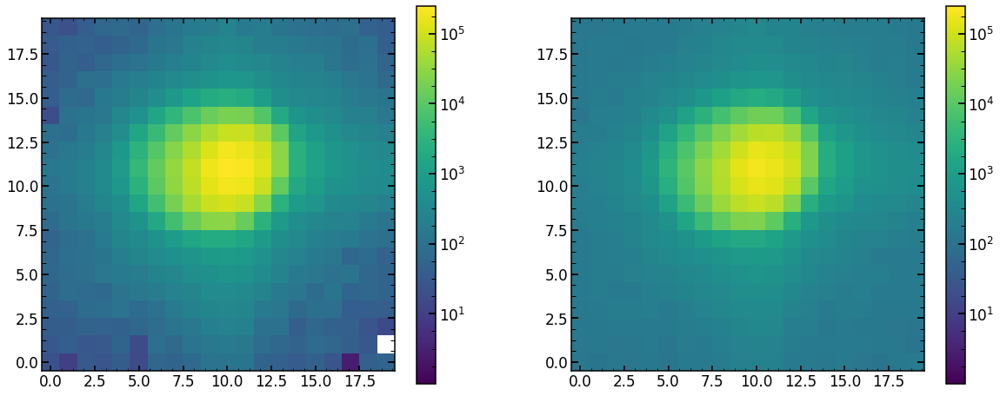

In [440]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [441]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 12898.984987303402
minimal chi2 reduced is: 64.45324367641217


In [442]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
         z4       z5        z6        z7        z8        z9       z10  \
0 -2.372383 -0.40196 -0.444802  0.239275 -0.614848  0.081714 -0.343594   

        z11  
0 -0.170265  
        z12      z13      z14       z15       z16       z17       z18  \
0 -0.119663  0.04565  0.15145  0.034687  0.012221 -0.066987  0.037362   

        z19       z20       z21  
0 -0.005067 -0.009562  0.006584  
       z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0 -0.00575  0.688363   0.085638  0.137798 -0.057212  0.057372     0.000928   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000022             0.000022  0.971076    ...       0.09278   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.996967  0.971975           -0.563239   94396.656634   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0           2.22102              0.001626      0.355125  1.837777  0.9942

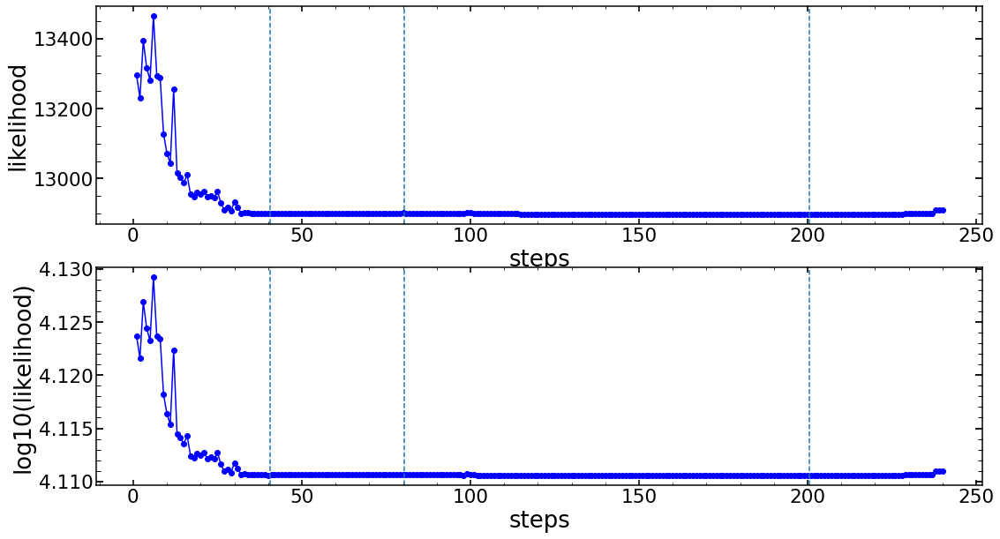

In [443]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [444]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

None
zmax: 22


-12898.984987303395

In [445]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

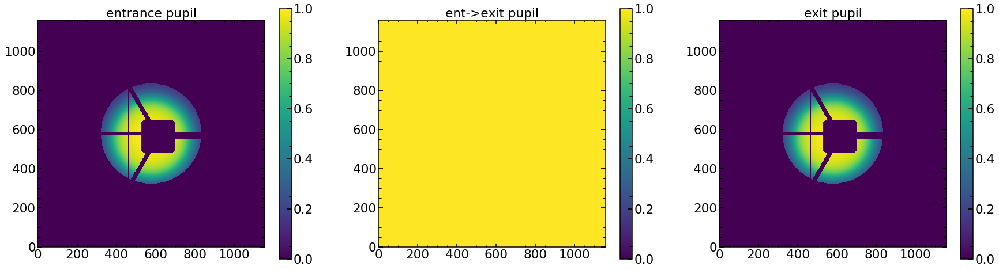

In [446]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

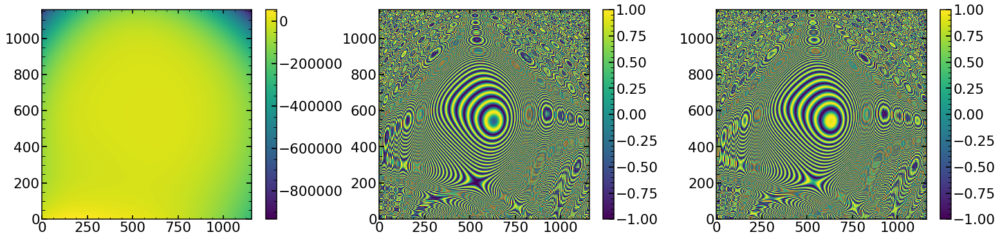

In [447]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

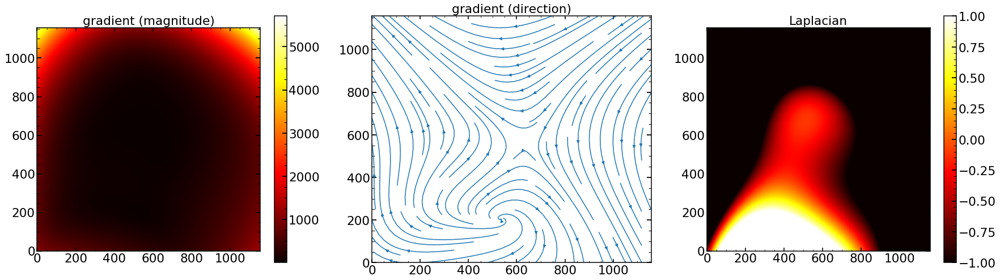

In [448]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

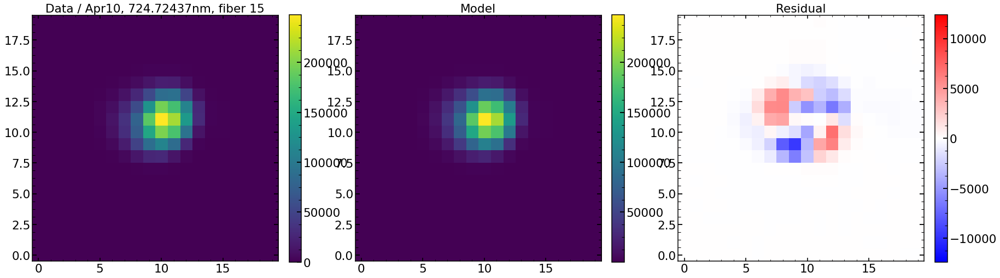

In [449]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 64.453244161082
Abs of residual divided by total flux is: 0.04897976163244231
Abs of residual divided by largest value of a flux in the image is: 0.038923695608661275


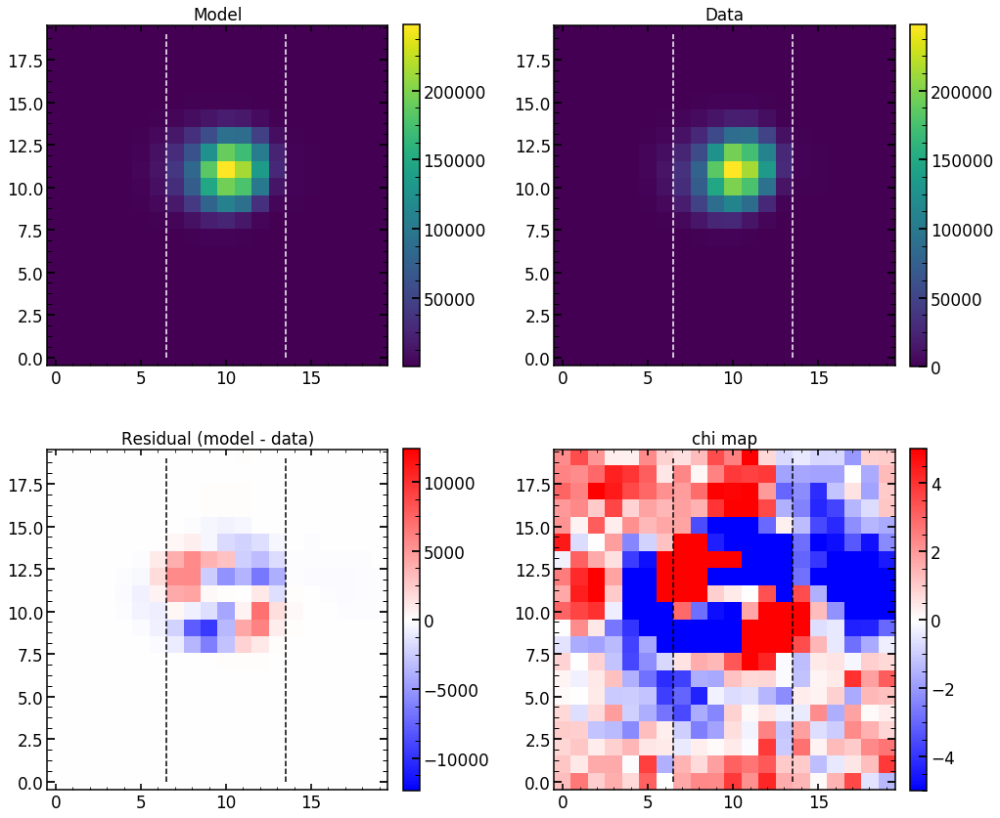

In [450]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

64.453244161082
chi**2 reduced is: 64.453244161082
Abs of residual divided by total flux is: 0.04897976163244231
Abs of residual divided by largest value of a flux in the image is: 0.038923695608661275


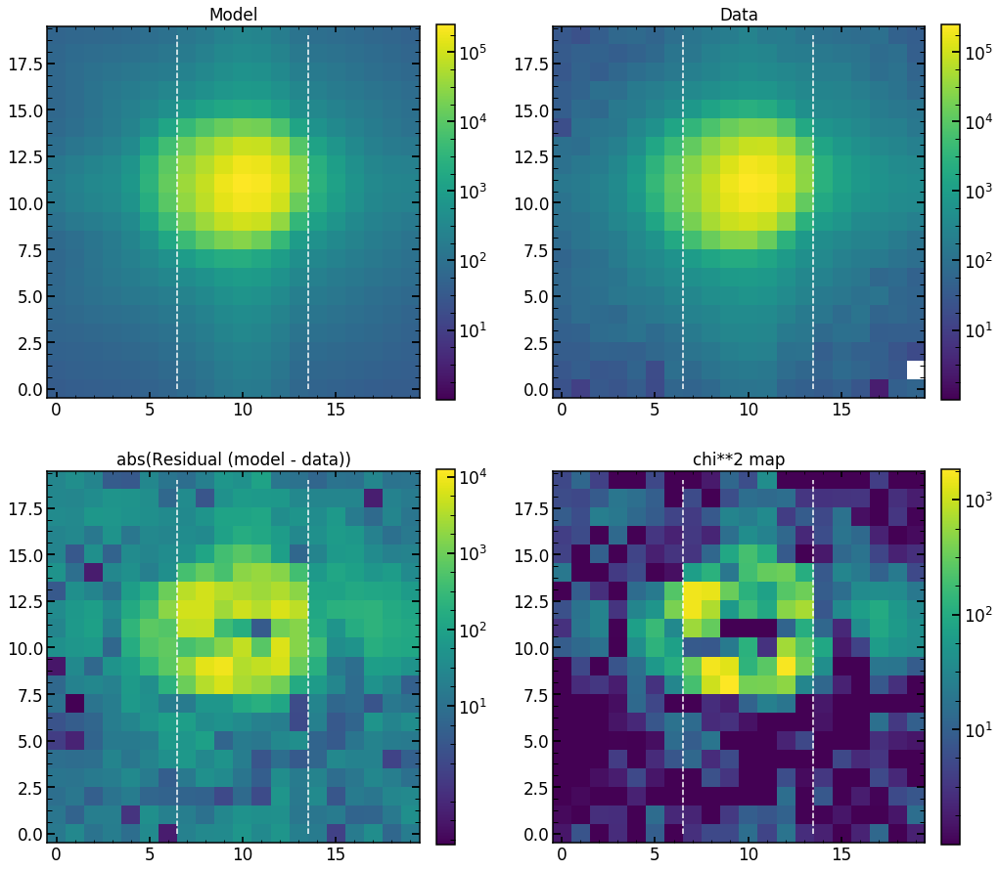

In [451]:
single_analysis.create_basic_comparison_plot_log()

64.453244161082
chi**2 reduced is: 64.453244161082
Abs of residual divided by total flux is: 0.04897976163244231
Abs of residual divided by largest value of a flux in the image is: 0.038923695608661275


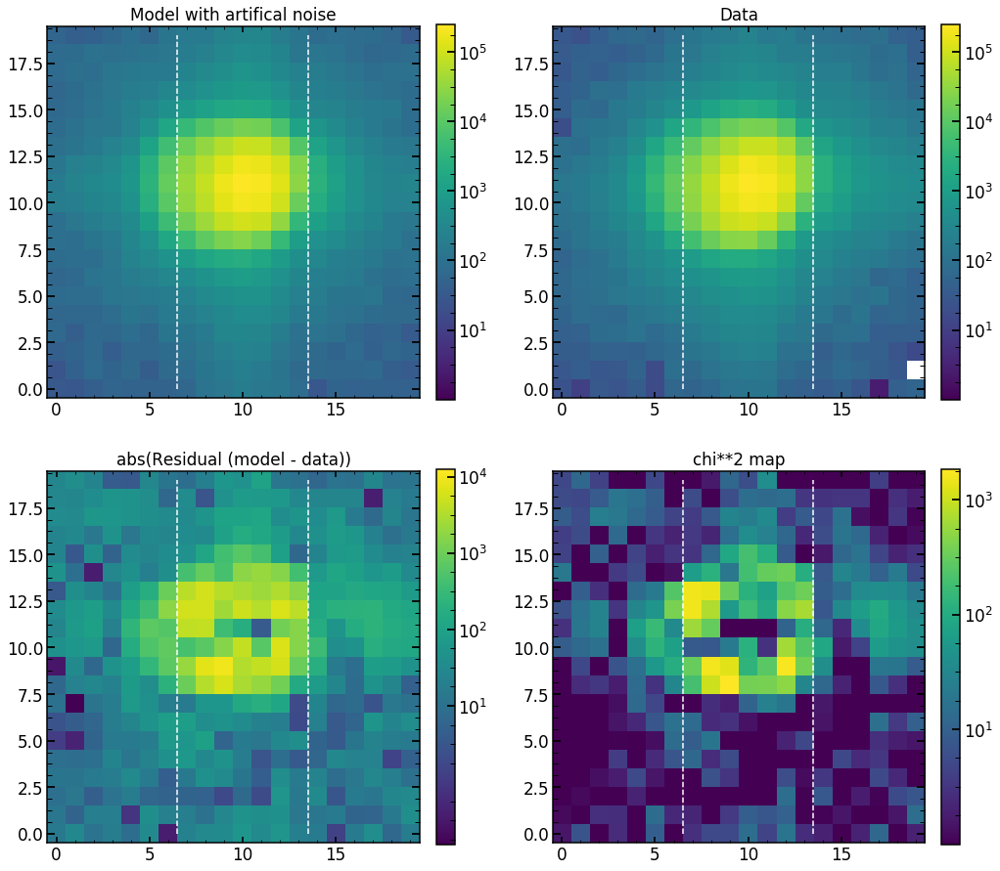

In [452]:
single_analysis.create_basic_comparison_plot_log_artifical()

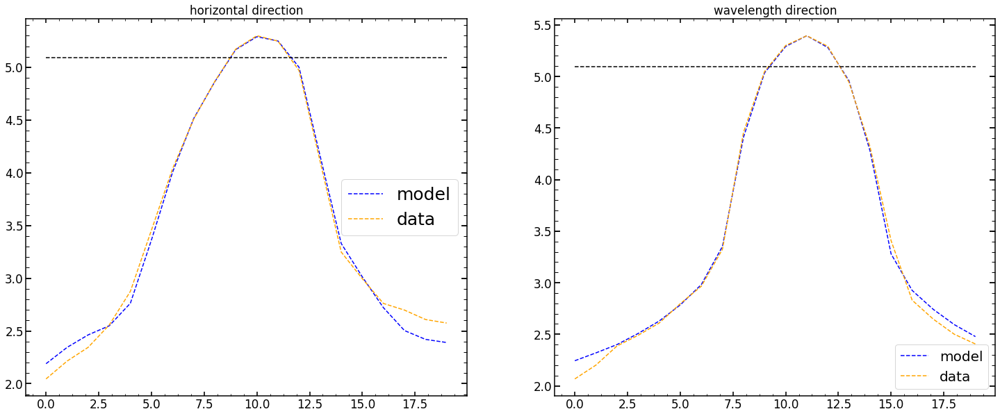

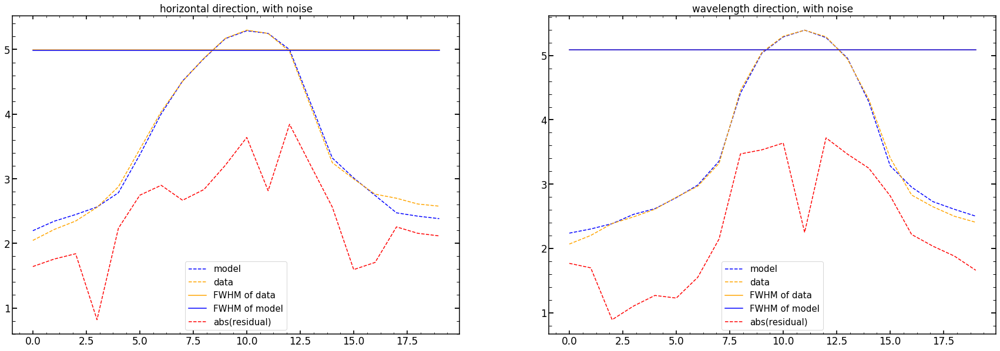

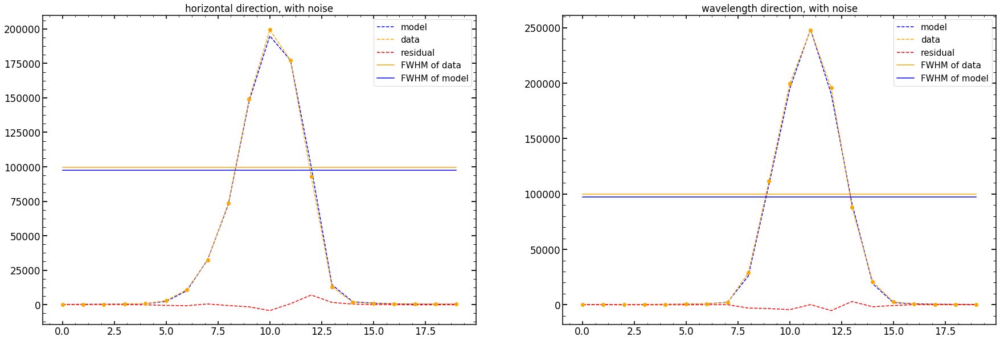

In [453]:
single_analysis.create_cut_plots()

Text(19.5,1700,'$\\chi^{2}_{40000}$=9.03')

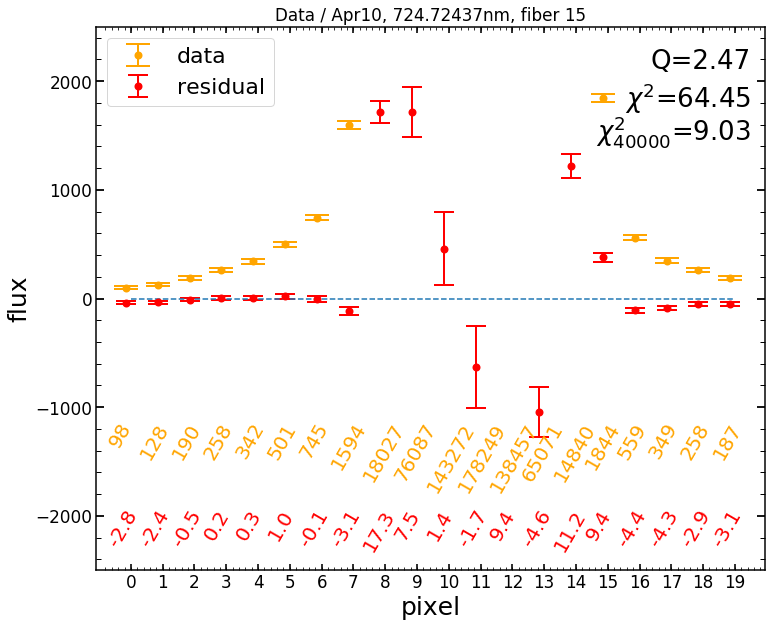

In [454]:
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.legend(loc=2, fontsize=22)
plt.plot(np.zeros(20),'--')
plt.ylim(-2500,2500)
plt.ylabel('flux',size=25)
plt.xlabel('pixel',size=25)
plt.xticks(range(20))




for i in range(20):
    plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')
    
for i in range(20):
    plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
difference_from_max=range(20)-position_of_max_flux
pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2=np.mean((res_iapetus-sci_image)**2/var_image)

plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

## Creating  results everywhere

In [387]:
assert date=='Apr10'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)


results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

In [388]:
columns_analysis=columns22_analysis

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus(date,single_number,'HgAr',22)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]


for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus(date,single_number,'Ne',22)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]


22
0 11748 HgAr is NOT found or failed!
22
1 obs (Emcee3): 11748 is found!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z21: failed!
z22: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z21: failed!
z22: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
2 11748 HgAr is NOT found or failed!
22
3 11748 HgAr is NOT found or failed!
22
4 11748 HgAr is NOT found or failed!
22
5 11748 HgAr is NOT found or failed!
22
6 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z11: failed!

z12: failed!
z13: failed!
z14: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
55 11748 HgAr is NOT found or failed!
22
56 11748 HgAr is NOT found or failed!
22
57 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z20: failed!
z21: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: 

det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z8: failed!
z13: failed!
z15: failed!
z19: failed!
strutFrac: failed!
dxFocal: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
84 11748 HgAr is NOT found or failed!
22
85 obs (Emcee3): 11748 is found!
z7: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z7: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
86 11748 HgAr is NOT found or failed!
22
87 11748 HgAr is

z5: failed!
z6: failed!
z7: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
118 11748 HgAr is NOT found or failed!
22
119 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z17: failed!
z18: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z

z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z17: failed!
z18: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z17: failed!
z18: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
154 11748 HgAr is NOT found or failed!
22
155 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z16: failed!
z18: failed!
z21: failed!
strutFrac: failed!
x_ilum: failed!
y_ilum: failed!
fr

z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
190 11748 HgAr is NOT found or failed!
22
191 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
x_ilum: fa

z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
39 12355 Ne is NOT found or failed!
22
40 12355 Ne is NOT found or failed!
22
41 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z18: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14:

z16: failed!
z18: failed!
z19: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
61 12355 Ne is NOT found or failed!
22
62 12355 Ne is NOT found or failed!
22
63 12355 Ne is NOT found or failed!
22
64 12355 Ne is NOT found or failed!
22
65 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z15: failed!
z1

z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
88 12355 Ne is NOT found or failed!
22
89 12355 Ne is NOT found or failed!
22
90 12355 Ne is NOT found or failed!
22
91 12355 Ne is NOT found or failed!
22
92 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_

z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z18: failed!
z20: failed!
z22: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z18: failed!
z20: failed!
z22: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
120 12355 Ne is NOT found or failed!
22
121 12355 Ne is NOT found or failed!
22
122 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z17: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscF

z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z20: failed!
z21: failed!
z22: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
22
141 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z18: failed!
z19: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z18: failed!
z19: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed

In [391]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.859826,0.236280,-0.033552,0.686051,0.949743,0.137787,-0.380348,0.030015,-0.083529,-0.049913,...,1.001908,0.572610,44438.763196,2.220119,0.001124,0.377759,1.843823,0.995767,8.877501,1450.387695
6,2.625487,-0.060308,0.362704,0.257988,0.784861,-0.039106,-0.184384,-0.133091,-0.154234,-0.001554,...,0.990302,0.572574,38009.927196,2.047024,0.000728,0.374493,1.846458,0.998696,3.209245,1304.506836
9,2.572410,-0.909315,0.031676,-0.218511,0.752755,-0.201903,-0.277715,0.142086,-0.051083,0.128430,...,1.026507,0.575702,32585.822075,2.311808,0.001847,0.350000,1.780107,0.995797,36.448697,7273.361328
11,2.725841,-1.022394,-0.167691,-0.263555,0.995135,-0.331050,-0.428289,0.442634,0.088664,0.176116,...,1.062441,0.578220,14171.473769,2.285756,0.002484,0.350000,1.783294,0.989844,4.548845,403.180481
13,2.508171,0.487434,-0.142557,0.617231,0.757621,0.040873,-0.416486,-0.115176,-0.098657,-0.094798,...,1.009698,0.506430,57417.045326,2.289487,0.001515,0.354687,1.780094,0.999398,2.524767,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.255461,0.033744,-0.629071,-0.172021,-0.340589,-0.271106,-0.155602,0.353440,-0.060079,-0.135477,...,1.046728,-0.506695,23138.242530,1.744376,0.000575,0.800000,1.979946,0.988223,3.328986,262.233856
181,-2.389121,-0.598924,-0.439284,0.371822,-0.606909,0.103480,-0.195330,-0.090693,-0.104608,0.128172,...,0.978547,-0.568257,84382.782835,2.169439,0.001849,0.350000,1.827434,0.997453,2.586625,757.888306
186,-2.752694,-0.274451,-0.479535,0.050201,-0.485559,-0.109335,-0.380788,-0.126672,-0.123845,-0.062197,...,0.966489,-0.566055,26738.281846,1.674940,0.000220,0.412500,1.781855,0.995271,3.773395,612.405029
189,-2.873701,0.004776,-0.616135,-0.204856,-0.611618,-0.312008,-0.346324,0.135822,-0.105554,-0.180718,...,1.002161,-0.566327,58464.960863,2.029991,0.000967,0.609338,1.979975,0.990054,29.277315,2839.623047


In [392]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,3.378827,0.623078,-0.212063,0.787147,1.059941,0.211650,-0.530533,0.082212,-0.062914,-0.128922,...,1.014399,0.578275,46162.373429,2.454504,0.002533,0.390681,1.781837,0.998750,8.430027,5756.716797
5,2.957042,0.890268,0.185897,0.463414,0.903295,0.257494,-0.210565,0.013922,-0.040745,-0.230984,...,1.001977,0.577316,31136.491607,2.036620,0.000608,0.426940,1.809361,0.987583,122.672271,9594.016602
6,3.011839,0.484251,0.074608,0.539431,0.903933,0.101583,-0.289582,-0.090637,-0.120705,-0.109690,...,0.995495,0.576677,38131.918182,2.282511,0.001398,0.369474,1.796361,0.998348,4.086975,1909.174683
11,2.863655,0.632107,-0.348732,0.798330,0.809953,0.074955,-0.529142,0.001030,-0.060489,-0.104611,...,1.022426,0.511781,56397.235067,2.415577,0.002504,0.358946,1.797397,0.999349,4.458231,5175.567383
14,2.681294,0.517959,-0.162603,0.640199,0.764143,0.036375,-0.424021,-0.111049,-0.104352,-0.095051,...,1.009853,0.511136,56556.136892,2.419687,0.002347,0.354088,1.780079,0.998907,11.833506,8799.631836
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,-2.220522,-0.500746,-0.372661,0.225295,-0.552684,0.141169,-0.275262,-0.178143,-0.092409,0.063211,...,0.981479,-0.502692,93724.459665,2.344802,0.002137,0.362500,1.808914,0.995165,70.710175,14028.757812
137,-2.083211,-0.627818,-0.650191,0.464161,-0.632358,0.179636,-0.036662,0.013629,-0.081215,0.138734,...,0.993186,-0.564802,64298.750449,2.228641,0.002066,0.350000,1.816535,0.998551,5.977837,3200.388672
140,-2.244893,-0.645315,-0.514777,0.383402,-0.608211,0.108359,-0.141938,-0.073585,-0.117985,0.125994,...,0.980359,-0.563865,68669.044203,2.358214,0.002734,0.351360,1.811546,0.998174,10.974550,5066.739258
141,-2.333614,-0.619499,-0.400343,0.332457,-0.606756,0.054816,-0.218222,-0.133030,-0.129017,0.101038,...,0.973554,-0.563238,64468.524987,2.442106,0.003393,0.350000,1.811595,0.997956,2.997113,978.778259


In [393]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/' + 'results_of_fit_many_direct_HgAr_from_Apr10.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/' + 'results_of_fit_many_direct_Ne_from_Apr10.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

## verification

In [394]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr10'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns


# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/0p/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z9/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z13/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr10/Plane/z14/
Images are in folder: /Users/nevencaplar/Documents/PFS/Imag

<Figure size 864x720 with 0 Axes>

## Quality control

In [752]:
date='Apr10'

assert date=='Apr10'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr10.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr10.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

### just plotting

In [753]:

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)    

    
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
    plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
    plt.legend(loc=2, fontsize=22)
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))




    for i in range(20):
        plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')

    for i in range(20):
        plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

    plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2=np.mean((res_iapetus-sci_image)**2/var_image)

    plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

    plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/Apr10/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()
    
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
    plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
    plt.legend(loc=2, fontsize=22)
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))




    for i in range(20):
        plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')

    for i in range(20):
        plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

    plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2=np.mean((res_iapetus-sci_image)**2/var_image)

    plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

    plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/Apr10/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()    

None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
z

<Figure size 864x720 with 0 Axes>

### calculating and global plot

In [411]:
res_HgAr=[]
res_HgAr_chi=[]

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
        
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_HgAr.append(Q)
    res_HgAr_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))
  
res_Ne=[]
res_Ne_chi=[]
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_Ne.append(Q)
    res_Ne_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))

None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
z

In [412]:
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr10'
zMax=22
descriptions='Q'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii

    max_colors=10
    min_colors=1         



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'Q'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'Q'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'Q'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

In [413]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr10'
zMax=22
descriptions='$\chi^{2}$'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr_chi

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne_chi

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii

    max_colors=10
    min_colors=1           



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=20,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'res_chi'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'chi_res'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'chi_res'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

# Apr 11 - defocus

## creating scripts

In [1051]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0p'].index.values
list_of_Ne_to_analyze=results_of_fit_many_Ne['0p'].index.values

list_of_Ne_to_analyze

array([  2,   5,   6,  11,  14,  15,  38,  41,  42,  47,  50,  51,  56,
        59,  60,  65,  68,  69,  74,  77,  78,  83,  86,  87,  92,  95,
        96, 101, 104, 105, 110, 113, 114, 119, 122, 123, 124, 128, 131,
       132, 133, 137, 140, 141, 142])

In [645]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T03S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI05.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger03'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T03S'+str(single_spot)+'Apr.sh \n')

file.close()

In [1052]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T04S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI05.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger04'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T04S'+str(single_spot)+'Apr.sh \n')

file.close()

## Looking at the single image

### which images are avaliable

In [646]:
date='Apr11'

import glob
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/chain'+str(date)+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/chain'+str(date)+'_Single_P_*5HgArEmcee3.npy', recursive=True)

In [647]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[i])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [648]:
single_string

'1179671'

In [649]:
arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [650]:
arranged_by_spot_number_HgAr

array([[11700,     1],
       [11760,     1],
       [11730,     1],
       ...,
       [11754,   191],
       [11790,   191],
       [11784,   191]])

### continue

In [39]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr11'
obs=11796
single_number='66'
image_index=int(single_number)
eps=5
arc='HgAr'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m4


fiber                           5
xc                           1525
yc                           1957
wavelength               795.0522
close                           1
lamp                         HgAr
xc_effective                 1525
old_index_approx               42
superold_index_approx        53.0
Name: 66, dtype: object

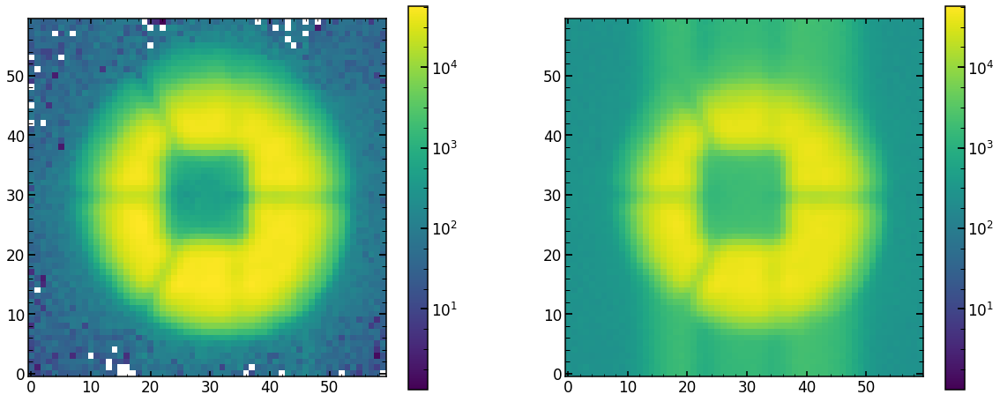

In [40]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [41]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 62739.10080159347
minimal chi2 reduced is: 34.849765567588484


In [42]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6        z7        z8        z9       z10  \
0  30.132393 -0.397038 -0.784116  0.312318  0.107413 -0.105132 -0.299211   

        z11  
0 -0.327896  
        z12       z13       z14       z15       z16       z17       z18  \
0 -0.060337 -0.025542  0.041518  0.019668  0.012566  0.047293  0.020438   

        z19       z20    z21  
0 -0.022528 -0.002755  0.031  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.048469  0.682374   0.079125 -0.058149  0.020144  0.059626      0.02078   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000004             0.000004  0.973495    ...      0.053531   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.917457  1.018683            0.180201   62146.224927   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.668407              0.006933      0.428649  1.824391  0.

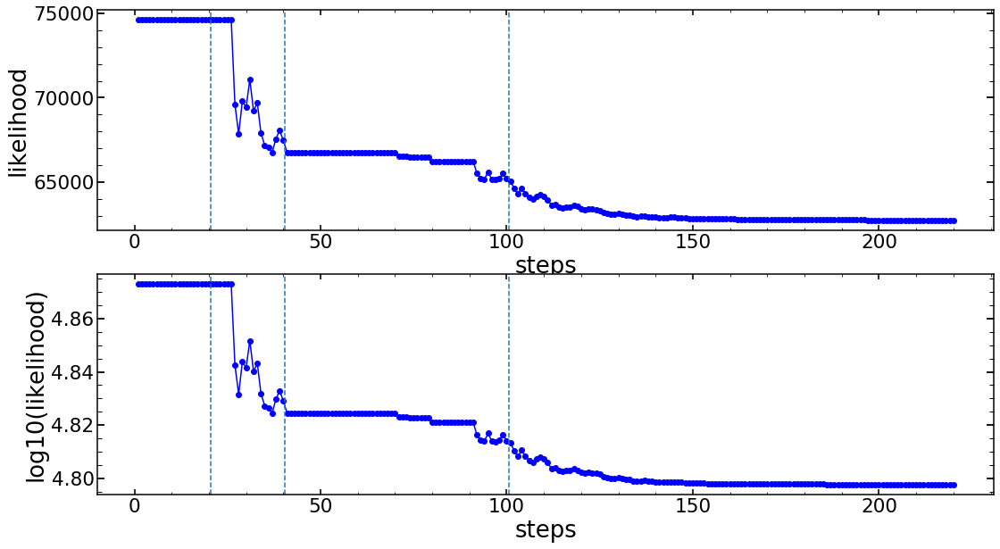

In [43]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [44]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

None
zmax: 22


-62739.576052485136

In [45]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

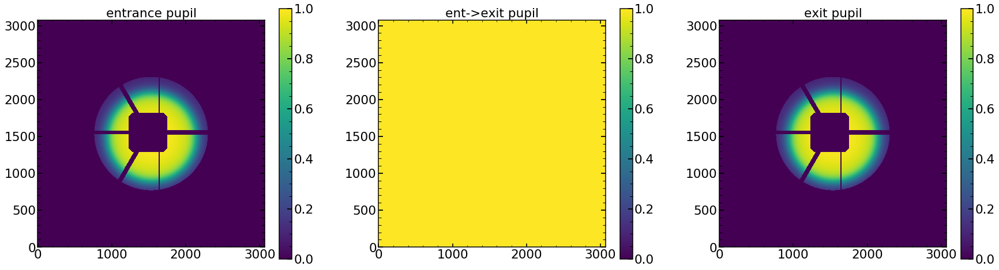

In [46]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

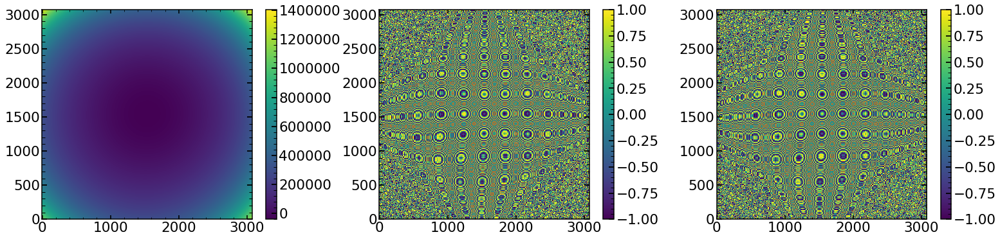

In [47]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

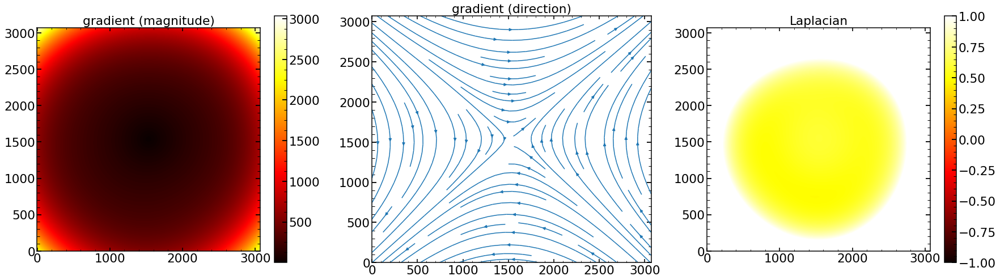

In [48]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

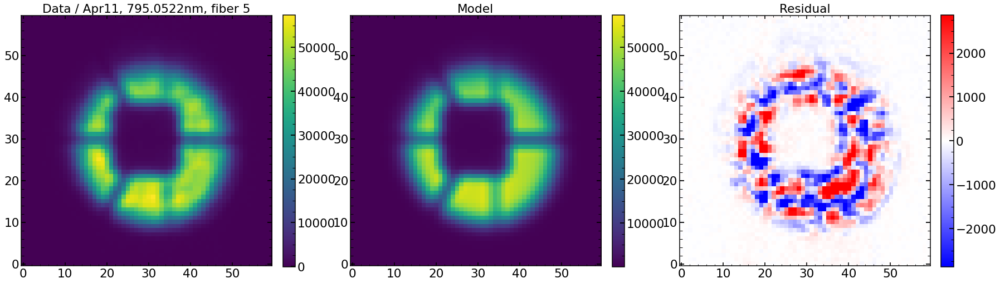

In [49]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 34.85002964654415
Abs of residual divided by total flux is: 0.04704960001792491
Abs of residual divided by largest value of a flux in the image is: 0.1117545736046072


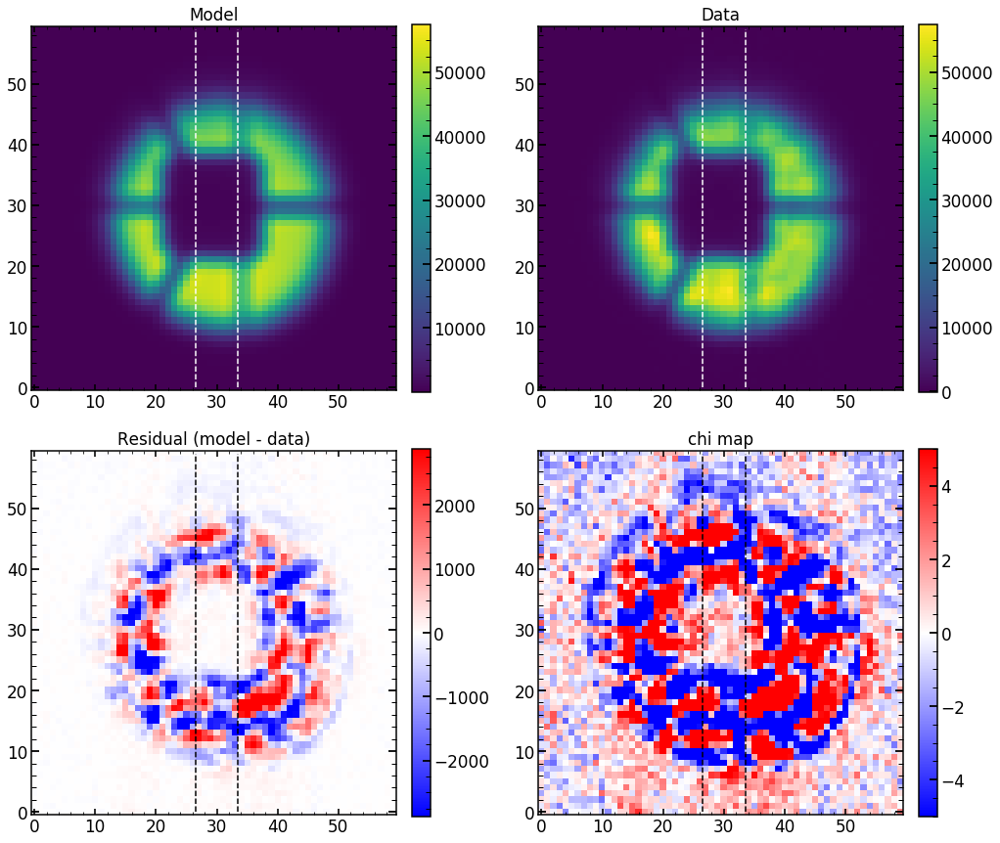

In [50]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

34.85002964654415
chi**2 reduced is: 34.85002964654415
Abs of residual divided by total flux is: 0.04704960001792491
Abs of residual divided by largest value of a flux in the image is: 0.1117545736046072


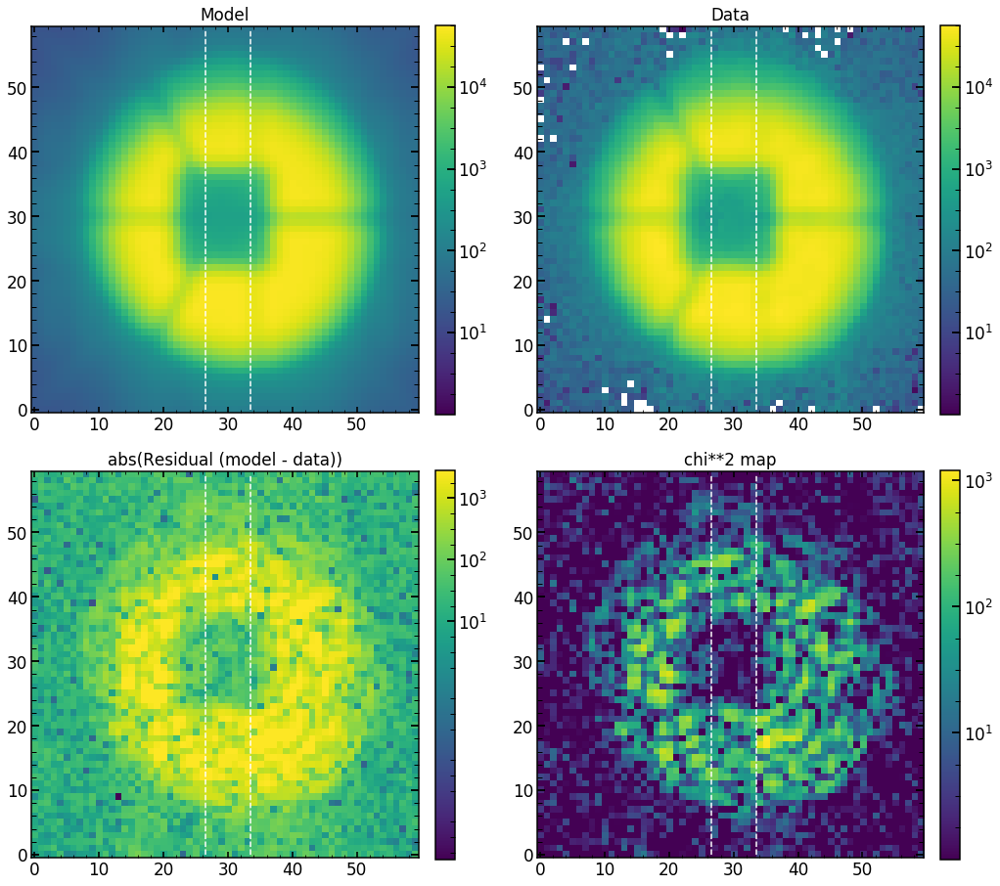

In [51]:
single_analysis.create_basic_comparison_plot_log()

34.85002964654415
chi**2 reduced is: 34.85002964654415
Abs of residual divided by total flux is: 0.04704960001792491
Abs of residual divided by largest value of a flux in the image is: 0.1117545736046072


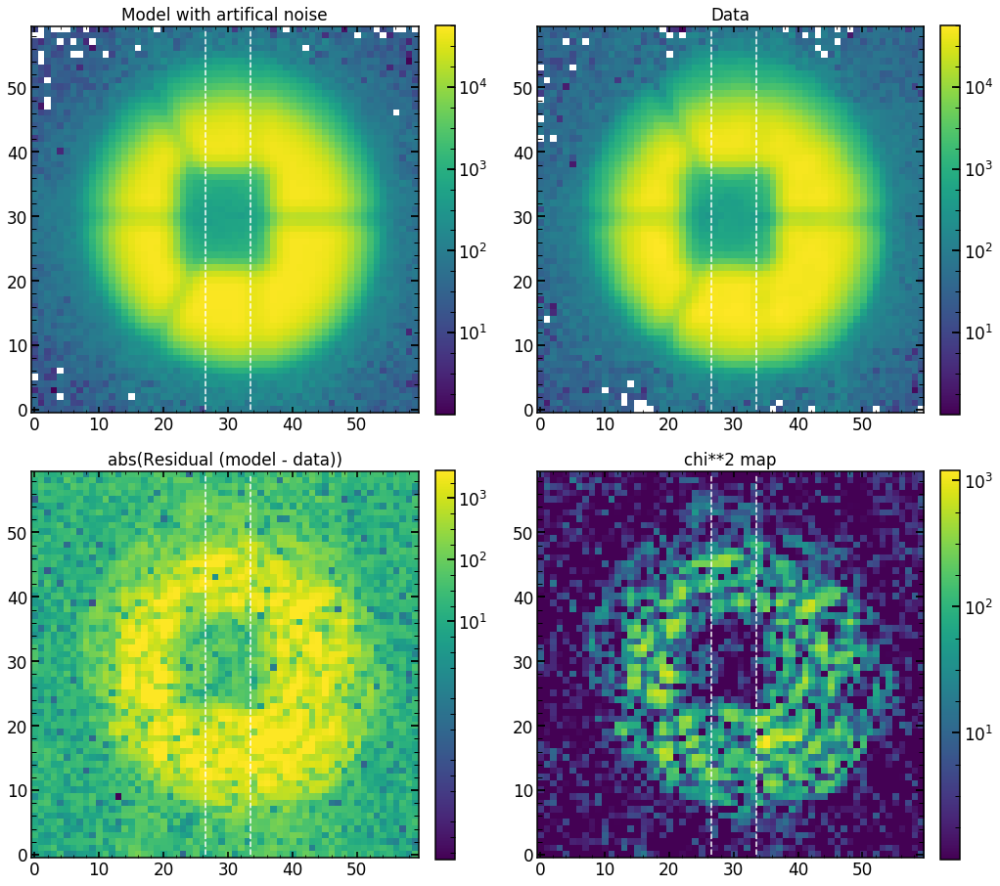

In [52]:
single_analysis.create_basic_comparison_plot_log_artifical()

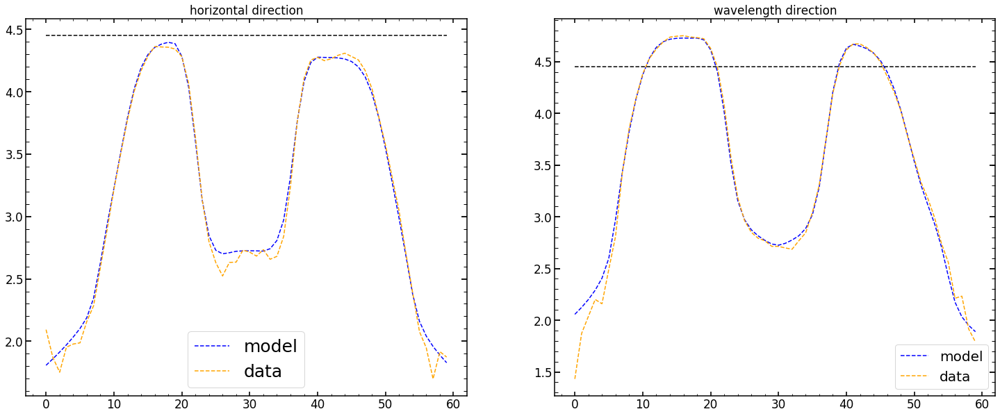

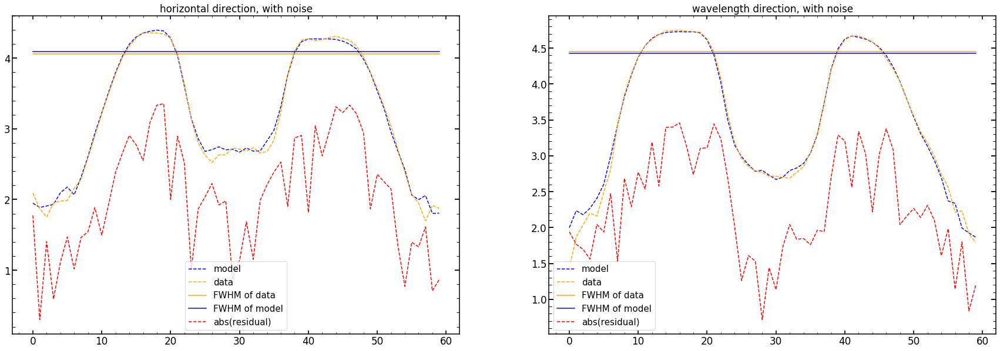

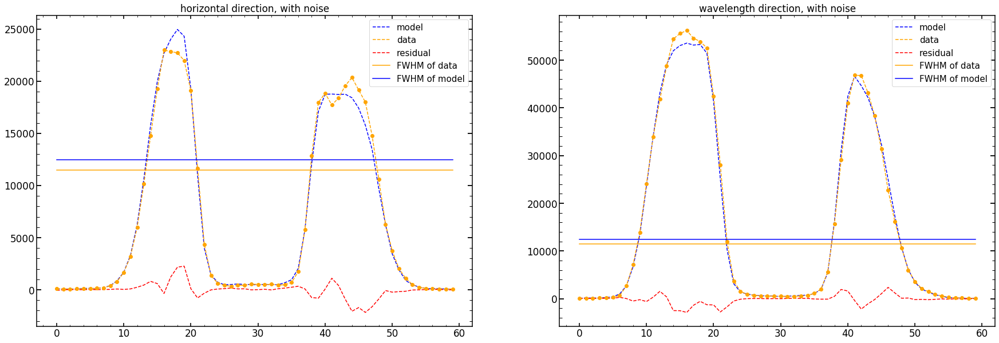

In [53]:
single_analysis.create_cut_plots()

## Creation of pandas dataframe

In [666]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('Apr11',single_number,'HgAr',22)
    solution_at_0=solution_at_0_and_plots('Apr11',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]



22
0 11796 HgAr is NOT found or failed!
0 11790 HgAr is NOT found or failed!
0 11784 HgAr is NOT found or failed!
0 11778 HgAr is NOT found or failed!
0 11772 HgAr is NOT found or failed!
0 11766 HgAr is NOT found or failed!
0 11760 HgAr is NOT found or failed!
0 11754 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11694 HgAr is NOT found or failed!
0 11700 HgAr is NOT found or failed!
0 11706 HgAr is NOT found or failed!
0 11712 HgAr is NOT found or failed!
0 11718 HgAr is NOT found or failed!
0 11724 HgAr is NOT found or failed!
0 11730 HgAr is NOT found or failed!
0 11736 HgAr is NOT found or failed!
22
1 11796 HgAr is NOT found or failed!
1 11790 HgAr is NOT found or failed!
1 11784 HgAr is NOT found or failed!
1 11778 HgAr is NOT found or failed!
1 11772 HgAr is NOT found or failed!
1 11766 HgAr is NOT found or failed!
1 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slit

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
6 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
6 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
s

x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11 obs (Emcee3): 11748 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: fa

dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
18 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
18 11778 HgAr is NOT found or failed!
18 11772 HgAr is NOT found or failed!
18 11766 HgAr is NOT found or failed!
18 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
18 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: fai

slitFrac: failed!
y_ilum: failed!
det_vert: failed!
slitFrac: failed!
y_ilum: failed!
det_vert: failed!
21 11736 HgAr is NOT found or failed!
22
22 11796 HgAr is NOT found or failed!
22 11790 HgAr is NOT found or failed!
22 11784 HgAr is NOT found or failed!
22 11778 HgAr is NOT found or failed!
22 11772 HgAr is NOT found or failed!
22 11766 HgAr is NOT found or failed!
22 11760 HgAr is NOT found or failed!
22 11754 HgAr is NOT found or failed!
22 11748 HgAr is NOT found or failed!
22 11748 HgAr is NOT found or failed!
22 11694 HgAr is NOT found or failed!
22 11700 HgAr is NOT found or failed!
22 11706 HgAr is NOT found or failed!
22 11712 HgAr is NOT found or failed!
22 11718 HgAr is NOT found or failed!
22 11724 HgAr is NOT found or failed!
22 11730 HgAr is NOT found or failed!
22 11736 HgAr is NOT found or failed!
22
23 obs (Emcee3): 11796 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_v

22
39 11796 HgAr is NOT found or failed!
39 11790 HgAr is NOT found or failed!
39 11784 HgAr is NOT found or failed!
39 11778 HgAr is NOT found or failed!
39 11772 HgAr is NOT found or failed!
39 11766 HgAr is NOT found or failed!
39 11760 HgAr is NOT found or failed!
39 11754 HgAr is NOT found or failed!
39 11748 HgAr is NOT found or failed!
39 11748 HgAr is NOT found or failed!
39 11694 HgAr is NOT found or failed!
39 11700 HgAr is NOT found or failed!
39 11706 HgAr is NOT found or failed!
39 11712 HgAr is NOT found or failed!
39 11718 HgAr is NOT found or failed!
39 11724 HgAr is NOT found or failed!
39 11730 HgAr is NOT found or failed!
39 11736 HgAr is NOT found or failed!
22
40 11796 HgAr is NOT found or failed!
40 11790 HgAr is NOT found or failed!
40 11784 HgAr is NOT found or failed!
40 11778 HgAr is NOT found or failed!
40 11772 HgAr is NOT found or failed!
40 11766 HgAr is NOT found or failed!
40 11760 HgAr is NOT found or failed!
40 11754 HgAr is NOT found or failed!
40 117

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
49 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
49 obs (Emcee3): 11694 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
49 obs (Emcee3): 11700 is found

slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
54 obs (Emcee3): 11730 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
54 obs (Emcee3): 11736 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_

det_vert: failed!
slitHolder_frac_dx: failed!
59 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
59 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
59 obs (Emcee3): 11694 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometric

strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
66 obs (Emcee3): 11790 is found!
slitFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
slitFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
66 11784 HgAr is NOT found or failed!
66 11778 HgAr is NOT found or failed!
66 11772 HgAr is NOT found or failed!
66 11766 HgAr is NOT found or failed!
66 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
66 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
sli

69 obs (Emcee3): 11730 is found!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
69 obs (Emcee3): 11736 is found!
hscFrac: failed!
strutFrac: failed!
y_ilum: failed!
hscFrac: failed!
strutFrac: failed!
y_ilum: failed!
22
70 11796 HgAr is NOT found or failed!
70 11790 HgAr is NOT found or failed!
70 11784 HgAr is NOT found or failed!
70 11778 HgAr is NOT found or failed!
70 11772 HgAr is NOT found or failed!
70 11766 HgAr is NOT found or failed!
70 11760 HgAr is NOT found or failed!
70 11754 HgAr is NOT found or failed!
70 11748 HgAr is NOT found or failed!
70 11748 HgAr is NOT found or failed!
70 11694 HgAr is NOT found or failed!
70 11700 HgAr is NOT found or failed!
70 11706 HgAr is NOT found or failed!
70 11712 HgAr is NOT found or failed!
70 11718 HgAr is NOT found or failed!
70 11724 HgAr is NOT found or failed!
70 11730 HgAr i

x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
73 11706 HgAr is NOT found or failed!
73 11712 HgAr is NOT found or failed!
73 11718 HgAr is NOT found or failed!
73 11724 HgAr is NOT found or failed!
73 obs (Emcee3): 11730 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
73 11736 HgAr is NOT found or failed!
22
74 11796 HgAr is NOT found or failed!
74 11790 HgAr is NOT found or failed!
74 11784 HgAr is NOT found or failed!
74 11778 HgAr is NOT found or failed!
74 11772 HgAr is NOT found or failed!
74 11766 HgAr is NOT found or failed!
74 11760 HgAr is NOT found or failed!
74 11754 HgAr is NOT found or failed!
74 11748 HgAr is NOT found or failed!
74 11748 HgAr is NOT found or failed!
74 11694 HgAr is NOT found or failed!
74 11700 HgAr is NOT found or failed!
74 11706 HgAr is NOT found or failed!
74 117

det_vert: failed!
slitHolder_frac_dx: failed!
81 obs (Emcee3): 11790 is found!
hscFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
81 11784 HgAr is NOT found or failed!
81 11778 HgAr is NOT found or failed!
81 11772 HgAr is NOT found or failed!
81 11766 HgAr is NOT found or failed!
81 obs (Emcee3): 11760 is found!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
81 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: fai

slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
83 11736 HgAr is NOT found or failed!
22
84 11796 HgAr is NOT found or failed!
84 11790 HgAr is NOT found or failed!
84 11784 HgAr is NOT found or failed!
84 11778 HgAr is NOT found or failed!
84 11772 HgAr is NOT found or failed!
84 11766 HgAr is NOT found or failed!
84 11760 HgAr is NOT found or failed!
84 11754 HgAr is NOT found or failed!
84 11748 HgAr is NOT found or failed!
84 11748 HgAr is NOT found or failed!
84 11694 HgAr is NOT found or failed!
84 11700 HgAr is NOT found or failed!
84 11706 HgAr is NOT found or failed!
84 11712 HgAr is NOT found or failed!
84 11718 HgAr is NOT found or failed!
84 11724 HgAr is NOT found or failed!
84 11730 HgAr is NOT found or failed!
84 11736 HgAr is NOT found or failed!
22
85 11796 HgAr is NOT found or failed!
85 obs (Emcee3): 11790 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!

90 11778 HgAr is NOT found or failed!
90 11772 HgAr is NOT found or failed!
90 11766 HgAr is NOT found or failed!
90 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
90 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
90 obs (Emcee3): 11748 is found!

95 obs (Emcee3): 11784 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
y_ilum: failed!
det_vert: failed!
95 11778 HgAr is NOT found or failed!
95 11772 HgAr is NOT found or failed!
95 11766 HgAr is NOT found or failed!
95 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
95 obs (Emcee3): 11754 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFo

dyFocal: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
102 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
det_vert: failed!
102 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
102 11778 HgAr is NOT found or failed!
102 11772 HgAr is NOT found or failed!
102 11766 HgAr is NOT found or failed!
102 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExpone

107 obs (Emcee3): 11790 is found!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
107 obs (Emcee3): 11784 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
107 11778 HgAr is NOT found or failed!
107 11772 HgAr is NOT found or failed!
107 11766 HgAr is NOT found or failed!
107 obs (Emcee3): 11760 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitH

22
110 11796 HgAr is NOT found or failed!
110 11790 HgAr is NOT found or failed!
110 11784 HgAr is NOT found or failed!
110 11778 HgAr is NOT found or failed!
110 11772 HgAr is NOT found or failed!
110 11766 HgAr is NOT found or failed!
110 11760 HgAr is NOT found or failed!
110 11754 HgAr is NOT found or failed!
110 11748 HgAr is NOT found or failed!
110 11748 HgAr is NOT found or failed!
110 11694 HgAr is NOT found or failed!
110 11700 HgAr is NOT found or failed!
110 11706 HgAr is NOT found or failed!
110 11712 HgAr is NOT found or failed!
110 11718 HgAr is NOT found or failed!
110 11724 HgAr is NOT found or failed!
110 11730 HgAr is NOT found or failed!
110 11736 HgAr is NOT found or failed!
22
111 11796 HgAr is NOT found or failed!
111 11790 HgAr is NOT found or failed!
111 11784 HgAr is NOT found or failed!
111 11778 HgAr is NOT found or failed!
111 11772 HgAr is NOT found or failed!
111 11766 HgAr is NOT found or failed!
111 11760 HgAr is NOT found or failed!
111 11754 HgAr is N

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
det_vert: failed!
117 obs (Emcee3): 11784 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
117 11778 HgAr is NOT found or failed!
117 11772 HgAr is NOT found or failed!
117 11766 HgAr is NOT found or failed!
117 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
det_vert: failed!
117 obs (Emcee3): 11754 is found!
hscFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
117 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
det_vert: fail

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
121 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
121 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
121 obs (Emcee3): 11748 is

126 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
126 11706 HgAr is NOT found or failed!
126 11712 HgAr is NOT found or failed!
126 11718 HgAr is NOT found or failed!
126 obs (Emcee3): 11724 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
126 obs (Emcee3): 117

det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
131 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
131 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
138 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
138 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
slitHolder_frac_dx: failed!
138 11778 HgAr is NOT found or failed!
138 11772 HgAr is NOT found or failed!
138 11766 HgAr is NOT found or failed!
138 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum

hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
141 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
det_vert: failed!
141 11736 HgAr is NOT found or failed!
22
142 11796 HgAr is NOT found or failed!
142 11790 HgAr is NOT found or failed!
142 11784 HgAr is NOT found or failed!
142 11778 HgAr is NOT found or failed!
142 11772 HgAr is NOT found or failed!
142 11766 HgAr is NOT found or failed!
142 11760 HgAr is NOT found or failed!
142 11754 HgAr is NOT found or failed!
142 11748 HgAr is NOT found or failed!
142 11748 HgAr is NOT found or failed!
142 11694 HgAr is NOT found or failed!
142 11700 HgAr is NOT found or failed!
142 11706 HgAr is NOT found or failed!
142 11712 HgAr is NOT found or failed!
142 11718 HgAr is NOT found or failed!
142 11724 HgAr is NOT found or failed!
142 11730 HgAr is NOT found or failed!

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
145 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
145 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_i

22
151 11796 HgAr is NOT found or failed!
151 11790 HgAr is NOT found or failed!
151 11784 HgAr is NOT found or failed!
151 11778 HgAr is NOT found or failed!
151 11772 HgAr is NOT found or failed!
151 11766 HgAr is NOT found or failed!
151 11760 HgAr is NOT found or failed!
151 11754 HgAr is NOT found or failed!
151 11748 HgAr is NOT found or failed!
151 11748 HgAr is NOT found or failed!
151 11694 HgAr is NOT found or failed!
151 11700 HgAr is NOT found or failed!
151 11706 HgAr is NOT found or failed!
151 11712 HgAr is NOT found or failed!
151 11718 HgAr is NOT found or failed!
151 11724 HgAr is NOT found or failed!
151 11730 HgAr is NOT found or failed!
151 11736 HgAr is NOT found or failed!
22
152 11796 HgAr is NOT found or failed!
152 11790 HgAr is NOT found or failed!
152 11784 HgAr is NOT found or failed!
152 11778 HgAr is NOT found or failed!
152 11772 HgAr is NOT found or failed!
152 11766 HgAr is NOT found or failed!
152 11760 HgAr is NOT found or failed!
152 11754 HgAr is N

det_vert: failed!
slitHolder_frac_dx: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
155 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
155 11706 HgAr is NOT found or failed!
155 11712 HgAr is NOT found or failed!
155 11718 HgAr is NOT found or failed!
155 obs (Emcee3): 11724 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: fail

dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
162 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
162 11778 HgAr is NOT found or failed!
162 11772 HgAr is NOT found or failed!
162 11766 HgAr is NOT found or failed!
162 obs (Emcee3): 11760 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_i

165 11706 HgAr is NOT found or failed!
165 11712 HgAr is NOT found or failed!
165 11718 HgAr is NOT found or failed!
165 obs (Emcee3): 11724 is found!
hscFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
det_vert: failed!
165 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
radiometricExponent: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
radiometricExponent: failed!
det_vert: failed!
165 obs (Emcee3): 11736 is found!
dxFocal: failed!
dyFocal: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
dxFocal: failed!
dyFocal: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
166 11796 HgAr is NOT found or failed!
166 11790 HgAr is NOT found or failed!
166 11784 HgAr is NOT found or failed!
166 11778 HgAr is NOT found or failed!
166 11772 HgAr is NOT found or failed!
166 11766 HgAr is NOT found or failed!
166 11760 HgAr is NOT found or failed!
1

169 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
169 11706 HgAr is NOT found or failed!
169 11712 HgAr is NOT found or failed!
169 11718 HgAr is NOT found or failed!
169 obs (Emcee3): 11724 is found!
dxFocal: failed!
slitFrac: failed!
y_ilum: failed!
dxFocal: failed!
slitFrac: failed!
y_ilum: failed!
169 obs (Emcee3): 11730 is found!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
169 obs (Emcee3): 11736 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder

slitHolder_frac_dx: failed!
pixel_effect: failed!
177 11790 HgAr is NOT found or failed!
177 obs (Emcee3): 11784 is found!
hscFrac: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitHolder_frac_dx: failed!
177 11778 HgAr is NOT found or failed!
177 11772 HgAr is NOT found or failed!
177 11766 HgAr is NOT found or failed!
177 obs (Emcee3): 11760 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
177 obs (Emcee3): 11754 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: 

181 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
181 11778 HgAr is NOT found or failed!
181 11772 HgAr is NOT found or failed!
181 11766 HgAr is NOT found or failed!
181 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
181 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: faile

186 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
186 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
186 11706 HgAr is NOT found or failed!
186 11712 HgAr is NOT found or failed!
186 11718 HgAr is NOT found or failed!
186 obs (Emcee3

det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
191 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
191 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: f

In [667]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('Apr11',single_number,'Ne',22)
    solution_at_0=solution_at_0_and_plots('Apr11',single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]


22
0 12403 Ne is NOT found or failed!
0 12397 Ne is NOT found or failed!
0 12391 Ne is NOT found or failed!
0 12385 Ne is NOT found or failed!
0 12379 Ne is NOT found or failed!
0 12373 Ne is NOT found or failed!
0 12367 Ne is NOT found or failed!
0 12361 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12349 Ne is NOT found or failed!
0 12343 Ne is NOT found or failed!
0 12337 Ne is NOT found or failed!
0 12331 Ne is NOT found or failed!
0 12325 Ne is NOT found or failed!
0 12319 Ne is NOT found or failed!
0 12313 Ne is NOT found or failed!
0 12307 Ne is NOT found or failed!
22
1 12403 Ne is NOT found or failed!
1 12397 Ne is NOT found or failed!
1 12391 Ne is NOT found or failed!
1 12385 Ne is NOT found or failed!
1 12379 Ne is NOT found or failed!
1 12373 Ne is NOT found or failed!
1 12367 Ne is NOT found or failed!
1 12361 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12349 Ne is 

22
6 obs (Emcee3): 12403 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
6 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
6 12391 Ne is NOT found or failed!
6 12385 Ne is NOT found or failed!
6 12379 Ne is NOT found or failed!
6 12373 Ne is NOT found or failed!
6 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: faile

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent:

det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
15 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
15 obs (Emcee3): 12349 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum:

29 12337 Ne is NOT found or failed!
29 12331 Ne is NOT found or failed!
29 12325 Ne is NOT found or failed!
29 12319 Ne is NOT found or failed!
29 12313 Ne is NOT found or failed!
29 12307 Ne is NOT found or failed!
22
30 12403 Ne is NOT found or failed!
30 12397 Ne is NOT found or failed!
30 12391 Ne is NOT found or failed!
30 12385 Ne is NOT found or failed!
30 12379 Ne is NOT found or failed!
30 12373 Ne is NOT found or failed!
30 12367 Ne is NOT found or failed!
30 12361 Ne is NOT found or failed!
30 12355 Ne is NOT found or failed!
30 12355 Ne is NOT found or failed!
30 12349 Ne is NOT found or failed!
30 12343 Ne is NOT found or failed!
30 12337 Ne is NOT found or failed!
30 12331 Ne is NOT found or failed!
30 12325 Ne is NOT found or failed!
30 12319 Ne is NOT found or failed!
30 12313 Ne is NOT found or failed!
30 12307 Ne is NOT found or failed!
22
31 12403 Ne is NOT found or failed!
31 12397 Ne is NOT found or failed!
31 12391 Ne is NOT found or failed!
31 12385 Ne is NOT fou

slitFrac: failed!
slitFrac_dy: failed!
slitHolder_frac_dx: failed!
38 obs (Emcee3): 12313 is found!
hscFrac: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
38 obs (Emcee3): 12307 is found!
hscFrac: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
39 12403 Ne is NOT found or failed!
39 12397 Ne is NOT found or failed!
39 12391 Ne is NOT found or failed!
39 12385 Ne is NOT found or failed!
39 12379 Ne is NOT found or failed!
39 12373 Ne is NOT found or failed!
39 12367 Ne is NOT found or failed!
39 12361 Ne is NOT found or failed!
39 12355 Ne is NOT found or failed!
39 12355 Ne is NOT found or failed!
39 12349 Ne is NOT found or failed!
39 12343 Ne is NOT found or failed!
39 12337 Ne is NOT found or failed!
39 12331 Ne is NOT found or 

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
42 obs (Emcee3): 12313 is found!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
42 12307 Ne is NOT found or failed!
22
43 12403 Ne is NOT found or failed!
43 12397 Ne is NOT found or failed!
43 12391 Ne is NOT found or failed!
43 12385 Ne is NOT found or failed!
43 12379 Ne is NOT found or failed!
43 12373 Ne is NOT found or failed!
43 12367 Ne is NOT found or failed!
43 12361 Ne is NOT found or failed!
43 12355 Ne is NOT found or failed!
43 12355 Ne is NOT found or failed!
43 12349 Ne is NOT found or failed!
43 12343 Ne is NOT found or failed!
43 12337 Ne is NOT found or failed!
43 12331 Ne is NOT found or failed!
43 12325 Ne is NOT found or failed!
43 

slitHolder_frac_dx: failed!
50 obs (Emcee3): 12361 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
50 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
50 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum:

strutFrac: failed!
slitFrac: failed!
y_ilum: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
56 obs (Emcee3): 12397 is found!
z12: failed!
hscFrac: failed!
slitFrac: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
z12: failed!
hscFrac: failed!
slitFrac: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
56 12391 Ne is NOT found or failed!
56 12385 Ne is NOT found or failed!
56 12379 Ne is NOT found or failed!
56 12373 Ne is NOT found or failed!
56 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
56 obs (Emcee3): 12361 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: fail

strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
60 12391 Ne is NOT found or failed!
60 12385 Ne is NOT found or failed!
60 12379 Ne is NOT found or failed!
60 12373 Ne is NOT found or failed!
60 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
60 obs (Emcee3): 12361 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiom

65 obs (Emcee3): 12349 is found!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
slitHolder_frac_dx: failed!
65 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
radiometricExponent: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
radiometricExponent: failed!
slitHolder_frac_dx: failed!
65 12337 Ne is NOT found or failed!
65 12331 Ne is NOT found or failed!
65 12325 Ne is NOT found or failed!
65 obs (Emcee3): 12319 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
65 obs (Emcee3): 12313 is found!
strutFrac: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
65 obs (Emcee3): 1

dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
69 obs (Emcee3): 12307 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
70 12403 Ne is NOT found or failed!
70 12397 Ne is NOT found or failed!
70 12391 Ne is NOT found or failed!
70 12385 Ne is NOT found or failed!
70 12379 Ne is NOT found or failed!
70 12373 Ne is NOT found or failed!
70 12367 Ne is NOT found or failed!
70 12361 Ne is NOT found or failed!
70 12355 Ne is NOT found or failed!
70 12355 Ne is NOT found or failed!
70 12349 Ne is NOT found or failed!
70 12343 Ne is NOT found or failed!
70 12337 Ne is NOT found or failed!
70 12331 Ne is NOT found or failed!
70 12325 Ne is NOT found or failed!
70 12319 Ne is NOT found or failed

x_ilum: failed!
det_vert: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
det_vert: failed!
77 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
77 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
77 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: f

hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
det_vert: failed!
83 obs (Emcee3): 12397 is found!
hscFrac: failed!
dxFocal: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
det_vert: failed!
83 12391 Ne is NOT found or failed!
83 12385 Ne is NOT found or failed!
83 12379 Ne is NOT found or failed!
83 12373 Ne is NOT found or failed!
83 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
83 obs (Emcee3): 12361 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
83 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
r

x_ilum: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
87 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
87 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
87 obs (Emcee3): 12343 is found!
hscFrac: fa

det_vert: failed!
slitHolder_frac_dx: failed!
92 12313 Ne is NOT found or failed!
92 obs (Emcee3): 12307 is found!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
22
93 12403 Ne is NOT found or failed!
93 12397 Ne is NOT found or failed!
93 12391 Ne is NOT found or failed!
93 12385 Ne is NOT found or failed!
93 12379 Ne is NOT found or failed!
93 12373 Ne is NOT found or failed!
93 12367 Ne is NOT found or failed!
93 12361 Ne is NOT found or failed!
93 12355 Ne is NOT found or failed!
93 12355 Ne is NOT found or failed!
93 12349 Ne is NOT found or failed!
93 12343 Ne is NOT found or failed!
93 12337 Ne is NOT found or failed!
93 12331 Ne is NOT found or failed!
93 12325 Ne is NOT found or failed!
93 12319 Ne is NOT found or failed!
93 12313 Ne is NOT found or failed!
93 12307 Ne is NOT found or failed!
22
94 12403 Ne is NOT found or failed!
94 12397 Ne is NOT found or faile

dxFocal: failed!
slitHolder_frac_dx: failed!
96 obs (Emcee3): 12313 is found!
hscFrac: failed!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
96 obs (Emcee3): 12307 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
det_vert: failed!
22
97 12403 Ne is NOT found or failed!
97 12397 Ne is NOT found or failed!
97 12391 Ne is NOT found or failed!
97 12385 Ne is NOT found or failed!
97 12379 Ne is NOT found or failed!
97 12373 Ne is NOT found or failed!
97 12367 Ne is NOT found or failed!
97 12361 Ne is NOT found or failed!
97 12355 Ne is NOT found or failed!
97 12355 Ne is NOT found or failed!
97 12349 Ne is NOT found or failed!
97 12343 Ne is NOT found or failed!
97 12337 Ne is NOT found or fa

hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
104 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
104 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
104 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
d

hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
110 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
110 obs (Emcee3): 12391 is found!
hscFrac: failed!
dyFocal: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dyFocal: failed!
slitHolder_frac_dx: failed!
110 12385 Ne is NOT found or failed!
110 12379 Ne is NOT found or failed!
110 12373 Ne is NOT found or failed!
110 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
110 obs

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
114 obs (Emcee3): 12361 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
114 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: faile

det_vert: failed!
slitHolder_frac_dx: failed!
119 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
119 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
119 12337 Ne is NOT found or failed!
119 12331 Ne is NOT found or failed!
119 12

123 obs (Emcee3): 12343 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
123 12337 Ne is NOT found or failed!
123 12331 Ne is NOT found or failed!
123 12325 Ne is NOT found or failed!
123 obs (Emcee3): 12319 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
123 12313 Ne is NOT found or failed!
123 obs (Emcee3): 12307 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
de

slitHolder_frac_dx: failed!
128 obs (Emcee3): 12313 is found!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
dyFocal: failed!
radiometricExponent: failed!
det_vert: failed!
128 obs (Emcee3): 12307 is found!
slitFrac_dy: failed!
slitHolder_frac_dx: failed!
slitFrac_dy: failed!
slitHolder_frac_dx: failed!
22
129 12403 Ne is NOT found or failed!
129 12397 Ne is NOT found or failed!
129 12391 Ne is NOT found or failed!
129 12385 Ne is NOT found or failed!
129 12379 Ne is NOT found or failed!
129 12373 Ne is NOT found or failed!
129 12367 Ne is NOT found or failed!
129 12361 Ne is NOT found or failed!
129 12355 Ne is NOT found or failed!
129 12355 Ne is NOT found or failed!
129 12349 Ne is NOT found or failed!
129 12343 Ne is NOT found or failed!
129 12337 Ne is NOT found or failed!
129 12331 Ne is NOT found or failed!
129 12325 Ne is NOT found or failed!
129 12319 Ne is NOT found or failed!
129 12313 Ne is NOT found or failed!
129 12307 Ne is NOT found or failed!
22
130 12

dyFocal: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
133 12403 Ne is NOT found or failed!
133 12397 Ne is NOT found or failed!
133 12391 Ne is NOT found or failed!
133 12385 Ne is NOT found or failed!
133 12379 Ne is NOT found or failed!
133 12373 Ne is NOT found or failed!
133 12367 Ne is NOT found or failed!
133 12361 Ne is NOT found or failed!
133 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
133 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFra

slitHolder_frac_dx: failed!
140 obs (Emcee3): 12397 is found!
hscFrac: failed!
dxFocal: failed!
hscFrac: failed!
dxFocal: failed!
140 12391 Ne is NOT found or failed!
140 12385 Ne is NOT found or failed!
140 12379 Ne is NOT found or failed!
140 12373 Ne is NOT found or failed!
140 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
140 obs (Emcee3): 12361 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: 

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
142 12337 Ne is NOT found or failed!
142 12331 Ne is NOT found or failed!
142 12325 Ne is NOT found or failed!
142 obs (Emcee3): 12319 is found!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
142 obs (Emcee3): 12313 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
142 obs (Emcee3): 12307 is found!
dxFocal: failed!
x_ilum: failed!
det_vert: failed!
dxFocal: failed!
x_ilum: failed!


In [668]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [669]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr110119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr11.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr11.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [69]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr11'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocus that we have analyzed
for j in tqdm(np.concatenate((np.array(labels_with_data),np.array([18])))):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z22
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

NameError: name 'results_of_fit_many_HgAr' is not defined

# Apr 15 - focus

## creating scripts

In [671]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0p'].index.values
list_of_Ne_to_analyze=results_of_fit_many_Ne['0p'].index.values

In [672]:
print(len(list_of_HgAr_to_analyze))
print(len(list_of_Ne_to_analyze))

56
45


In [673]:
list_of_HgAr_to_analyze_10=np.array_split(list_of_HgAr_to_analyze,8)

list_of_Ne_to_analyze_10=np.array_split(list_of_Ne_to_analyze,8)

In [674]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T03'+str(i)+'Apr_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [11748]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI05_focus_April.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger03_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T03'+str(i)+'Apr_focus.sh \n')

file.close()

In [675]:
#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T04'+str(i)+'Apr_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [12355]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI05_focus_April.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger04_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T04'+str(i)+'Apr_focus.sh \n')

file.close()

## Looking at the single image

### fixing naming mistake

In [689]:
>>> import os
>>> for filename in os.listdir("/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr15/"):
...  if filename.startswith("Apr15_"):
...    os.rename("/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr15/"+filename, "/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr15/"+"chain"+filename)

### which images are avaliable

In [690]:
import glob
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr15/chainApr15_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr15/chainApr15_Single_P_*5HgArEmcee3.npy', recursive=True)

In [691]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[i])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [693]:
arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [694]:
arranged_by_defocus_Ne

array([[12355,    68],
       [12355,    65],
       [12355,    56],
       [12355,   133],
       [12355,    11],
       [12355,   110],
       [12355,   142],
       [12355,    60],
       [12355,   105],
       [12355,    42],
       [12355,   132],
       [12355,   104],
       [12355,     6],
       [12355,    74],
       [12355,    86],
       [12355,    95],
       [12355,    92],
       [12355,    38],
       [12355,     5],
       [12355,     2],
       [12355,    77],
       [12355,   140],
       [12355,    59],
       [12355,   119],
       [12355,    83],
       [12355,    69],
       [12355,    96],
       [12355,   128],
       [12355,   122],
       [12355,    47],
       [12355,    87],
       [12355,    15],
       [12355,   101],
       [12355,   114],
       [12355,   141],
       [12355,   131],
       [12355,   124],
       [12355,   123],
       [12355,    14],
       [12355,    41],
       [12355,   137],
       [12355,    78]])

In [314]:
arranged_by_spot_number_Ne

array([[12355,     2],
       [12355,     5],
       [12355,     6],
       [12355,    11],
       [12355,    14],
       [12355,    15],
       [12355,    38],
       [12355,    41],
       [12355,    42],
       [12355,    47],
       [12355,    50],
       [12355,    51],
       [12355,    56],
       [12355,    59],
       [12355,    60],
       [12355,    65],
       [12355,    68],
       [12355,    69],
       [12355,    74],
       [12355,    77],
       [12355,    78],
       [12355,    83],
       [12355,    86],
       [12355,    87],
       [12355,    92],
       [12355,    95],
       [12355,    96],
       [12355,   101],
       [12355,   104],
       [12355,   105],
       [12355,   110],
       [12355,   114],
       [12355,   119],
       [12355,   122],
       [12355,   123],
       [12355,   124],
       [12355,   128],
       [12355,   131],
       [12355,   132],
       [12355,   133],
       [12355,   137],
       [12355,   140],
       [12355,   141],
       [123

### continue

In [695]:
finalNe_Feb2019

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
0,0,255,346,650.84186,0,Ne,255,0,nan
1,0,255,376,653.4774,0,Ne,255,1,nan
2,0,256,452,660.0668,1,Ne,256,2,nan
3,0,257,543,668.01764,0,Ne,257,3,nan
4,0,257,587,671.9268,0,Ne,257,4,nan
5,0,259,831,693.13116,1,Ne,259,5,nan
6,0,261,1111,717.59015,1,Ne,261,6,nan
7,0,261,1193,724.72437,1,Ne,261,7,nan
8,0,262,1416,744.1276,0,Ne,262,8,nan
9,1,467,339,650.84186,0,Ne,467,9,nan


In [787]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr15'
obs=12355
single_number='95'
arc='Ne'

#obs=11748
#single_number='191'
#arc='HgAr'

image_index=int(single_number)
eps=5



STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

0d


fiber                           10
xc                            2449
yc                             799
wavelength               693.13116
close                            1
lamp                            Ne
xc_effective                  2518
old_index_approx                59
superold_index_approx          nan
Name: 95, dtype: object

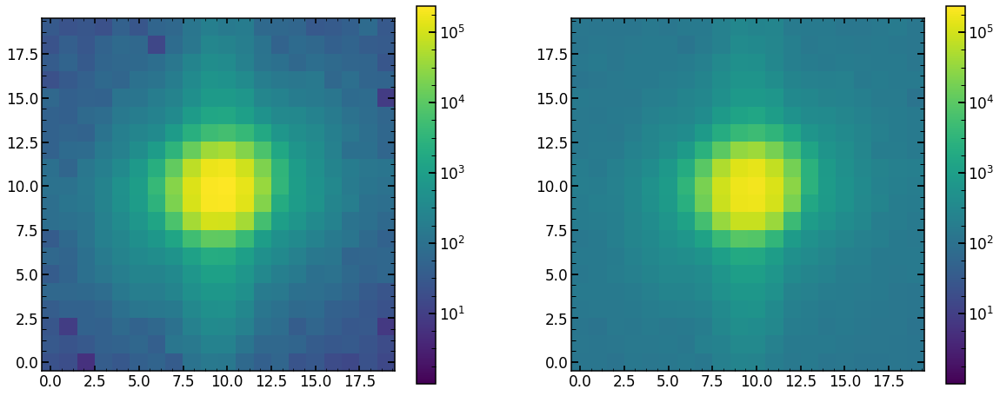

In [788]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [789]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 4269.120226942025
minimal chi2 reduced is: 21.304562626038354


In [790]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
         z4        z5        z6        z7        z8        z9       z10  \
0 -0.554632 -0.437693 -0.758688  0.482526 -0.143963 -0.069508 -0.176169   

        z11  
0 -0.333447  
        z12       z13       z14       z15       z16       z17       z18  \
0  0.028869  0.032999  0.035886  0.006583 -0.014575  0.007134  0.008334   

        z19       z20       z21  
0 -0.013292 -0.025639  0.015971  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0 -0.019959  0.686695   0.082468  0.029285 -0.086555   0.06133     0.003157   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000011             0.000011  0.972509    ...       0.08486   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.996344  1.027954           -0.131263   67030.449254   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.598238               0.00441      0.384454  1.789339

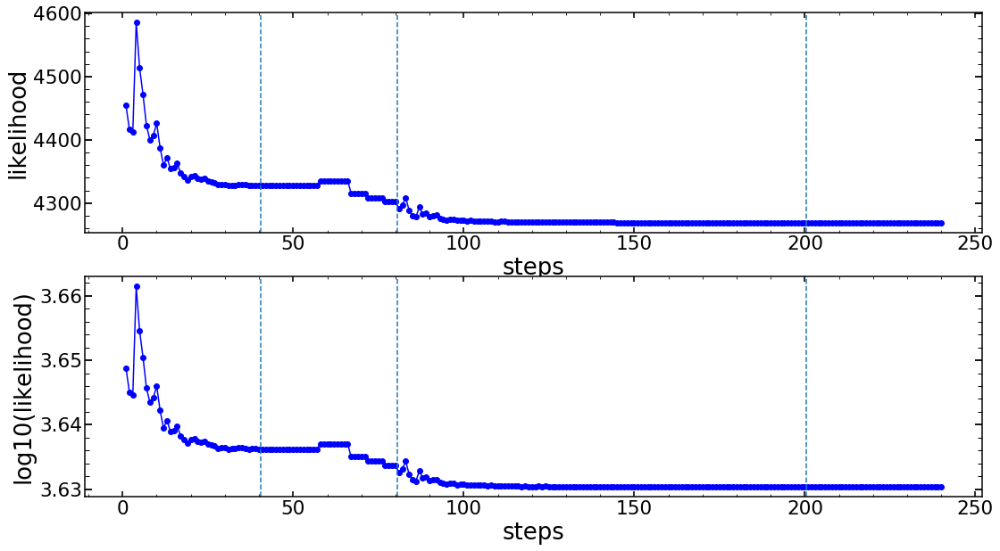

In [791]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [792]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

None
zmax: 22


-4269.120782032995

In [793]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

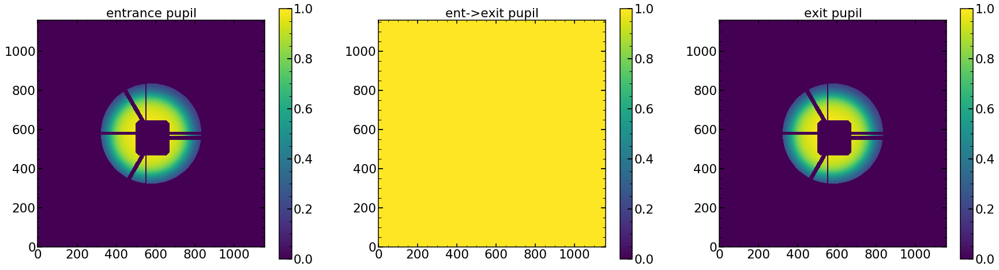

In [794]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

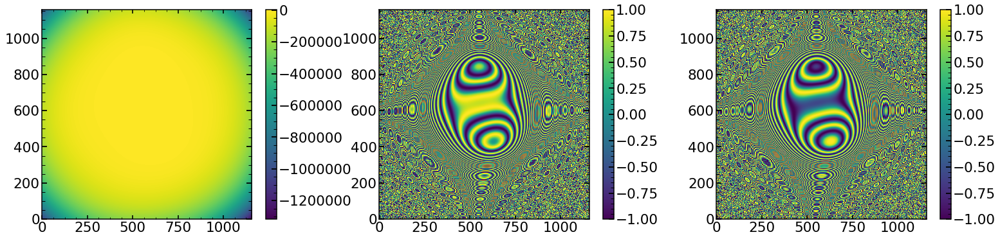

In [795]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

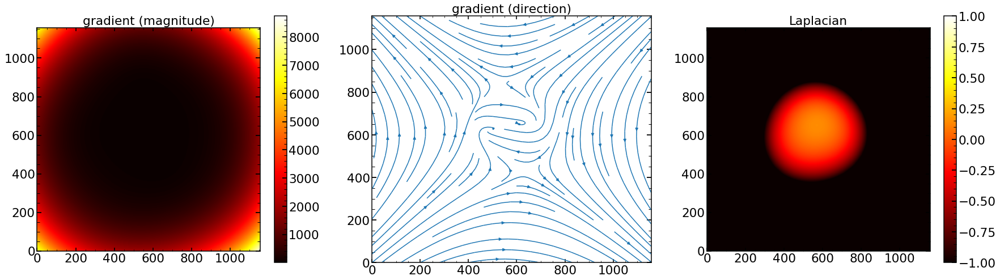

In [796]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

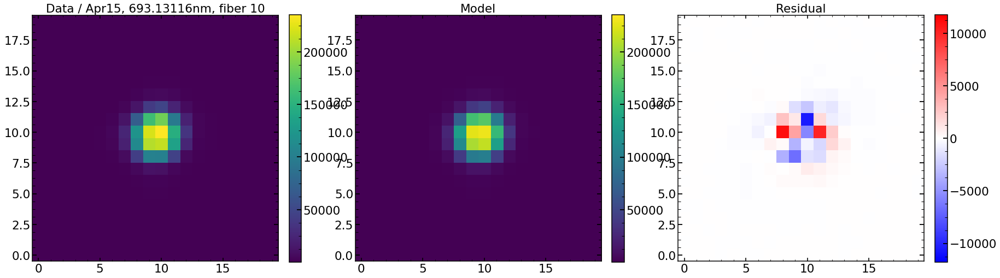

In [797]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 21.304565606666248
Abs of residual divided by total flux is: 0.036606793681458985
Abs of residual divided by largest value of a flux in the image is: 0.048268278003975686


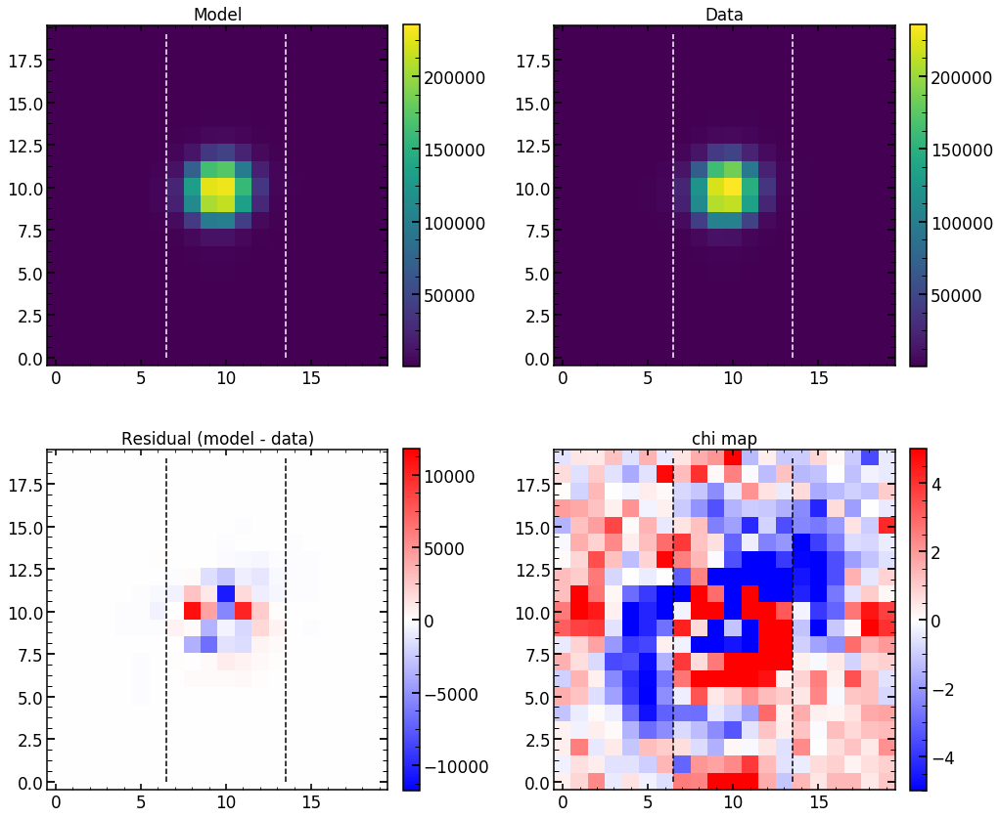

In [798]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

21.304565606666248
chi**2 reduced is: 21.304565606666248
Abs of residual divided by total flux is: 0.036606793681458985
Abs of residual divided by largest value of a flux in the image is: 0.048268278003975686


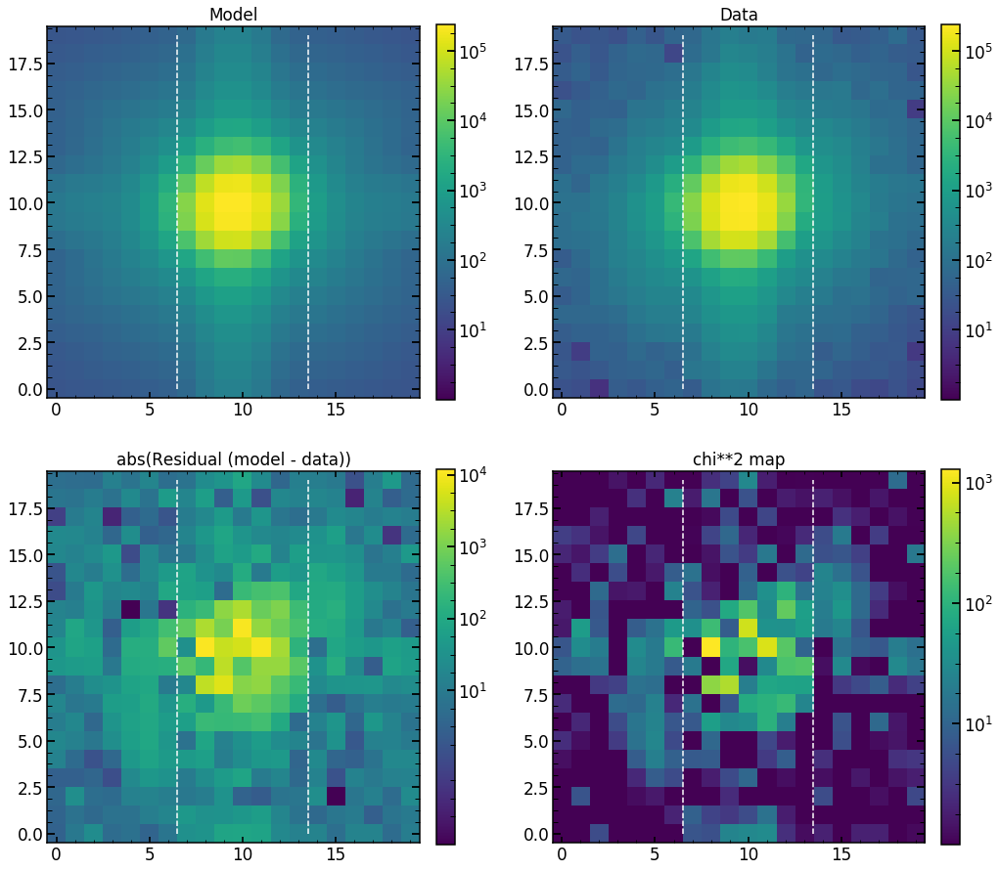

In [799]:
single_analysis.create_basic_comparison_plot_log()

21.304565606666248
chi**2 reduced is: 21.304565606666248
Abs of residual divided by total flux is: 0.036606793681458985
Abs of residual divided by largest value of a flux in the image is: 0.048268278003975686


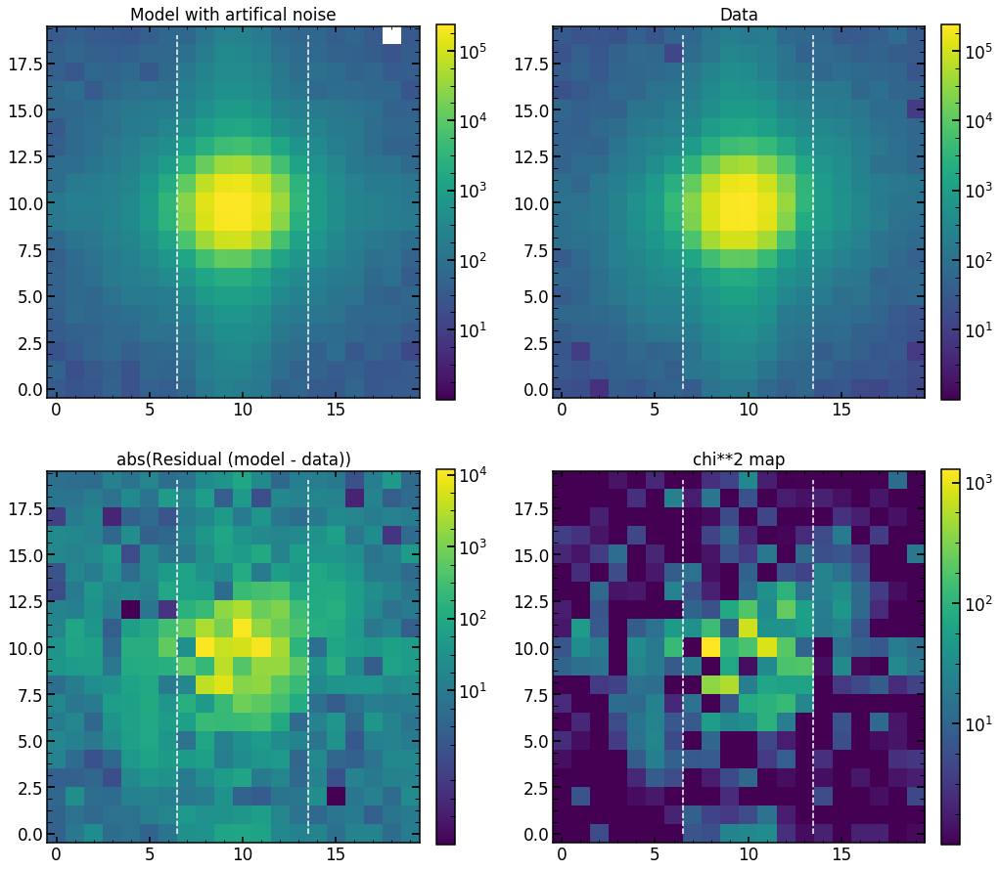

In [800]:
single_analysis.create_basic_comparison_plot_log_artifical()

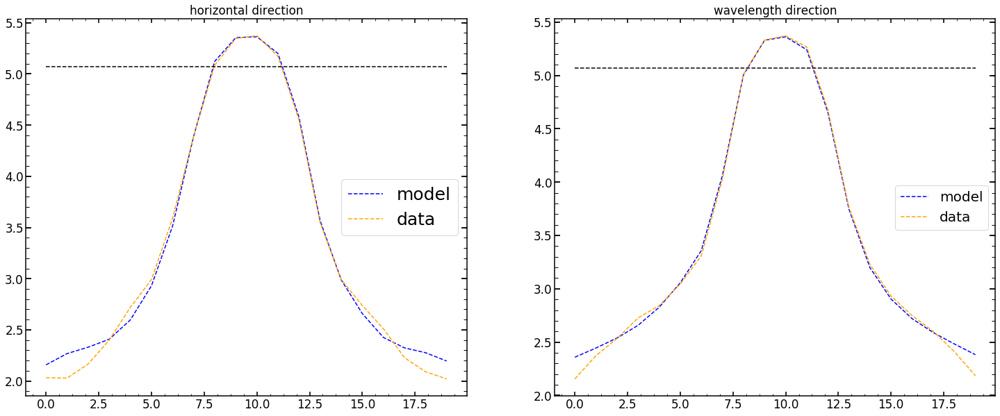

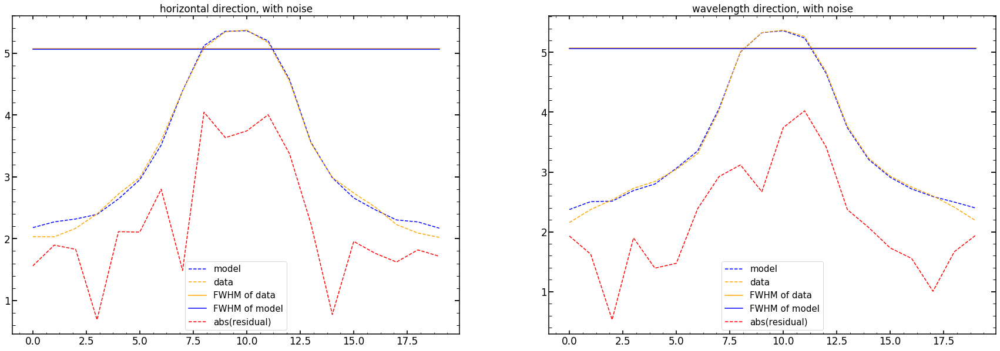

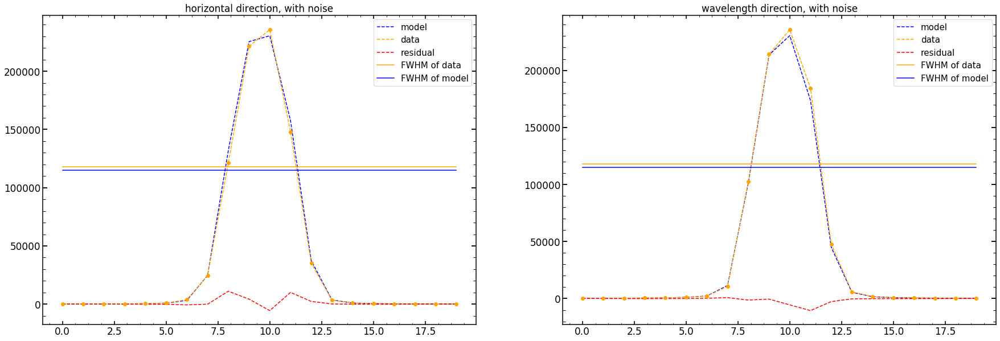

In [801]:
single_analysis.create_cut_plots()

Text(19.5,1700,'$\\chi^{2}_{40000}$=3.76')

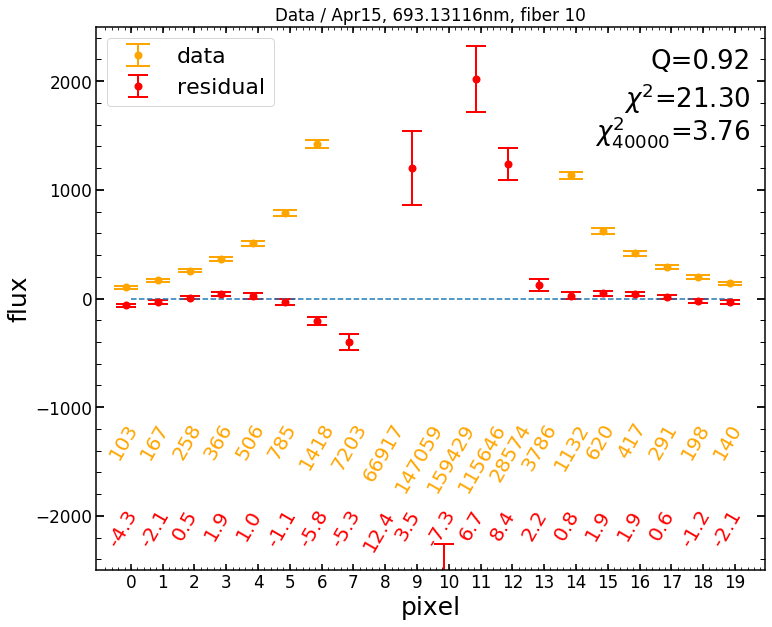

In [802]:
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.legend(loc=2, fontsize=22)
plt.plot(np.zeros(20),'--')
plt.ylim(-2500,2500)
plt.ylabel('flux',size=25)
plt.xlabel('pixel',size=25)
plt.xticks(range(20))




for i in range(20):
    plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')
    
for i in range(20):
    plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
difference_from_max=range(20)-position_of_max_flux
pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2=np.mean((res_iapetus-sci_image)**2/var_image)

plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

In [803]:
pixels_to_test

array([ 4,  5,  6,  7, 13, 14, 15, 16])

## Creating  results everywhere

In [715]:
assert date=='Apr15'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)


results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

In [716]:
columns_analysis=columns22_analysis

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus(date,single_number,'HgAr',22)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]


for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus(date,single_number,'Ne',22)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]


22
0 11748 HgAr is NOT found or failed!
22
1 obs (Emcee3): 11748 is found!
z5: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z15: failed!
z16: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z15: failed!
z16: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
2 11748 HgAr is NOT found or failed!
22
3 11748 HgAr is NOT found or failed!
22
4 11748 HgAr is NOT found or failed!
22
5 11748 HgAr is NOT found or failed!
22
6 obs (Emcee3): 11748 is found!
z6: failed!
z7: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z21: failed!
z22: failed!
strutFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z10: f

z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
50 11748 HgAr is NOT found or failed!
22
51 11748 HgAr is NOT found or failed!
22
52 11748 HgAr is NOT found or failed!
22
53 11748 HgAr is NOT found or failed!
22
54 obs (Emcee3): 11748 is found!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z19: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!

z18: failed!
z19: failed!
z21: failed!
z22: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
79 11748 HgAr is NOT found or failed!
22
80 11748 HgAr is NOT found or failed!
22
81 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z20: failed!
z22: failed!
hscF

114 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z12: failed!
z15: failed!
z16: failed!
z17: failed!
z20: failed!
z22: failed!
hscFrac: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z12: failed!
z15: failed!
z16: failed!
z17: failed!
z20: failed!
z22: failed!
hscFrac: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
115 11748 HgAr is NOT found or failed!
22
116 11748 HgAr is NOT found or failed!
22
117 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z21: failed!
z22: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_

22
146 11748 HgAr is NOT found or failed!
22
147 11748 HgAr is NOT found or failed!
22
148 11748 HgAr is NOT found or failed!
22
149 11748 HgAr is NOT found or failed!
22
150 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz

z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
22
180 11748 HgAr is NOT found or failed!
22
181 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed

dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z16: failed!
z19: failed!
z20: failed!
z21: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
16 12355 Ne is NOT found or failed!
22
17 12355 Ne is NOT found or failed!
22
18 12355 Ne is NOT found or failed!
22
19 12355 Ne is NOT found or failed!
22
20 12355 Ne is NOT found or failed!
22
21 12355 Ne is NOT found or failed!
22
22 12355 Ne is NOT found or failed!
22
23 12355 Ne is NOT found or failed!
22
24 12355 Ne is NOT found or failed!
22
25 

z15: failed!
z16: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z15: failed!
z16: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
66 12355 Ne is NOT found or failed!
22
67 12355 Ne is NOT found or failed!
22
68 obs (Emcee3): 12355 is found!
z5: failed!
z7: failed!
z8: failed

22
88 12355 Ne is NOT found or failed!
22
89 12355 Ne is NOT found or failed!
22
90 12355 Ne is NOT found or failed!
22
91 12355 Ne is NOT found or failed!
22
92 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!


z17: failed!
z18: failed!
z22: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
123 obs (Emcee3): 12355 is found!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z20: failed!
z21: failed!
hscFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z20: failed!
z21: failed!
hscFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!

In [717]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.724093,0.106890,0.079267,0.526172,0.910532,0.143763,-0.333866,-0.020287,-0.117863,-0.031919,...,1.001908,0.572610,32627.864837,2.170080,0.001098,0.374790,1.805142,0.993486,13.749794,1450.387695
6,2.614616,-0.137252,0.355134,0.300444,0.812573,-0.004800,-0.166078,-0.082680,-0.136345,0.002226,...,0.990302,0.572574,36900.862461,1.814841,0.000364,0.369304,1.874901,0.998782,3.002704,1304.506836
9,2.582328,-0.937458,-0.032765,-0.191308,0.765205,-0.218634,-0.257392,0.149082,-0.081471,0.136832,...,1.026507,0.575702,38419.436164,2.356995,0.002215,0.350000,1.780039,0.996292,32.141042,7273.361328
11,2.465833,-1.046299,-0.223353,-0.359852,1.043138,-0.387358,-0.420092,0.503204,0.079658,0.181423,...,1.062441,0.578220,16338.741099,2.103492,0.001676,0.365729,1.802776,0.991493,3.778322,403.180481
13,2.448046,0.527001,-0.139304,0.626495,0.744287,0.031024,-0.384681,-0.130732,-0.102180,-0.102270,...,1.009698,0.506430,52110.403541,2.319256,0.001630,0.354750,1.780116,0.999434,2.677255,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.265180,-0.059065,-0.766005,-0.170517,-0.347606,-0.306000,-0.178651,0.371442,-0.068949,-0.145466,...,1.046728,-0.506695,19039.166665,1.500000,0.000222,0.785554,1.979949,0.987908,3.121629,262.233856
181,-2.382973,-0.608461,-0.451723,0.387272,-0.611124,0.096404,-0.178947,-0.099994,-0.117834,0.130745,...,0.978547,-0.568257,81712.042403,2.124650,0.001577,0.350000,1.833474,0.997538,2.462665,757.888306
186,-2.386900,0.042550,-0.442613,0.114293,-0.519770,-0.055470,-0.402141,-0.068977,-0.173808,-0.076940,...,0.966489,-0.566055,21799.093825,1.500000,0.000099,0.434314,1.835765,0.990336,7.014343,612.405029
189,-2.830228,0.086113,-0.604050,-0.157482,-0.461233,-0.297287,-0.303270,0.140133,-0.122652,-0.185124,...,1.002161,-0.566327,40418.077874,1.863346,0.000519,0.528264,1.944789,0.996041,12.054420,2839.623047


In [718]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,3.277713,0.637529,-0.243838,0.807899,1.051614,0.230904,-0.459890,0.130295,-0.074533,-0.108413,...,1.014399,0.578274,49899.777801,2.419333,0.002155,0.399142,1.800868,0.998337,10.377964,5756.716797
5,2.986933,0.921207,0.173872,0.510538,0.959053,0.247405,-0.197635,-0.043105,-0.068435,-0.241617,...,1.001977,0.577316,28833.076034,2.237461,0.000978,0.381722,1.800872,0.985924,138.768438,9594.016602
6,2.975069,0.484556,0.089676,0.577234,0.883480,0.109023,-0.265271,-0.048722,-0.124004,-0.099750,...,0.995495,0.576677,35760.465558,2.218761,0.001104,0.370981,1.805153,0.997899,4.883659,1909.174683
11,2.766697,0.597284,-0.347104,0.820374,0.800728,0.057072,-0.510239,0.012414,-0.073114,-0.108974,...,1.022426,0.511781,57702.136980,2.414975,0.002578,0.360778,1.805150,0.999125,5.769396,5175.567383
14,2.484130,0.399423,-0.197850,0.675546,0.752537,0.025278,-0.389342,-0.093883,-0.110810,-0.093474,...,1.009853,0.511136,64586.428016,2.434599,0.002601,0.353413,1.807963,0.998501,15.720298,8799.631836
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,-2.231357,-0.478827,-0.358994,0.243737,-0.587344,0.149714,-0.287915,-0.200865,-0.100124,0.057019,...,0.981479,-0.502692,87553.793052,1.805088,0.000431,0.350000,1.819438,0.995198,70.319216,14028.757812
137,-2.083733,-0.629497,-0.656868,0.484021,-0.636039,0.173113,-0.032798,0.021276,-0.082555,0.152461,...,0.993186,-0.564802,65782.048110,2.236470,0.002093,0.350422,1.821526,0.998395,6.376161,3200.388672
140,-2.237478,-0.631175,-0.484589,0.403447,-0.632765,0.109568,-0.163026,-0.085124,-0.125189,0.128452,...,0.980359,-0.563865,75199.008481,2.363869,0.002738,0.354700,1.817381,0.998182,10.594078,5066.739258
141,-2.334150,-0.601980,-0.380965,0.307377,-0.600223,0.060324,-0.223824,-0.137208,-0.143417,0.104421,...,0.973554,-0.563238,62815.576926,2.441379,0.003261,0.350000,1.811586,0.997823,3.086728,978.778259


In [722]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/' + 'results_of_fit_many_direct_HgAr_from_Apr15.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/' + 'results_of_fit_many_direct_Ne_from_Apr15.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

## verification

In [719]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr15'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns


# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/0p/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z9/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z13/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/z14/
Images are in folder: /Users/nevencaplar/Documents/PFS/Imag

<Figure size 864x720 with 0 Axes>

## Quality control

In [747]:
assert date=='Apr15'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

### just plotting

In [748]:

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)    

    
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
    plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
    plt.legend(loc=2, fontsize=22)
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))




    for i in range(20):
        plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')

    for i in range(20):
        plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

    plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2=np.mean((res_iapetus-sci_image)**2/var_image)

    plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

    plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/Apr15/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()
    
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
    plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
    plt.legend(loc=2, fontsize=22)
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))




    for i in range(20):
        plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')

    for i in range(20):
        plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

    plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2=np.mean((res_iapetus-sci_image)**2/var_image)

    plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

    plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/Apr15/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()    

None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
z

<Figure size 864x720 with 0 Axes>

### calculating and global plot

In [727]:
res_HgAr=[]
res_HgAr_chi=[]

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
        
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_HgAr.append(Q)
    res_HgAr_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))
  
res_Ne=[]
res_Ne_chi=[]
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_Ne.append(Q)
    res_Ne_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))

None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
zmax: 22
None
z

In [728]:
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr15'
zMax=22
descriptions='Q'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii

    max_colors=10
    min_colors=1         



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'Q'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'Q'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'Q'+" "+str(descriptions[i]))
    plt.clf()

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/Q/


<Figure size 864x720 with 0 Axes>

In [729]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr15'
zMax=22
descriptions='$\chi^{2}$'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr_chi

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne_chi

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii

    max_colors=10
    min_colors=1           



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=20,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'res_chi'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'chi_res'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'chi_res'+" "+str(descriptions[i]))
    plt.clf()

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Plane/res_chi/


<Figure size 864x720 with 0 Axes>

# Progress

In [758]:
def Q(sci_image,var_image,res_iapetus):
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    return Q

In [744]:
'Mar30 - local solution for illumination, global solution for pupil, postprocessing parameters and wavefront'
'Apr10 - local solution for illumination postprocessing parameters and wavefront,  global solution for pupil '
'Apr15 - local solution for illumination postprocessing parameters and wavefront,  global solution for pupil '



print(obs)
print(image_index)
print(arc)



12355
142
Ne


In [780]:
res_HgAr_Q=[]
obs=11748
arc='HgAr'
for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    try:
        Apr15_single_result=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy') 
        Apr10_single_result=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy') 
        Mar30_single_result=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy') 

        sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
        var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    
        res_HgAr_Q.append([image_index,Q(sci_image,var_image,Mar30_single_result),Q(sci_image,var_image,Apr10_single_result),Q(sci_image,var_image,Apr15_single_result), np.max(sci_image)])
    except:
        pass
    
    
res_Ne_Q=[]
obs=12355
arc='Ne'
for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    try:
        Apr15_single_result=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy') 
        Apr10_single_result=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr10_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy') 
        Mar30_single_result=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy') 

        sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
        var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    
        res_Ne_Q.append([image_index,Q(sci_image,var_image,Mar30_single_result),Q(sci_image,var_image,Apr10_single_result),Q(sci_image,var_image,Apr15_single_result),np.max(sci_image)])
    except:
        pass
    
res_HgAr_Q=np.array(res_HgAr_Q)
res_Ne_Q=np.array(res_Ne_Q)

res_HgAr_Q=res_HgAr_Q[res_HgAr_Q[:,4]>40000]
res_Ne_Q=res_Ne_Q[res_Ne_Q[:,4]>40000]

Text(0,0.5,'Q')

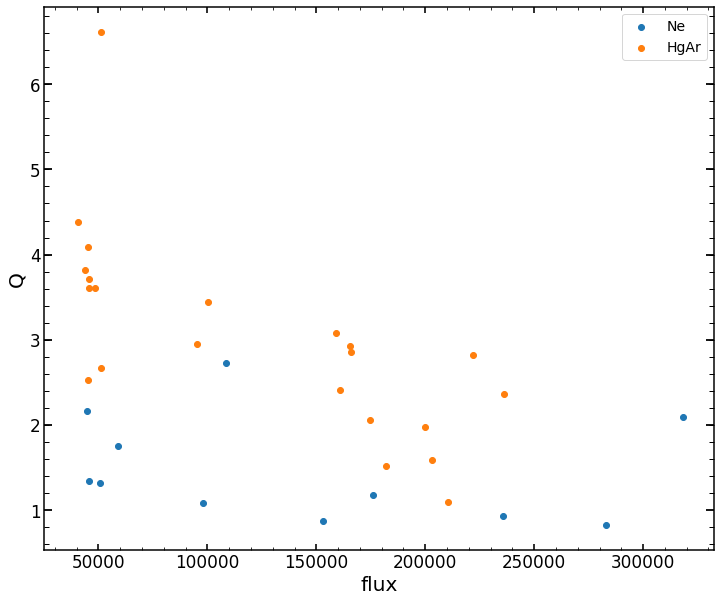

In [785]:
plt.scatter(res_Ne_Q[:,4],res_Ne_Q[:,3],label='Ne')
plt.scatter(res_HgAr_Q[:,4],res_HgAr_Q[:,3],label='HgAr')
plt.legend()
plt.xlabel('flux')
plt.ylabel('Q')

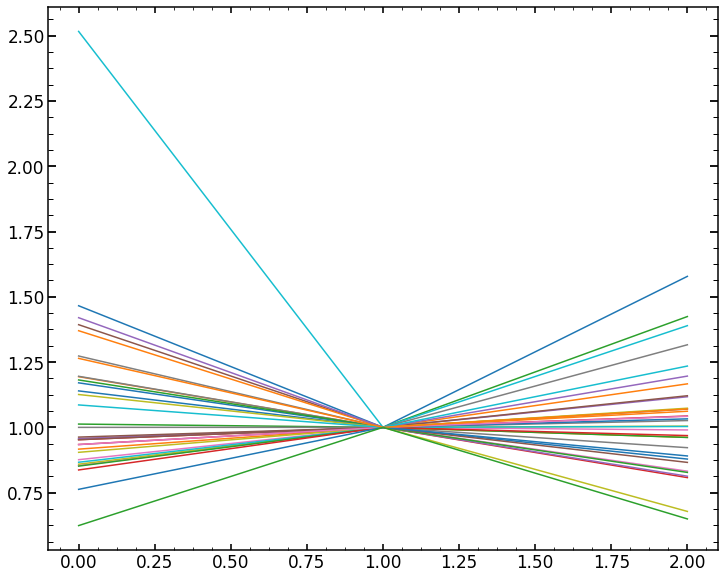

In [810]:
for i in range(len(res_Ne_Q)):
    plt.plot(res_Ne_Q[i][1:4]/res_Ne_Q[i][2])
    
for i in range(len(res_HgAr_Q)):
    plt.plot(res_HgAr_Q[i][1:4]/res_HgAr_Q[i][2])

In [759]:
Q(sci_image,var_image,Mar30_single_result),Q(sci_image,var_image,Apr10_single_result),Q(sci_image,var_image,Apr15_single_result)

(4.209485213509916, 2.4857331402643412, 2.6361735229671153)

# Creating interpolation from defocus and focus

In [886]:
date=='Apr11'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr110119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr11.pkl', 'rb') as f:
    results_of_fit_many_single_defocus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr11.pkl', 'rb') as f:
    results_of_fit_many_single_defocus_Ne_pd=pickle.load(f)

In [887]:
assert date=='Apr15'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

In [ ]:
# We want - pupil global, illumination per fiber, wavefront and postprocessing free

In [862]:
results_of_fit_many_HgAr=results_of_fit_many_single_defocus_HgAr_pd
results_of_fit_many_HgAr['0']=results_of_fit_many_single_focus_HgAr_pd

results_of_fit_many_Ne=results_of_fit_many_single_defocus_Ne_pd
results_of_fit_many_Ne['0']=results_of_fit_many_single_focus_Ne_pd

In [859]:
results_of_fit_many_single_defocus_HgAr_pd['0']

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.724093,0.106890,0.079267,0.526172,0.910532,0.143763,-0.333866,-0.020287,-0.117863,-0.031919,...,1.001908,0.572610,32627.864837,2.170080,0.001098,0.374790,1.805142,0.993486,13.749794,1450.387695
6,2.614616,-0.137252,0.355134,0.300444,0.812573,-0.004800,-0.166078,-0.082680,-0.136345,0.002226,...,0.990302,0.572574,36900.862461,1.814841,0.000364,0.369304,1.874901,0.998782,3.002704,1304.506836
9,2.582328,-0.937458,-0.032765,-0.191308,0.765205,-0.218634,-0.257392,0.149082,-0.081471,0.136832,...,1.026507,0.575702,38419.436164,2.356995,0.002215,0.350000,1.780039,0.996292,32.141042,7273.361328
11,2.465833,-1.046299,-0.223353,-0.359852,1.043138,-0.387358,-0.420092,0.503204,0.079658,0.181423,...,1.062441,0.578220,16338.741099,2.103492,0.001676,0.365729,1.802776,0.991493,3.778322,403.180481
13,2.448046,0.527001,-0.139304,0.626495,0.744287,0.031024,-0.384681,-0.130732,-0.102180,-0.102270,...,1.009698,0.506430,52110.403541,2.319256,0.001630,0.354750,1.780116,0.999434,2.677255,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.265180,-0.059065,-0.766005,-0.170517,-0.347606,-0.306000,-0.178651,0.371442,-0.068949,-0.145466,...,1.046728,-0.506695,19039.166665,1.500000,0.000222,0.785554,1.979949,0.987908,3.121629,262.233856
181,-2.382973,-0.608461,-0.451723,0.387272,-0.611124,0.096404,-0.178947,-0.099994,-0.117834,0.130745,...,0.978547,-0.568257,81712.042403,2.124650,0.001577,0.350000,1.833474,0.997538,2.462665,757.888306
186,-2.386900,0.042550,-0.442613,0.114293,-0.519770,-0.055470,-0.402141,-0.068977,-0.173808,-0.076940,...,0.966489,-0.566055,21799.093825,1.500000,0.000099,0.434314,1.835765,0.990336,7.014343,612.405029
189,-2.830228,0.086113,-0.604050,-0.157482,-0.461233,-0.297287,-0.303270,0.140133,-0.122652,-0.185124,...,1.002161,-0.566327,40418.077874,1.863346,0.000519,0.528264,1.944789,0.996041,12.054420,2839.623047


In [860]:
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.724093,0.106890,0.079267,0.526172,0.910532,0.143763,-0.333866,-0.020287,-0.117863,-0.031919,...,1.001908,0.572610,32627.864837,2.170080,0.001098,0.374790,1.805142,0.993486,13.749794,1450.387695
6,2.614616,-0.137252,0.355134,0.300444,0.812573,-0.004800,-0.166078,-0.082680,-0.136345,0.002226,...,0.990302,0.572574,36900.862461,1.814841,0.000364,0.369304,1.874901,0.998782,3.002704,1304.506836
9,2.582328,-0.937458,-0.032765,-0.191308,0.765205,-0.218634,-0.257392,0.149082,-0.081471,0.136832,...,1.026507,0.575702,38419.436164,2.356995,0.002215,0.350000,1.780039,0.996292,32.141042,7273.361328
11,2.465833,-1.046299,-0.223353,-0.359852,1.043138,-0.387358,-0.420092,0.503204,0.079658,0.181423,...,1.062441,0.578220,16338.741099,2.103492,0.001676,0.365729,1.802776,0.991493,3.778322,403.180481
13,2.448046,0.527001,-0.139304,0.626495,0.744287,0.031024,-0.384681,-0.130732,-0.102180,-0.102270,...,1.009698,0.506430,52110.403541,2.319256,0.001630,0.354750,1.780116,0.999434,2.677255,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.265180,-0.059065,-0.766005,-0.170517,-0.347606,-0.306000,-0.178651,0.371442,-0.068949,-0.145466,...,1.046728,-0.506695,19039.166665,1.500000,0.000222,0.785554,1.979949,0.987908,3.121629,262.233856
181,-2.382973,-0.608461,-0.451723,0.387272,-0.611124,0.096404,-0.178947,-0.099994,-0.117834,0.130745,...,0.978547,-0.568257,81712.042403,2.124650,0.001577,0.350000,1.833474,0.997538,2.462665,757.888306
186,-2.386900,0.042550,-0.442613,0.114293,-0.519770,-0.055470,-0.402141,-0.068977,-0.173808,-0.076940,...,0.966489,-0.566055,21799.093825,1.500000,0.000099,0.434314,1.835765,0.990336,7.014343,612.405029
189,-2.830228,0.086113,-0.604050,-0.157482,-0.461233,-0.297287,-0.303270,0.140133,-0.122652,-0.185124,...,1.002161,-0.566327,40418.077874,1.863346,0.000519,0.528264,1.944789,0.996041,12.054420,2839.623047


## creating interpolation

In [863]:
from scipy.optimize import curve_fit

def lin_fit_2D(x_y, a, b,c):
    x=x_y[:,0]
    y=x_y[:,1]
    return a * x + b*y+c

def lin_fit_3D(dz_dx_dy, a, b,c,d):
    z=dz_dx_dy[:,0]
    x=dz_dx_dy[:,1]
    y=dz_dx_dy[:,2]
    return a * z + b*x+c*y+d


def func(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]


def funcz4(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1,c2):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+c2*x[2]**2+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]

#def func(x, a1,a2,a3,a4,a5,b1,b2,b3,b4,b5,c):
#    return np.polynomial.chebyshev.chebval(x[0],[a1,a2,a3,a4,a5])+np.polynomial.chebyshev.chebval(x[1],[b1,b2,b3,b4,b5])+c

#popt1, pcov = curve_fit(func, np.transpose(res_convolving_array1[:,[0,1]]), 10/4*res_convolving_array1[:,2])



label_short=['m4','m35','m3','m15','m05','0d','0','p05','p15','p3','p35','p4']
label_defocus=['m4','m35','m3','m15','p15','p3','p35','p4']
label_focus=['m05','0d','0','p05']
label_focus_focus=['0']
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
mm=np.array([-4. , -3.5, -3. , -2.5, -2. , -1.5, -1. , -0.5, -0. , -0. ,  0.5,
        1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4.,0 ])

In [926]:
from scipy.optimize import curve_fit

def lin_fit_2D(x_y, a, b,c):
    x=x_y[:,0]
    y=x_y[:,1]
    return a * x + b*y+c

def lin_fit_3D(dz_dx_dy, a, b,c,d):
    z=dz_dx_dy[:,0]
    x=dz_dx_dy[:,1]
    y=dz_dx_dy[:,2]
    return a * z + b*x+c*y+d


def func(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]


def funcz4(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1,c2):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+c2*x[2]**2+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]

#def func(x, a1,a2,a3,a4,a5,b1,b2,b3,b4,b5,c):
#    return np.polynomial.chebyshev.chebval(x[0],[a1,a2,a3,a4,a5])+np.polynomial.chebyshev.chebval(x[1],[b1,b2,b3,b4,b5])+c

#popt1, pcov = curve_fit(func, np.transpose(res_convolving_array1[:,[0,1]]), 10/4*res_convolving_array1[:,2])



label_short=['m4','m35','m3','m15','m05','0d','0','p05','p15','p3','p35','p4']
label_defocus=['m4','m35','m3','m15','p15','p3','p35','p4']
label_focus=['m05','0d','0','p05']
label_focus_focus=['0']
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
mm=np.array([-4. , -3.5, -3. , -2.5, -2. , -1.5, -1. , -0.5, -0. , -0. ,  0.5,
        1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4.,0 ])

In [865]:
results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)



results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)

In [866]:
results_of_fit_many_interpolation_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

results_of_fit_many_interpolation_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

# find coordinates of all spots on the detector
all_x_HgAr=finalHgAr_Feb2019['xc_effective']
all_y_HgAr=finalHgAr_Feb2019['yc']

all_x_Ne=finalNe_Feb2019['xc_effective']
all_y_Ne=finalNe_Feb2019['yc']

# detector is 4096 pixels in x direction and 4176 in y direction
all_x_HgAr_in_respect_to_center=all_x_HgAr-int((4096+69)/2)
all_y_HgAr_in_respect_to_center=all_y_HgAr-int(4176/2)

all_x_Ne_in_respect_to_center=all_x_Ne-int((4096+69)/2)
all_y_Ne_in_respect_to_center=all_y_Ne-int(4176/2)


In [867]:
i='p35'
j='z11'
single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)

i='p35'
j='z11'
single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)

In [868]:
print(len(results_of_fit_many_HgAr[i][j]))
print(len(results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]))

print(len(results_of_fit_many_Ne[i][j]))
print(len(results_of_fit_many_Ne[i][j][single_selection_Ne_index]))

44
44
41
41


In [869]:
zMax=22

if zMax==11:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','slitHolder_frac_dx','radiometricEffect','radiometricExponent','x_ilum','y_ilum']
else:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22','hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','slitHolder_frac_dx','radiometricEffect','radiometricExponent','x_ilum','y_ilum']


single_parameter=[]
for j in labels_cont:
    for i in label_defocus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  

        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)          
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]      
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]         
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values

        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values

        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        single_selection_array=single_selection_array_HgAr
        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-5*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))        
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))      
    elif j in ['slitHolder_frac_dx','x_ilum']:
        # I force to have no z-dependance and positive x dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[-0.000001,0,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        ##############
        # I am manually overiding the fit!!!!
        ##############
        #popt=[-3*10e-5,0,0,0,0,0,0,0,0]
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['y_ilum']:
        # I force to have no z-dependance and no x-dependence, only y dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.0,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,0,0,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,np.inf,np.inf,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['effective_radius_illumination']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt)))     
        
    elif j in ['radiometricEffect','radiometricExponent']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    else:     
        # 'z5','z6','z7','z8','z9','z10','z11'
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0])
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]        

        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0])        
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
  
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)

z5: [-0.00001738 -0.00000005 -0.00006055 -0.00000004 -0.01048049 -0.12040441
  0.00000023 -0.00018877 -0.00001954]
Value in center for z5: -1.4384596598272283
First fit for z5: [-0.00001738 -0.00000005 -0.00006055 -0.00000004 -0.01048049 -0.12040441
  0.00000023 -0.00018877 -0.00001954]
z6: [-0.00010808  0.00000015  0.00003004 -0.00000017  0.18440432 -0.39876772
  0.00000001  0.00001624  0.00009278]
Value in center for z6: 1.0481704245892787
First fit for z6: [-0.00010808  0.00000015  0.00003004 -0.00000017  0.18440432 -0.39876772
  0.00000001  0.00001624  0.00009278]
z7: [-0.0000144  -0.00000004 -0.0002302  -0.00000001 -0.02942417  0.29858357
  0.00000002 -0.00000829 -0.00001824]
Value in center for z7: -0.6590906049634533
First fit for z7: [-0.0000144  -0.00000004 -0.0002302  -0.00000001 -0.02942417  0.29858357
  0.00000002 -0.00000829 -0.00001824]
z8: [-0.0003396   0.00000003  0.00000558  0.          0.00815784  0.0437503
  0.00000002 -0.00000053 -0.00000519]
Value in center for z8:

In [876]:
single_parameter=[]
for j in ['z4']:
    for i in label_defocus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  

        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        single_selection_array=single_selection_array_HgAr

        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['z4']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(funcz4, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0,0])
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,0],*popt)))            
   
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=funcz4([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=funcz4([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)

First fit for z4: [-0.00166664 -0.00000154  0.00033092 -0.00000014 -0.          1.88081507
 -0.00000138 -0.         -0.        ]
z4: [-0.00144243  0.0000001  -0.00011343  0.00000006 -7.51035459 -0.28494988
 -0.         -0.00007619 -0.0001296   0.00636494]
Value in center for z4: -34.48753542325555
Value in center for z4: -2.831023258108361


In [877]:
# parameters that vary as a function of fiber, sensitive in defocus - describing illumination of the pupil)
# we just select median value across all defocused measurments?

inerpolation_mean_par_dx=[]
for j in ['x_fiber','y_fiber','frd_sigma','frd_lorentz_factor','effective_radius_illumination']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    # dspot = number of fiber
    # fill the values
    for i in label_defocus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            
    values=np.concatenate((values_HgAr,values_Ne))      
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)    

    # when I had only HgAr
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)    

    
    # taking median
    parameter_res=[]
    # number of fibers
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1
    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr_Feb2019['fiber']
        dspot_Ne=finalNe_Feb2019['fiber']
        values_HgAr=[]
        values_Ne=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne

In [878]:
# parameters that vary slowly across the pupil, sensitive in focus

single_parameter=[]
for j in ['scattering_slope','scattering_amplitude','pixel_effect','flux']:
    for i in label_focus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  
        
        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr,single_selection_y_HgAr,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne,single_selection_y_Ne,single_selection_z_Ne,single_selection_values_Ne]))         
        
        # when we had only HgAr
        #single_selection_array=single_selection_array_HgAr
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
       
        if i==label_focus[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))
    if j in ['pixel_effect']:
        # no z dependence, no dependence has to become stronger towards lower wavelengths
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))
        
    else:
        # no z dependence
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-10,-np.inf,-np.inf,-10e-10,-10e-10],[np.inf,np.inf,np.inf,np.inf,10e-10,np.inf,np.inf,10e-10,10e-10]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))

    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)

First fit for scattering_slope: [ 0.00001275 -0.00000004  0.00002631 -0.00000003  0.          2.50436583
  0.00000001  0.         -0.        ]
scattering_slope [ 0.00001919 -0.00000003  0.00003268 -0.00000003  0.          2.5045248
  0.          0.          0.        ]
Value in center for scattering_slope :2.39407071331824
First fit for scattering_amplitude: [ 0.00000031 -0.          0.00000061  0.          0.          0.00296231
  0.          0.          0.        ]
scattering_amplitude [ 0.00000022 -0.          0.00000053  0.          0.          0.00299812
  0.          0.         -0.        ]
Value in center for scattering_amplitude :0.004563369460680346
First fit for pixel_effect: [0.         0.         0.         0.         0.         0.38249388
 0.         0.         0.        ]
pixel_effect [0.         0.         0.         0.         0.         0.37105686
 0.         0.         0.        ]
Value in center for pixel_effect :0.3711873399090914
First fit for flux: [-0.0000002  -0

In [879]:
# factors depending on dy as a non-smooth function
# fits grating lines as a median value of grating value for a given wavelength for focus
inerpolation_mean_par_dy=[]
for j in ['grating_lines']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    # dspot = number of fiber
    # fill the values
    for i in label_focus_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr_Feb2019['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr_Feb2019['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe_Feb2019['wavelength'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe_Feb2019['wavelength'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            

    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne))    
    
    #values=values_HgAr       
    #dspot=dspot_HgAr 
    
    
    parameter_res=[]
    for i in range(len(np.unique(dspot))):
        if len(values[dspot==np.unique(dspot)[i]])>1:
            print(np.unique(dspot)[i])
            print(values[dspot==np.unique(dspot)[i]])
            print(np.median(values[dspot==np.unique(dspot)[i]]))
            parameter_res.append(np.median(values[dspot==np.unique(dspot)[i]]))
        else:
            parameter_res.append(100000)
    parameter_res=np.array(parameter_res)                                   
    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr_Feb2019['wavelength']
        dspot_Ne=finalNe_Feb2019['wavelength']
        values_HgAr=[]
        values_Ne=[]
        for l in range(len(dspot_HgAr)):
            if np.sum((np.unique(dspot)==dspot_HgAr[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_HgAr.append(100000)
            else:
                values_HgAr.append(parameter_res[(np.unique(dspot)==dspot_HgAr[l])][0])
        for l in range(len(dspot_Ne)):
            if np.sum((np.unique(dspot)==dspot_Ne[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_Ne.append(100000)
            else:
                values_Ne.append(parameter_res[(np.unique(dspot)==dspot_Ne[l])][0])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne

660.0668
[49899.7778013  57702.13698016 54371.86692936 59304.14630449
 57565.9458479  68963.84443447 65232.56004556 64675.15153028
 65642.74273623 55057.19094028 56732.4439424  67217.6028217
 69099.56113115 65782.04811037]
61989.648917380335
693.13116
[28833.07603379 64586.42801591 52960.71928264 62181.60682457
 73632.63442663 67344.74834239 67576.90826212 67030.44925361
 56186.73937411 62885.85904568 67265.05908418 75199.00848147]
65808.43863475662
696.7261
[ 32627.86483711  52110.40354064  57485.665815    71747.50231354
  70838.31939694 111214.44819944  80824.39054145  82508.63456801
  69072.70918805  53219.36009899  59974.53121385  80753.81448754
  98953.97391462  81712.04240286]
71292.91085523937
717.59015
[35760.46555763 42393.61673653 42434.58741196 48413.69849134
 60067.57686512 53093.61085098 54678.53730289 53948.0828972
 46748.41996876 52703.07660022 58499.51445994 62028.3092712
 62815.5769262 ]
53093.61085097953
724.72437
[67251.88030279 87553.79305237 94126.61375353]
87553.7

In [880]:
# parameters that vary as a function of fiber, sensitive in focus

inerpolation_mean_par_dx=[]
for j in ['fiber_r']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    # dspot = number of fiber
    # fill the values
    for i in label_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            
    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)
    
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)
    
    
    # taking median
    parameter_res=[]
    # atm range 10
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1

    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr_Feb2019['fiber']
        dspot_Ne=finalNe_Feb2019['fiber']
        values_HgAr=[]
        values_Ne=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne

In [881]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_HgAr_from_Apr15.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_Ne_from_Apr15.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [ ]:
# replace value where possible with actual values, for postprocessing and wavefront

In [886]:
date=='Apr11'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr110119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr11.pkl', 'rb') as f:
    results_of_fit_many_single_defocus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr11.pkl', 'rb') as f:
    results_of_fit_many_single_defocus_Ne_pd=pickle.load(f)

In [887]:
assert date=='Apr15'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

In [900]:
results_of_fit_many_interpolation_HgAr['m4']

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
0,31.816355,-1.080998,-0.148549,0.420163,0.724895,-0.090694,-0.190833,0.183526,-0.106671,-0.147973,...,1.003704,0.572928,100000.000000,2.298923,0.001475,0.371130,1.820146,0.999390,0.0,0.0
1,31.831502,-1.102049,-0.144771,0.410913,0.723286,-0.093024,-0.194777,0.171974,-0.111559,-0.141572,...,1.001907,0.572612,71292.910855,2.304918,0.001463,0.371127,1.820146,0.999405,0.0,0.0
2,31.862371,-1.141113,-0.140347,0.393931,0.721271,-0.097365,-0.201503,0.154232,-0.119708,-0.130419,...,0.998968,0.572607,100000.000000,2.314791,0.001447,0.371122,1.820146,0.999424,0.0,0.0
3,31.929941,-1.222642,-0.145311,0.358635,0.717312,-0.106288,-0.214599,0.125991,-0.133383,-0.108076,...,0.994260,0.572600,100000.000000,2.332593,0.001439,0.371113,1.820146,0.999436,0.0,0.0
4,31.969240,-1.268026,-0.155669,0.339066,0.715240,-0.111183,-0.221386,0.114970,-0.139214,-0.096136,...,0.992402,0.572596,100000.000000,2.341004,0.001447,0.371109,1.820146,0.999428,0.0,0.0
5,32.066678,-1.375624,-0.199479,0.292871,0.710661,-0.122602,-0.236201,0.100759,-0.148520,-0.069092,...,0.989930,0.572589,100000.000000,2.357145,0.001501,0.371100,1.820146,0.999372,0.0,0.0
6,32.851135,-1.517674,-0.293515,0.232261,0.705243,-0.137329,-0.253361,0.104402,-0.152315,-0.035764,...,0.990302,0.572582,45931.500954,2.371308,0.001634,0.371092,1.820146,0.999228,0.0,0.0
7,32.361941,-1.672371,-0.432012,0.167075,0.700934,-0.152964,-0.269116,0.133206,-0.147513,-0.002463,...,0.994521,0.573205,100000.000000,2.378631,0.001842,0.371086,1.820146,0.998998,0.0,0.0
8,32.505371,-1.806466,-0.578871,0.111015,0.697779,-0.166212,-0.280892,0.175194,-0.136951,0.024551,...,1.000914,0.573831,100000.000000,2.379488,0.002069,0.371083,1.820146,0.998746,0.0,0.0
9,33.017124,-2.149449,-1.044842,-0.030723,0.691639,-0.199014,-0.304624,0.340075,-0.088300,0.087391,...,1.026507,0.575717,49283.439478,2.363079,0.002807,0.371083,1.820146,0.997927,0.0,0.0


In [912]:
# switching wavefront parameters
for label in ['m4','m35','m3','m1','m05','p05','p1','p3','p35','p4']:
    for index_values in results_of_fit_many_single_defocus_HgAr_pd[label].index.values.astype(int):
        for zvalues in ['z4','z5','z6','z7','z8','z9','z10','z11','z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22']:
            results_of_fit_many_interpolation_HgAr[label].loc[index_values][zvalues]=results_of_fit_many_HgAr[label].loc[index_values][zvalues]
     
for label in ['m4','m35','m3','m1','m05','p05','p1','p3','p35','p4']:
    for index_values in results_of_fit_many_single_defocus_Ne_pd[label].index.values.astype(int):
        for zvalues in ['z4','z5','z6','z7','z8','z9','z10','z11','z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22']:
            results_of_fit_many_interpolation_Ne[label].loc[index_values][zvalues]=results_of_fit_many_Ne[label].loc[index_values][zvalues]    
    
# switching postprocessing parameters
for label in ['m4','m35','m3','m1','m05','p05','p1','p3','p35','p4']:
    for index_values in results_of_fit_many_HgAr['0'].index.values.astype(int):
        for zvalues in ['grating_lines','scattering_slope','scattering_amplitude','pixel_effect','fiber_r','flux']:
            results_of_fit_many_interpolation_HgAr[label].loc[index_values][zvalues]=results_of_fit_many_HgAr['0'].loc[index_values][zvalues]          

for label in ['m4','m35','m3','m1','m05','p05','p1','p3','p35','p4']:
    for index_values in results_of_fit_many_Ne['0'].index.values.astype(int):
        for zvalues in ['grating_lines','scattering_slope','scattering_amplitude','pixel_effect','fiber_r','flux']:
            results_of_fit_many_interpolation_Ne[label].loc[index_values][zvalues]=results_of_fit_many_Ne['0'].loc[index_values][zvalues]

In [913]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_HgAr_from_Apr15.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_Ne_from_Apr15.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

### verification

In [928]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr15'
zMax=22
descriptions=results_of_fit_many_interpolation_HgAr['0'].columns


# j runs throught the amount of defocus that we have analyzed
for j in tqdm(labels_with_data):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

  0%|          | 0/12 [00:00<?, ?it/s]

Plotting m4 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/m4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z9/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/Pla

  8%|▊         | 1/12 [00:25<04:37, 25.27s/it]

Plotting m35 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/m35/


 17%|█▋        | 2/12 [00:59<04:57, 29.79s/it]

Plotting m3 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/m3/


 25%|██▌       | 3/12 [01:26<04:18, 28.67s/it]

Plotting m1 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/m1/


 33%|███▎      | 4/12 [01:50<03:41, 27.67s/it]

Plotting m05 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/m05/


 42%|████▏     | 5/12 [02:17<03:12, 27.54s/it]

Plotting 0d now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/0d/


 50%|█████     | 6/12 [02:43<02:43, 27.29s/it]

Plotting 0 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/0/


 58%|█████▊    | 7/12 [03:13<02:18, 27.63s/it]

Plotting p05 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/p05/


 67%|██████▋   | 8/12 [03:43<01:51, 27.89s/it]

Plotting p1 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/p1/


 75%|███████▌  | 9/12 [04:11<01:23, 27.93s/it]

Plotting p3 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/p3/


 83%|████████▎ | 10/12 [04:42<00:56, 28.20s/it]

Plotting p35 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/p35/


 92%|█████████▏| 11/12 [05:12<00:28, 28.39s/it]

Plotting p4 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr15/PlaneInterpolation/p4/


100%|██████████| 12/12 [05:44<00:00, 28.74s/it]


<Figure size 864x720 with 0 Axes>

## frd investigation

In [109]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

sci_image_unit=np.ones((50,50))
var_image_unit=np.ones((50,50))

allparameters_proposal=np.array([24,0.09,0.02,-0.1,0.0,0.1,0.02,0.2,
                                 0.7,0.1,0.3,0.0,0.07,0.0,
                                 0.17,0.67,1,1,
                                 0.0,-0.0,0.80,
                                 0.06,9.99,1.06,0.28,
                                 50000,2.5,0.027,
                                 0.37,1.85,1.0])
print('version of the code is: '+str(Zernike_Module.__version__))
model = LN_PFS_single(sci_image_unit,var_image_unit,dithering=1,save=1)   

res_iapetus099=model(allparameters_proposal,return_Image=True)[1]




version of the code is: 0.21b
None
zmax: 11
globalparameters[14] outside limits


TypeError: 'float' object is not subscriptable

In [1021]:
res_iapetus099

array([[0.01259969, 0.01331346, 0.01410364, ..., 0.01436063, 0.01351754,
        0.012757  ],
       [0.0132983 , 0.01408602, 0.01495566, ..., 0.01536918, 0.01440394,
        0.01354187],
       [0.01406116, 0.01493899, 0.01591244, ..., 0.01648359, 0.0153932 ,
        0.01442042],
       ...,
       [0.01418232, 0.01507067, 0.01605512, ..., 0.01681009, 0.01568912,
        0.01468618],
       [0.01340992, 0.0142057 , 0.01508368, ..., 0.01564964, 0.0146635 ,
        0.0137828 ],
       [0.01270375, 0.01342362, 0.0142188 , ..., 0.01460536, 0.01374041,
        0.01296323]])

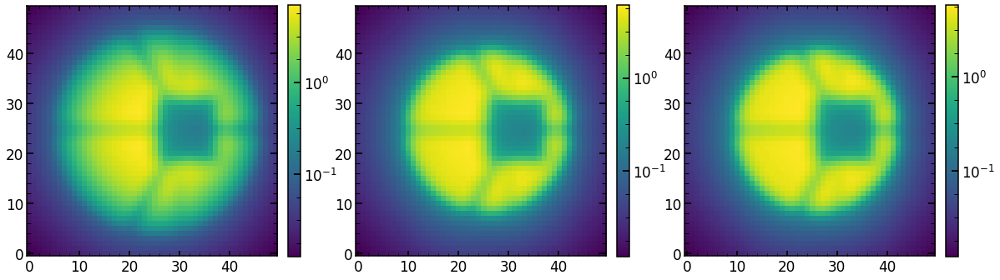

In [1022]:
plt.figure(figsize=(20,12))
plt.subplot(131)
plt.imshow(res_iapetus099,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10**-1,10**0,10**1])
plt.subplot(132)
plt.imshow(res_iapetus051,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10**-1,10**0,10**1])

plt.subplot(133)
plt.imshow(res_iapetus001,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10**-1,10**0,10**1])

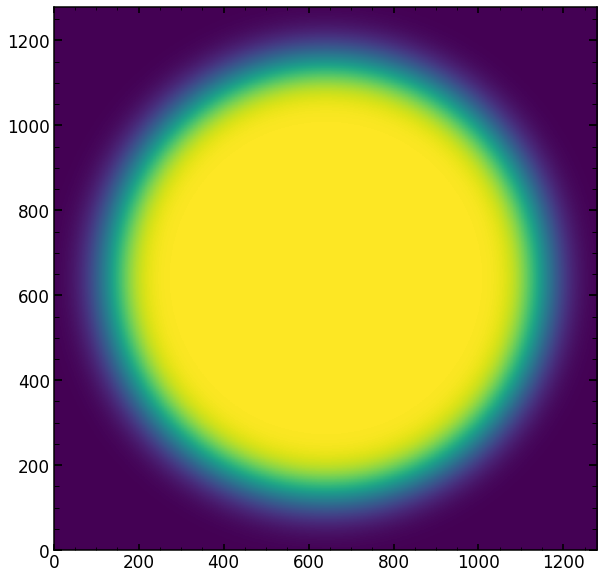

In [1023]:
pupil_frd=np.load('/Users/nevencaplar/Documents/PFS/Testing/Pupil_Images/pupil_frd.npy')
plt.imshow(pupil_frd)

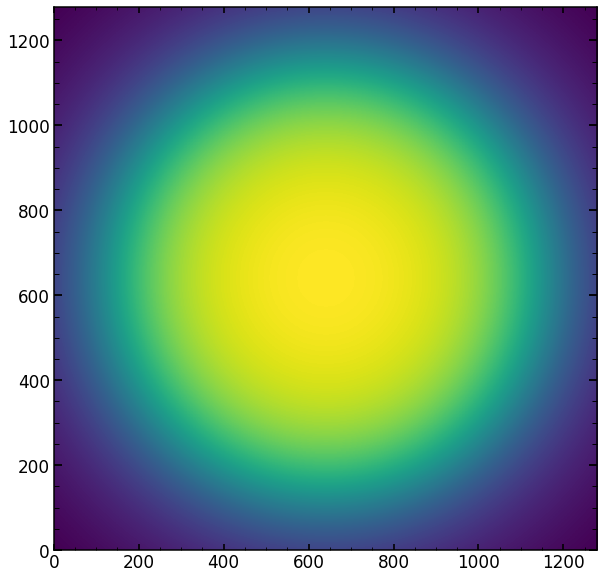

In [1024]:
pupil_lorentz=np.load('/Users/nevencaplar/Documents/PFS/Testing/Pupil_Images/pupil_lorentz.npy')
plt.imshow(pupil_lorentz)

In [99]:
plt.plot(pupil_lorentz[536])
plt.plot(pupil_frd[536])

NameError: name 'pupil_lorentz' is not defined

## Looking at the single image

In [311]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr11'
obs=12397
single_number='65'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m35


fiber                           7
xc                           1994
yc                            421
wavelength               660.0668
close                           1
lamp                           Ne
xc_effective                 1994
old_index_approx               38
superold_index_approx         nan
Name: 65, dtype: object

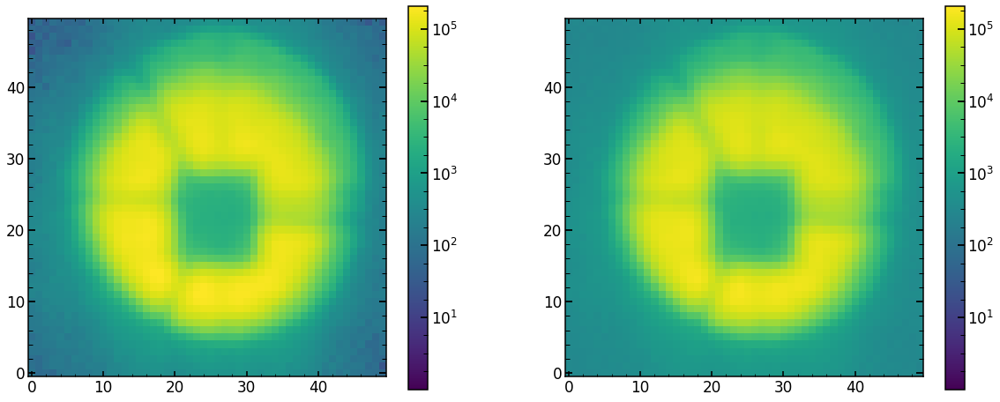

In [312]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [313]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 201137.44552662148
minimal chi2 reduced is: 160.90201711343718


In [314]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6        z7        z8        z9       z10  \
0  26.290851  0.128262 -1.275108  1.013689  0.285932 -0.090079 -0.405531   

        z11  
0 -0.176875  
       z12       z13       z14       z15       z16       z17       z18  \
0  0.05883  0.089092 -0.020745  0.015178  0.044563  0.061032 -0.014569   

        z19       z20       z21  
0 -0.012277 -0.031475  0.035632  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.017356  0.691109    0.08644 -0.015054 -0.107006  0.062749     0.016664   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000026             0.000026  0.973055    ...      0.048226   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.999818  1.046431             0.03312   36737.810126   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.574368              0.003567      0.515168  1.807457

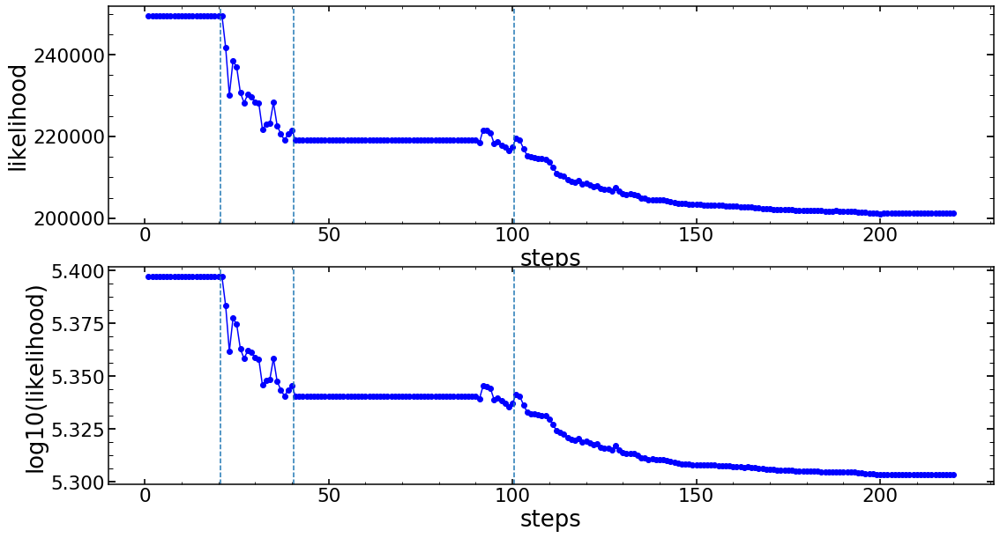

In [315]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [316]:
minchain=results_of_fit_many_interpolation_Ne['m35'].loc[int(single_number)][0:42].values

NameError: name 'results_of_fit_many_interpolation_Ne' is not defined

In [317]:
finalNe_Feb2019.loc[92]

fiber                          10
xc                           2449
yc                            422
wavelength               660.0668
close                           1
lamp                           Ne
xc_effective                 2518
old_index_approx               56
superold_index_approx         nan
Name: 92, dtype: object

In [318]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)

(42,)
          z4        z5        z6        z7        z8        z9       z10  \
0  26.290851  0.128262 -1.275108  1.013689  0.285932 -0.090079 -0.405531   

        z11  
0 -0.176875  
       z12       z13       z14       z15       z16       z17       z18  \
0  0.05883  0.089092 -0.020745  0.015178  0.044563  0.061032 -0.014569   

        z19       z20       z21  
0 -0.012277 -0.031475  0.035632  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.017356  0.691109    0.08644 -0.015054 -0.107006  0.062749     0.016664   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000026             0.000026  0.973055    ...      0.048226   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.999818  1.046431             0.03312   36737.810126   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.574368              0.003567      0.515168  1.807457

In [319]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-201204.82328053558

In [320]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

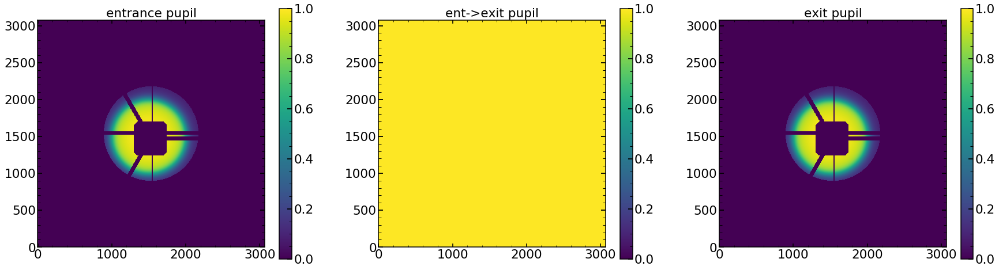

In [321]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

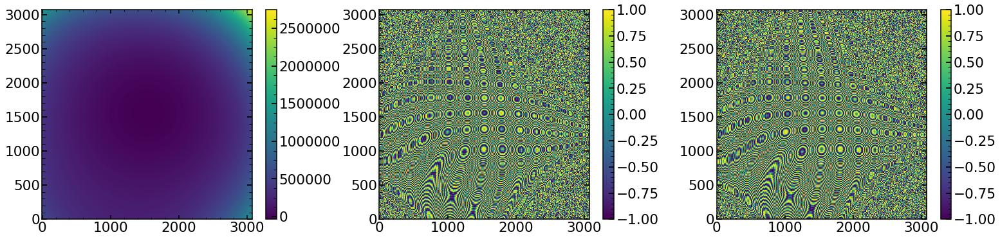

In [322]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

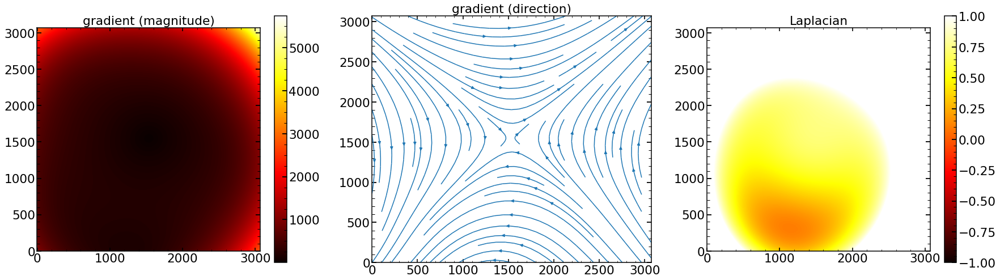

In [323]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

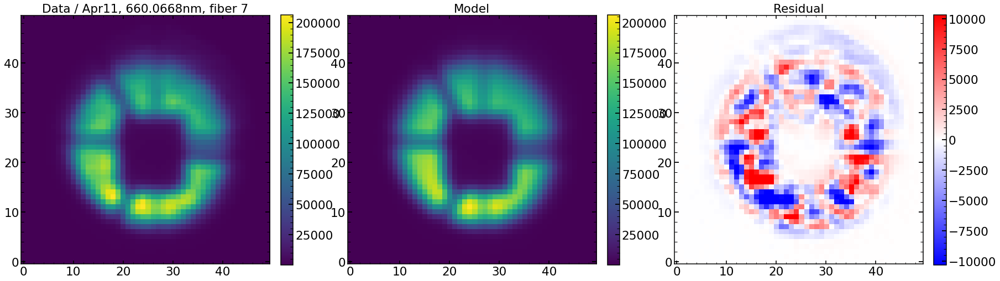

In [324]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 160.95591894371574
Abs of residual divided by total flux is: 0.04899836651189374
Abs of residual divided by largest value of a flux in the image is: 0.11898420531644521


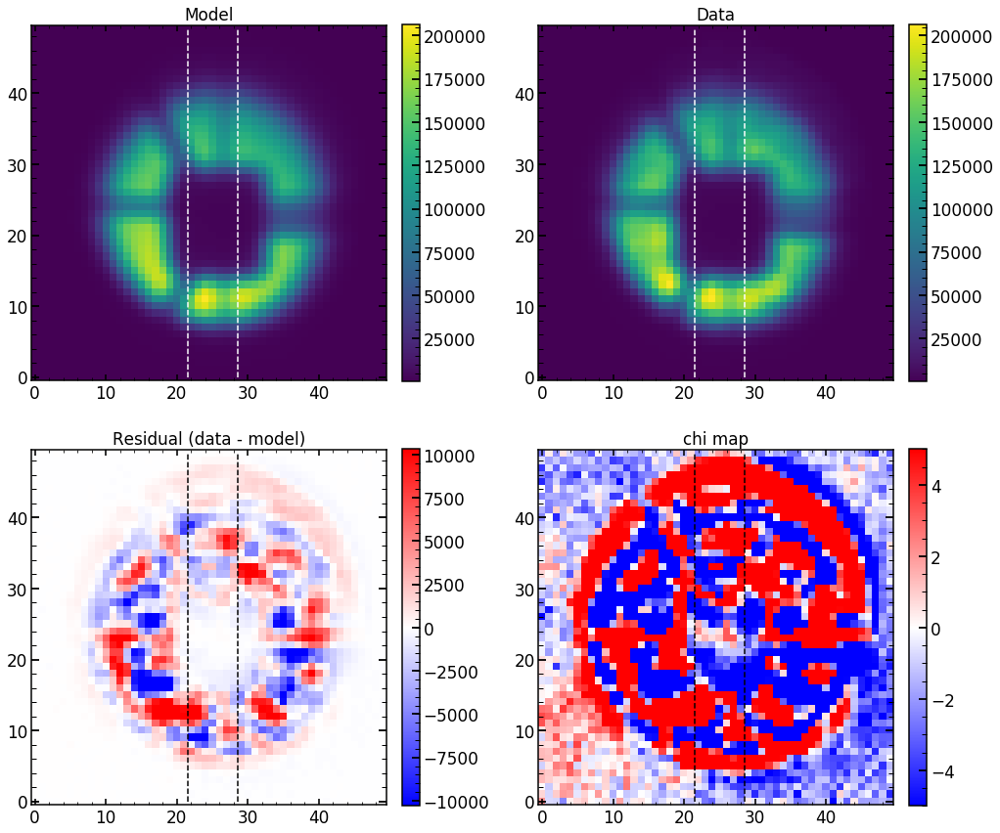

In [325]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

160.95591894371574
chi**2 reduced is: 160.95591894371574
Abs of residual divided by total flux is: 0.04899836651189374
Abs of residual divided by largest value of a flux in the image is: 0.11898420531644521


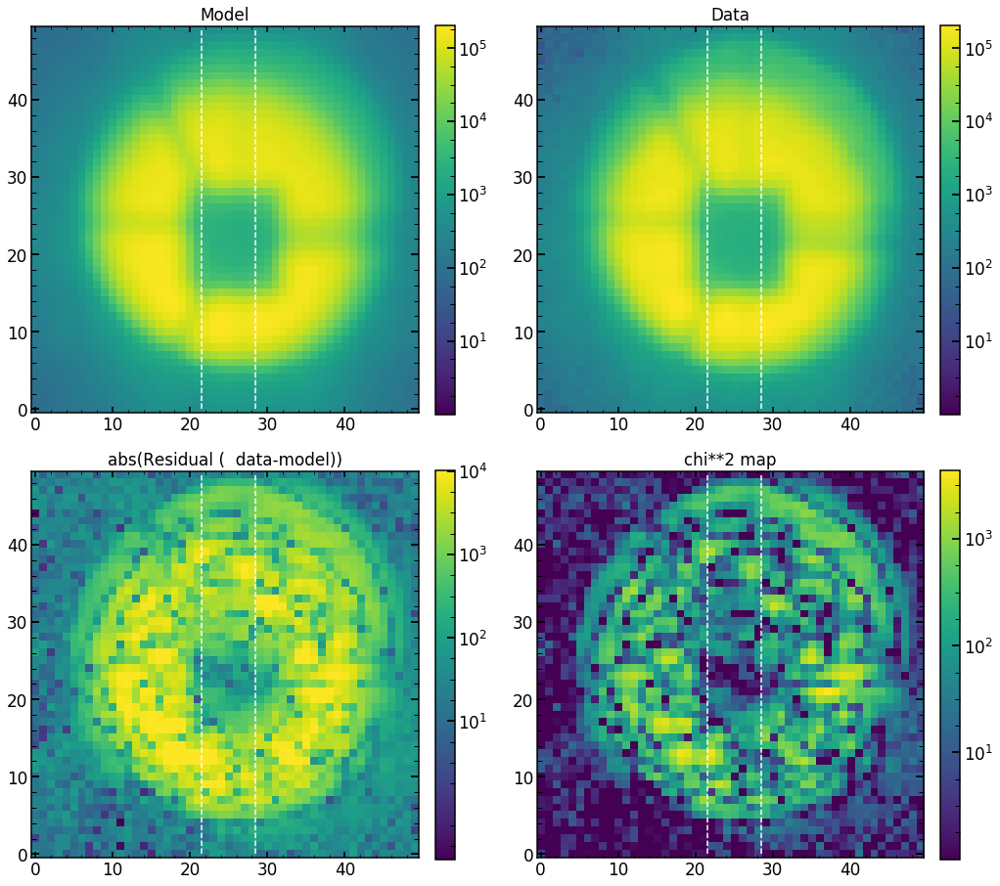

In [326]:
single_analysis.create_basic_comparison_plot_log()

160.95591894371574
chi**2 reduced is: 160.95591894371574
Abs of residual divided by total flux is: 0.04899836651189374
Abs of residual divided by largest value of a flux in the image is: 0.11898420531644521


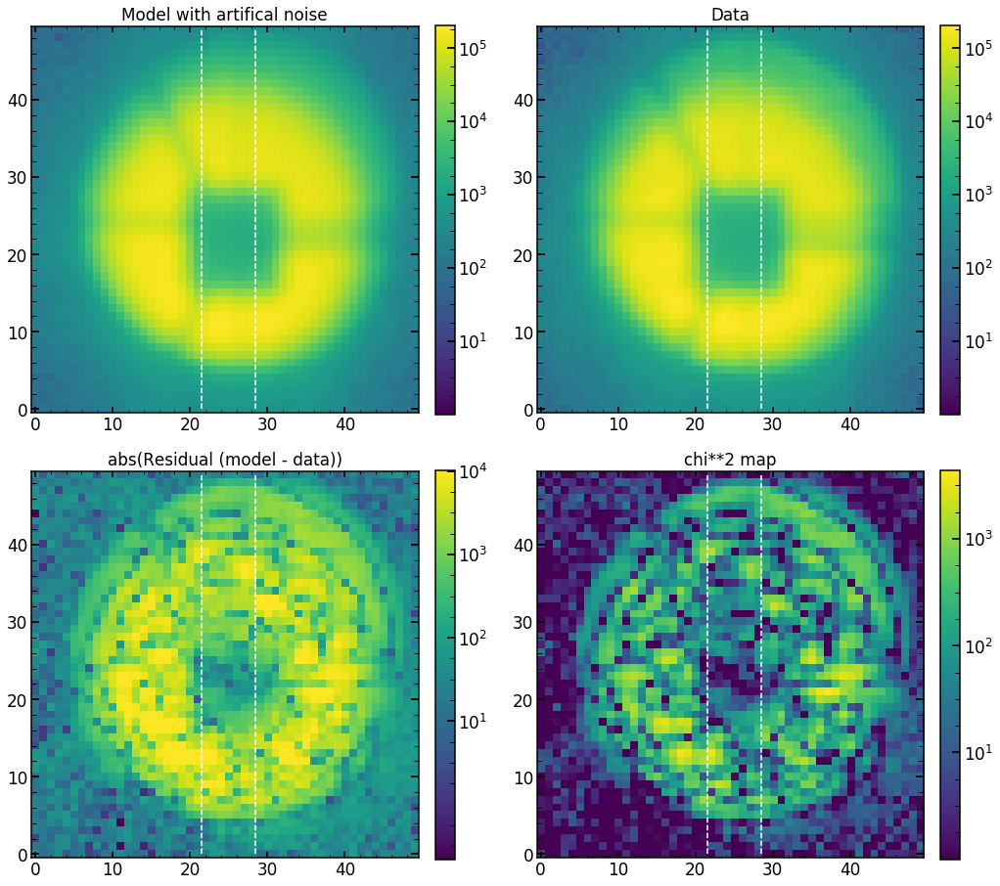

In [327]:
single_analysis.create_basic_comparison_plot_log_artifical()

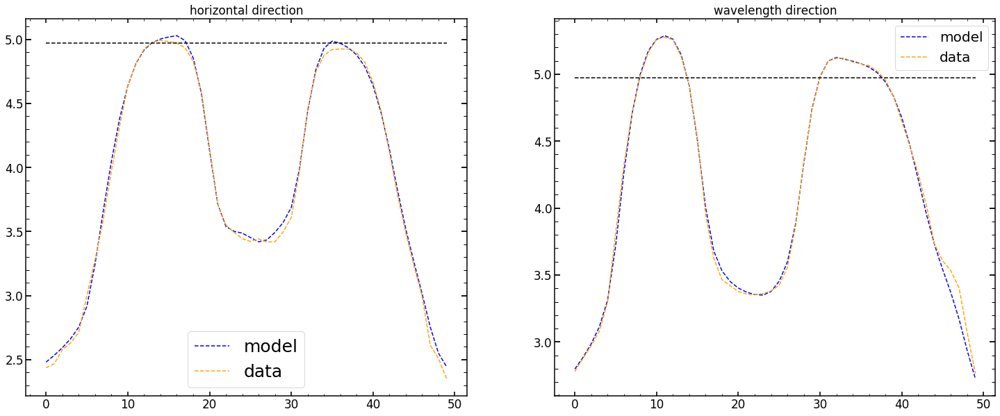

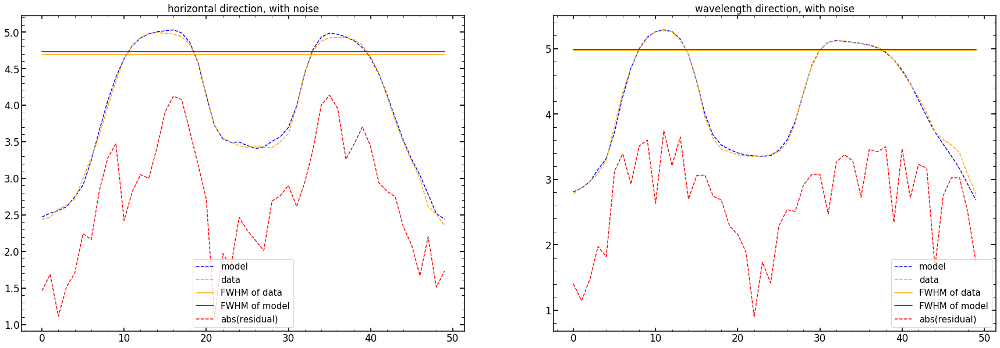

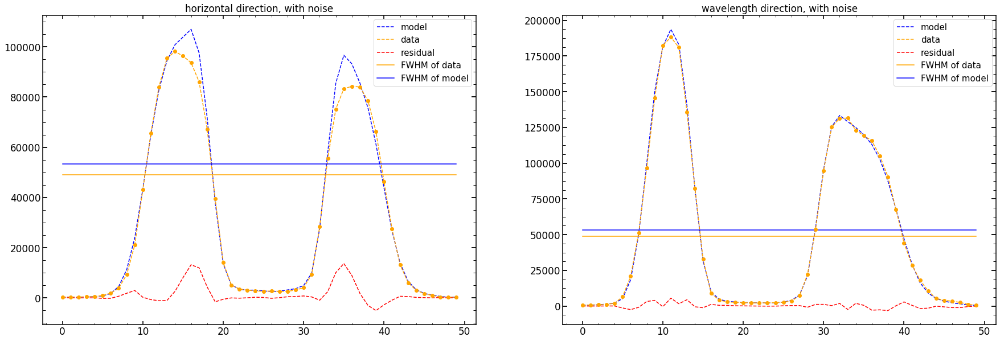

In [328]:
single_analysis.create_cut_plots()

# Apr 16 - defocus

## Creating scripts

In [163]:
date=='Apr11'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr110119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr11.pkl', 'rb') as f:
    results_of_fit_many_single_defocus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr11.pkl', 'rb') as f:
    results_of_fit_many_single_defocus_Ne_pd=pickle.load(f)

In [164]:

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr15_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr15.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

In [165]:
# We want - pupil global, illumination per fiber, wavefront and postprocessing free

In [166]:
results_of_fit_many_HgAr=results_of_fit_many_single_defocus_HgAr_pd
results_of_fit_many_HgAr['0']=results_of_fit_many_single_focus_HgAr_pd

results_of_fit_many_Ne=results_of_fit_many_single_defocus_Ne_pd
results_of_fit_many_Ne['0']=results_of_fit_many_single_focus_Ne_pd

### first script

In [127]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0'].index.values.astype(int)
list_of_Ne_to_analyze=results_of_fit_many_Ne['0'].index.values.astype(int)

list_of_HgAr_to_analyze.shape

(7,)

In [128]:
list_of_Ne_to_analyze

array([], dtype=int64)

In [1059]:
list_of_HgAr_to_analyze_5_6_7=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=7)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=5)]

list_of_Ne_to_analyze_5_6_7=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=7)&(finalNe_Feb2019['fiber'].values.astype(int)>=5)]



In [1063]:
list_of_HgAr_to_analyze=np.intersect1d(list_of_HgAr_to_analyze,list_of_HgAr_to_analyze_5_6_7)
list_of_Ne_to_analyze=np.intersect1d(list_of_Ne_to_analyze,list_of_Ne_to_analyze_5_6_7)

In [1064]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T05S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger05'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T05S'+str(single_spot)+'Apr.sh \n')

file.close()

In [1065]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T06S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger06'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T06S'+str(single_spot)+'Apr.sh \n')

file.close()

### second script

In [140]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0'].index.values.astype(int)
list_of_Ne_to_analyze=results_of_fit_many_Ne['0'].index.values.astype(int)

list_of_HgAr_to_analyze.shape

(56,)

In [141]:
list_of_HgAr_to_analyze_5_6_7=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=10)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=8)]

list_of_Ne_to_analyze_5_6_7=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=10)&(finalNe_Feb2019['fiber'].values.astype(int)>=8)]

In [142]:
list_of_HgAr_to_analyze=np.intersect1d(list_of_HgAr_to_analyze,list_of_HgAr_to_analyze_5_6_7)
list_of_Ne_to_analyze=np.intersect1d(list_of_Ne_to_analyze,list_of_Ne_to_analyze_5_6_7)

In [151]:
list_of_Ne_to_analyze

array([74, 77, 78, 83, 86, 87, 92, 95, 96])

In [143]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T07S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger07'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T07S'+str(single_spot)+'Apr.sh \n')

file.close()

In [144]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T08S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger08'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T08S'+str(single_spot)+'Apr.sh \n')

file.close()

In [139]:
results_of_fit_many_Ne

{'0':            z4        z5        z6        z7        z8        z9       z10  \
 2    3.277713  0.637529 -0.243838  0.807899  1.051614  0.230904 -0.459890   
 5    2.986933  0.921207  0.173872  0.510538  0.959053  0.247405 -0.197635   
 6    2.975069  0.484556  0.089676  0.577234  0.883480  0.109023 -0.265271   
 11   2.766697  0.597284 -0.347104  0.820374  0.800728  0.057072 -0.510239   
 14   2.484130  0.399423 -0.197850  0.675546  0.752537  0.025278 -0.389342   
 15   2.512621  0.448044 -0.030494  0.531922  0.716990  0.001646 -0.375654   
 38   1.295252  0.460489 -0.666504  0.795452  0.389785 -0.050177 -0.361820   
 41   1.113790  0.457367 -0.495327  0.589080  0.338074 -0.023104 -0.301421   
 42   1.083839  0.372590 -0.376892  0.466112  0.242296 -0.012898 -0.300311   
 47   0.829277  0.261744 -0.768107  0.721896  0.291606 -0.076611 -0.302026   
 56   0.634843  0.253938 -0.815711  0.762480  0.238155 -0.066904 -0.266374   
 59   0.559394  0.184559 -0.682627  0.531325  0.207472 -0.0

### third script

In [182]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0'].index.values.astype(int)
list_of_Ne_to_analyze=results_of_fit_many_Ne['0'].index.values.astype(int)

list_of_HgAr_to_analyze.shape

(56,)

In [183]:
list_of_HgAr_to_analyze_5_6_7=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=16)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=11)]

list_of_Ne_to_analyze_5_6_7=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=16)&(finalNe_Feb2019['fiber'].values.astype(int)>=11)]

In [184]:
list_of_HgAr_to_analyze=np.intersect1d(list_of_HgAr_to_analyze,list_of_HgAr_to_analyze_5_6_7)
list_of_Ne_to_analyze=np.intersect1d(list_of_Ne_to_analyze,list_of_Ne_to_analyze_5_6_7)

In [185]:
list_of_Ne_to_analyze

array([101, 104, 105, 110, 114, 119, 122, 123, 124, 128, 131, 132, 133,
       137, 140, 141, 142])

In [186]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T09S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger09'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T09S'+str(single_spot)+'Apr.sh \n')

file.close()

In [187]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T10S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger10'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T10S'+str(single_spot)+'Apr.sh \n')

file.close()

### fourth script

In [188]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0'].index.values.astype(int)
list_of_Ne_to_analyze=results_of_fit_many_Ne['0'].index.values.astype(int)

list_of_HgAr_to_analyze.shape

(56,)

In [189]:
list_of_HgAr_to_analyze_5_6_7=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=4)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=0)]

list_of_Ne_to_analyze_5_6_7=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=4)&(finalNe_Feb2019['fiber'].values.astype(int)>=0)]

In [190]:
list_of_HgAr_to_analyze=np.intersect1d(list_of_HgAr_to_analyze,list_of_HgAr_to_analyze_5_6_7)
list_of_Ne_to_analyze=np.intersect1d(list_of_Ne_to_analyze,list_of_Ne_to_analyze_5_6_7)

In [191]:
list_of_Ne_to_analyze

array([ 2,  5,  6, 11, 14, 15, 38, 41, 42])

In [192]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T11S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger11'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T11S'+str(single_spot)+'Apr.sh \n')

file.close()

In [193]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T12S'+str(single_spot)+'Apr.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger12'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T12S'+str(single_spot)+'Apr.sh \n')

file.close()

## Looking at the single image

### which images are avaliable

In [329]:
import glob
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr16/chainApr16_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr16/chainApr16_Single_P_*5HgArEmcee3.npy', recursive=True)

In [330]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[i])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [331]:
analyzed_Neon_images

array([[12319,    83],
       [12319,   101],
       [12307,   131],
       [12361,   105],
       [12397,    83],
       [12355,    95],
       [12355,    38],
       [12355,    92],
       [12349,   119],
       [12343,    42],
       [12313,     6],
       [12361,    59],
       [12397,    69],
       [12361,     2],
       [12397,    96],
       [12313,   104],
       [12307,    41],
       [12307,    14],
       [12361,   110],
       [12307,   124],
       [12361,     5],
       [12307,   123],
       [12319,    69],
       [12319,    96],
       [12319,   114],
       [12319,   141],
       [12391,    68],
       [12403,     6],
       [12397,     6],
       [12355,    78],
       [12355,    87],
       [12403,   132],
       [12367,     6],
       [12361,    68],
       [12319,   122],
       [12307,   140],
       [12313,   132],
       [12343,    74],
       [12367,    96],
       [12367,    69],
       [12307,    77],
       [12349,    86],
       [12403,   104],
       [123

In [332]:
arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]



In [333]:
arranged_by_spot_number_Ne

array([[12355,     2],
       [12307,     2],
       [12313,     2],
       [12403,     2],
       [12343,     2],
       [12397,     2],
       [12349,     2],
       [12319,     2],
       [12367,     2],
       [12361,     2],
       [12361,     5],
       [12355,     5],
       [12397,     5],
       [12391,     5],
       [12403,     5],
       [12367,     5],
       [12349,     6],
       [12397,     6],
       [12403,     6],
       [12355,     6],
       [12361,     6],
       [12343,     6],
       [12307,     6],
       [12313,     6],
       [12367,     6],
       [12319,     6],
       [12313,    11],
       [12397,    11],
       [12307,    11],
       [12343,    11],
       [12349,    11],
       [12319,    11],
       [12403,    11],
       [12355,    11],
       [12361,    11],
       [12367,    11],
       [12391,    14],
       [12319,    14],
       [12367,    14],
       [12355,    14],
       [12397,    14],
       [12313,    14],
       [12307,    14],
       [123

### continue

In [1043]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr16'
obs=12403
single_number='96'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m4


fiber                           10
xc                            2448
yc                            1078
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  2517
old_index_approx                60
superold_index_approx          nan
Name: 96, dtype: object

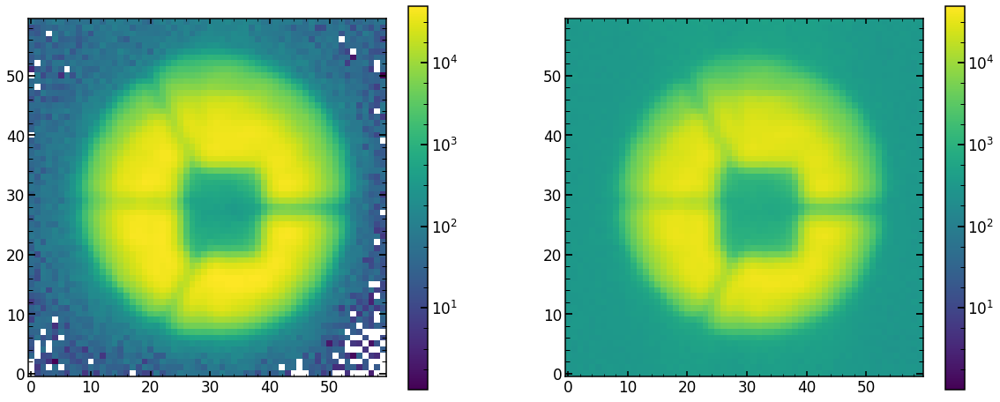

In [1044]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [1045]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 92949.82378006054
minimal chi2 reduced is: 51.633567049021146


In [1046]:
minchain_12403_96=minchain

In [961]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6        z7       z8        z9       z10  \
0  29.928382  0.003262 -0.960066  0.674039  0.22147 -0.064808 -0.385183   

        z11  
0 -0.266973  
        z12       z13      z14       z15       z16       z17       z18  \
0  0.052172 -0.006911 -0.03711 -0.024922 -0.032925  0.034073  0.040339   

        z19       z20       z21  
0  0.002419 -0.010447  0.034188  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.105946  0.689199   0.083246 -0.048176 -0.074811  0.061243     0.021009   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000017             0.000017  0.973426    ...      0.050701   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.998677  1.033049            0.151045   46589.837244   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.391386               0.00248      0.600874  1.783327  

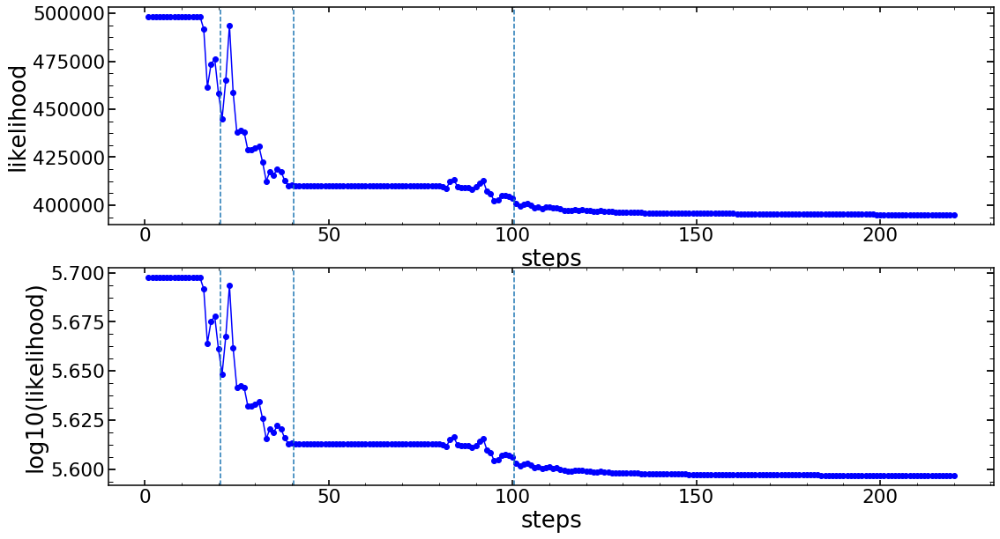

In [962]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [963]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-395141.28855630674

In [964]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

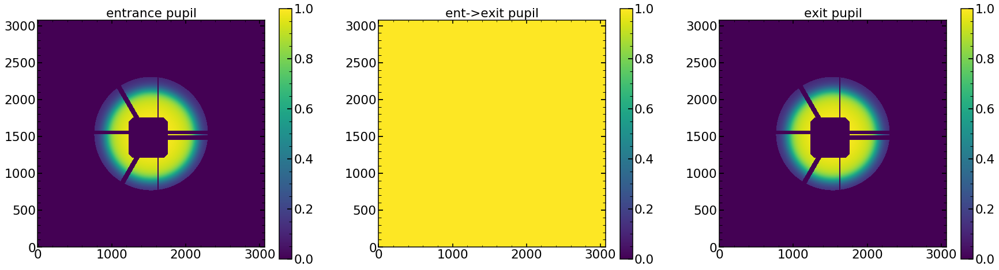

In [965]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

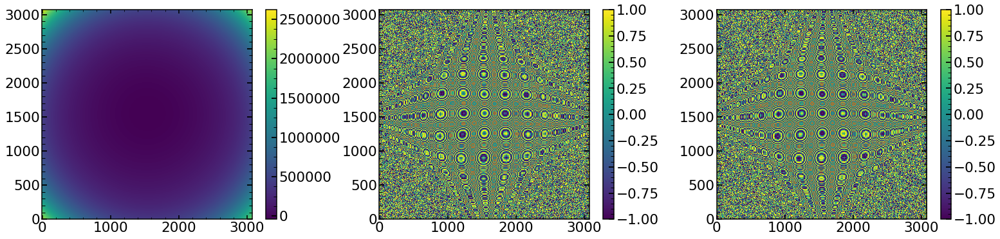

In [966]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

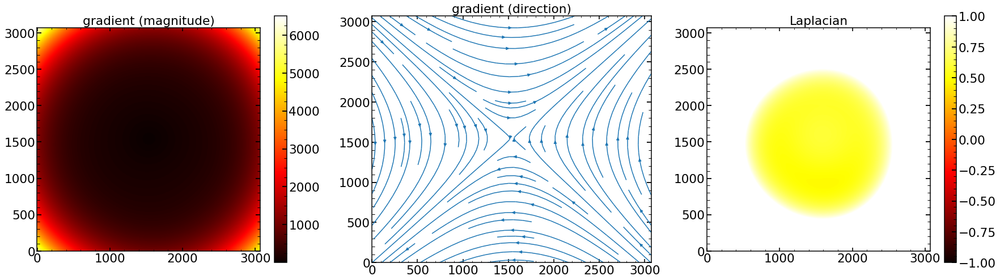

In [967]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

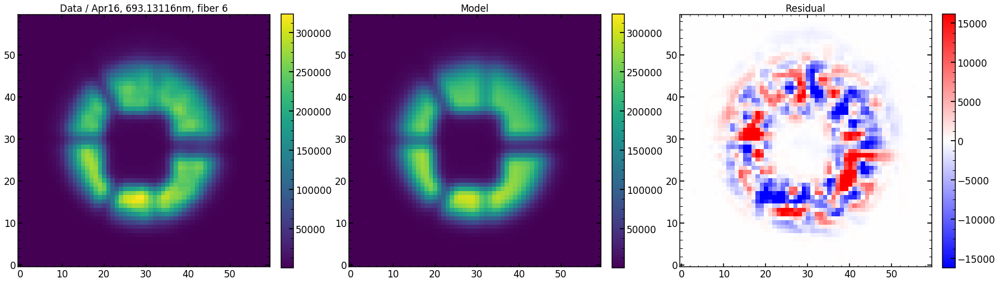

In [974]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

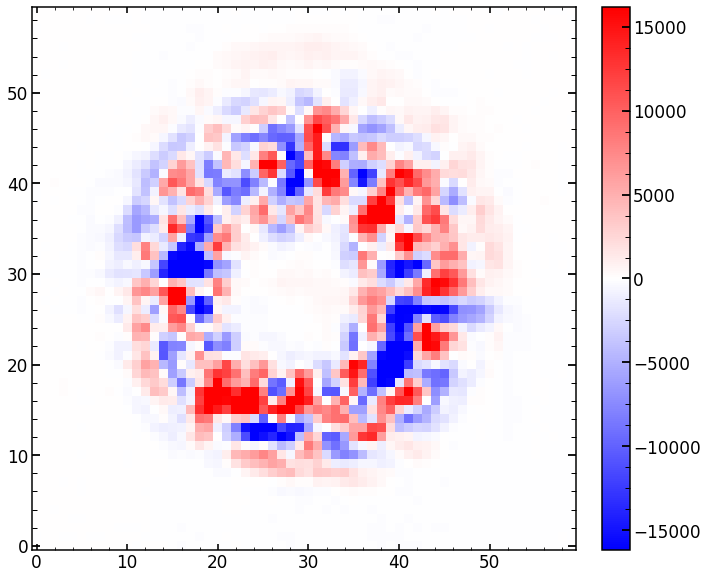

chi**2 reduced is: 219.51721869454042
Abs of residual divided by total flux is: 0.04830887676078515
Abs of residual divided by largest value of a flux in the image is: 0.11672582005577241


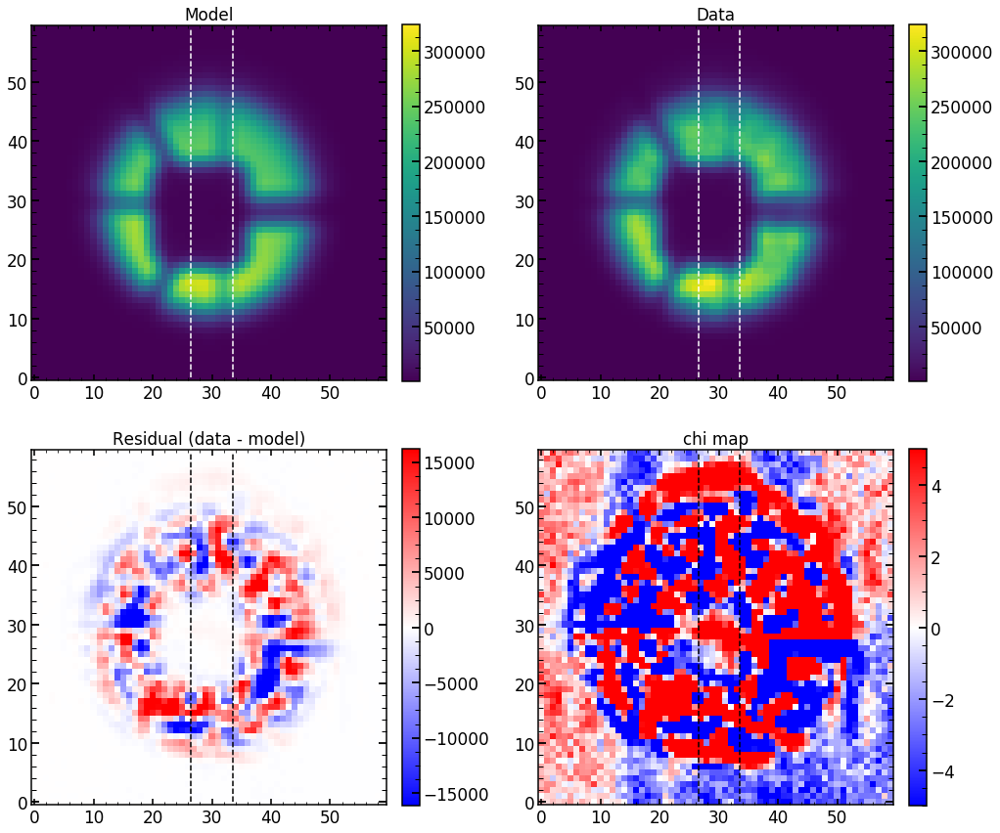

In [969]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

219.51721869454042
chi**2 reduced is: 219.51721869454042
Abs of residual divided by total flux is: 0.04830887676078515
Abs of residual divided by largest value of a flux in the image is: 0.11672582005577241


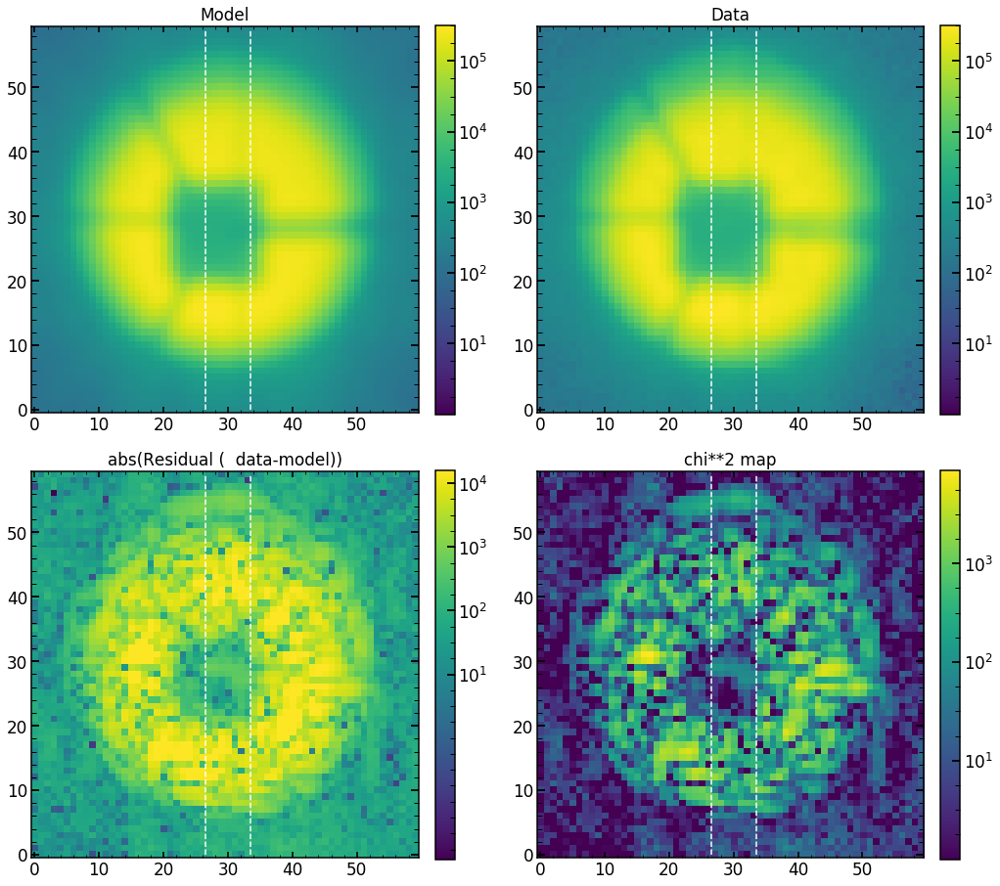

In [970]:
single_analysis.create_basic_comparison_plot_log()

219.51721869454042
chi**2 reduced is: 219.51721869454042
Abs of residual divided by total flux is: 0.04830887676078515
Abs of residual divided by largest value of a flux in the image is: 0.11672582005577241


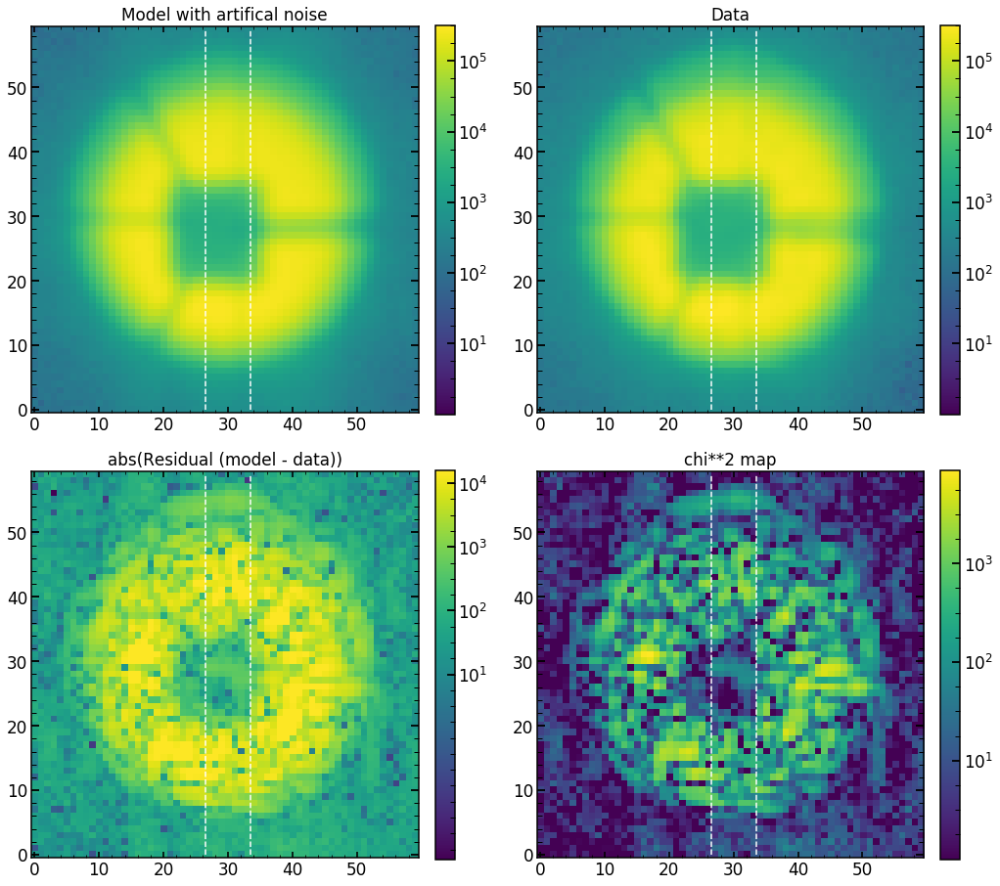

In [971]:
single_analysis.create_basic_comparison_plot_log_artifical()

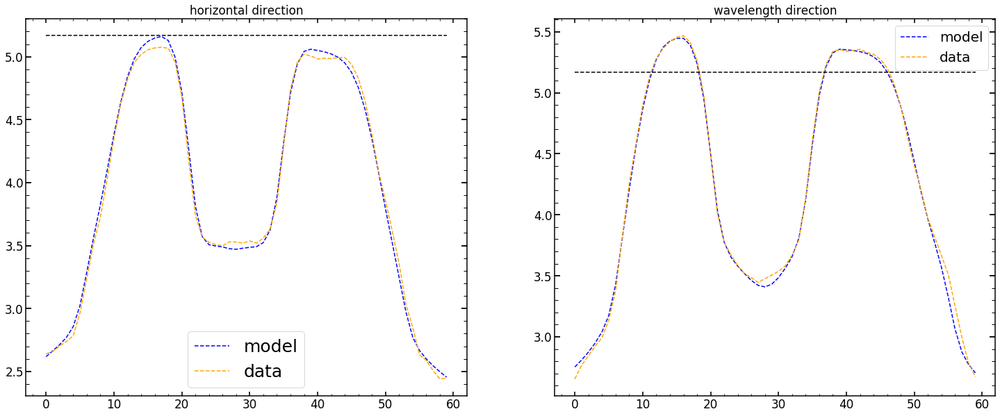

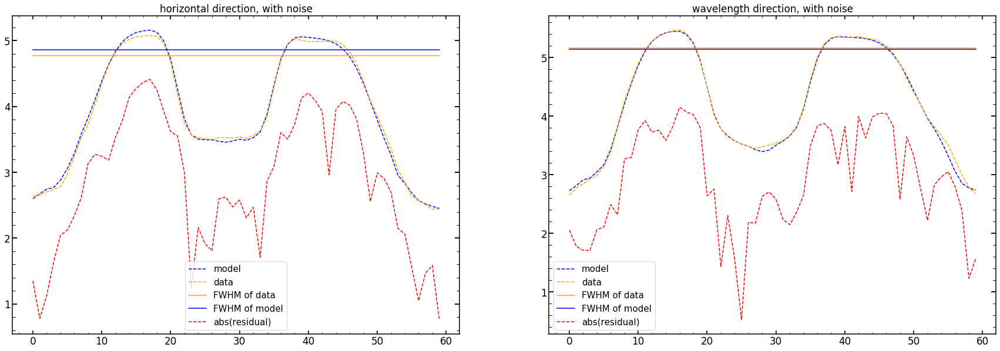

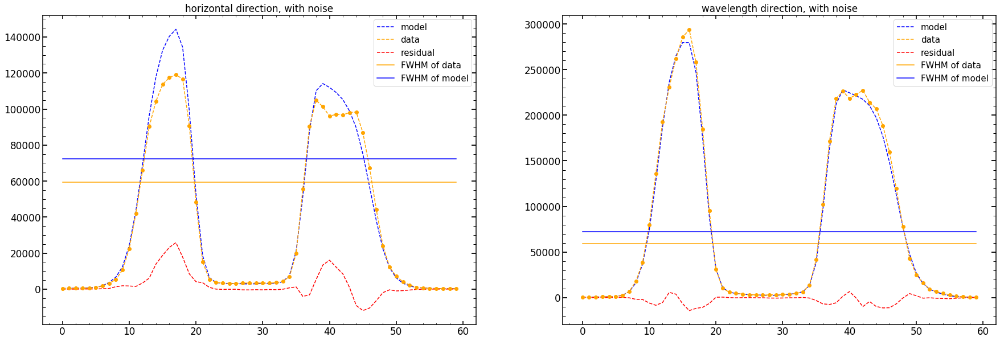

In [972]:
single_analysis.create_cut_plots()

### 59 digression

In [976]:
all_data_old_full=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/rerun/Apr30_2019/detrend/calExp/2019-02-16/v0012403/calExp-LA012403r1.fits')
all_data_new_full=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/detrend/calExp/2019-04-17/v0016249/calExp-LA016249r1.fits')

In [977]:
print(all_data_old_full[0].header['W_ENFCAX'])
print(all_data_new_full[0].header['W_ENFCAX'])
assert (np.abs(all_data_old_full[0].header['W_ENFCAX']-all_data_new_full[0].header['W_ENFCAX'])<0.05)


-4.00001
-4.0


In [980]:
finalNe_Feb2019.loc[59]

fiber                            6
xc                            1618
yc                             800
wavelength               693.13116
close                            1
lamp                            Ne
xc_effective                  1618
old_index_approx                32
superold_index_approx          nan
Name: 59, dtype: object

In [979]:
sci_data_old_full=all_data_old_full[1].data
sci_data_new_full=all_data_new_full[1].data

var_data_old_full=all_data_old_full[3].data
var_data_new_full=all_data_new_full[3].data

In [1002]:
sci_data_old_cutout=sci_data_old_full[800-30+2:800+30+2,1618-30-3:1618+30-3]
sci_data_new_cutout=sci_data_new_full[799-30:799+30,1618-30-10:1618+30-10]

var_data_old_cutout=var_data_old_full[800-30+3:800+30+3,1618-30:1618+30]
var_data_new_cutout=var_data_new_full[800-30:800+30,1618-30:1618+30]

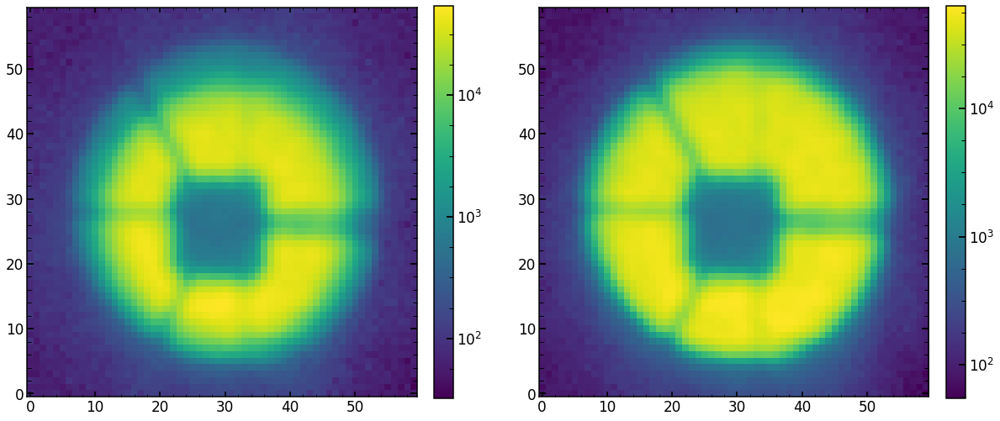

In [1003]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.imshow(sci_data_old_cutout,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


plt.subplot(122)
plt.imshow(sci_data_new_cutout,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

Text(0.5,1,'Residual  (model - data)')

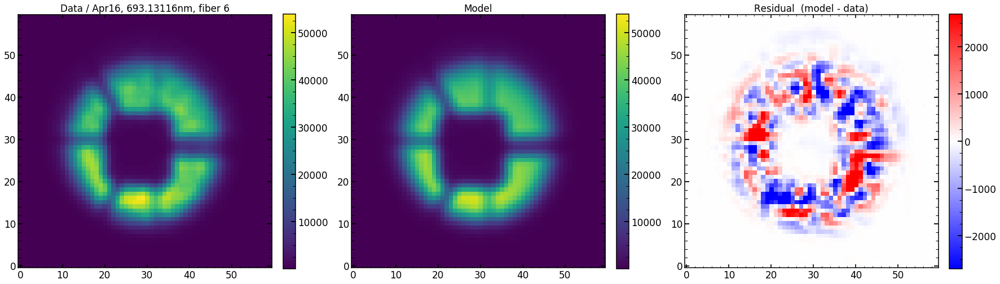

In [1016]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image/6,vmax=np.max(sci_image/6))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus/6,vmax=np.max(sci_image/6))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus/6-sci_image/6,vmin=-np.max(sci_image/6)/20,vmax=np.max(sci_image/6)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual  (model - data)')

In [1005]:
minchain_16249_59=np.array([   29.73419515 ,    0.00326164 ,   -0.9600661  ,    0.6740385,
     0.22146978,    -0.06480767,    -0.38518289,    -0.26697268,
     0.05217206,    -0.00691053,    -0.03710959,    -0.02492236,
    -0.03292478 ,    0.03407291,     0.04033863 ,    0.00241916,
    -0.01044722,     0.03418758,     0.10594647 ,    0.68919922,
     0.08324638,    -0.04817597,   -0.07481081 ,    0.06124287,
     0.02100885,     0.00001728,     0.00001728,     0.9734256,
     0.94833397,    -0.01125947,    -0.04074205,     0.94282868,
     0.02187761,     0.79924877,     1.03304884,     0.15104478,
 46589.83724444,     2.39138636 ,    0.00248015,     0.60087405,
     1.78332658,     0.99318176])


extraZernike: None
zmax: 22
42


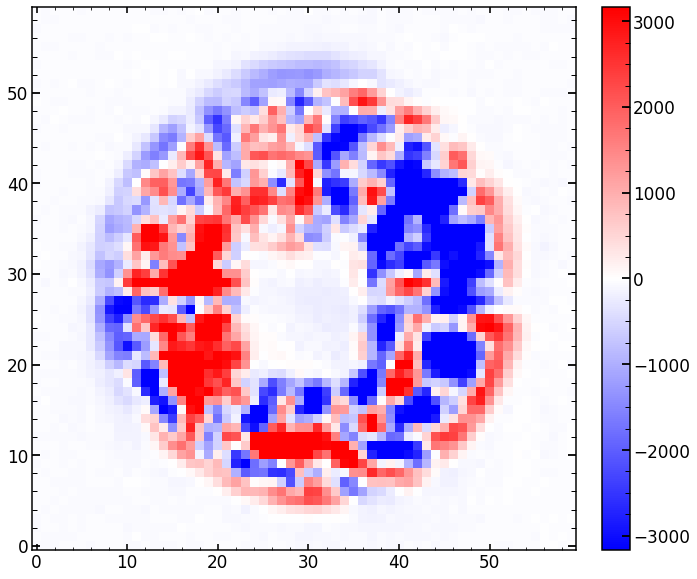

In [1007]:
model_new = LN_PFS_single(sci_data_new_cutout,var_data_new_cutout,dithering=1,save=1,zmax=22)       
model_new(minchain_16249_59)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_new_michain_to_new_data=optPsf_cut_fiber_convolved_downsampled

plt.imshow(res_iapetus_new_michain_to_new_data-sci_data_new_cutout,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_data_new_cutout))/20,vmax=np.max(np.abs(sci_data_new_cutout))/20)
plt.colorbar(fraction=0.046, pad=0.04)

Text(0.5,1,'Residual (model - data)')

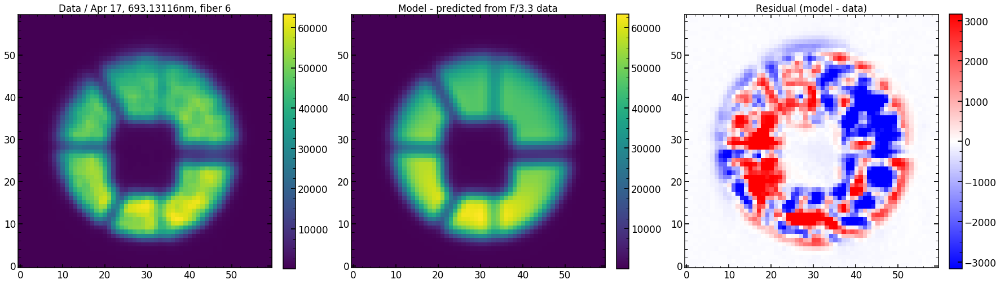

In [1013]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_data_new_cutout,vmax=np.max(sci_data_new_cutout))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+'Apr 17'+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus_new_michain_to_new_data,vmax=np.max(sci_data_new_cutout))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model - predicted from F/3.3 data')
plt.subplot(1,3,3)
plt.imshow(res_iapetus_new_michain_to_new_data-sci_data_new_cutout,vmin=-np.max(sci_data_new_cutout)/20,vmax=np.max(sci_data_new_cutout)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual (model - data)')

Text(0.5,1,'Residual (model - data)')

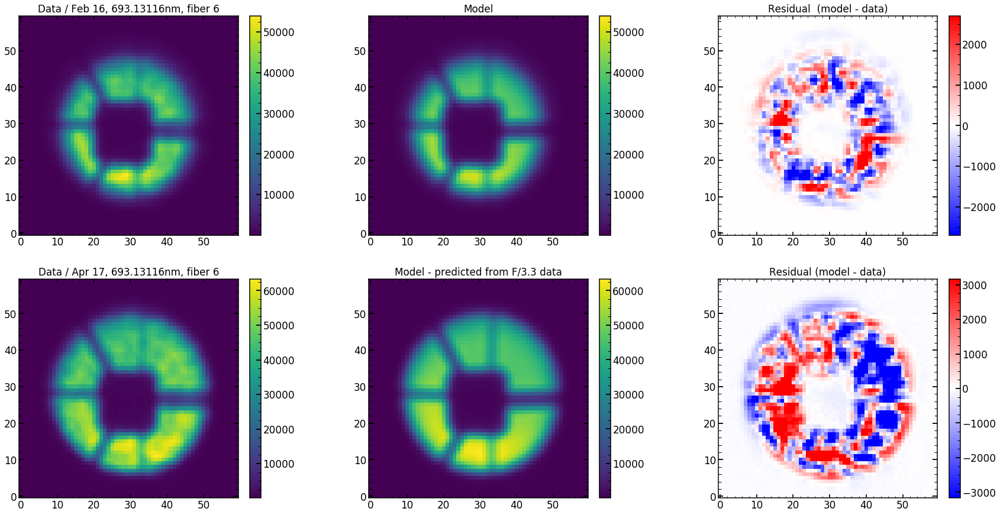

In [1019]:
plt.figure(figsize=(30,15))
plt.subplot(2,3,1)
plt.imshow(sci_image/6,vmax=np.max(sci_image/6))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+'Feb 16'+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(2,3,2)
plt.imshow(res_iapetus/6,vmax=np.max(sci_image/6))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(2,3,3)
plt.imshow(res_iapetus/6-sci_image/6,vmin=-np.max(sci_image/6)/20,vmax=np.max(sci_image/6)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual  (model - data)')


plt.subplot(2,3,4)
plt.imshow(sci_data_new_cutout,vmax=np.max(sci_data_new_cutout))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+'Apr 17'+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(2,3,5)
plt.imshow(res_iapetus_new_michain_to_new_data,vmax=np.max(sci_data_new_cutout))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model - predicted from F/3.3 data')
plt.subplot(2,3,6)
plt.imshow(res_iapetus_new_michain_to_new_data-sci_data_new_cutout,vmin=-np.max(sci_data_new_cutout)/20,vmax=np.max(sci_data_new_cutout)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual (model - data)')


## Creation of pandas dataframe

In [44]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('Apr16',single_number,'HgAr',22)
    solution_at_0=solution_at_0_and_plots('Apr16',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]



22
0 11796 HgAr is NOT found or failed!
0 11790 HgAr is NOT found or failed!
0 11784 HgAr is NOT found or failed!
0 11778 HgAr is NOT found or failed!
0 11772 HgAr is NOT found or failed!
0 11766 HgAr is NOT found or failed!
0 11760 HgAr is NOT found or failed!
0 11754 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11694 HgAr is NOT found or failed!
0 11700 HgAr is NOT found or failed!
0 11706 HgAr is NOT found or failed!
0 11712 HgAr is NOT found or failed!
0 11718 HgAr is NOT found or failed!
0 11724 HgAr is NOT found or failed!
0 11730 HgAr is NOT found or failed!
0 11736 HgAr is NOT found or failed!
22
1 11796 HgAr is NOT found or failed!
1 11790 HgAr is NOT found or failed!
1 11784 HgAr is NOT found or failed!
1 11778 HgAr is NOT found or failed!
1 11772 HgAr is NOT found or failed!
1 11766 HgAr is NOT found or failed!
1 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
sli

y_ilum: failed!
frd_sigma: failed!
6 obs (Emcee3): 11790 is found!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
6 obs (Emcee3): 11784 is found!
strutFrac: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
6 11778 HgAr is NOT found or failed!
6 11772 HgAr is NOT found or failed!
6 11766 HgAr is NOT found or failed!
6 obs (Emcee3): 11760 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
frd_sigma: fail

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
9 obs (Emcee3): 11694 is found!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
9 11700 HgAr is NOT found or failed!
9 11706 HgAr is NOT found or failed!
9 11712 HgAr is NOT found or failed!
9 11718 HgAr is NOT found or failed!
9 obs 

hscFrac: failed!
frd_lorentz_factor: failed!
hscFrac: failed!
frd_lorentz_factor: failed!
13 obs (Emcee3): 11784 is found!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
13 11778 HgAr is NOT found or failed!
13 11772 HgAr is NOT found or failed!
13 11766 HgAr is NOT found or failed!
13 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_

x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
18 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
18 11778 HgAr is NOT found or failed!
18 11772 HgAr is NOT found or failed!
18 11766 HgAr is NOT found or failed!
18 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!


hscFrac: failed!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
21 obs (Emcee3): 11748 is found!
hscFrac: failed!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
21 obs (Emcee3): 11694 is found!
strutFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: 

23 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
23 obs (Emcee3): 11736 is found!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
22
24 11796 HgAr is NOT found or failed!
24 11790 HgAr is NOT found or failed!
24 11784 HgAr is NOT found or failed!
24 11778 HgAr is NOT foun

22
40 11796 HgAr is NOT found or failed!
40 11790 HgAr is NOT found or failed!
40 11784 HgAr is NOT found or failed!
40 11778 HgAr is NOT found or failed!
40 11772 HgAr is NOT found or failed!
40 11766 HgAr is NOT found or failed!
40 11760 HgAr is NOT found or failed!
40 11754 HgAr is NOT found or failed!
40 11748 HgAr is NOT found or failed!
40 11748 HgAr is NOT found or failed!
40 11694 HgAr is NOT found or failed!
40 11700 HgAr is NOT found or failed!
40 11706 HgAr is NOT found or failed!
40 11712 HgAr is NOT found or failed!
40 11718 HgAr is NOT found or failed!
40 11724 HgAr is NOT found or failed!
40 11730 HgAr is NOT found or failed!
40 11736 HgAr is NOT found or failed!
22
41 11796 HgAr is NOT found or failed!
41 11790 HgAr is NOT found or failed!
41 11784 HgAr is NOT found or failed!
41 11778 HgAr is NOT found or failed!
41 11772 HgAr is NOT found or failed!
41 11766 HgAr is NOT found or failed!
41 11760 HgAr is NOT found or failed!
41 11754 HgAr is NOT found or failed!
41 117

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
49 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
49 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: fa

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
54 obs (Emcee3): 11694 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: faile

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
57 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
57 11706 HgAr is NOT found or failed!
57 11712 HgAr is NOT found or failed!
57 11718 HgAr is NOT found or failed!
57 obs (Emcee3): 11724 is found!
hscFrac: failed!
strutFrac: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber

hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
59 11736 HgAr is NOT found or failed!
22
60 11796 HgAr is NOT found or failed!
60 11790 HgAr is NOT found or failed!
60 11784 HgAr is NOT found or failed!
60 11778 HgAr is NOT found or failed!
60 11772 HgAr is NOT found or failed!
60 11766 HgAr is NOT found or failed!
60 11760 HgAr is NOT found or failed!
60 11754 HgAr is NOT found or failed!
60 11748 HgAr is NOT found or failed!
60 11748 HgAr is NOT found or failed!
60 11694 HgAr is NOT found or failed!
60 11700 HgAr is NOT found or failed!
60 11706 HgAr is NOT found or failed!
60 11712 HgAr is NOT found or failed!
60 11718 HgAr is NOT found or failed!
60 11724 HgAr is NOT found or failed!
60 11730 HgAr is NOT found or failed!
60 11736 HgAr is NOT found or fail

dxFocal: failed!
slitFrac: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
66 obs (Emcee3): 11790 is found!
det_vert: failed!
slitHolder_frac_dx: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
66 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
66 11778 HgAr is NOT found or failed!
66 11772 HgAr is NOT found or failed!
66 11766 HgAr is NOT found or f

slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
69 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
69 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
71 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
71 11706 HgAr is NOT found or failed!
71 11712 HgAr is NOT 

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
78 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
78 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiom

81 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
81 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFoc

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
83 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
83 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: fail

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
90 obs (Emcee3): 11790 is found!
hscFrac: failed!
slitFrac_dy: failed!
x_fiber: failed!
det_vert: failed!
hscFrac: failed!
slitFrac_dy: failed!
x_fiber: failed!
det_vert: failed!
90 obs (Emcee3): 11784 is found!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
90 11778 HgAr is NOT found or failed!
90 11772 HgAr is NOT found or failed!
90 11766 HgAr is NOT found or failed!
90 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
93 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
93 obs (Emcee3): 11700 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: 

dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
97 obs (Emcee3): 11784 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
97 11778 HgAr is NOT found or failed!
97 11772 HgAr is NOT found or failed!
97 11766 HgAr is NOT found or failed!
97 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_v

strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
102 obs (Emcee3): 11790 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
102 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
102 11778 HgAr is NOT found or failed!
102 11772 HgAr is NOT found or failed!
102 11766 HgAr is NOT fou

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
105 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
105 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: faile

22
108 11796 HgAr is NOT found or failed!
108 11790 HgAr is NOT found or failed!
108 11784 HgAr is NOT found or failed!
108 11778 HgAr is NOT found or failed!
108 11772 HgAr is NOT found or failed!
108 11766 HgAr is NOT found or failed!
108 11760 HgAr is NOT found or failed!
108 11754 HgAr is NOT found or failed!
108 11748 HgAr is NOT found or failed!
108 11748 HgAr is NOT found or failed!
108 11694 HgAr is NOT found or failed!
108 11700 HgAr is NOT found or failed!
108 11706 HgAr is NOT found or failed!
108 11712 HgAr is NOT found or failed!
108 11718 HgAr is NOT found or failed!
108 11724 HgAr is NOT found or failed!
108 11730 HgAr is NOT found or failed!
108 11736 HgAr is NOT found or failed!
22
109 obs (Emcee3): 11796 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
det_vert: failed!
109 obs (Emcee3): 11790 is found!
slitFrac: 

strutFrac: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
114 obs (Emcee3): 11790 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
114 obs (Emcee3): 11784 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
114 11778 HgAr is NOT found or failed!
114 11772 HgAr is NOT found or failed!
114 11766 HgAr is NOT found or failed!
114 obs (Emcee3): 11760 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: fai

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
slitHolder_frac_dx: failed!
117 obs (Emcee3): 11700 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
det_vert: failed!
117 11706 HgAr is NOT found or failed!
117 11712 HgAr is NOT found or failed!
117 11718 HgAr is NOT found or failed!
117 11724 HgAr is NOT found or failed!
117 obs (Emcee3): 11730 is found!
strutFrac: failed!
strutFrac: failed!
117 obs (Emcee3): 11736 is found!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!


effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
121 11784 HgAr is NOT found or failed!
121 11778 HgAr is NOT found or failed!
121 11772 HgAr is NOT found or failed!
121 11766 HgAr is NOT found or failed!
121 obs (Emcee3): 11760 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
121 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: fail

hscFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
126 11790 HgAr is NOT found or failed!
126 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
126 11778 HgAr is NOT found or failed!
126 11772 HgAr is NOT found or failed!
126 11766 HgAr is NOT found or failed!
126 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_i

frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
129 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
129 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
129 obs (Emcee3): 11694 is found!


hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
131 11706 HgAr is NOT found or failed!
131 11712 HgAr is NOT found or failed!
131 11718 HgAr is NOT found or failed!
131 obs (Emcee3): 11724 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
131 obs (Emcee3): 11730 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dy

strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
138 obs (Emcee3): 11790 is found!
strutFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
138 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: fa

strutFrac: failed!
dxFocal: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
141 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
141 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
141 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
sl

slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
143 11706 HgAr is NOT found or failed!
143 11712 HgAr is NOT found or failed!
143 11718 HgAr is NOT found or failed!
143 obs (Emcee3): 11724 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det

strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
150 obs (Emcee3): 11784 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
150 11778 HgAr is NOT found or failed!
150 11772 HgAr is NOT found or failed!
150 11766 HgAr is NOT found or failed!
150 obs (Emcee3): 11760 is found!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effect

hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
153 obs (Emcee3): 11694 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_

x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
155 11736 HgAr is NOT found or failed!
22
156 11796 HgAr is NOT found or failed!
156 11790 HgAr is NOT found or failed!
156 11784 HgAr is NOT found or failed!
156 11778 HgAr is NOT found or failed!
156 11772 HgAr is NOT found or failed!
156 11766 HgAr is NOT found or failed!
156 11760 HgAr is NOT found or failed!
156 11754 HgAr is NOT found or failed!
156 11748 HgAr is NOT found or failed!
156 11748 HgAr is NOT found or failed!
156 11694 HgAr is NOT found or failed!
156 11700 HgAr is NOT found or failed!
156 11706 HgAr is NOT found or failed!
156 11712 HgAr is NOT found or failed!
156 11718 HgAr is NOT found or failed

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
162 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
162 11778 HgAr is NOT found or failed!
162 11772 HgAr is NOT found or failed!
162 11766 HgAr is NOT found or failed!
162 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: f

165 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
165 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!


hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
167 11706 HgAr is NOT found or failed!
167 11712 HgAr is NOT found or failed!
167 11718 HgAr is NOT found or failed!
167 obs (Emcee3): 11724 is found!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd

dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
det_vert: failed!
174 11790 HgAr is NOT found or failed!
174 obs (Emcee3): 11784 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
det_vert: failed!
174 11778 HgAr is NOT found or failed!
174 11772 HgAr is NOT found or failed!
174 11766 HgAr is NOT found or failed!
174 obs (Emcee3): 11760 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal

hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
177 obs (Emcee3): 11748 is found!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
177 obs (Emcee3): 11694 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_

dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
179 obs (Emcee3): 11736 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
22
180 11796 HgAr is NOT found or failed!
180 11790 HgAr is NOT found or failed!
180 11784 HgAr is NOT found or failed!
180 11778 HgAr is NOT found or failed!
180 11772 HgAr is NOT found or failed!
180 11766 HgAr is NOT found or failed!
180 11760 HgAr is NOT found or failed!
180 11754 HgAr is NOT found or failed!
180 11748 HgAr is NOT found or failed!
180 11748 HgAr is NOT found or failed!
180 11694 HgAr is NOT found or failed!
180 11700 HgAr is NOT found or failed!
180 11706 HgAr is NOT found or failed!
180 11712 HgAr is NOT found or failed!


hscFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
186 11778 HgAr is NOT found or failed!
186 11772 HgAr is NOT found or failed!
186 11766 HgAr is NOT found or failed!
186 11760 HgAr is NOT found or failed!
186 obs (Emcee3): 11754 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
186 obs (Emcee3): 11748 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: fail

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
189 obs (Emcee3): 11700 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
frd_sigma: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
frd_sigma: failed!
189 11706 HgAr is NOT found or failed!
189 11712 HgAr is NOT found or failed!
189 11718 HgAr is NOT found or failed!
189 obs (Emcee3): 11724 is found!
det_vert: failed!
det_vert: failed!
189 obs (Emcee3): 11730 is found!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
dyFocal: failed!
slitFrac: failed!
det_vert: failed!
189 11736 HgAr is NOT found or failed!
22
190 11796 HgAr is NOT found or failed!
190 11790 HgAr is NOT found or failed!
190 11784 HgAr is NOT found or failed!
190 11778 HgAr is NOT found or failed!
190 11772 HgAr is NOT found or failed!
190 11766 HgAr is NOT found or failed!
190 11760 HgAr is NOT found or failed!
1

In [45]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('Apr16',single_number,'Ne',22)
    solution_at_0=solution_at_0_and_plots('Apr16',single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]


22
0 12403 Ne is NOT found or failed!
0 12397 Ne is NOT found or failed!
0 12391 Ne is NOT found or failed!
0 12385 Ne is NOT found or failed!
0 12379 Ne is NOT found or failed!
0 12373 Ne is NOT found or failed!
0 12367 Ne is NOT found or failed!
0 12361 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12349 Ne is NOT found or failed!
0 12343 Ne is NOT found or failed!
0 12337 Ne is NOT found or failed!
0 12331 Ne is NOT found or failed!
0 12325 Ne is NOT found or failed!
0 12319 Ne is NOT found or failed!
0 12313 Ne is NOT found or failed!
0 12307 Ne is NOT found or failed!
22
1 12403 Ne is NOT found or failed!
1 12397 Ne is NOT found or failed!
1 12391 Ne is NOT found or failed!
1 12385 Ne is NOT found or failed!
1 12379 Ne is NOT found or failed!
1 12373 Ne is NOT found or failed!
1 12367 Ne is NOT found or failed!
1 12361 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12349 Ne is 

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
5 obs (Emcee3): 12361 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
5 obs (Emcee3): 12355 is found!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det

dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
11 obs (Emcee3): 12397 is found!
dyFocal: failed!
frd_lorentz_factor: failed!
dyFocal: failed!
frd_lorentz_factor: failed!
11obs (Emcee2): 12391 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11 12385 Ne is NOT found or failed!
11 12379 Ne is NOT found or failed!
11 12373 Ne is NOT found or failed!
11 obs (Emcee3): 12367 is found!
strutFrac: failed!
dxFocal: fail

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
14 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
14 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: fai

15 obs (Emcee3): 12307 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
22
16 12403 Ne is NOT found or failed!
16 12397 Ne is NOT found or failed!
16 12391 Ne is NOT found or failed!
16 12385 Ne is NOT found or failed!
16 12379 Ne is NOT found or failed!
16 12373 Ne is NOT found or failed!
16 12367 Ne is NOT found or failed!
16 12361 Ne is NOT found or failed!
16 12355 Ne is NOT found or failed!
16 12355 Ne is NOT found or failed!
16 12349 Ne is NOT found or failed!
16 12343 Ne is NOT found or failed!
16 12337 Ne is NOT found or failed!
16 12331 Ne is NOT found or failed!
16 12325 Ne is NOT found or failed!
16 12319 Ne is NOT found or failed!
16 12313 Ne is NOT found or failed!
16 12307 Ne is NOT found or failed!
22
17 12403 Ne is NOT found or failed!
17 12397 Ne is NOT found or f

22
31 12403 Ne is NOT found or failed!
31 12397 Ne is NOT found or failed!
31 12391 Ne is NOT found or failed!
31 12385 Ne is NOT found or failed!
31 12379 Ne is NOT found or failed!
31 12373 Ne is NOT found or failed!
31 12367 Ne is NOT found or failed!
31 12361 Ne is NOT found or failed!
31 12355 Ne is NOT found or failed!
31 12355 Ne is NOT found or failed!
31 12349 Ne is NOT found or failed!
31 12343 Ne is NOT found or failed!
31 12337 Ne is NOT found or failed!
31 12331 Ne is NOT found or failed!
31 12325 Ne is NOT found or failed!
31 12319 Ne is NOT found or failed!
31 12313 Ne is NOT found or failed!
31 12307 Ne is NOT found or failed!
22
32 12403 Ne is NOT found or failed!
32 12397 Ne is NOT found or failed!
32 12391 Ne is NOT found or failed!
32 12385 Ne is NOT found or failed!
32 12379 Ne is NOT found or failed!
32 12373 Ne is NOT found or failed!
32 12367 Ne is NOT found or failed!
32 12361 Ne is NOT found or failed!
32 12355 Ne is NOT found or failed!
32 12355 Ne is NOT fou

strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
38 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
38 12337 Ne is NOT found or failed!
38 12331 Ne is NOT found or failed!
38 12325 Ne is NOT found or failed!
38 obs (Emcee3): 12319 is foun

hscFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
42 obs (Emcee3): 12391 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
42 12385 Ne is NOT found or failed!
42 12379 Ne is NOT found or failed!
42 12373 Ne is NOT found or failed!
42 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitF

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
47 obs (Emcee3): 12355 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: fa

slitHolder_frac_dx: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
56 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
56 obs (Emcee3): 12391 is found!
strutFrac: failed!
x_ilum: failed!
y_fiber: failed!
strutFrac: failed!
x_ilum: failed!
y_fiber: failed!
56 12385 Ne is NOT found or failed!
56 12379 Ne is NOT found or failed!
56 12373 Ne is NOT found or failed!
56 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
x_i

hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
59obs (Emcee2): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
59 obs (Emcee3): 12343 is found!
strutFrac: failed!
dyFocal: failed!
slitFrac: 

x_fiber: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
65 obs (Emcee3): 12397 is found!
strutFrac: failed!
x_ilum: failed!
x_fiber: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
x_ilum: failed!
x_fiber: failed!
slitHolder_frac_dx: failed!
65obs (Emcee2): 12391 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
65 12385 Ne is NOT found or failed!
65 12379 Ne is NOT found or failed!
65 

slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
68 12337 Ne is NOT found or failed!
68 12331 Ne is NOT found or failed!
68 12325 Ne is NOT found or failed!
68 obs (Emcee3): 12319 is found!
radiometricExponent: failed!
x_fiber: failed!
det_vert: failed!
radiometricExponent: failed!
x_fiber: failed!
det_vert: failed!
68 obs (Emcee3): 12313 is found!
strutFrac: failed!
dxFocal: failed!
y_ilum: failed!
x_fiber: failed!
strutFrac: failed!
dxFocal: failed!
y_ilum: failed!
x_fiber: failed!
68 obs (Emcee3): 12307 is found!
slitFrac_dy: failed!
x_fiber: failed!
slitFrac_dy: failed!
x_fiber: failed!
22
69 obs (Emcee3): 12403 is found!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
det_vert: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_

hscFrac: failed!
strutFrac: failed!
det_vert: failed!
74 obs (Emcee3): 12397 is found!
det_vert: failed!
det_vert: failed!
74 obs (Emcee3): 12391 is found!
dxFocal: failed!
radiometricExponent: failed!
dxFocal: failed!
radiometricExponent: failed!
74 12385 Ne is NOT found or failed!
74 12379 Ne is NOT found or failed!
74 12373 Ne is NOT found or failed!
74 obs (Emcee3): 12367 is found!
hscFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
74 obs (Emcee3): 12361 is found!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum:

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
77 obs (Emcee3): 12343 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_

dxFocal: failed!
slitHolder_frac_dx: failed!
83 obs (Emcee3): 12397 is found!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
83 obs (Emcee3): 12391 is found!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
det_vert: failed!
83 12385 Ne is NOT found or failed!
83 12379 Ne is NOT found or failed!
83 12373 Ne is NOT found or failed!
83 obs (Emcee3): 12367 is found!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_

y_ilum: failed!
y_ilum: failed!
86 obs (Emcee3): 12307 is found!
hscFrac: failed!
x_fiber: failed!
det_vert: failed!
hscFrac: failed!
x_fiber: failed!
det_vert: failed!
22
87 obs (Emcee3): 12403 is found!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
det_vert: failed!
87 obs (Emcee3): 12397 is found!
slitHolder_frac_dx: failed!
slitHolder_frac_dx: failed!
87 obs (Emcee3): 12391 is found!
strutFrac: failed!
slitFrac_dy: failed!
effective_radius_illumination: failed!
strutFrac: failed!
slitFrac_dy: failed!
effective_radius_illumination: failed!
87 12385 Ne is NOT found or failed!
87 12379 Ne is NOT found or failed!
87 12373 Ne is NOT found or failed!
87 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_d

y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
92 obs (Emcee3): 12397 is found!
dxFocal: failed!
slitFrac_dy: failed!
y_fiber: failed!
dxFocal: failed!
slitFrac_dy: failed!
y_fiber: failed!
92 obs (Emcee3): 12391 is found!
92 12385 Ne is NOT found or failed!
92 12379 Ne is NOT found or failed!
92 12373 Ne is NOT found or failed!
92 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
92 obs (Emcee3): 12361 is found!


hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
95 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius

strutFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
det_vert: failed!
22
97 12403 Ne is NOT found or failed!
97 12397 Ne is NOT found or failed!
97 12391 Ne is NOT found or failed!
97 12385 Ne is NOT found or failed!
97 12379 Ne is NOT found or failed!
97 12373 Ne is NOT found or failed!
97 12367 Ne is NOT found or failed!
97 12361 Ne is NOT found or failed!
97 12355 Ne is NOT found or failed!
97 12355 Ne is NOT found or failed!
97 12349 Ne is NOT found or failed!
97 12343 Ne is NOT found or failed!
97 12337 Ne is NOT found or failed!
97 12331 Ne is NOT found or failed!
97 12325 Ne is NOT found or failed!
97 12319 Ne is NOT found or failed!
97 12313 Ne is NOT found or failed!
97 12307 Ne is NOT found or failed!
22
98 12403 Ne is NOT found or failed!
98 12397 Ne is NOT found or failed!
98 12391 Ne is NOT found or failed!
98 12385 Ne is NOT found or failed!
98 12379 Ne is NOT found or failed!
98 12373 Ne is NOT found or failed!
98 12367 Ne is NOT found or failed!
98 

slitFrac_dy: failed!
x_fiber: failed!
effective_radius_illumination: failed!
slitHolder_frac_dx: failed!
104 obs (Emcee3): 12397 is found!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
effective_radius_illumination: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
effective_radius_illumination: failed!
104obs (Emcee2): 12391 is found!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
104 12385 Ne is NOT found or failed!

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
105 obs (Emcee3): 12343 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
105 12337 Ne is NOT found or failed!
105 12331 Ne is NOT found or failed!
105 12325 Ne is NOT found or failed!
105 obs (Emcee3): 12319 is found!
hscFrac: failed!
x_ilum: failed!
effective_radius_illumina

dyFocal: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
dyFocal: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
110 obs (Emcee3): 12307 is found!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
22
111 12403 Ne is NOT found or failed!
111 12397 Ne is NOT found or failed!
111 12391 Ne is NOT found or failed!
111 12385 Ne is NOT found or failed!
111 12379 Ne is NOT found or failed!
111 12373 Ne is NOT found or failed!
111 12367 Ne is NOT found or failed!
111 12361 Ne is NOT found or failed!
111 12355 Ne is NOT found or failed!
111 12355 Ne is NOT found or failed!
111 12349 Ne is NOT found or failed!
111 12343 Ne is NOT found or failed!
111 12337 Ne is NOT found or failed!
111 12331 Ne is NOT found or failed!
111 12325 Ne is NOT found or failed!
111 12319 Ne is NOT found or failed!
111 12313 Ne is NOT found or failed!
111 12307 Ne i

hscFrac: failed!
x_ilum: failed!
y_fiber: failed!
det_vert: failed!
119 obs (Emcee3): 12397 is found!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
y_fiber: failed!
slitHolder_frac_dx: failed!
119obs (Emcee2): 12391 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
119 12385 Ne is NOT found or failed!
119 12379 Ne is 

strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
122 obs (Emcee3): 12355 is found!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
122 obs (Emcee3): 12355 is found!
strutFrac: failed!
dxFocal: failed!
dy

hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
123 12313 Ne is NOT found or failed!
123 obs (Emcee3): 12307 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
22
124 12403 Ne is NOT found or failed!
124 12397 Ne is NOT found or failed!
124 12391 Ne is NOT found or failed!
124 12385 Ne is NOT found or failed!
124 12379 Ne is NOT found or failed!
124 12373 Ne is NOT found or failed!
124 12367 Ne is NOT found or failed!
124 12361 Ne is NOT found or failed!
124 obs (Emcee3): 12355 is found!
hscFrac:

hscFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
128 obs (Emcee3): 12355 is found!
hscFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
128 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: fai

132 obs (Emcee3): 12397 is found!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
132 obs (Emcee3): 12391 is found!
slitFrac: failed!
x_ilum: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
slitFrac: failed!
x_ilum: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
132 12385 Ne is NOT found or failed!
132 12379 Ne is NOT found or failed!
132 12373 Ne is NOT found or failed!
132 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: fa

hscFrac: failed!
y_ilum: failed!
hscFrac: failed!
y_ilum: failed!
22
134 12403 Ne is NOT found or failed!
134 12397 Ne is NOT found or failed!
134 12391 Ne is NOT found or failed!
134 12385 Ne is NOT found or failed!
134 12379 Ne is NOT found or failed!
134 12373 Ne is NOT found or failed!
134 12367 Ne is NOT found or failed!
134 12361 Ne is NOT found or failed!
134 12355 Ne is NOT found or failed!
134 12355 Ne is NOT found or failed!
134 12349 Ne is NOT found or failed!
134 12343 Ne is NOT found or failed!
134 12337 Ne is NOT found or failed!
134 12331 Ne is NOT found or failed!
134 12325 Ne is NOT found or failed!
134 12319 Ne is NOT found or failed!
134 12313 Ne is NOT found or failed!
134 12307 Ne is NOT found or failed!
22
135 12403 Ne is NOT found or failed!
135 12397 Ne is NOT found or failed!
135 12391 Ne is NOT found or failed!
135 12385 Ne is NOT found or failed!
135 12379 Ne is NOT found or failed!
135 12373 Ne is NOT found or failed!
135 12367 Ne is NOT found or failed!
135

slitFrac: failed!
radiometricExponent: failed!
slitHolder_frac_dx: failed!
140 obs (Emcee3): 12397 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
x_ilum: failed!
y_ilum: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
140 obs (Emcee3): 12391 is found!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
140 12385 Ne is NOT found or failed!
140 12379 Ne is NOT found or failed!
140 12373 Ne is NOT found or failed!
140 obs (Emcee3): 12367 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dy

hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
141 obs (Emcee3): 12349 is found!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
141 obs (Emcee3): 12343 is found!
hscF

In [46]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [47]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr160119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr16.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr16.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [48]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr16'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocus that we have analyzed
for j in tqdm(np.concatenate((np.array(labels_with_data),np.array([18])))):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z22
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2+0.01
                min_colors=median_color-(min_dif+max_dif)/2-0.01

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

  0%|          | 0/13 [00:00<?, ?it/s]

Plotting m4 now


  8%|▊         | 1/13 [00:31<06:15, 31.27s/it]

Plotting m35 now


 15%|█▌        | 2/13 [01:15<06:52, 37.54s/it]

Plotting m3 now


 23%|██▎       | 3/13 [01:38<05:27, 32.77s/it]

Plotting m1 now


 31%|███       | 4/13 [02:02<04:35, 30.62s/it]

Plotting m05 now


 38%|███▊      | 5/13 [02:25<03:53, 29.20s/it]

Plotting 0 now


 46%|████▌     | 6/13 [02:49<03:17, 28.23s/it]

Plotting 0d now


 54%|█████▍    | 7/13 [03:13<02:45, 27.60s/it]

Plotting p05 now


 62%|██████▏   | 8/13 [03:36<02:15, 27.06s/it]

Plotting p1 now


 69%|██████▉   | 9/13 [04:00<01:46, 26.73s/it]

Plotting p3 now


 77%|███████▋  | 10/13 [04:24<01:19, 26.40s/it]

Plotting p35 now


 85%|████████▍ | 11/13 [04:48<00:52, 26.20s/it]

Plotting p4 now


 92%|█████████▏| 12/13 [05:12<00:26, 26.04s/it]

Plotting 0p now


100%|██████████| 13/13 [05:37<00:00, 25.93s/it]


<Figure size 864x720 with 0 Axes>

# Apr 17 - focus

## Creating scripts

In [86]:
list_of_HgAr_to_analyze=results_of_fit_many_HgAr['0p'].index.values
list_of_Ne_to_analyze=results_of_fit_many_Ne['0p'].index.values

In [87]:
print(len(list_of_HgAr_to_analyze))
print(len(list_of_Ne_to_analyze))

56
42


In [88]:
list_of_HgAr_to_analyze_10=np.array_split(list_of_HgAr_to_analyze,12)

list_of_Ne_to_analyze_10=np.array_split(list_of_Ne_to_analyze,7)

In [122]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T07'+str(i)+'Apr_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [11748]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger07_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T07'+str(i)+'Apr_focus.sh \n')

file.close()

In [123]:
#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T08'+str(i)+'Apr_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [12355]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI06_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AprScriptToSubmitScriptsTiger08_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T08'+str(i)+'Apr_focus.sh \n')

file.close()

## Looking at the single image

### which images are avaliable

In [7]:
import glob
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr17/chainApr17_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/Apr17/chainApr17_Single_P_*5HgArEmcee3.npy', recursive=True)

In [8]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[i])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [9]:
analyzed_Neon_images

array([[12355,    74],
       [12355,   110],
       [12355,   105],
       [12355,    42],
       [12355,    60],
       [12355,   104],
       [12355,    11],
       [12355,    56],
       [12355,   132],
       [12355,    78],
       [12355,    38],
       [12355,     6],
       [12355,    96],
       [12355,    69],
       [12355,    83],
       [12355,     5],
       [12355,     2],
       [12355,    59],
       [12355,   119],
       [12355,    68],
       [12355,   101],
       [12355,    65],
       [12355,   114],
       [12355,    77],
       [12355,    41],
       [12355,   122],
       [12355,   123],
       [12355,    47]])

In [10]:
arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]



In [11]:
arranged_by_defocus_HgAr

array([[11748,    13],
       [11748,   117],
       [11748,   102],
       [11748,    49],
       [11748,   191],
       [11748,   105],
       [11748,   174],
       [11748,   169],
       [11748,   119],
       [11748,    23],
       [11748,   167],
       [11748,   109],
       [11748,    54],
       [11748,     1],
       [11748,   114],
       [11748,    57],
       [11748,     9],
       [11748,     6],
       [11748,   177],
       [11748,   162],
       [11748,    21],
       [11748,   189],
       [11748,   107],
       [11748,    59],
       [11748,   181],
       [11748,   165],
       [11748,   186],
       [11748,    97],
       [11748,    85],
       [11748,   145],
       [11748,   150],
       [11748,   121],
       [11748,   129],
       [11748,    95],
       [11748,   157],
       [11748,   133],
       [11748,   126],
       [11748,    78],
       [11748,    93],
       [11748,   143],
       [11748,    11],
       [11748,    71],
       [11748,    18],
       [117

### continue

In [24]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr17'
obs=12355
single_number='96'
arc='Ne'

#obs=11748
#single_number='191'
#arc='HgAr'

image_index=int(single_number)
eps=5



STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

0d


fiber                           10
xc                            2448
yc                            1078
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  2517
old_index_approx                60
superold_index_approx          nan
Name: 96, dtype: object

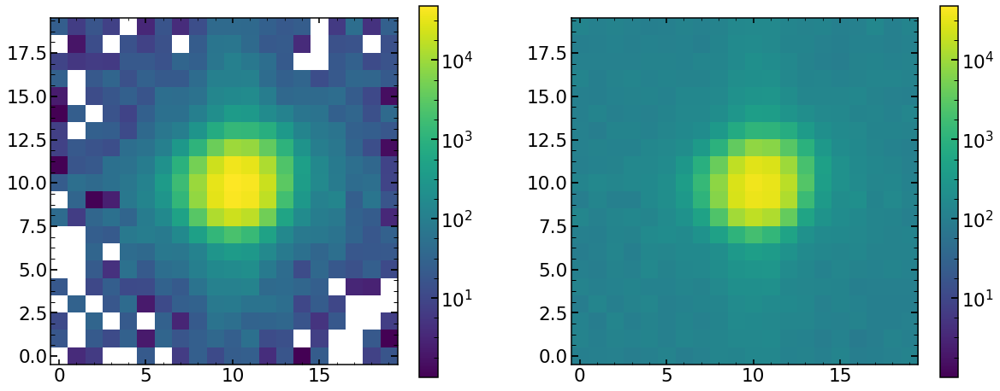

In [25]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [26]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 1144.5923657748383
minimal chi2 reduced is: 5.685731045069547


In [27]:
minchain_focus_96=minchain

In [28]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
         z4      z5        z6        z7        z8        z9       z10      z11
0 -0.743548 -0.4243 -0.638139  0.402655 -0.136753 -0.057005 -0.203691 -0.43849
        z12       z13       z14       z15      z16       z17       z18  \
0 -0.002131  0.021901  0.034244  0.004952 -0.01219  0.013825  0.013507   

        z19       z20       z21  
0 -0.008399 -0.021689  0.012859  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0 -0.019919  0.683909   0.079994  0.029972 -0.065559  0.060531     0.001856   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000005             0.000005  0.972504    ...      0.086397   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.999612  1.020971           -0.130958   55867.044404   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.390281              0.002474      0.385581  1.780001  0.997351  

[1 rows x

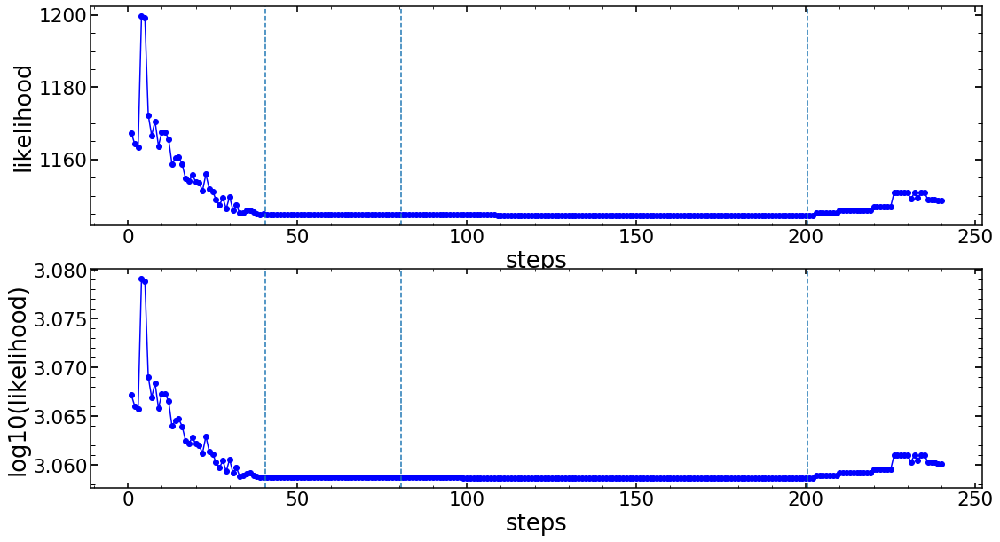

In [29]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [30]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-1144.5923657748501

In [31]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

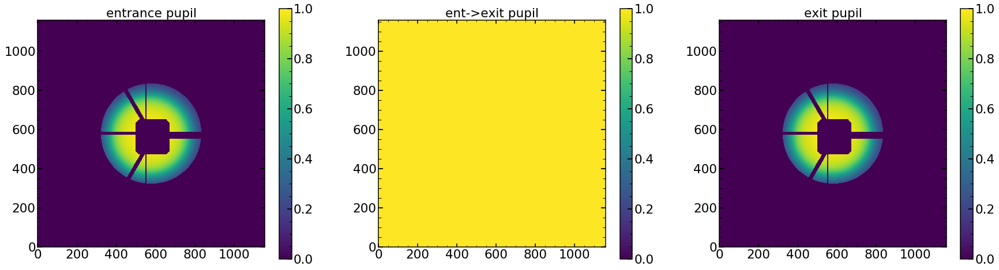

In [32]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

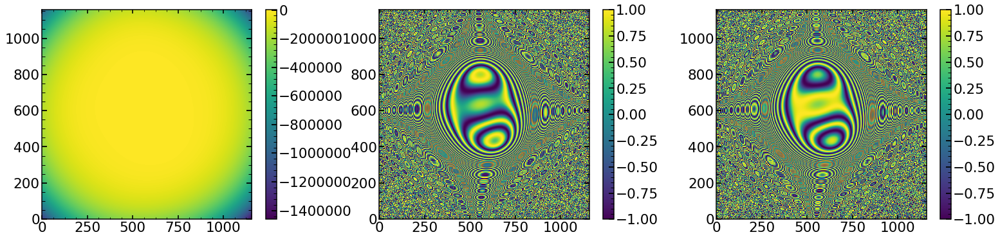

In [33]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

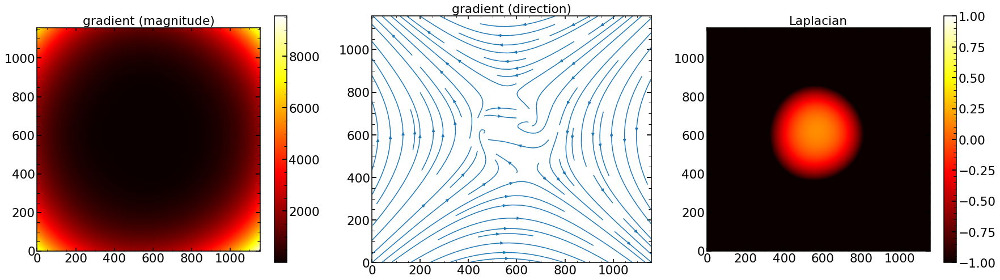

In [34]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

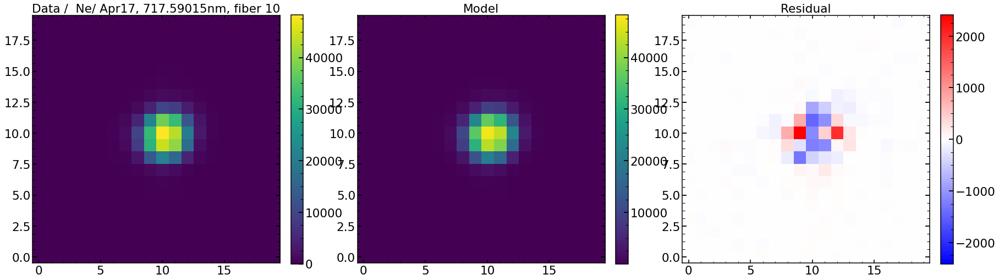

In [35]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data /  '+str(arc)+'/ '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 5.685730955842531
Abs of residual divided by total flux is: 0.04675740492860818
Abs of residual divided by largest value of a flux in the image is: 0.07446430106907806


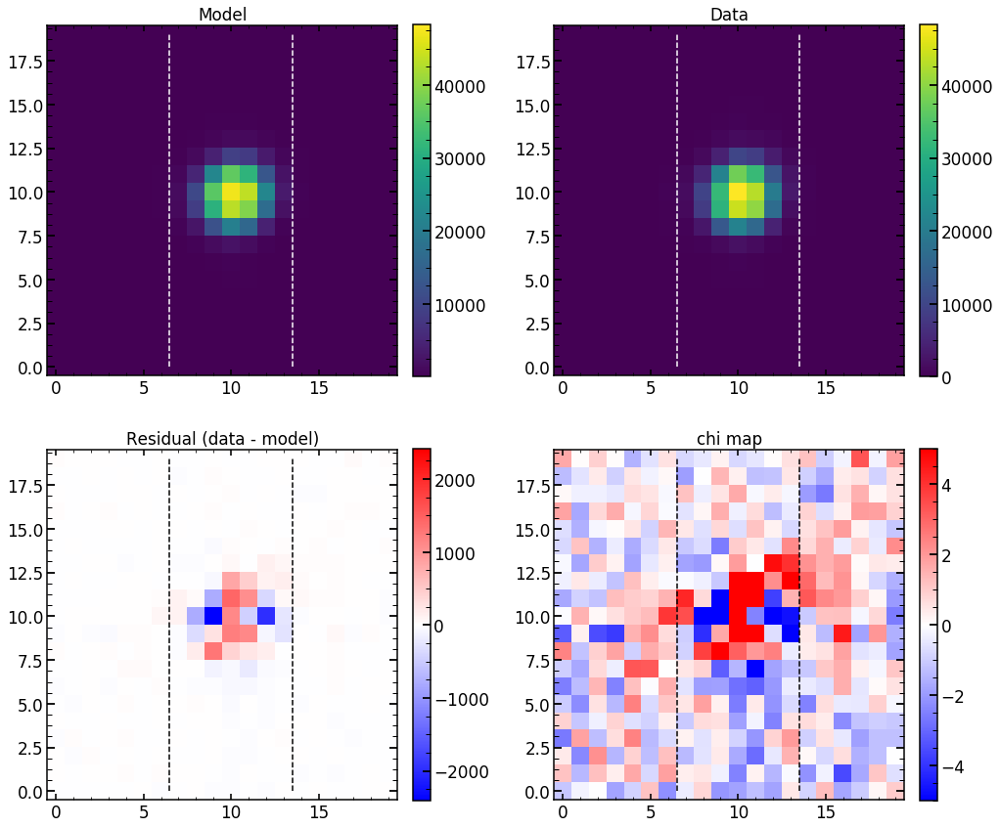

In [36]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

5.685730955842531
chi**2 reduced is: 5.685730955842531
Abs of residual divided by total flux is: 0.04675740492860818
Abs of residual divided by largest value of a flux in the image is: 0.07446430106907806


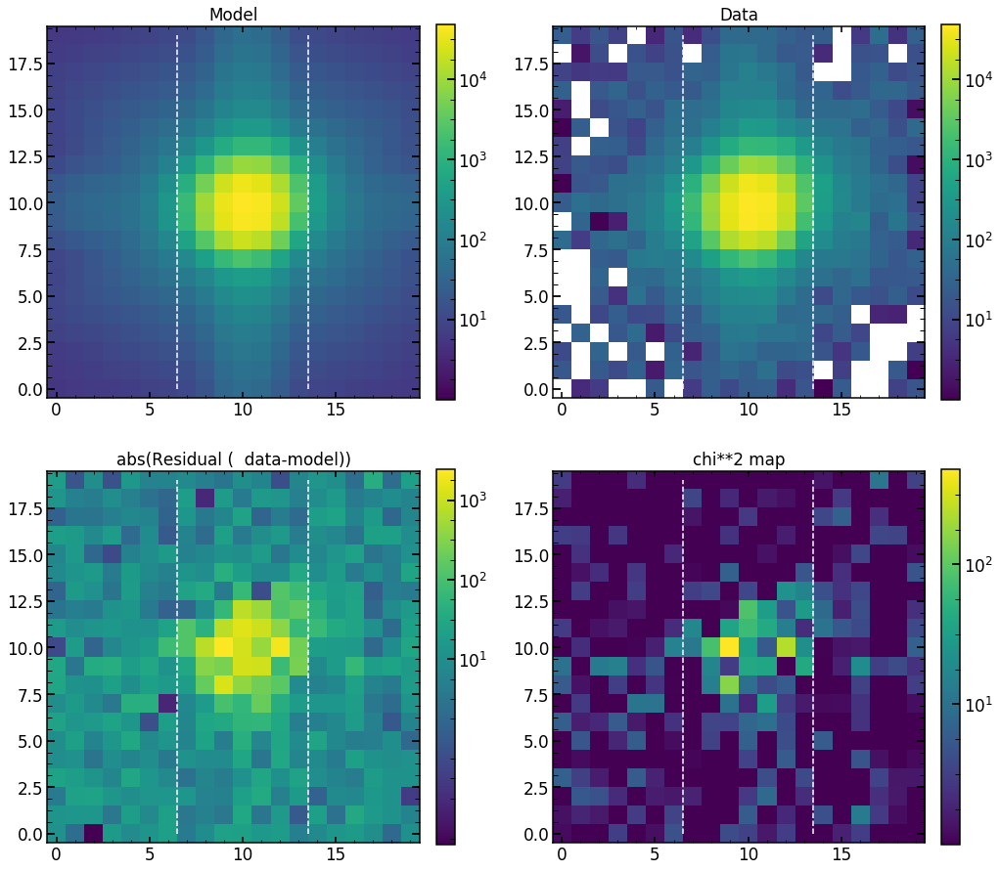

In [37]:
single_analysis.create_basic_comparison_plot_log()

5.685730955842531
chi**2 reduced is: 5.685730955842531
Abs of residual divided by total flux is: 0.04675740492860818
Abs of residual divided by largest value of a flux in the image is: 0.07446430106907806


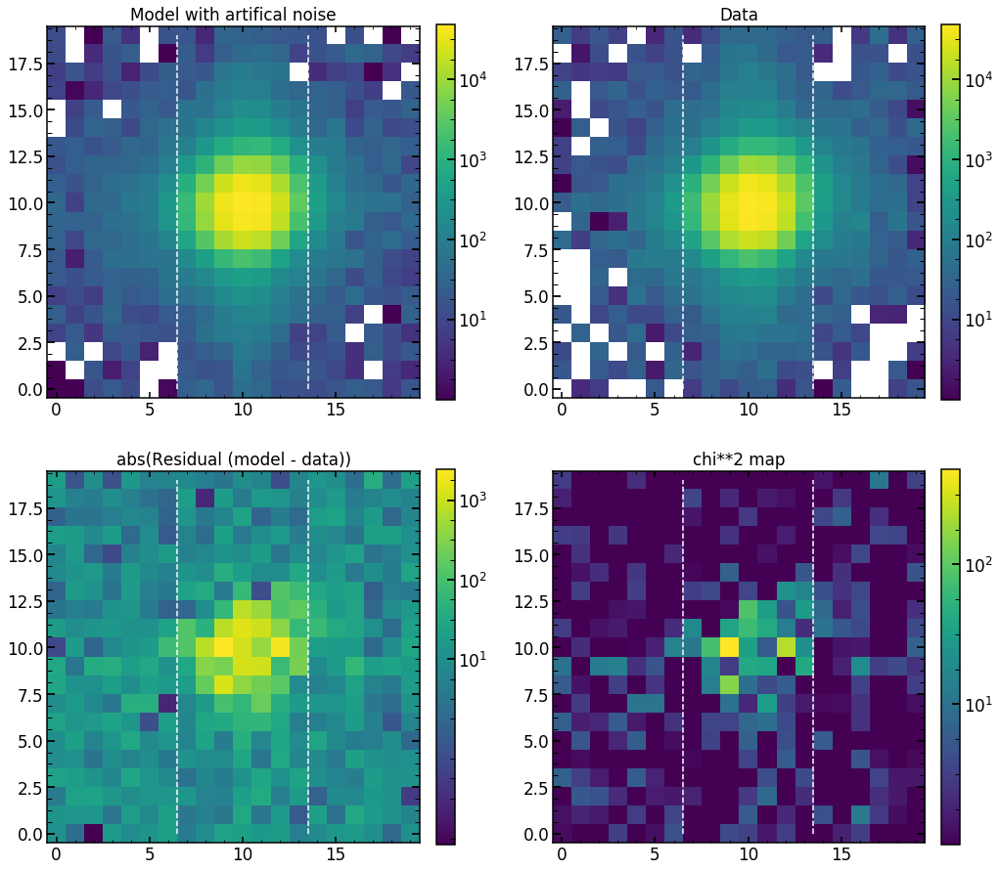

In [38]:
single_analysis.create_basic_comparison_plot_log_artifical()

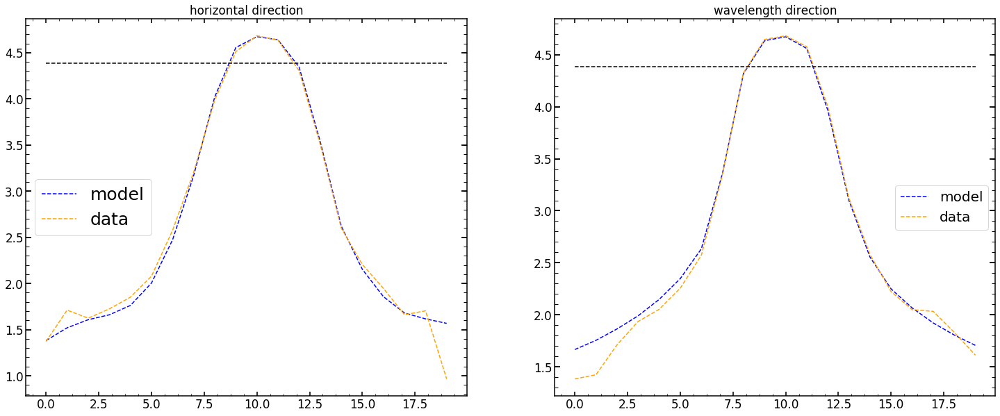

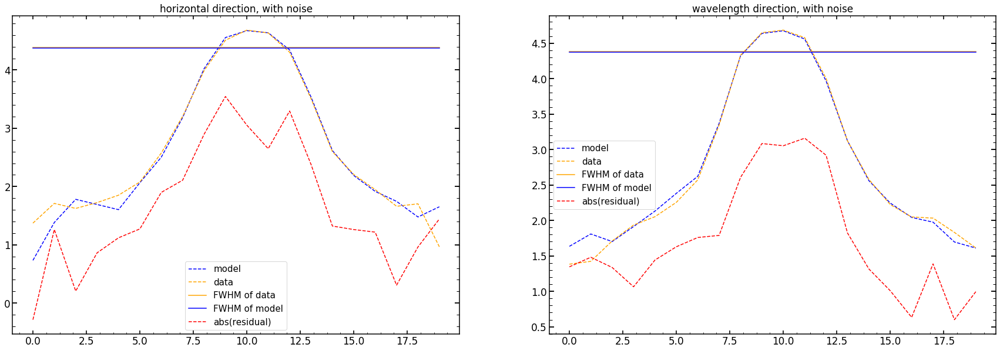

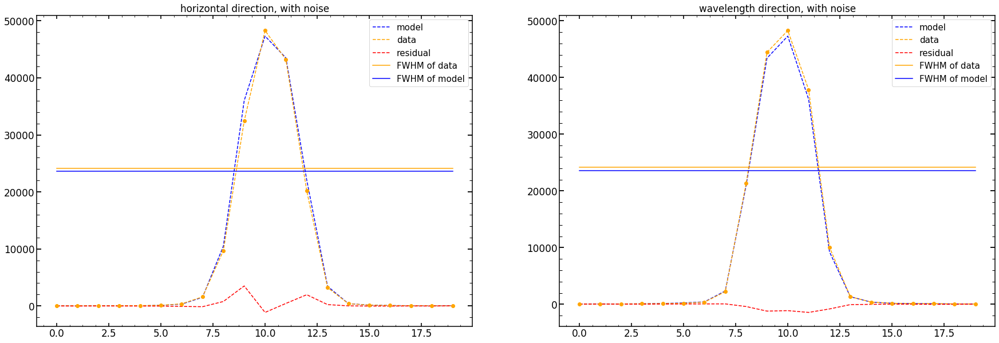

In [39]:
single_analysis.create_cut_plots()

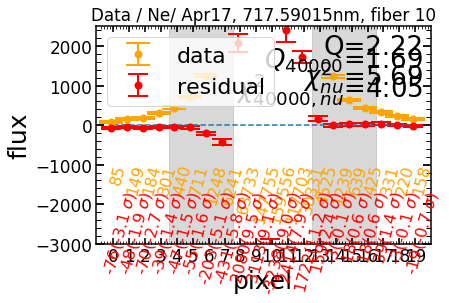

In [40]:
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
plt.title('Data / '+str(arc)+'/ '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.legend(loc=2, fontsize=22)
plt.plot(np.zeros(20),'--')
plt.ylim(-3000,2500)
plt.ylabel('flux',size=25)
plt.xlabel('pixel',size=25)
plt.xticks(range(20))




for i in range(20):
    plt.text(-0.3+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=16,rotation=75.,color='orange')
    
for i in range(20):
    plt.text(-0.8+i, -1950, str("{:1.0f}".format(init_removal_lamda[i]))+str("({:1.1f} $\sigma$)".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=16,rotation=75.,color='red')

sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
init_lamda_40000,std_init_lamda_40000,init_removal_lamda_40000,std_init_removal_lamda_40000=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
difference_from_max=range(20)-position_of_max_flux
pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
Q_40000=np.mean(np.abs(init_removal_lamda_40000[pixels_to_test]/std_init_removal_lamda_40000[pixels_to_test]))




plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

plt.text(19.5,2000, '$Q_{40000}$='+str("{:1.2f}".format(Q_40000)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2=np.mean((res_iapetus-sci_image)**2/var_image)

plt.text(19.5,1700, '$\chi^{2}_{nu}$='+str("{:1.2f}".format(chi2)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

plt.text(19.5,1400, '$\chi^{2}_{40000,nu}$='+str("{:1.2f}".format(chi2_40000)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

plt.axvspan(pixels_to_test[0]-0.5, pixels_to_test[3]+0.5, alpha=0.3, color='grey')
plt.axvspan(pixels_to_test[4]-0.5, pixels_to_test[7]+0.5, alpha=0.3, color='grey')

## Creating  results everywhere

In [148]:
assert date=='Apr17'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)


results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_Feb2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

In [149]:
columns_analysis=columns22_analysis

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus(date,single_number,'HgAr',22)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]


for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus(date,single_number,'Ne',22)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]


22
0 11748 HgAr is NOT found or failed!
22
1 obs (Emcee3): 11748 is found!
z7: failed!
z13: failed!
z14: failed!
z16: failed!
z18: failed!
z21: failed!
z22: failed!
dxFocal: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z7: failed!
z13: failed!
z14: failed!
z16: failed!
z18: failed!
z21: failed!
z22: failed!
dxFocal: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
2 11748 HgAr is NOT found or failed!
22
3 11748 HgAr is NOT found or failed!
22
4 11748 HgAr is NOT found or failed!
22
5 11748 HgAr is NOT found or failed!
22
6 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5

frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
50 11748 HgAr is NOT found or failed!
22
51 11748 HgAr is NOT found or failed!
22
52 11748 HgAr is NOT found or failed!
22
53 11748 HgAr is NOT found or failed!
22
54 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z18: failed!
z20: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z18: failed!
z20: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lo

z8: failed!
z20: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
84 11748 HgAr is NOT found or failed!
22
85 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z13: failed!
z15: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
z13: failed!
z15: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_i

118 11748 HgAr is NOT found or failed!
22
119 obs (Emcee3): 11748 is found!
z5: failed!
z9: failed!
z17: failed!
z21: failed!
z22: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
z5: failed!
z9: failed!
z17: failed!
z21: failed!
z22: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
22
120 11748 HgAr is NOT found or failed!
22
121 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: 

det_vert: failed!
z8: failed!
z16: failed!
hscFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
det_vert: failed!
22
156 11748 HgAr is NOT found or failed!
22
157 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
z17: failed!
z20: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
z17: failed!
z20: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
22
158 11748 HgAr is NOT found or failed!
22
159 11748 HgAr is NOT found or failed!
22
160 11748 HgAr is NOT found or failed!
22
161 11748 H

22
190 11748 HgAr is NOT found or failed!
22
191 obs (Emcee3): 11748 is found!
z6: failed!
z9: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z9: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
0 12355 Ne is NOT found or failed!
22
1 12355 Ne is NOT found or failed!
22
2 obs (Emcee3): 12355 is found!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z14: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: fa

z14: failed!
z16: failed!
z17: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z14: failed!
z16: failed!
z17: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
48 12355 Ne is NOT found or failed!
22
49 12355 Ne is NOT found or failed!
22
50 12355 Ne is NOT found or failed!
22
51 12355 Ne is NOT found or failed!
22
52 12355 Ne is NO

z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
78 obs (Emcee3): 12355 is found!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z20: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z20: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
79 12355 Ne is NOT found or failed!
22
80 12355 Ne is NOT found or 

dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
120 12355 Ne is NOT found or failed!
22
121 12355 Ne is NOT found or failed!
22
122 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed

In [152]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.837722,0.210583,0.029659,0.598350,0.938815,0.141872,-0.369594,-0.080115,-0.096279,-0.034670,...,1.001908,0.572612,39811.813244,2.411616,0.002032,0.366949,1.794571,0.996136,8.707171,1450.387695
6,2.590762,-0.058816,0.416683,0.265167,0.762449,-0.019087,-0.164394,-0.156112,-0.120996,-0.005488,...,0.990302,0.572582,33359.458326,1.957757,0.000537,0.366246,1.846433,0.998507,3.636542,1304.506836
9,2.530300,-0.927064,-0.016850,-0.178827,0.734189,-0.228735,-0.242973,0.129693,-0.074817,0.130535,...,1.026507,0.575717,36481.522649,2.371290,0.002278,0.350000,1.780043,0.995787,36.022140,7273.361328
11,2.583402,-1.016334,-0.193287,-0.355472,0.949905,-0.355079,-0.436934,0.430943,0.061026,0.163258,...,1.062441,0.578238,15099.260496,2.029142,0.001448,0.350000,1.780513,0.992265,3.685531,403.180481
13,2.467745,0.482470,-0.105507,0.593369,0.733248,0.046868,-0.401464,-0.136499,-0.087176,-0.094651,...,1.009698,0.506429,51672.172002,2.273638,0.001462,0.350000,1.780092,0.999455,2.686011,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.298609,-0.039787,-0.806457,-0.190870,-0.336692,-0.266663,-0.132694,0.357129,-0.056764,-0.135802,...,1.046728,-0.506694,17687.441618,1.500000,0.000196,0.787500,1.979984,0.987699,3.110284,262.233856
181,-2.365892,-0.614872,-0.443873,0.364119,-0.589778,0.101315,-0.175457,-0.095912,-0.115118,0.122164,...,0.978547,-0.568237,70634.741619,2.072227,0.001357,0.350000,1.825202,0.997779,2.395613,757.888306
186,-2.686242,-0.270580,-0.426711,0.028260,-0.486076,-0.062977,-0.411064,-0.145552,-0.131006,-0.054009,...,0.966489,-0.566042,26211.234414,1.579087,0.000166,0.413120,1.787836,0.996573,3.509322,612.405029
189,-2.859234,0.043558,-0.592895,-0.213498,-0.608584,-0.302980,-0.354333,0.114529,-0.104683,-0.184479,...,1.002161,-0.566321,56338.191955,1.904913,0.000674,0.604393,1.979969,0.990493,28.114205,2839.623047


In [159]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,3.329359,0.650509,-0.194477,0.753116,1.027983,0.217757,-0.497059,0.077074,-0.066870,-0.115857,...,1.014399,0.578274,44352.886905,2.483977,0.002640,0.383921,1.780202,0.998713,8.400301,5756.716797
5,2.946672,0.935106,0.141472,0.487174,0.833081,0.224315,-0.203279,-0.104946,-0.025035,-0.237502,...,1.001977,0.577318,29832.274391,2.543848,0.002631,0.389253,1.786802,0.985814,140.530387,9594.016602
6,2.980199,0.500321,0.140456,0.496717,0.893471,0.124273,-0.273189,-0.102581,-0.123653,-0.077965,...,0.995495,0.576680,33350.118831,2.244883,0.001137,0.372307,1.784247,0.998062,4.871732,1909.174683
11,2.808898,0.609779,-0.294171,0.754923,0.777303,0.096832,-0.524434,0.003226,-0.058036,-0.112067,...,1.022427,0.511778,50058.980268,2.386193,0.002299,0.350000,1.793521,0.999064,6.072898,5175.567383
38,1.329041,0.459126,-0.665688,0.793025,0.343424,-0.054431,-0.364124,-0.219126,0.044317,-0.095085,...,1.041786,0.273076,54665.285537,2.322156,0.002024,0.354692,1.780215,0.998238,14.920305,6587.444824
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114,-1.274682,-0.571277,-0.598403,0.406892,-0.219765,-0.050872,-0.251135,-0.407795,-0.051134,0.071837,...,1.012457,-0.252667,53254.966251,2.195577,0.001566,0.366633,1.780080,0.998514,3.082002,1530.557373
119,-1.543411,-0.689509,-0.714923,0.667425,-0.505850,-0.001422,-0.110989,-0.214180,-0.027814,0.147770,...,1.015779,-0.410441,59529.691492,2.184808,0.001464,0.355951,1.797375,0.999394,3.657536,3813.632080
122,-1.722309,-0.694608,-0.549169,0.498338,-0.437431,0.000929,-0.189372,-0.308275,-0.055349,0.120594,...,1.002808,-0.409821,59976.308070,2.300856,0.001906,0.355143,1.794439,0.999172,7.469636,6343.467285
123,-1.791242,-0.671922,-0.423272,0.422261,-0.396430,-0.031847,-0.230244,-0.322425,-0.083884,0.104318,...,0.995881,-0.409511,49771.514119,2.217418,0.001547,0.356224,1.780118,0.999583,1.816798,1238.217407


In [160]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr17_Focus/' + 'results_of_fit_many_direct_HgAr_from_Apr17.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr17_Focus/' + 'results_of_fit_many_direct_Ne_from_Apr17.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

## verification

In [156]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr17'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns


# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/0p/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z9/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z13/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Apr17/Plane/z14/
Images are in folder: /Users/nevencaplar/Documents/PFS/Imag

<Figure size 864x720 with 0 Axes>

## Quality control

In [161]:
assert date=='Apr17'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Apr17_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Apr17.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Apr17.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

### just plotting 1D

In [164]:

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr17_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)    

    
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
    plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
    plt.legend(loc=2, fontsize=22)
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))




    for i in range(20):
        plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')

    for i in range(20):
        plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

    plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2=np.mean((res_iapetus-sci_image)**2/var_image)

    plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

    plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/Apr17/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()
    
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Apr17_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)


    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
    plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
    plt.legend(loc=2, fontsize=22)
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))




    for i in range(20):
        plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')

    for i in range(20):
        plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

    plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2=np.mean((res_iapetus-sci_image)**2/var_image)

    plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)

    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

    plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
            horizontalalignment='right',
            verticalalignment='top',fontsize=26)
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/Apr17/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()    

extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZer

<Figure size 864x720 with 0 Axes>

### calculating and global plot

In [208]:
res_HgAr=[]
res_HgAr_chi=[]

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
        
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda_40000,std_init_lamda_40000,init_removal_lamda_40000,std_init_removal_lamda_40000=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    Q_40000=np.mean(np.abs(init_removal_lamda_40000[pixels_to_test]/std_init_removal_lamda_40000[pixels_to_test]))
    
    res_HgAr.append(Q_40000)
    
    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)
    res_HgAr_chi.append(chi2_40000)
  
res_Ne=[]
res_Ne_chi=[]
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda_40000,std_init_lamda_40000,init_removal_lamda_40000,std_init_removal_lamda_40000=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    Q_40000=np.mean(np.abs(init_removal_lamda_40000[pixels_to_test]/std_init_removal_lamda_40000[pixels_to_test]))
    
    res_Ne.append(Q_40000)
    
    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)
    
    res_Ne_chi.append(chi2_40000)

extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZer

In [209]:
np.min(res_HgAr)

1.4295724870920883

In [175]:
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr17'
zMax=22
descriptions='Q'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii

    max_colors=10
    min_colors=1         



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'Q_40000'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'Q_40000'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'Q_40000'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

In [171]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Apr17'
zMax=22
descriptions='$\chi^{2}$'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr_chi

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne_chi

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii

    max_colors=10
    min_colors=1           



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=20,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'res_chi'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'chi_res'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'chi_res'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

## comparison between quality for HgAr and Neon

In [220]:
selection_HgAr_index=finalHgAr_Feb2019[((finalHgAr_Feb2019['fiber'].values.astype(int))>2)&((finalHgAr_Feb2019['fiber'].values.astype(int))<14)
                                       &((finalHgAr_Feb2019['wavelength'].values.astype(float))<950)&((finalHgAr_Feb2019['close'].values.astype(int))==1)].index.values

selection_Ne_index=finalNe_Feb2019[((finalNe_Feb2019['fiber'].values.astype(int))>2)&((finalNe_Feb2019['fiber'].values.astype(int))<14)
                                       &((finalNe_Feb2019['wavelength'].values.astype(float))<800)&((finalNe_Feb2019['close'].values.astype(int))==1)].index.values

In [221]:
selection_HgAr_index_intersect=np.intersect1d(results_of_fit_many_single_focus_HgAr_pd.index.values,selection_HgAr_index)
selection_Ne_index_intersect=np.intersect1d(results_of_fit_many_single_focus_Ne_pd.index.values,selection_Ne_index)

print(len(selection_HgAr_index_intersect))
print(len(selection_Ne_index_intersect))

29
23


In [222]:
res_HgAr=[]
res_HgAr_chi=[]

for image_index in selection_HgAr_index_intersect:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
        
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda_40000,std_init_lamda_40000,init_removal_lamda_40000,std_init_removal_lamda_40000=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    Q_40000=np.mean(np.abs(init_removal_lamda_40000[pixels_to_test]/std_init_removal_lamda_40000[pixels_to_test]))
    
    res_HgAr.append(Q_40000)
    
    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)
    res_HgAr_chi.append(chi2_40000)
  
res_Ne=[]
res_Ne_chi=[]
    
for image_index in selection_Ne_index_intersect:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda_40000,std_init_lamda_40000,init_removal_lamda_40000,std_init_removal_lamda_40000=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    Q_40000=np.mean(np.abs(init_removal_lamda_40000[pixels_to_test]/std_init_removal_lamda_40000[pixels_to_test]))
    
    res_Ne.append(Q_40000)
    
    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)
    
    res_Ne_chi.append(chi2_40000)

extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZer

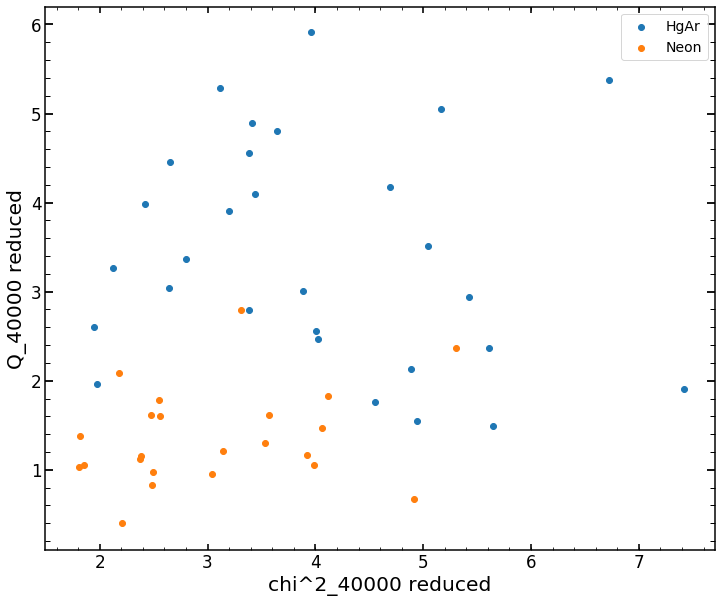

In [223]:
plt.scatter(res_HgAr_chi,res_HgAr,label='HgAr')
plt.scatter(res_Ne_chi,res_Ne,label='Neon')
plt.xlabel('chi^2_40000 reduced')
plt.ylabel('Q_40000 reduced')
plt.legend()

# Adding very high Zernike

## Can I predict just the wavefront map

### create wavefront images

In [13]:
list_of_wf_full=[]
list_of_wf=[]
list_of_u_manual=[]
list_of_wf_grid=[]
list_of_expwf_grid=[]

list_of_minchain=[]

for obs in [12403,12397,12391,12319,12313,12307]:
    print(obs)
    with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
        finalHgAr_Feb2019=pickle.load(f)

    with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
        finalNe_Feb2019=pickle.load(f)


    date='Apr16'
    single_number='69'
    image_index=int(single_number)
    eps=5
    arc='Ne'


    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")

    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])

    label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
    labelInput=label[list(obs_possibilites).index(int(obs))]
    print(labelInput)
    if obs==8600:
        print("Not implemented for December 2018 data")
    else:
        sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
        var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
        #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
        #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    

    finalArc.loc[int(single_number)]

    single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
    chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

    minchain,like_min=single_analysis.create_likelihood()
    list_of_minchain.append(minchain)
    if obs=='8600':
        model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
    else:
        model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

    model(minchain)


    wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
    wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
    u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
    wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
    expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')    
    
    
    list_of_wf_full.append(wf_full)
    list_of_wf.append(wf)
    list_of_u_manual.append(u_manual)
    list_of_wf_grid.append(wf_grid)
    list_of_expwf_grid.append(expwf_grid)


12403
m4
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 109273.35944688275
minimal chi2 reduced is: 60.70211722651773
None
zmax: 22
diam_sic: 0.1395327
aberrations: [0.0, 0, 0.0, 0.0, 29.686971854482366, 0.05519361426011613, -1.1870492637618866, 0.5955873356767095, 0.20766520963180923, -0.04107686485699538, -0.40601122321578137, -0.3183794560978207, -0.03452826237859527, 0.10607307418721254, -0.002737660349231384, 0.04665575485833874, 0.05073056651788388, 0.08869098151101099, -0.011535784482255621, -0.00024622966645351313, -0.05495544338180695, 0.045948227795002496, 0.03418093085021536]
aberrations extra: None
self.wavelength: 794
12397
m35
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 65849.94091948778
minimal chi2 reduced is: 52.67243781333333
None
zmax: 22
diam_sic: 0.1395327
aberrations: [0.0, 0, 0.0, 0.0, 25.973885766414128, 0.06991467797160157, -1.1260143385086572, 0.5989277392066

In [552]:
list_of_minchain[-2]

array([   -26.01862402,     -0.10001975,     -0.21083343,      0.38095728,
            0.02476478,     -0.07085732,     -0.20478432,     -0.53516736,
            0.0131455 ,     -0.04047305,      0.05171454,     -0.01329873,
            0.02951348,     -0.0108068 ,     -0.01663108,     -0.02098131,
            0.02344343,      0.01295711,     -0.03596844,      0.68506272,
            0.08014577,     -0.01484248,     -0.06009324,      0.06072552,
            0.01065119,      0.00000778,      0.00000778,      0.97303753,
            0.94833663,     -0.04332539,     -0.07515384,      0.80155356,
            0.05408019,      0.9998427 ,      1.02643912,      0.03309602,
       119915.796026  ,      2.45731164,      0.00400156,      0.3885899 ,
            1.81225669,      0.99503363])

In [378]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
v_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v_manual.npy')
u=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u.npy')
v=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v.npy')

wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

In [ ]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(pupililluminated,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

In [ ]:
ilum_1=np.copy(ilum_radiometric)
ilum_1[ilum_radiometric>0.001]=1

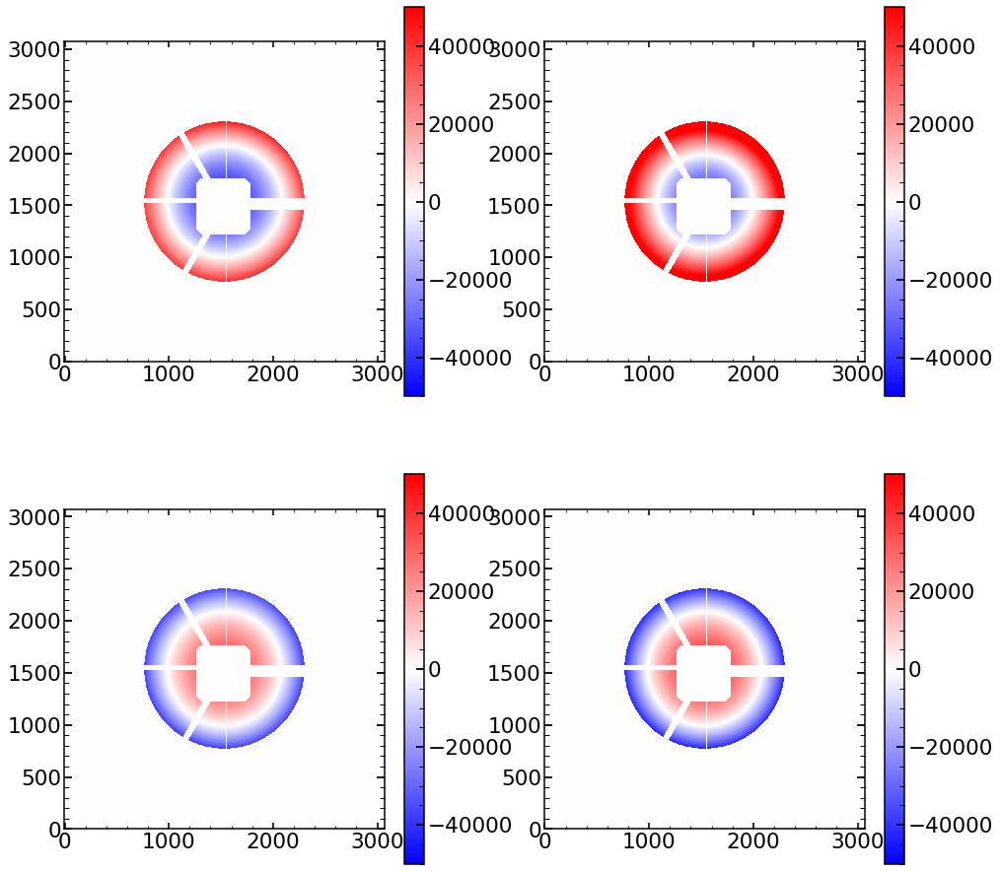

In [324]:
plt.figure(figsize=(16,16))
plt.subplot(2,2,1)
plt.imshow(ilum_1*list_of_wf_full[0],vmax=50000,vmin=-50000,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(ilum_1*list_of_wf_full[1],vmax=50000,vmin=-50000,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(ilum_1*list_of_wf_full[4],vmax=50000,vmin=-50000,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(ilum_1*list_of_wf_full[5],vmax=50000,vmin=-50000,cmap='bwr')
plt.colorbar()


In [ ]:
def lin_fit_1D(x, a, b):
    return a * x + b

In [ ]:
wf_full_focus=np.zeros((3072,3072))
'''
for x in tqdm(range(3072)):
    for y in range(3072):
        single_element_with_defocus = [ list_of_wf_full[i][x,y] for i in [0,1,4,5]]
        z=np.polyfit([-4,-3.5,3.5,4],single_element_with_defocus,1)
        p1 = np.poly1d(z)
        wf_full_focus[x,y]=p1(0)
'''

for x in tqdm(range(3072)):
    for y in range(3072):
        single_element_with_defocus = [ list_of_wf_full[i][x,y] for i in [0,1,4,5]]
        wf_full_focus[x,y]=np.mean(single_element_with_defocus)

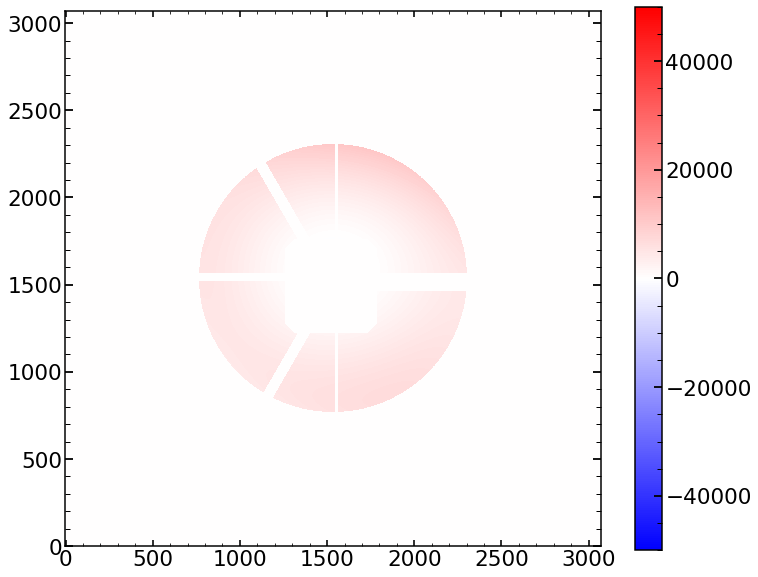

In [346]:
plt.imshow(ilum_1*wf_full_focus,vmax=50000,vmin=-50000,cmap='bwr')
plt.colorbar()

In [342]:
aberrations_m4=[0.0, 0, 0.0, 0.0, 29.686971854482366, 0.05519361426011613, -1.1870492637618866, 0.5955873356767095, 0.20766520963180923, -0.04107686485699538, -0.40601122321578137, -0.3183794560978207, -0.03452826237859527, 0.10607307418721254, -0.002737660349231384, 0.04665575485833874, 0.05073056651788388, 0.08869098151101099, -0.011535784482255621, -0.00024622966645351313, -0.05495544338180695, 0.045948227795002496, 0.03418093085021536]
aberrations_m35= [0.0, 0, 0.0, 0.0, 25.973885766414128, 0.06991467797160157, -1.1260143385086572, 0.5989277392066514, 0.1923711422430178, -0.04084678208072481, -0.3967759347458504, -0.32511820057997465, -0.032964961719911735, 0.0948976933409299, -0.0017091845891507695, 0.05030815511803123, 0.05397042157290466, 0.07477867499371052, -0.017227569928410312, -0.001806000179397136, -0.05189408379832877, 0.04358025261230388, 0.01842689523742374]
aberrations_p35=[0.0, 0, 0.0, 0.0, -26.018624022679273, -0.1000197494823756, -0.21083343495083137, 0.38095728335556484, 0.024764784337792483, -0.07085732204897964, -0.2047843152698759, -0.5351673558206506, 0.013145495238612864, -0.040473051990061716, 0.05171453874538225, -0.013298725917732106, 0.029513481075643295, -0.010806797844746576, -0.016631075423349618, -0.020981308156361702, 0.023443431404857384, 0.012957113694343266, -0.035968435375808475]
aberrations_p4=[0.0, 0, 0.0, 0.0, -29.67933851587274, -0.08466306016990055, -0.16493224405922116, 0.38942196459585243, 0.0102983163648662, -0.07510596096236725, -0.1895012200152342, -0.5451512722666977, 0.005747933196153525, -0.0498869404797962, 0.051296962566744285, -0.012713773122672531, 0.030536792873240615, -0.005801676138828573, -0.017109419683274146, -0.017100887622331917, 0.029285217480748946, 0.017839320998713156, -0.03311391321033471]

aberrations_0_m4=[0.0, 0, 0.0, 0.0, 0, 0.05519361426011613, -1.1870492637618866, 0.5955873356767095, 0.20766520963180923, -0.04107686485699538, -0.40601122321578137, -0.3183794560978207, -0.03452826237859527, 0.10607307418721254, -0.002737660349231384, 0.04665575485833874, 0.05073056651788388, 0.08869098151101099, -0.011535784482255621, -0.00024622966645351313, -0.05495544338180695, 0.045948227795002496, 0.03418093085021536]
aberrations_0_m35= [0.0, 0, 0.0, 0.0, 0, 0.06991467797160157, -1.1260143385086572, 0.5989277392066514, 0.1923711422430178, -0.04084678208072481, -0.3967759347458504, -0.32511820057997465, -0.032964961719911735, 0.0948976933409299, -0.0017091845891507695, 0.05030815511803123, 0.05397042157290466, 0.07477867499371052, -0.017227569928410312, -0.001806000179397136, -0.05189408379832877, 0.04358025261230388, 0.01842689523742374]
aberrations_0_p35=[0.0, 0, 0.0, 0.0, 0, -0.1000197494823756, -0.21083343495083137, 0.38095728335556484, 0.024764784337792483, -0.07085732204897964, -0.2047843152698759, -0.5351673558206506, 0.013145495238612864, -0.040473051990061716, 0.05171453874538225, -0.013298725917732106, 0.029513481075643295, -0.010806797844746576, -0.016631075423349618, -0.020981308156361702, 0.023443431404857384, 0.012957113694343266, -0.035968435375808475]
aberrations_0_p4=[0.0, 0, 0.0, 0.0, 0, -0.08466306016990055, -0.16493224405922116, 0.38942196459585243, 0.0102983163648662, -0.07510596096236725, -0.1895012200152342, -0.5451512722666977, 0.005747933196153525, -0.0498869404797962, 0.051296962566744285, -0.012713773122672531, 0.030536792873240615, -0.005801676138828573, -0.017109419683274146, -0.017100887622331917, 0.029285217480748946, 0.017839320998713156, -0.03311391321033471]


aberrations_000_m4=[0.0, 0, 0.0, 0.0, 0, 0.05519361426011613, -1.1870492637618866, 0.5955873356767095, 0.20766520963180923, -0.04107686485699538, -0.40601122321578137,0, -0.03452826237859527, 0.10607307418721254, -0.002737660349231384, 0.04665575485833874, 0.05073056651788388, 0.08869098151101099, -0.011535784482255621, -0.00024622966645351313, -0.05495544338180695, 0.045948227795002496, 0]
aberrations_000_m35= [0.0, 0, 0.0, 0.0, 0, 0.06991467797160157, -1.1260143385086572, 0.5989277392066514, 0.1923711422430178, -0.04084678208072481, -0.3967759347458504,0, -0.032964961719911735, 0.0948976933409299, -0.0017091845891507695, 0.05030815511803123, 0.05397042157290466, 0.07477867499371052, -0.017227569928410312, -0.001806000179397136, -0.05189408379832877, 0.04358025261230388,0]
aberrations_000_p35=[0.0, 0, 0.0, 0.0, 0, -0.1000197494823756, -0.21083343495083137, 0.38095728335556484, 0.024764784337792483, -0.07085732204897964, -0.2047843152698759,0, 0.013145495238612864, -0.040473051990061716, 0.05171453874538225, -0.013298725917732106, 0.029513481075643295, -0.010806797844746576, -0.016631075423349618, -0.020981308156361702, 0.023443431404857384, 0.012957113694343266, 0]
aberrations_000_p4=[0.0, 0, 0.0, 0.0, 0, -0.08466306016990055, -0.16493224405922116, 0.38942196459585243, 0.0102983163648662, -0.07510596096236725, -0.1895012200152342,0, 0.005747933196153525, -0.0498869404797962, 0.051296962566744285, -0.012713773122672531, 0.030536792873240615, -0.005801676138828573, -0.017109419683274146, -0.017100887622331917, 0.029285217480748946, 0.017839320998713156, 0]


optics_screen_m4 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_m4,lam_0=794)
optics_screen_m35 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_m35,lam_0=794)
optics_screen_p35 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_p35,lam_0=794)
optics_screen_p4 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_p4,lam_0=794)

optics_screen_0_m4 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_0_m4,lam_0=794)
optics_screen_0_m35 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_0_m35,lam_0=794)
optics_screen_0_p35 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_0_p35,lam_0=794)
optics_screen_0_p4 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_0_p4,lam_0=794)

optics_screen_000_m4 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_000_m4,lam_0=794)
optics_screen_000_m35 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_000_m35,lam_0=794)
optics_screen_000_p35 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_000_p35,lam_0=794)
optics_screen_000_p4 = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_000_p4,lam_0=794)

In [343]:
screens_m4 = galsim.PhaseScreenList(optics_screen_m4) 
screens_m35 = galsim.PhaseScreenList(optics_screen_m35) 
screens_p35 = galsim.PhaseScreenList(optics_screen_p35) 
screens_p4 = galsim.PhaseScreenList(optics_screen_p4) 

screens_0_m4 = galsim.PhaseScreenList(optics_screen_0_m4) 
screens_0_m35 = galsim.PhaseScreenList(optics_screen_0_m35) 
screens_0_p35 = galsim.PhaseScreenList(optics_screen_0_p35) 
screens_0_p4 = galsim.PhaseScreenList(optics_screen_0_p4) 

screens_000_m4 = galsim.PhaseScreenList(optics_screen_000_m4) 
screens_000_m35 = galsim.PhaseScreenList(optics_screen_000_m35) 
screens_000_p35 = galsim.PhaseScreenList(optics_screen_000_p35) 
screens_000_p4 = galsim.PhaseScreenList(optics_screen_000_p4) 

In [337]:
u=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u.npy') 
v=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v.npy') 

u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy') 
v_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v_manual.npy') 

In [344]:
wf_0_m4_full = screens_0_m4.wavefront(u_manual, v_manual, None, 0)
wf_0_m35_full = screens_0_m35.wavefront(u_manual, v_manual, None, 0)
wf_0_p35_full = screens_0_p35.wavefront(u_manual, v_manual, None, 0)
wf_0_p4_full = screens_0_p4.wavefront(u_manual, v_manual, None, 0)

wf_000_m4_full = screens_000_m4.wavefront(u_manual, v_manual, None, 0)
wf_000_m35_full = screens_000_m35.wavefront(u_manual, v_manual, None, 0)
wf_000_p35_full = screens_000_p35.wavefront(u_manual, v_manual, None, 0)
wf_000_p4_full = screens_000_p4.wavefront(u_manual, v_manual, None, 0)

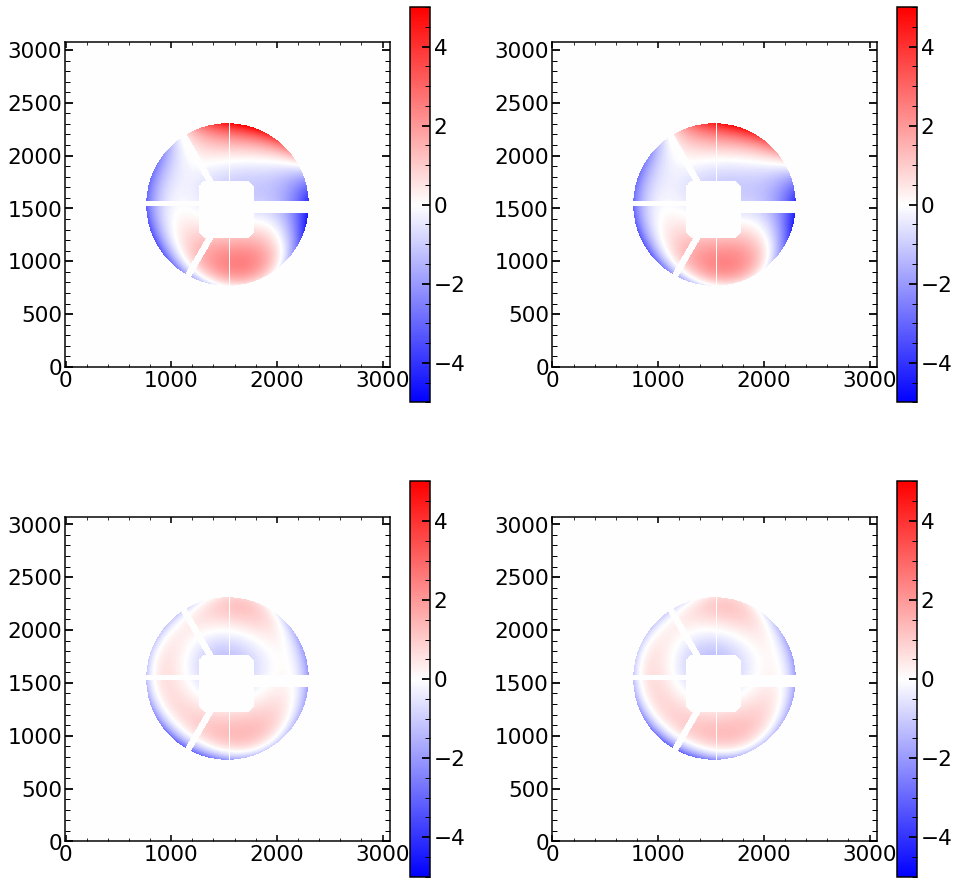

In [345]:
plt.figure(figsize=(16,16))
plt.subplot(2,2,1)
plt.imshow(ilum_1*wf_0_m4_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(ilum_1*wf_0_m35_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(ilum_1*wf_0_p35_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(ilum_1*wf_0_p4_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

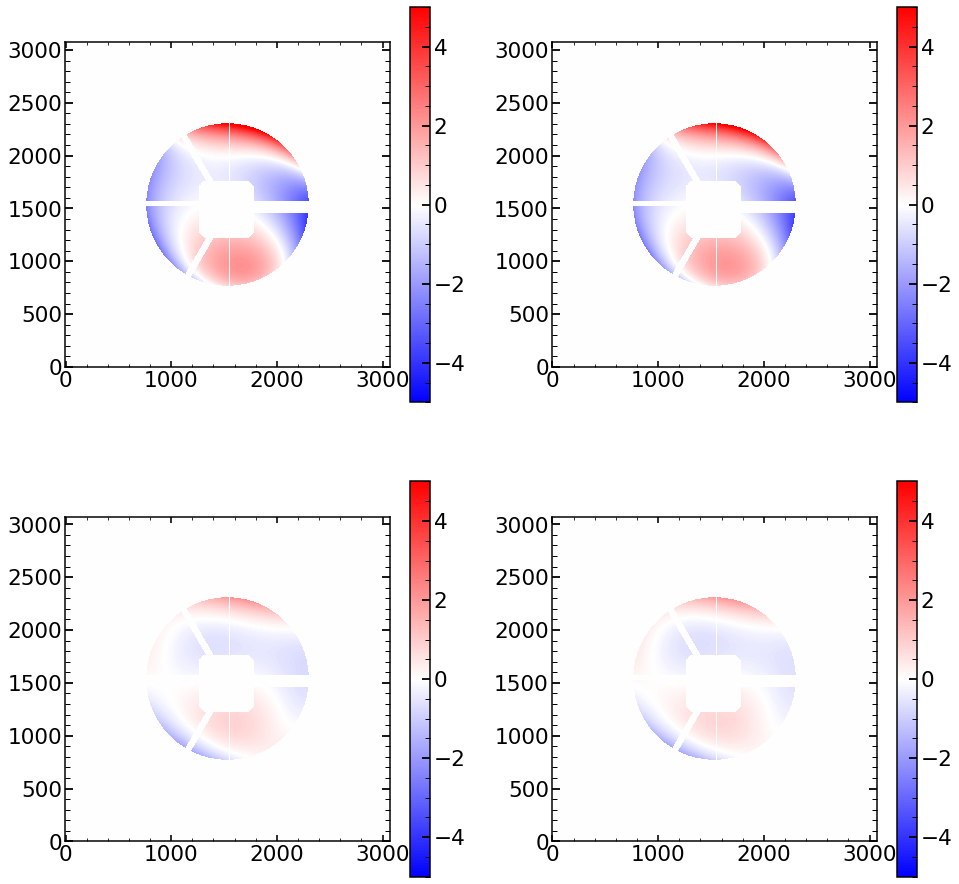

In [341]:
plt.figure(figsize=(16,16))
plt.subplot(2,2,1)
plt.imshow(ilum_1*wf_000_m4_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(ilum_1*wf_000_m35_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(ilum_1*wf_000_p35_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(ilum_1*wf_000_p4_full/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

In [348]:
wf_0_full_focus=np.zeros((3072,3072))
wf_000_full_focus=np.zeros((3072,3072))
'''
for x in tqdm(range(3072)):
    for y in range(3072):
        single_element_with_defocus = [ list_of_wf_full[i][x,y] for i in [0,1,4,5]]
        z=np.polyfit([-4,-3.5,3.5,4],single_element_with_defocus,1)
        p1 = np.poly1d(z)
        wf_full_focus[x,y]=p1(0)
'''

list_of_wf_0_full=[wf_0_m4_full,wf_0_m35_full,wf_0_p35_full,wf_0_p4_full]
list_of_wf_000_full=[wf_000_m4_full,wf_000_m35_full,wf_000_p35_full,wf_000_p4_full]


for x in tqdm(range(3072)):
    for y in range(3072):
        single_element_with_defocus = [ list_of_wf_0_full[i][x,y] for i in [0,1,2,3]]
        wf_0_full_focus[x,y]=np.mean(single_element_with_defocus)
        
for x in tqdm(range(3072)):
    for y in range(3072):
        single_element_with_defocus = [ list_of_wf_000_full[i][x,y] for i in [0,1,2,3]]
        wf_000_full_focus[x,y]=np.mean(single_element_with_defocus)


  5%|▌         | 156/3072 [00:05<01:50, 26.42it/s]
Exception in thread Thread-8:
Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/threading.py", line 916, in _bootstrap_inner
    self.run()
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/tqdm/_tqdm.py", line 144, in run
    for instance in self.tqdm_cls._instances:
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration

100%|██████████| 3072/3072 [01:42<00:00, 30.00it/s]


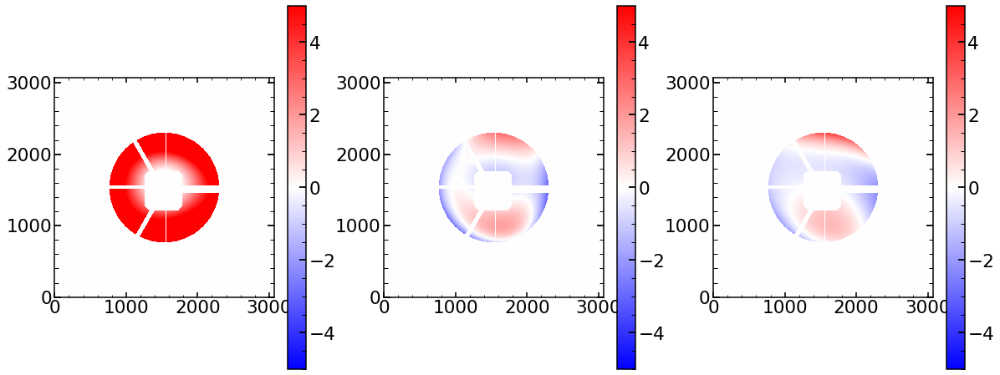

In [351]:
plt.figure(figsize=(20,8))
plt.subplot(1,3,1)
plt.imshow(ilum_1*wf_full_focus/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(1,3,2)
plt.imshow(ilum_1*wf_0_full_focus/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

plt.subplot(1,3,3)
plt.imshow(ilum_1*wf_000_full_focus/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()


In [363]:
wf_full_actual_focus=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

ilum_focus=np.copy(ilum_radiometric)
ilum_focus[ilum_focus>0.001]=1

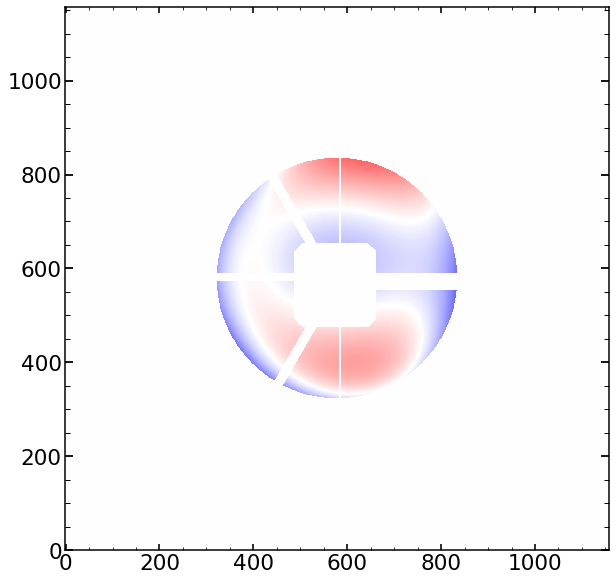

In [364]:
plt.imshow(ilum_focus*wf_full_actual_focus/794,vmax=5,vmin=-5,cmap='bwr')

In [443]:
aberrations_custom_list=np.zeros(23)
list_of_wf_full_single_component=[]
for i in tqdm(range(len(aberrations_custom_list))):
    aberrations_single_component=np.copy(aberrations_custom_list)
    aberrations_single_component[i]=1
    optics_screen_single_component = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_single_component,lam_0=794)
    screens_single_component = galsim.PhaseScreenList(optics_screen_single_component)
    wf_full_single_component = screens_single_component.wavefront(u_manual, v_manual, None, 0)
    list_of_wf_full_single_component.append(wf_full_single_component)


  0%|          | 0/23 [00:00<?, ?it/s]/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/galsim/errors.py:424: GalSimWarning: Detected non-zero value in aberrations[0] -- this value is ignored!
  warnings.warn(message, GalSimWarning)
100%|██████████| 23/23 [00:22<00:00,  1.01it/s]


In [487]:
list_of_wf_full_single_component_normalized_and_cut=[]
for i in range(len(list_of_wf_full_single_component)):
    list_of_wf_full_single_component_normalized_and_cut.append((list_of_wf_full_single_component[i][ilum_1>0]/794).flatten())
    
array_of_wf_full_single_component_normalized_and_cut=np.array(list_of_wf_full_single_component_normalized_and_cut)

In [456]:
wf_0_full_focus_normalized_and_cut=(wf_0_full_focus[ilum_1>0]/794).flatten()

In [534]:
def residuals(coeffs):
   
    res=(coeffs[0]*list_of_wf_full_single_component_normalized_and_cut[4])+\
        (coeffs[1]*list_of_wf_full_single_component_normalized_and_cut[5])+\
        (coeffs[2]*list_of_wf_full_single_component_normalized_and_cut[6])+\
        (coeffs[3]*list_of_wf_full_single_component_normalized_and_cut[7])+\
        (coeffs[4]*list_of_wf_full_single_component_normalized_and_cut[8])+\
        (coeffs[5]*list_of_wf_full_single_component_normalized_and_cut[9])+\
        (coeffs[6]*list_of_wf_full_single_component_normalized_and_cut[10])+\
        (coeffs[7]*list_of_wf_full_single_component_normalized_and_cut[11])+\
        (coeffs[8]*list_of_wf_full_single_component_normalized_and_cut[12])+\
        (coeffs[9]*list_of_wf_full_single_component_normalized_and_cut[13])+\
        (coeffs[10]*list_of_wf_full_single_component_normalized_and_cut[14])+\
        (coeffs[11]*list_of_wf_full_single_component_normalized_and_cut[15])+\
        (coeffs[12]*list_of_wf_full_single_component_normalized_and_cut[16])+\
        (coeffs[13]*list_of_wf_full_single_component_normalized_and_cut[17])+\
        (coeffs[14]*list_of_wf_full_single_component_normalized_and_cut[18])+\
        (coeffs[15]*list_of_wf_full_single_component_normalized_and_cut[19])+\
        (coeffs[16]*list_of_wf_full_single_component_normalized_and_cut[20])+\
        (coeffs[17]*list_of_wf_full_single_component_normalized_and_cut[21])+\
        (coeffs[18]*list_of_wf_full_single_component_normalized_and_cut[22])-\
        wf_0_full_focus_normalized_and_cut
        
    return res

In [545]:
def residuals(coeffs):
    res=np.sum(coeffs[:, None]*array_of_wf_full_single_component_normalized_and_cut[4:],axis=0)-wf_0_full_focus_normalized_and_cut
        
    return res

In [546]:
leastsq_res=scipy.optimize.leastsq(residuals,np.array([0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]))

In [547]:
leastsq_res

(array([ 0.        , -0.01489363, -0.67220732,  0.49122358,  0.10877486,
        -0.05697173, -0.29926817, -0.43095407, -0.01214995,  0.02765269,
         0.02464116,  0.01773785,  0.04118782,  0.0367153 , -0.01562596,
        -0.01003361, -0.01353022,  0.03008123, -0.00411863]), 2)

## Creating high Zernike for this defocused example

### 12403

In [234]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr16'
obs=12403
single_number='69'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m4


fiber                            7
xc                            1994
yc                            1077
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  1994
old_index_approx                42
superold_index_approx          nan
Name: 69, dtype: object

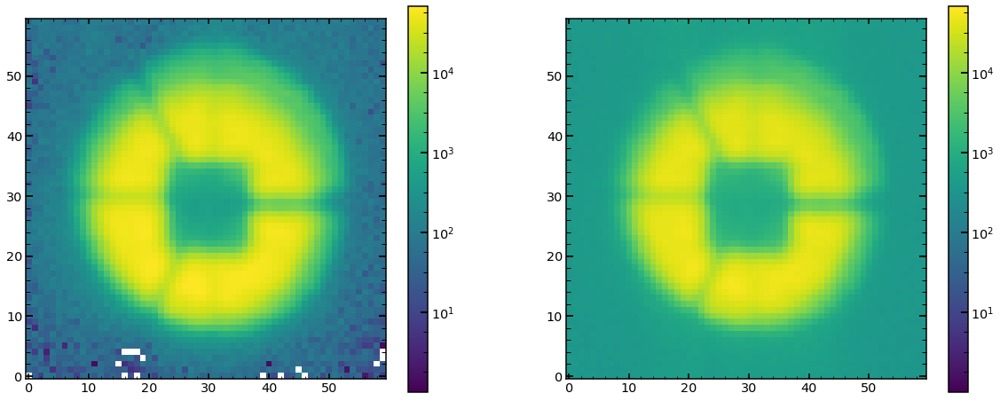

In [235]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [236]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 109273.35944688275
minimal chi2 reduced is: 60.70211722651773


In [237]:
initial_input_parameters_212403695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/initial_input_parameters_612403695Ne.npy')

In [238]:
initial_input_parameters_0_212403695Ne=np.copy(initial_input_parameters_212403695Ne)
initial_input_parameters_0_212403695Ne[0]=0

minchain_0=np.copy(minchain)
minchain_0[0]=0


In [239]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)
wf_full_12403_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(minchain_0)
wf_full_0_12403_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 


model(initial_input_parameters_0_212403695Ne)
wf_full_0_12403_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_212403695Ne)
wf_full_12403_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 


extraZernike: None
zmax: 22
42
42
274
274


In [240]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

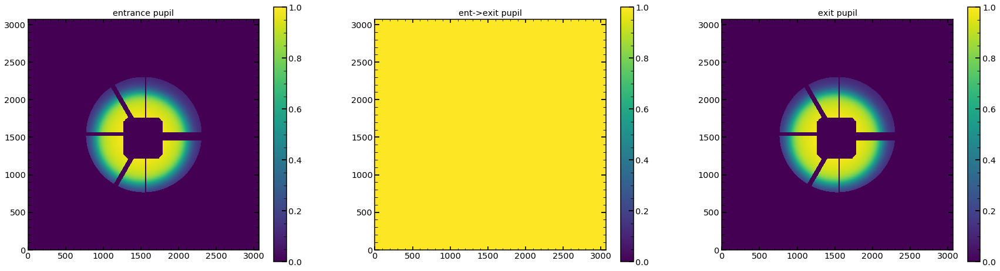

In [241]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

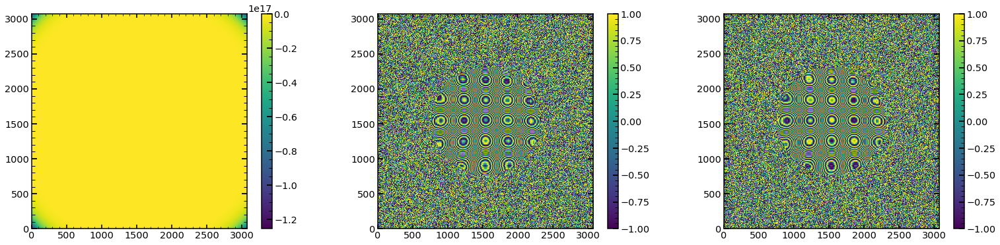

In [242]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

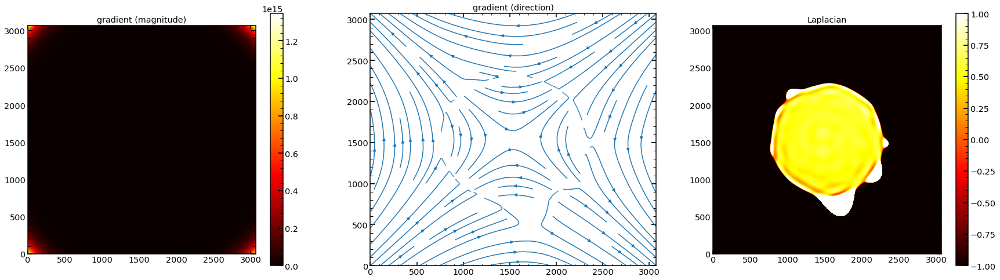

In [243]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

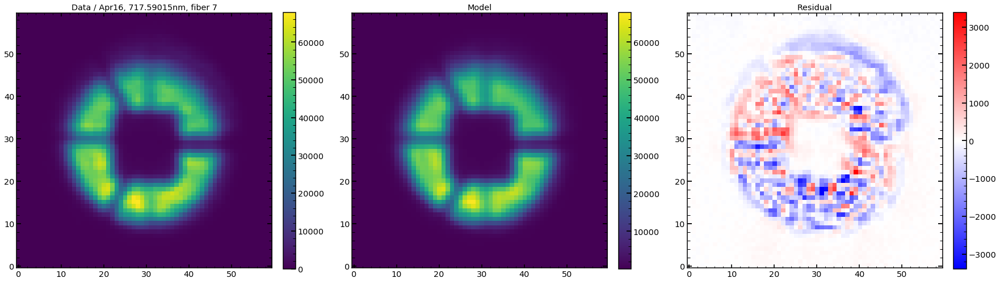

In [244]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

### 12397

In [201]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr16'
obs=12397
single_number='69'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m35


fiber                            7
xc                            1994
yc                            1077
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  1994
old_index_approx                42
superold_index_approx          nan
Name: 69, dtype: object

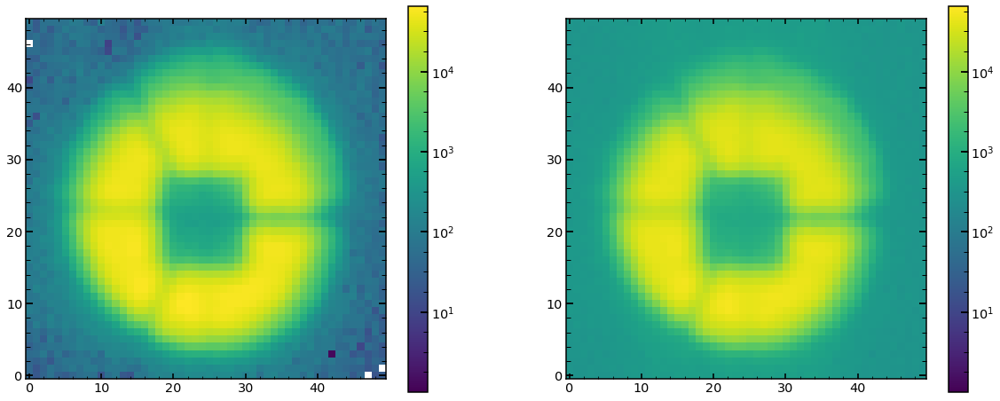

In [202]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [203]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 65849.94091948778
minimal chi2 reduced is: 52.67243781333333


In [204]:
initial_input_parameters_212397695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12397/initial_input_parameters_912397695Ne.npy')

In [205]:
initial_input_parameters_0_212397695Ne=np.copy(initial_input_parameters_212397695Ne)
initial_input_parameters_0_212397695Ne[0]=0

minchain_0=np.copy(minchain)
minchain_0[0]=0


In [206]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)
wf_full_12397_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(minchain_0)
wf_full_0_12397_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_0_212397695Ne)
wf_full_0_12397_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_212397695Ne)
wf_full_12397_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 



extraZernike: None
zmax: 22
42
42
274
274


In [207]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

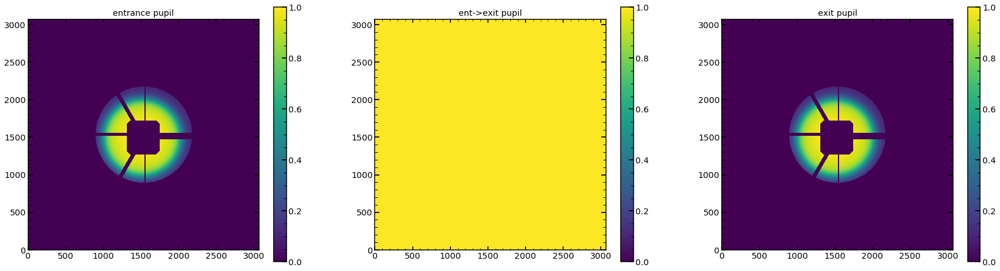

In [208]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

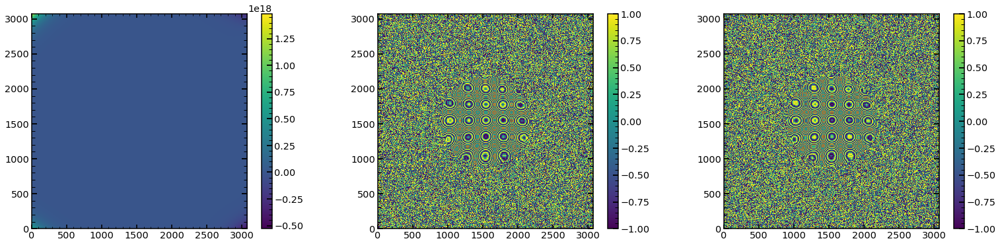

In [209]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

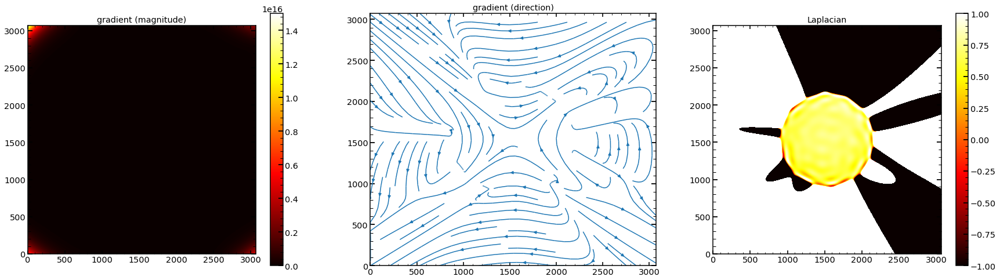

In [210]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

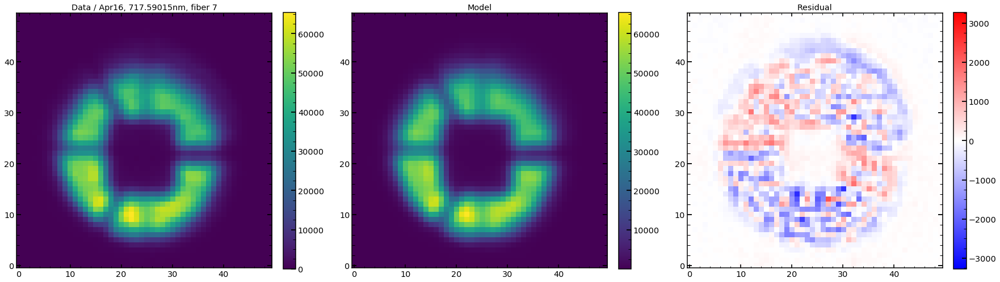

In [211]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

### 12313

In [256]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr16'
obs=12313
single_number='69'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

p35


fiber                            7
xc                            1994
yc                            1077
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  1994
old_index_approx                42
superold_index_approx          nan
Name: 69, dtype: object

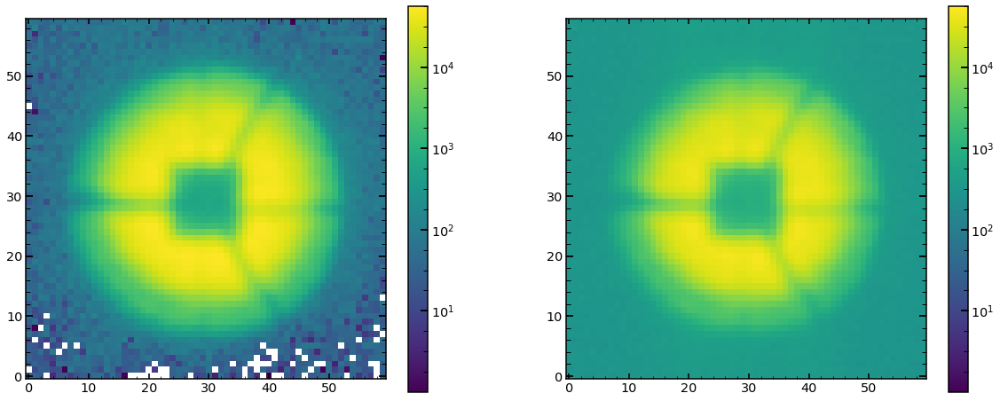

In [257]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [258]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 75110.71726032264
minimal chi2 reduced is: 41.72295339268736


In [259]:
initial_input_parameters_212313695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12313/initial_input_parameters_712313695Ne.npy')

In [260]:
initial_input_parameters_0_212313695Ne=np.copy(initial_input_parameters_212313695Ne)
initial_input_parameters_0_212313695Ne[0]=0

minchain_0=np.copy(minchain)
minchain_0[0]=0


In [261]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)
wf_full_12313_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(minchain_0)
wf_full_0_12313_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_0_212313695Ne)
wf_full_0_12313_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_212313695Ne)
wf_full_12313_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 



extraZernike: None
zmax: 22
42
42
274
274


In [262]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

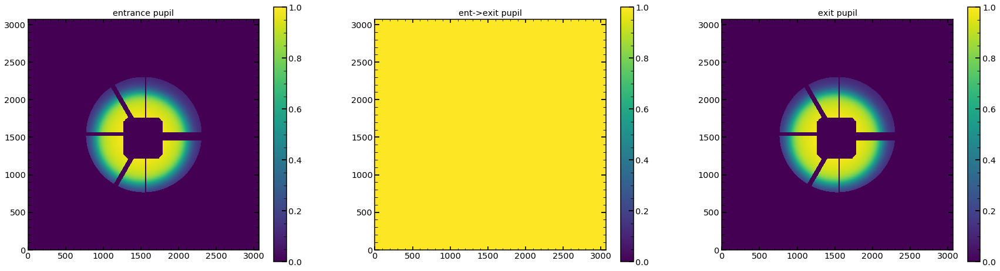

In [263]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

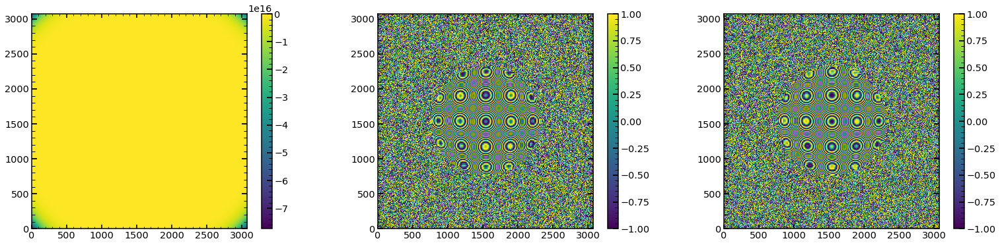

In [264]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

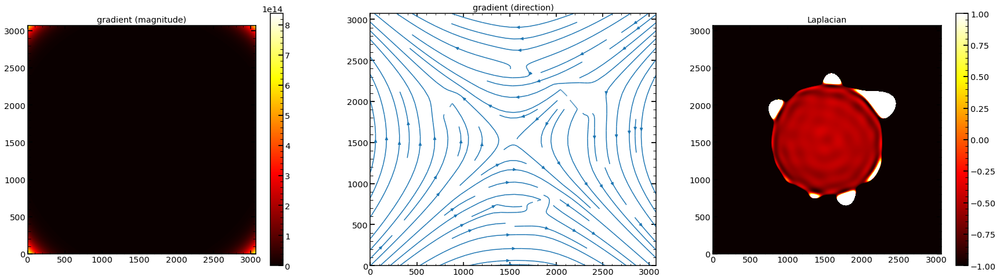

In [265]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

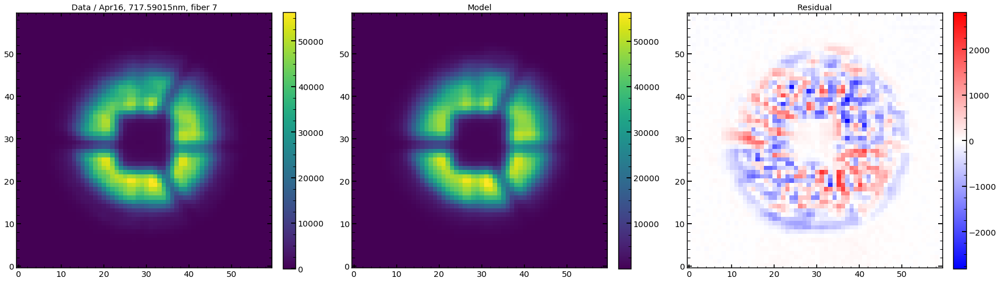

In [266]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

### 12307

In [47]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr16'
obs=12307
single_number='69'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

p4


fiber                            7
xc                            1994
yc                            1077
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  1994
old_index_approx                42
superold_index_approx          nan
Name: 69, dtype: object

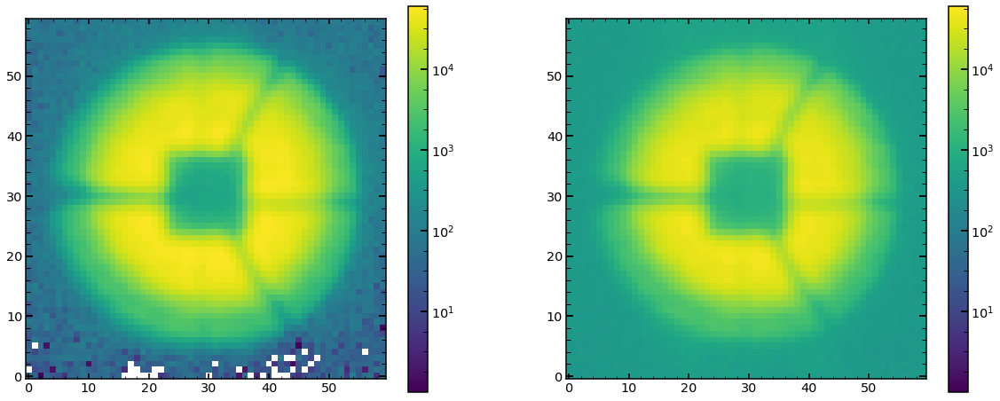

In [48]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [49]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 113782.36316702834
minimal chi2 reduced is: 63.20711818463612


In [50]:
initial_input_parameters_312307695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12307/initial_input_parameters_612307695Ne.npy')

In [51]:
initial_input_parameters_0_312307695Ne=np.copy(initial_input_parameters_312307695Ne)
initial_input_parameters_0_312307695Ne[0]=0

minchain_0=np.copy(minchain)
minchain_0[0]=0


In [52]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)
wf_full_12307_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(minchain_0)
wf_full_0_12307_22=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_0_312307695Ne)
wf_full_0_12307_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_312307695Ne)
wf_full_12307_254=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 


None
zmax: 22
diam_sic: 0.1395327
aberrations: [0.0, 0, 0.0, 0.0, -29.67933851587274, -0.08466306016990055, -0.16493224405922116, 0.38942196459585243, 0.0102983163648662, -0.07510596096236725, -0.1895012200152342, -0.5451512722666977, 0.005747933196153525, -0.0498869404797962, 0.051296962566744285, -0.012713773122672531, 0.030536792873240615, -0.005801676138828573, -0.017109419683274146, -0.017100887622331917, 0.029285217480748946, 0.017839320998713156, -0.03311391321033471]
aberrations extra: None
self.wavelength: 794
diam_sic: 0.1395327
aberrations: [0.0, 0, 0.0, 0.0, 0.0, -0.08466306016990055, -0.16493224405922116, 0.38942196459585243, 0.0102983163648662, -0.07510596096236725, -0.1895012200152342, -0.5451512722666977, 0.005747933196153525, -0.0498869404797962, 0.051296962566744285, -0.012713773122672531, 0.030536792873240615, -0.005801676138828573, -0.017109419683274146, -0.017100887622331917, 0.029285217480748946, 0.017839320998713156, -0.03311391321033471]
aberrations extra: None


In [53]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

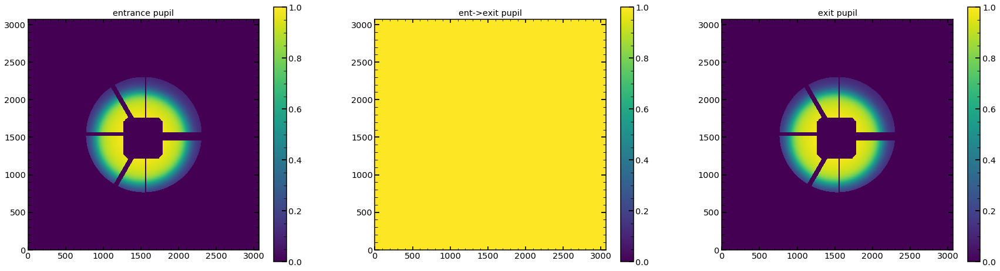

In [54]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

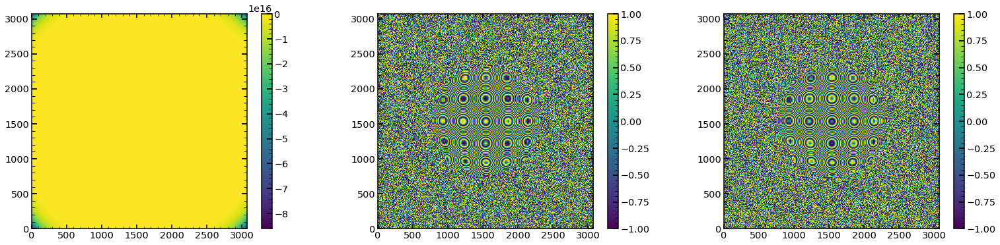

In [55]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

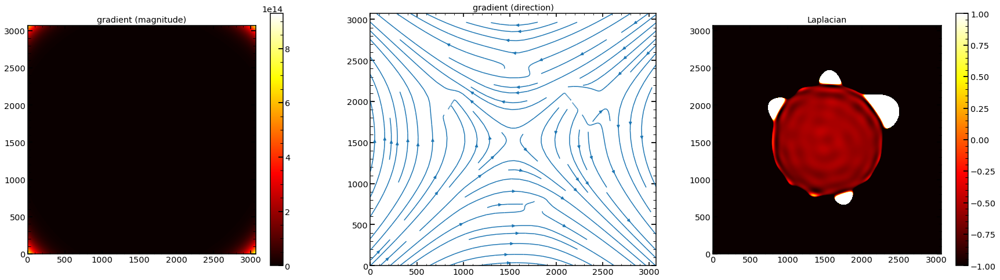

In [56]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

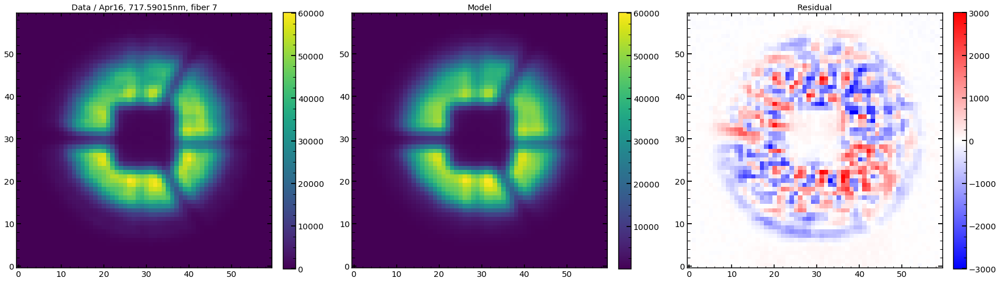

In [57]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

## Testing that you can recreate the complex wavefront (in reasonable time?)

### show all combinations

In [212]:
ilum_1=np.copy(ilum_radiometric)
ilum_1[ilum_radiometric>0.001]=1

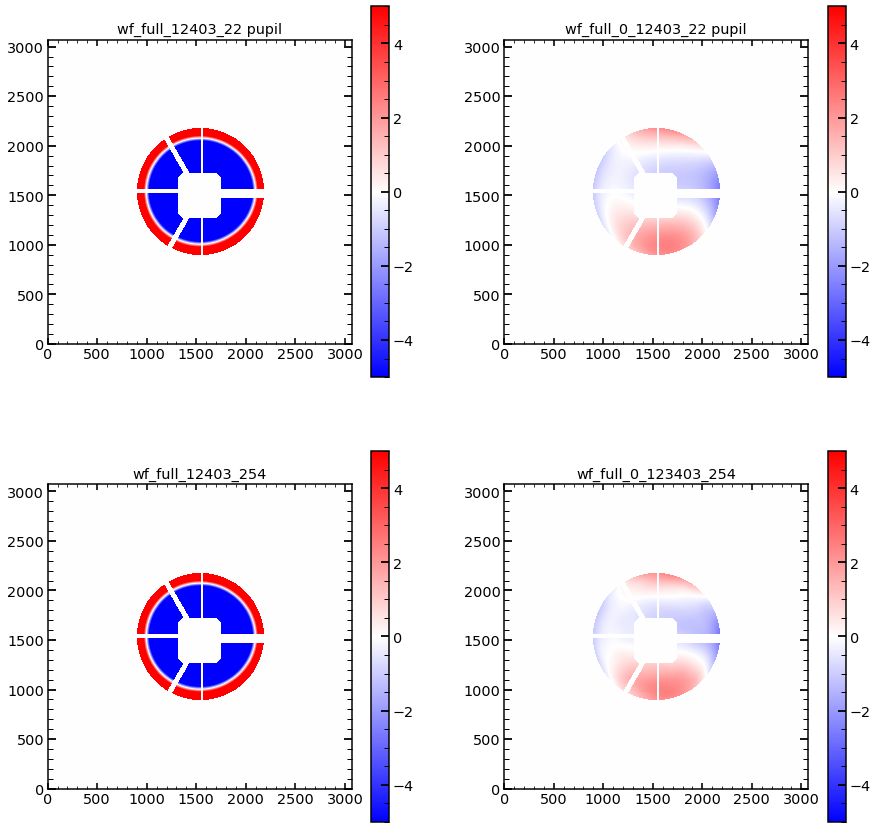

In [213]:
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(ilum_1*wf_full_12403_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_12403_22 pupil')
plt.colorbar()

plt.subplot(222)
plt.imshow(ilum_1*wf_full_0_12403_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_0_12403_22 pupil')
plt.colorbar()

plt.subplot(223)
plt.title('wf_full_12403_254')
plt.imshow(ilum_1*wf_full_12403_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')

plt.colorbar()
plt.subplot(224)
plt.title('wf_full_0_123403_254')
plt.imshow(ilum_1*wf_full_0_12403_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

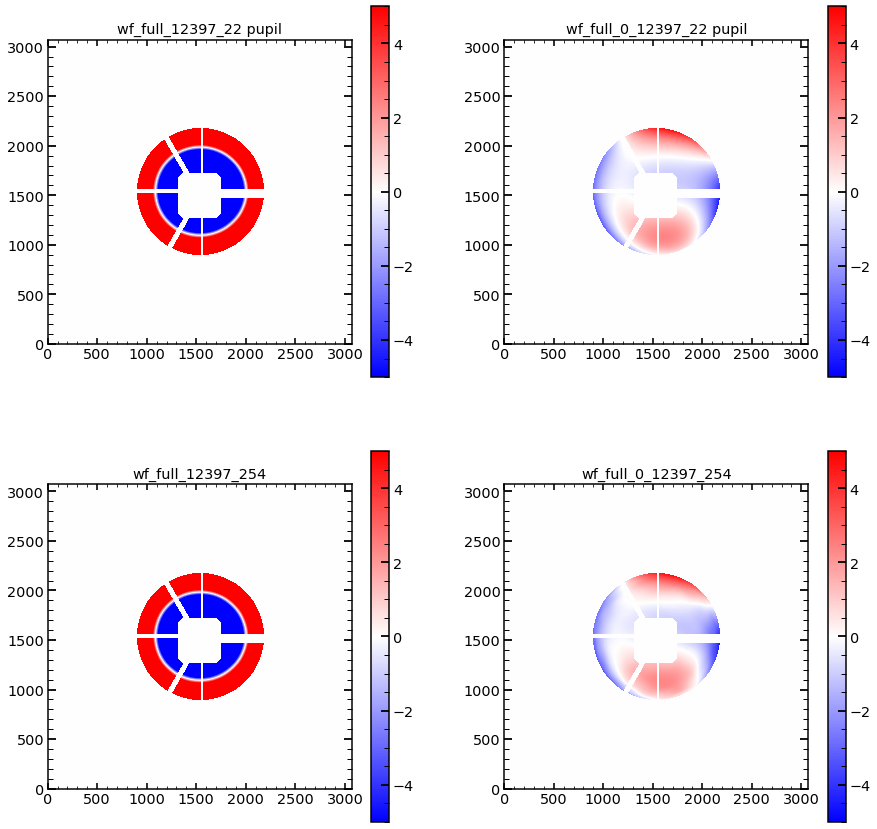

In [214]:
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(ilum_1*wf_full_12397_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_12397_22 pupil')
plt.colorbar()

plt.subplot(222)
plt.imshow(ilum_1*wf_full_0_12397_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_0_12397_22 pupil')
plt.colorbar()

plt.subplot(223)
plt.title('wf_full_12397_254')
plt.imshow(ilum_1*wf_full_12397_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')

plt.colorbar()
plt.subplot(224)
plt.title('wf_full_0_12397_254')
plt.imshow(ilum_1*wf_full_0_12397_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()


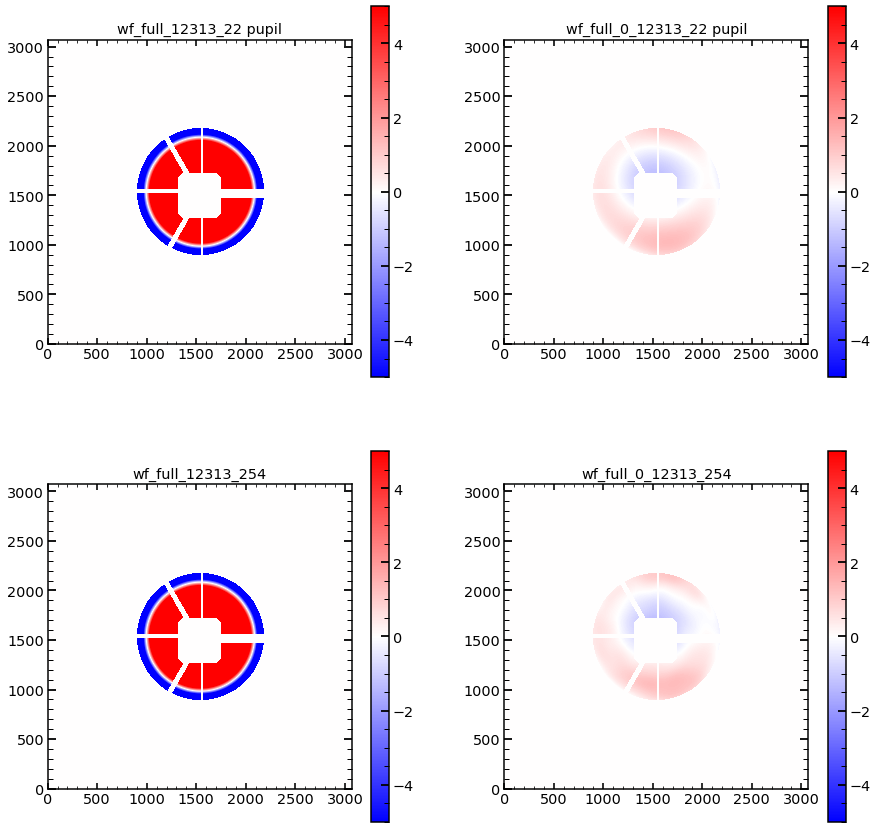

In [215]:
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(ilum_1*wf_full_12313_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_12313_22 pupil')
plt.colorbar()

plt.subplot(222)
plt.imshow(ilum_1*wf_full_0_12313_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_0_12313_22 pupil')
plt.colorbar()

plt.subplot(223)
plt.title('wf_full_12313_254')
plt.imshow(ilum_1*wf_full_12313_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')

plt.colorbar()
plt.subplot(224)
plt.title('wf_full_0_12313_254')
plt.imshow(ilum_1*wf_full_0_12313_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

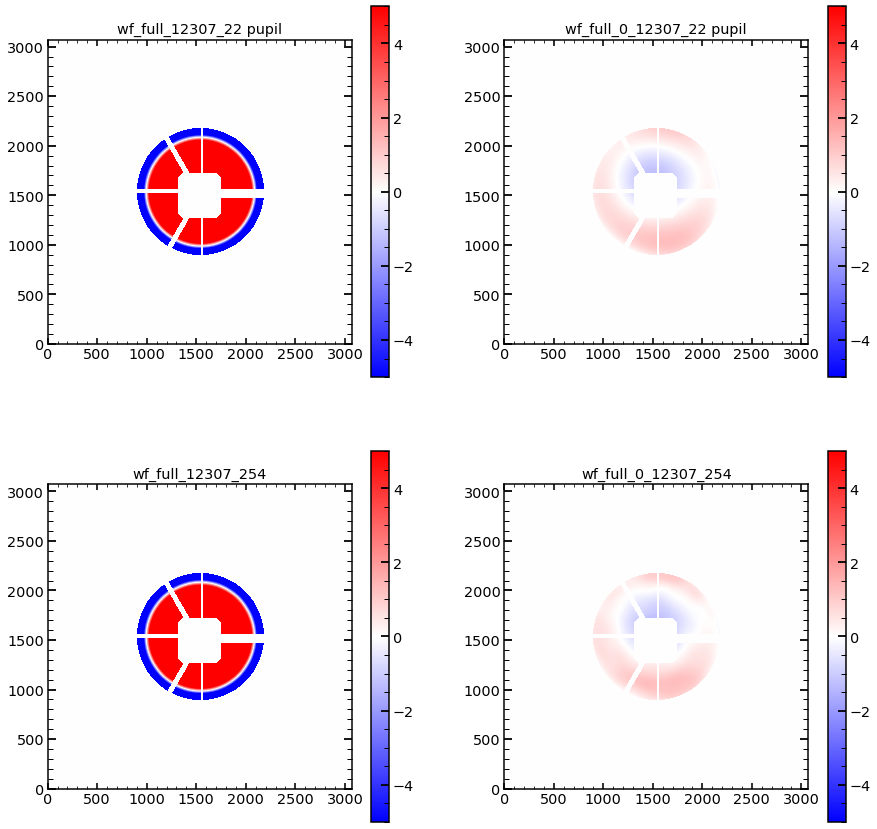

In [216]:
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(ilum_1*wf_full_12307_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_12307_22 pupil')
plt.colorbar()

plt.subplot(222)
plt.imshow(ilum_1*wf_full_0_12307_22/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.title('wf_full_0_12307_22 pupil')
plt.colorbar()

plt.subplot(223)
plt.title('wf_full_12307_254')
plt.imshow(ilum_1*wf_full_12307_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')

plt.colorbar()
plt.subplot(224)
plt.title('wf_full_0_12307_254')
plt.imshow(ilum_1*wf_full_0_12307_254/794,origin='lower',vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()


In [101]:
# create the full wavefront 3072x3072

wf_0_full_focus=np.zeros((3072,3072))

list_of_wf_0_full=[wf_full_0_12403_254,wf_full_0_12397_254,wf_full_0_12313_254,wf_full_0_12307_254]

for x in tqdm(range(3072)):
    for y in range(3072):
        single_element_with_defocus = [ list_of_wf_0_full[i][x,y] for i in [0,1,2,3]]
        wf_0_full_focus[x,y]=np.mean(single_element_with_defocus)
        


100%|██████████| 3072/3072 [01:55<00:00, 26.66it/s]


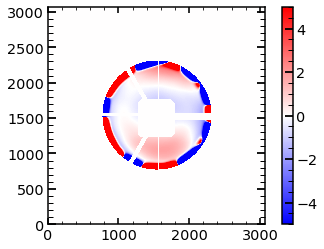

In [102]:
# look at it 

plt.imshow(ilum_1*wf_0_full_focus/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

In [59]:
# create the full wavefront via means of individual Zernike
initial_input_parameters_212403695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/initial_input_parameters_212403695Ne.npy')
initial_input_parameters_212397695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12397/initial_input_parameters_212397695Ne.npy')

initial_input_parameters_212313695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12313/initial_input_parameters_212313695Ne.npy')
initial_input_parameters_312307695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12307/initial_input_parameters_312307695Ne.npy')

In [63]:
mean_parameters=np.mean(np.array([initial_input_parameters_212403695Ne,initial_input_parameters_212397695Ne,initial_input_parameters_212313695Ne,initial_input_parameters_312307695Ne]),axis=0)

In [64]:
model(mean_parameters)
wf_full_mean_parameters=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

diam_sic: 0.1395327
aberrations: [0.0, 0, 0.0, 0.0, -0.008750227268001787, -0.014983282654096961, -0.6714786997946597, 0.49134932293391403, 0.10847804863671018, -0.05693355990178721, -0.2983970365379649, -0.430802281574566, -0.011651790343350397, 0.026945986933974368, 0.023041152724741054, 0.016319007672564934, 0.04146510048515602, 0.03875891310768495, -0.019484114347041885, -0.01156421554444453, -0.014088988787084387, 0.031573474001443495, -0.00781602491663227]
aberrations extra: [0.0023578805018604205, -0.0031221194586473888, 0.006059293444771295, 0.00656370299198029, 0.00023379715631773593, 0.0016001639452247196, -0.002038981959591535, 0.003226217001133769, 0.005302320704615629, 0.00317904586006581, -0.004519961121623855, 0.001554741969603863, -0.0010305249085622715, -0.0005222345815813277, -0.0005622851229965765, -9.922058057236982e-05, -0.004714641142860512, -0.005343616788586157, -0.007101729397717195, -0.004653806867562936, 0.00034905879202087994, 0.0007636043548854483, -0.00094

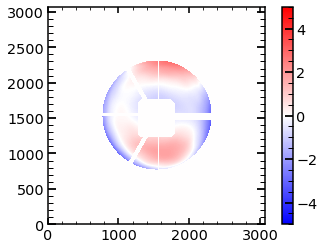

In [67]:
plt.imshow(ilum_1*wf_full_mean_parameters/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

In [145]:
### Testing why 12397 is so weird
model(initial_input_parameters_0_212397695Ne[:88])
wf_full_0_12397_254_test=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

### Testing why 12397 is so weird
#model(minchain_0)
#wf_full_0_12397_22_test=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

88


In [147]:
initial_input_parameters_0_212397695Ne[:88]

array([     0.        ,      0.06909423,     -1.12414157,      0.5990145 ,
            0.19267653,     -0.03966488,     -0.39576914,     -0.32856321,
           -0.03254669,      0.09182076,     -0.00326309,      0.04723841,
            0.05587914,      0.07782779,     -0.01951559,     -0.00478711,
           -0.05265439,      0.04623462,      0.01493821,      0.68506276,
            0.08014574,     -0.01484252,     -0.06009328,      0.06072556,
            0.01065127,      0.00000782,      0.00000782,      0.97303761,
            0.94833669,     -0.04332539,     -0.07515384,      0.80155356,
            0.05408019,      0.9998427 ,      1.02643908,      0.03309604,
       119230.92170004,      2.49944585,      0.00307517,      0.45785109,
            1.80276317,      0.99562514,      0.00937498,     -0.00996894,
            0.00846923,      0.00749771,      0.00066278,      0.0024901 ,
           -0.00048199,      0.00328379,      0.00699145,     -0.00040906,
           -0.00554245,  

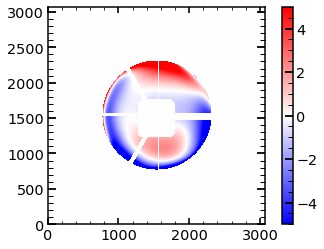

In [148]:
plt.imshow(ilum_1*wf_full_0_12397_254_test/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

In [144]:
4+7+11+15+19+23

79

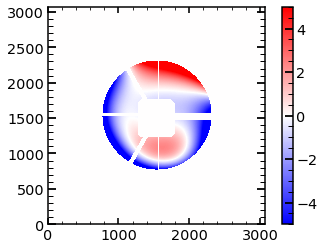

In [115]:
plt.imshow(ilum_1*wf_full_0_12397_22/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()



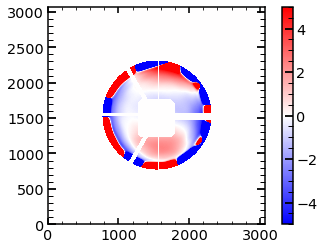

In [82]:
plt.imshow(ilum_1*wf_full_0_12397_254/794,vmax=5,vmin=-5,cmap='bwr')
plt.colorbar()

### show all combinations, differences

In [157]:
wf_full_0_12403_254-wf_full_0_12403_22

array([[-4.17993911e+16, -4.14783694e+16, -4.11598137e+16, ...,
        -5.23862561e+16, -5.27774085e+16, -5.31714484e+16],
       [-4.14849178e+16, -4.11660777e+16, -4.08496884e+16, ...,
        -5.19812779e+16, -5.23696589e+16, -5.27609089e+16],
       [-4.11728115e+16, -4.08561382e+16, -4.05419007e+16, ...,
        -5.15793755e+16, -5.19650046e+16, -5.23534842e+16],
       ...,
       [-1.58052262e+16, -1.56622538e+16, -1.55205462e+16, ...,
        -3.63703656e+16, -3.66403156e+16, -3.69122536e+16],
       [-1.59237616e+16, -1.57798442e+16, -1.56371991e+16, ...,
        -3.66611396e+16, -3.69330693e+16, -3.72070004e+16],
       [-1.60432325e+16, -1.58983636e+16, -1.57547747e+16, ...,
        -3.69541885e+16, -3.72281122e+16, -3.75040505e+16]])

In [154]:
# create the full wavefront via means of individual Zernike
initial_input_parameters_212403695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/initial_input_parameters_212403695Ne.npy')
initial_input_parameters_212397695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12397/initial_input_parameters_212397695Ne.npy')

initial_input_parameters_212313695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12313/initial_input_parameters_212313695Ne.npy')
initial_input_parameters_312307695Ne=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12307/initial_input_parameters_312307695Ne.npy')

initial_input_parameters_212403695Ne[0:19]=np.zeros((19))
initial_input_parameters_212397695Ne[0:19]=np.zeros((19))
initial_input_parameters_212313695Ne[0:19]=np.zeros((19))
initial_input_parameters_312307695Ne[0:19]=np.zeros((19))


model(initial_input_parameters_212403695Ne)
wf_full_00000_12403=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_212397695Ne)
wf_full_00000_12397=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_212313695Ne)
wf_full_00000_12313=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

model(initial_input_parameters_312307695Ne)
wf_full_00000_12307=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 


274
274
274
274


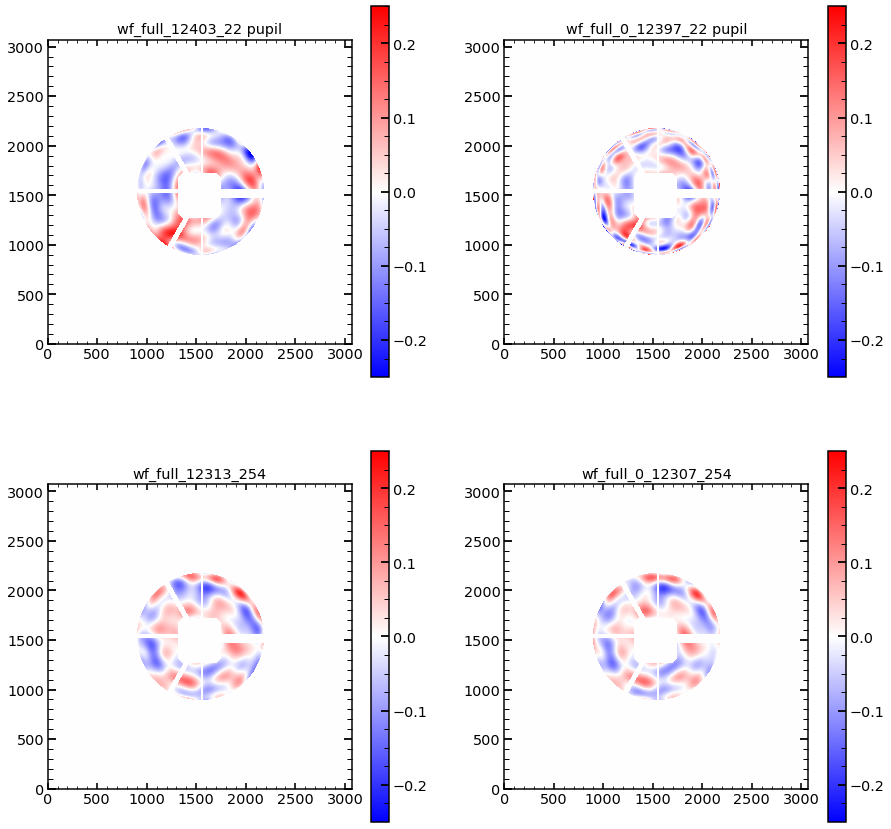

In [267]:
plt.figure(figsize=(15,15))
plt.subplot(221)
plt.imshow(ilum_1*(wf_full_0_12403_254-wf_full_0_12403_22)/794,origin='lower',vmax=0.25,vmin=-0.25,cmap='bwr')
plt.title('wf_full_12403_22 pupil')
plt.colorbar()

plt.subplot(222)
plt.imshow(ilum_1*(wf_full_0_12397_254-wf_full_0_12397_22)/794,origin='lower',vmax=0.25,vmin=-0.25,cmap='bwr')
plt.title('wf_full_0_12397_22 pupil')
plt.colorbar()

plt.subplot(223)
plt.title('wf_full_12313_254')
plt.imshow(ilum_1*(wf_full_0_12313_254-wf_full_0_12313_22)/794,origin='lower',vmax=0.25,vmin=-0.25,cmap='bwr')

plt.colorbar()
plt.subplot(224)
plt.title('wf_full_0_12307_254')
plt.imshow(ilum_1*(wf_full_0_12307_254-wf_full_0_12307_22)/794,origin='lower',vmax=0.25,vmin=-0.25,cmap='bwr')
plt.colorbar()


## fit 22 

In [110]:
u=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u.npy') 
v=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v.npy') 

u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy') 
v_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v_manual.npy') 

In [111]:
aberrations_custom_list=np.zeros(23)
list_of_wf_full_single_component=[]
for i in tqdm(range(len(aberrations_custom_list))):
    aberrations_single_component=np.copy(aberrations_custom_list)
    aberrations_single_component[i]=1
    optics_screen_single_component = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_single_component,lam_0=794)
    screens_single_component = galsim.PhaseScreenList(optics_screen_single_component)
    wf_full_single_component = screens_single_component.wavefront(u_manual, v_manual, None, 0)
    list_of_wf_full_single_component.append(wf_full_single_component)

  0%|          | 0/23 [00:00<?, ?it/s]/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/galsim/errors.py:424: GalSimWarning: Detected non-zero value in aberrations[0] -- this value is ignored!
  warnings.warn(message, GalSimWarning)
100%|██████████| 23/23 [00:22<00:00,  1.02it/s]


In [112]:
list_of_wf_full_single_component_normalized_and_cut=[]
for i in range(len(list_of_wf_full_single_component)):
    list_of_wf_full_single_component_normalized_and_cut.append((list_of_wf_full_single_component[i][ilum_1>0]/794).flatten())
    
array_of_wf_full_single_component_normalized_and_cut=np.array(list_of_wf_full_single_component_normalized_and_cut)

In [113]:
wf_0_full_focus_normalized_and_cut=(wf_0_full_focus[ilum_1>0]/794).flatten()

In [114]:
def residuals(coeffs):
    res=np.sum(coeffs[:, None]*array_of_wf_full_single_component_normalized_and_cut[4:],axis=0)-wf_0_full_focus_normalized_and_cut
        
    return res

In [115]:
leastsq_res=scipy.optimize.leastsq(residuals,np.array([0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]))

In [117]:
leastsq_res22=leastsq_res
leastsq_res22

(array([ 16.24369043,  -7.43461131,   7.56282467,  -0.90458838,
        -31.69775323,  19.1995144 ,  17.735901  ,   1.57216883,
          5.28750995,  -5.60005566,  -4.32296729,   7.67467001,
        -40.44389893,  -2.11915338,  13.49733094,  19.46490922,
         44.24120768, -52.938429  ,  12.92631104]), 3)

## fit many 

### create wf_full_single_component

In [118]:
u=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u.npy') 
v=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v.npy') 

u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy') 
v_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'v_manual.npy') 

In [125]:
aberrations_custom_list=np.zeros(254)
list_of_wf_full_single_component=[]
for i in tqdm(range(len(aberrations_custom_list))):
    aberrations_single_component=np.copy(aberrations_custom_list)
    aberrations_single_component[i]=1
    optics_screen_single_component = galsim.phase_screens.OpticalScreen(diam=0.1395327,aberrations=aberrations_single_component,lam_0=794)
    screens_single_component = galsim.PhaseScreenList(optics_screen_single_component)
    wf_full_single_component = screens_single_component.wavefront(u_manual, v_manual, None, 0)
    list_of_wf_full_single_component.append(wf_full_single_component)

  0%|          | 0/254 [00:00<?, ?it/s]/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/galsim/errors.py:424: GalSimWarning: Detected non-zero value in aberrations[0] -- this value is ignored!
  warnings.warn(message, GalSimWarning)
100%|██████████| 254/254 [20:23<00:00,  4.82s/it]


In [126]:
# export wf_full_single_component
for i in range(len(list_of_wf_full_single_component)):
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/wf_full_single_components/'+str(i)+'_'+'wf_full_single_component',list_of_wf_full_single_component[i])


### use wf_full

In [196]:
list_of_wf_full_single_component=[]
for i in range(22):
    list_of_wf_full_single_component.append(np.load('/Volumes/My Passport for Mac/Old_Files/PFS/Fit_Results/wf_full_single_components/'+str(i)+'_wf_full_single_component.npy'))

In [197]:
list_of_wf_full_single_component_normalized_and_cut=[]
for i in range(len(list_of_wf_full_single_component)):
    list_of_wf_full_single_component_normalized_and_cut.append((list_of_wf_full_single_component[i][ilum_1>0]/794).flatten())
    
array_of_wf_full_single_component_normalized_and_cut=np.array(list_of_wf_full_single_component_normalized_and_cut)

In [131]:
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/wf_full_single_components/array_of_wf_full_single_component_normalized_and_cut',array_of_wf_full_single_component_normalized_and_cut)

In [132]:
def residuals(coeffs):
    res=np.sum(coeffs[:, None]*array_of_wf_full_single_component_normalized_and_cut[4:],axis=0)-wf_0_full_focus_normalized_and_cut
        
    return res

In [123]:
leastsq_res=scipy.optimize.leastsq(residuals,np.zeros((97,1)))

In [ ]:
residuals(np.zeros((97,1)))

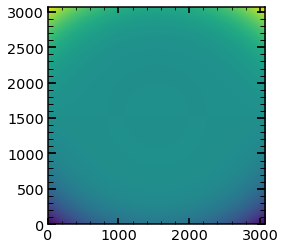

In [199]:
plt.imshow(list_of_wf_full_single_component[17])

In [116]:
len(np.array([0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]))

19

In [547]:
leastsq_res

(array([ 0.        , -0.01489363, -0.67220732,  0.49122358,  0.10877486,
        -0.05697173, -0.29926817, -0.43095407, -0.01214995,  0.02765269,
         0.02464116,  0.01773785,  0.04118782,  0.0367153 , -0.01562596,
        -0.01003361, -0.01353022,  0.03008123, -0.00411863]), 2)

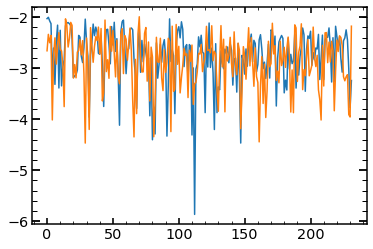

In [108]:
plt.plot(np.log10(np.abs(initial_input_parameters_0_212397695Ne[42:])))
plt.plot(np.log10(np.abs(initial_input_parameters_212313695Ne[42:])))

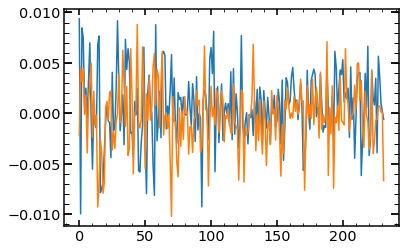

In [149]:
plt.plot(initial_input_parameters_0_212397695Ne[42:])
plt.plot(initial_input_parameters_212313695Ne[42:])

## alternative ways to do high Zernike analysis - no improvment

In [13]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='Apr16'
obs=12403
single_number='69'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

m4


fiber                            7
xc                            1994
yc                            1077
wavelength               717.59015
close                            1
lamp                            Ne
xc_effective                  1994
old_index_approx                42
superold_index_approx          nan
Name: 69, dtype: object

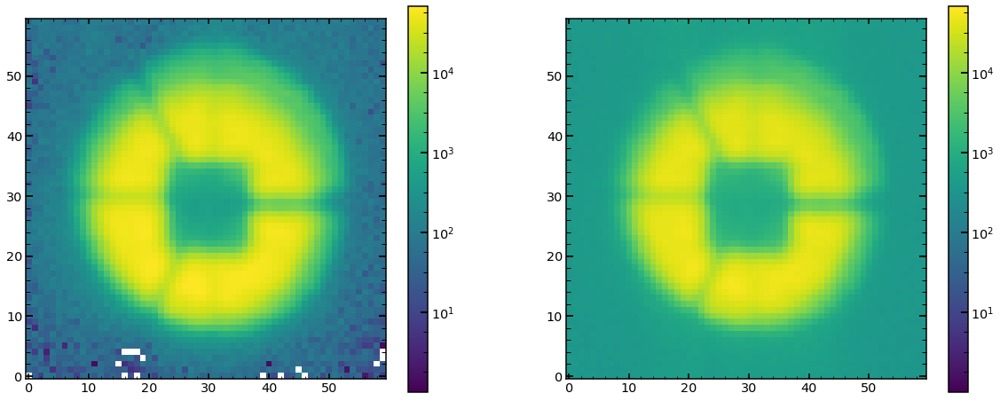

In [14]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [15]:
initial_input_parameters=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/initial_input_parameters_512403695Ne.npy')
image_0=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/image_0_512403695Ne.npy')
initial_model_result=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/initial_model_result_512403695Ne.npy')

out_images=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/out_images_512403695Ne.npy')
out_parameters=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/out_parameters_512403695Ne.npy')
array_of_delta_z=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/array_of_delta_z_512403695Ne.npy')
single_wavefront_parameter_list=np.load('/Users/nevencaplar/Documents/PFS/TigerAnalysis/Result_DirectAndInt_FinalResults/Apr18Test/12403/single_wavefront_parameter_list_512403695Ne.npy')

In [16]:
import cosmoHammer

In [17]:
class PFSLikelihoodModule254(object):
    """
    PFSLikelihoodModule object for calculating a likelihood for cosmoHammer.ParticleSwarmOptimizer
    """

    def __init__(self,model):
        """
        
        Constructor of the PFSLikelihoodModule
        """
        self.model254=model254

    def computeLikelihood(self, ctx):
        """
        Computes the likelihood using information from the context
        """
        # Get information from the context. This can be results from a core
        # module or the parameters coming from the sampler
        params = ctx.getParams()
        
        
        #print(params)
        # Calculate a likelihood up to normalization
        lnprob = self.model254(params)
        #print(str(current_process())+str(lnprob))
        #sys.stdout.flush()
        # Return the likelihood
        return lnprob

    def setup(self):
        """
        Sets up the likelihood module.
        Tasks that need to be executed once per run
        """
        #e.g. load data from files

        print("PFSLikelihoodModule setup done")


In [18]:
# science image
mask=sci_image>(np.max(sci_image)*0.1)
sci_image_1D=((sci_image[mask])/np.sum(sci_image[mask])).ravel()
sci_image_normalized=((sci_image)/np.sum(sci_image[mask]))

# last input image
image_0_1D=((image_0[mask])/np.sum(image_0[mask])).ravel()
image_0_normalized=((image_0)/np.sum(image_0[mask]))

# images after changing only one parameter, compared to the last input image, normalized by themselves (should it be by sci_image?)
out_images_1D=[]
for i in range(len(out_images)):
    out_images_1D.append((out_images[i][mask]/np.sum(out_images[i][mask])).ravel())    
out_images_1D=np.array(out_images_1D)

# difference between the images created by changing only one parameter, normalized by sci_image
dif_images_1D=[]
dif_images=(image_0-out_images)
dif_images_normalized=dif_images/np.sum(sci_image[mask])
for i in range(len(out_images)):
    dif_images_1D.append((dif_images[i][mask]/np.sum(sci_image[mask])).ravel())
    
dif_images_1D=np.array(dif_images_1D)


dif_images_sci_1D=[]
dif_images_sci=(sci_image-out_images)
for i in range(len(out_images)):
    dif_images_sci_1D.append((dif_images_sci[i][mask]/np.sum(sci_image[mask])).ravel())
    
dif_images_sci_1D=np.array(dif_images_sci_1D)


In [132]:
init_ln=np.sum(np.abs(sci_image_1D-image_0_1D))
print(init_ln)
def model254(coeffs):
    if np.max(np.abs(coeffs))>3:
        res=-np.inf
    else:
        res_abs=np.sum(np.abs(sci_image_1D-image_0_1D-np.sum(((1/len(dif_images_1D))*(coeffs[:,None]*dif_images_1D)),axis=0)))
        res=-10*res_abs/init_ln    
    return res

0.024556654002397413


In [131]:
len(dif_images_1D)

251

In [133]:
chain = cosmoHammer.LikelihoodComputationChain()
chain.addLikelihoodModule(PFSLikelihoodModule254(model254))

In [134]:
from multiprocessing import Pool
from multiprocessing import current_process
pool=Pool()

Process ForkPoolWorker-32:
Process ForkPoolWorker-29:
Process ForkPoolWorker-28:
Process ForkPoolWorker-31:
Process ForkPoolWorker-25:
Process ForkPoolWorker-30:
Process ForkPoolWorker-26:
Process ForkPoolWorker-27:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/multiprocessing/pool.py", line 119, in worker
    result = (True, func(*args, **kwds))
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/multiprocessing/process.p

  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/cosmoHammer/LikelihoodComputationChain.py", line 152, in invokeLikelihoodModule
    return likelihoodModule.computeLikelihood(ctx)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/cosmoHammer/LikelihoodComputationChain.py", line 152, in invokeLikelihoodModule
    return likelihoodModule.computeLikelihood(ctx)
  File "<ipython-input-17-72ea14b8af85>", line 24, in computeLikelihood
    lnprob = self.model254(params)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/cosmoHammer/LikelihoodComputationChain.py", line 144, in computeLikelihoods
    likelihood += self.invokeLikelihoodModule(lModule, ctx)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/numpy/core/arrayprint.py", line 668, in array2string
    return _array2string(a, options, separator, prefix)
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/numpy/core/

In [143]:
pso254 = cosmoHammer.ParticleSwarmOptimizer(chain,low=-np.ones(251)*1,high=np.ones(251)*1,particleCount=251*100,pool=pool)

In [ ]:
swarms=[]
gbests=[]
num_iter = 0
nsteps=1000
for swarm in pso254.sample(nsteps):
    swarms.append(swarm)
    gbests.append(pso254.gbest.copy())
    num_iter += 1
    if pso254.isMaster():
        if num_iter % 2 == 0:
            print("First swarm: "+str(100*num_iter/nsteps))
            print(gbests[-1].fitness)
            sys.stdout.flush()
    

minchain=gbests[-1].position
minln=gbests[-1].fitness

First swarm: 0.2
-9.860033552064273
First swarm: 0.4
-9.8567483840926
First swarm: 0.6
-9.855072512173576
First swarm: 0.8
-9.854360760502363
First swarm: 1.0
-9.852452414024627
First swarm: 1.2
-9.852452414024627
First swarm: 1.4
-9.847706675513532
First swarm: 1.6
-9.844721865495297
First swarm: 1.8
-9.844721865495297
First swarm: 2.0
-9.844416036027056
First swarm: 2.2
-9.84135063802096
First swarm: 2.4
-9.84135063802096
First swarm: 2.6
-9.838999244134161
First swarm: 2.8
-9.836788620009989
First swarm: 3.0
-9.833656248286669
First swarm: 3.2
-9.833656248286669
First swarm: 3.4
-9.833656248286669
First swarm: 3.6
-9.832332880016034
First swarm: 3.8
-9.829413362138903
First swarm: 4.0
-9.82607970734073
First swarm: 4.2
-9.825191796824841
First swarm: 4.4
-9.822933968606174
First swarm: 4.6
-9.820870210008387
First swarm: 4.8
-9.820337403951111
First swarm: 5.0
-9.819700993548102
First swarm: 5.2
-9.818042161699802
First swarm: 5.4
-9.815478213534785
First swarm: 5.6
-9.8143656740357

First swarm: 45.2
-9.754466111664058
First swarm: 45.4
-9.754377732354477
First swarm: 45.6
-9.754261450948393
First swarm: 45.8
-9.754193137570976
First swarm: 46.0
-9.75408377044435
First swarm: 46.2
-9.754008565052704
First swarm: 46.4
-9.753922571946092
First swarm: 46.6
-9.753886831044406


In [138]:
minln

-9.84942298874942

In [139]:
minchain

array([-0.05119326, -0.10960295,  1.14929501, -2.73531751,  0.75413783,
       -2.47437538, -1.84463406, -2.45378214, -0.69851793,  2.71167678,
        2.27845777,  1.25061671,  0.13147879, -1.85811985, -0.74038226,
       -0.96889658, -1.88241855,  1.177993  ,  1.79205164,  0.90496555,
       -2.96596261,  2.85830117,  1.64154575, -2.41260562,  0.51337217,
       -1.05682528, -2.54527227, -1.34026023,  0.69554353, -0.56136852,
       -0.84796383, -1.42929068, -2.55015135, -0.47128365,  1.01065125,
       -0.40508215,  0.82577115, -0.56037506,  1.03449252,  0.02342949,
       -2.95147601,  2.42634201, -1.83035434,  2.61735901, -1.99819495,
       -0.84799732, -1.17900522, -1.68861748,  2.86982249,  2.17309811,
        0.67668202,  0.38792782,  0.33650125, -2.98750406,  1.01035701,
       -1.13987268, -0.86916818, -2.99899655, -2.96749978, -1.78356307,
       -1.35271039,  2.99728007,  2.57692375,  1.74615083, -0.90111642,
       -1.02375575,  0.27092465,  1.54482692,  0.96359006, -0.08

In [124]:
# result after optimization
minln

-0.9833601462736554

In [125]:
model254(minchain)

-0.9833601462736554

In [126]:
np.sum(((1/254)*(minchain[:,None]*dif_images_1D)),axis=0)

array([ 0.00000086,  0.0000009 ,  0.00000046, ..., -0.00000018,
       -0.00000033, -0.00000028])

In [45]:
# lets recreate model image after optimization
out_sum_image=[]
for i in range(len(minchain)):
    out_sum_image.append((1/254)*minchain[i]*dif_images[i])
    
out_sum_image=np.array(out_sum_image)

In [127]:
delta_image=np.sum(((1/254)*(minchain[:,None,None]*dif_images_normalized)),axis=0)

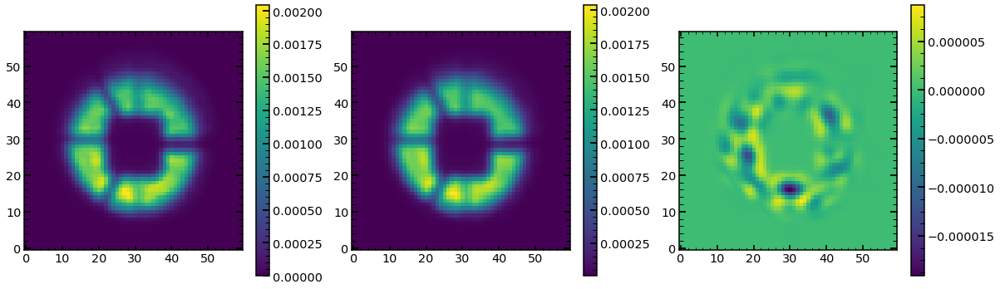

In [128]:
plt.figure(figsize=(20,6))

plt.subplot(131)
plt.imshow(sci_image_normalized)
plt.colorbar()

plt.subplot(132)
plt.imshow(image_0_normalized)
plt.colorbar()


plt.subplot(133)
plt.imshow(np.sum(((1/254)*(minchain[:,None,None]*dif_images_normalized)),axis=0))
plt.colorbar()




In [117]:
np.sum(np.abs(sci_image_normalized-image_0_normalized))

0.03459790360291744

In [118]:
np.sum(np.abs(sci_image_normalized[mask]-image_0_normalized[mask]))

0.024556654002397413

In [119]:
np.sum(np.abs(sci_image_normalized-image_0_normalized-delta_image))

0.03425166997531207

In [129]:
np.sum(np.abs(sci_image_normalized[mask]-image_0_normalized[mask]-delta_image[mask]))

0.024148034871789067

# Verifying that images with new stop do look different

## defocus

In [224]:
from astropy.io import fits

sci_data_old=fits.open('/Users/nevencaplar/Documents/PFS/ReducedData/FEB25/Feb2019/rerun/Feb13_2019/Feb14/calExp/2019-02-16/v0012310/calExp-LA012310r1.fits')[1].data
sci_data_new=fits.open('/Users/nevencaplar/Documents/PFS/ReducedData/NeonApr_2019/2019-04-17/v0016344/calExp-LA016344r1.fits')[1].data

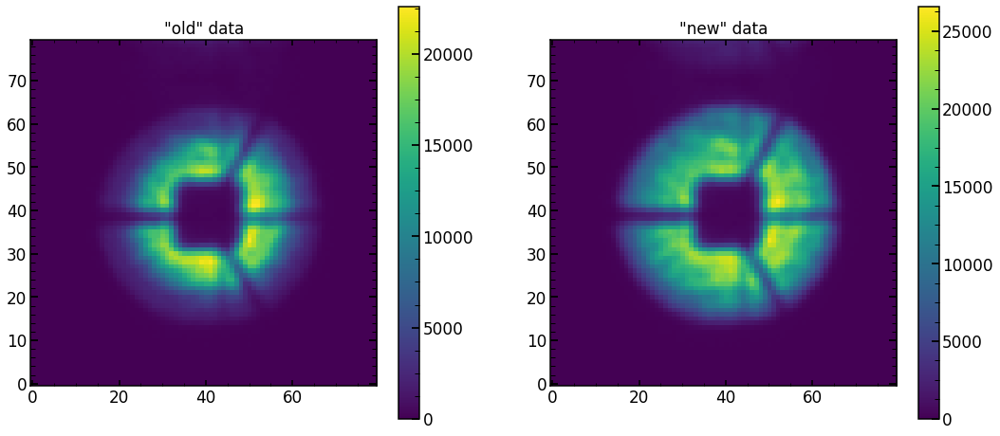

In [80]:
plt.figure(figsize=(18,8))

sci_data_old_cut=sci_data_old[1343:1423,2444-40:2444+40]
sci_data_new_cut=sci_data_new[1340:1420,2437-40:2437+40]

plt.subplot(121)
plt.title('"old" data')
plt.imshow(sci_data_old_cut,vmin=0)
plt.colorbar()

plt.subplot(122)
plt.title('"new" data')
plt.imshow(sci_data_new_cut,vmin=0)
plt.colorbar()

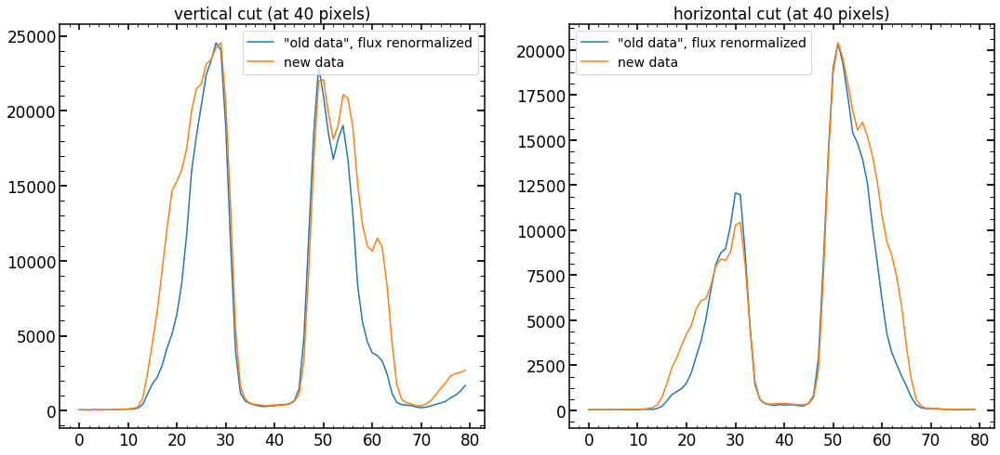

In [85]:
plt.figure(figsize=(18,8))
plt.subplot(121)
plt.title('vertical cut (at 40 pixels)')
plt.plot(sci_data_old_cut[:,40]*(np.max(sci_data_new_cut[:,40])/np.max(sci_data_old_cut[:,40])),label='"old data", flux renormalized')
plt.plot(sci_data_new_cut[:,40],label="new data")
plt.legend()

plt.subplot(122)
plt.title('horizontal cut (at 40 pixels)')
plt.plot(sci_data_old_cut[40]*(np.max(sci_data_new_cut[40])/np.max(sci_data_old_cut[40])),label='"old data", flux renormalized')
plt.plot(sci_data_new_cut[40],label="new data")

plt.legend()

## defocus April 30

In [253]:
from astropy.io import fits

sci_data_old=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/rerun/Apr30_2019/detrend/calExp/2019-02-16/v0012310/calExp-LA012310r1.fits')[1].data
sci_data_new=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/detrend/calExp/2019-04-17/v0016344/calExp-LA016344r1.fits')[1].data

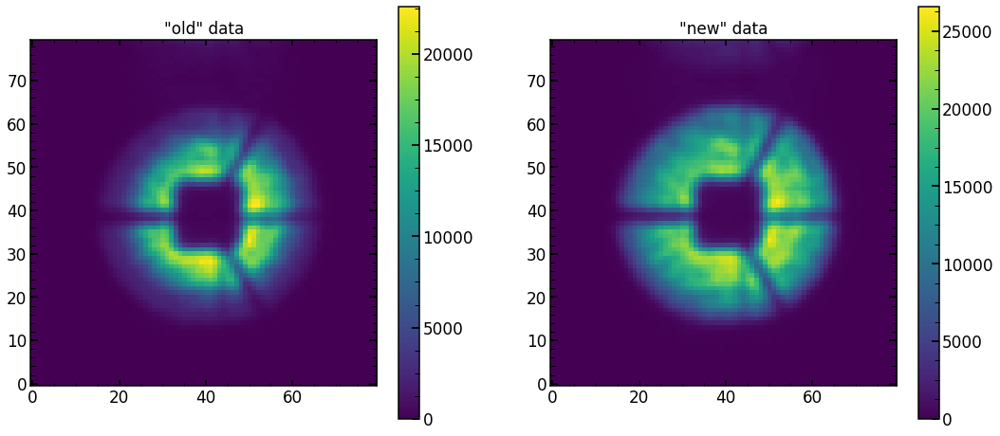

In [254]:
plt.figure(figsize=(18,8))

sci_data_old_cut=sci_data_old[1343:1423,2444-40:2444+40]
sci_data_new_cut=sci_data_new[1340:1420,2437-40:2437+40]

plt.subplot(121)
plt.title('"old" data')
plt.imshow(sci_data_old_cut,vmin=0)
plt.colorbar()

plt.subplot(122)
plt.title('"new" data')
plt.imshow(sci_data_new_cut,vmin=0)
plt.colorbar()

## focus April 30

In [277]:
from astropy.io import fits

sci_data_focus_old=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/rerun/Apr30_2019/detrend/calExp/2019-02-16/v0012355/calExp-LA012355r1.fits')[1].data
sci_data_focus_new=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/detrend/calExp/2019-04-17/v0016297/calExp-LA016297r1.fits')[1].data

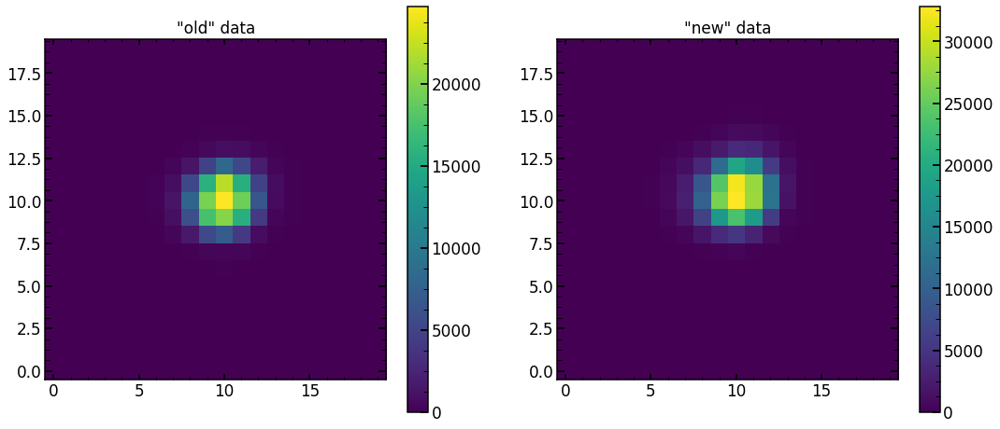

In [278]:
plt.figure(figsize=(18,8))

sci_data_focus_old_cut=sci_data_focus_old[1371:1391,2448-10:2448+10]
sci_data_focus_new_cut=sci_data_focus_new[1368:1388,2441-10:2441+10]

plt.subplot(121)
plt.title('"old" data')
plt.imshow(sci_data_focus_old_cut,vmin=0)
plt.colorbar()

plt.subplot(122)
plt.title('"new" data')
plt.imshow(sci_data_focus_new_cut,vmin=0)
plt.colorbar()

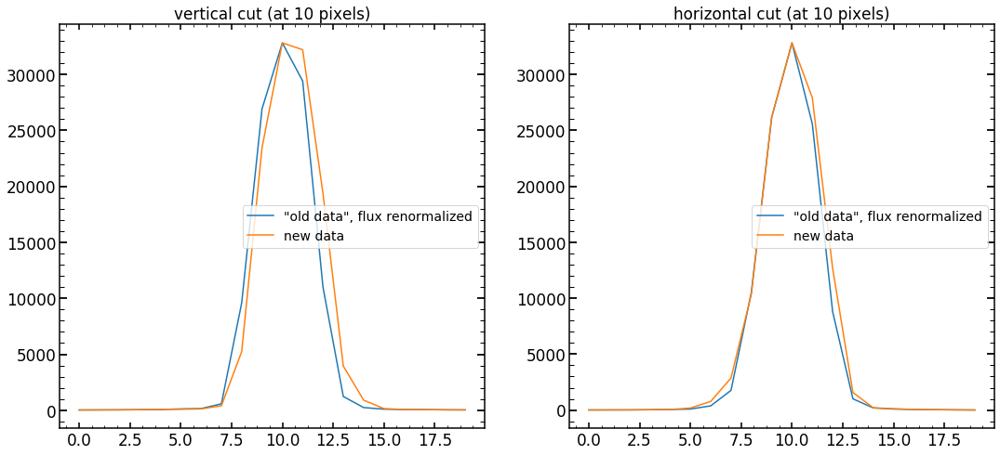

In [280]:
plt.figure(figsize=(18,8))
plt.subplot(121)
plt.title('vertical cut (at 10 pixels)')
plt.plot(sci_data_focus_old_cut[:,10]*(np.max(sci_data_focus_new_cut[:,10])/np.max(sci_data_focus_old_cut[:,10])),label='"old data", flux renormalized')
plt.plot(sci_data_focus_new_cut[:,10],label="new data")
plt.legend()

plt.subplot(122)
plt.title('horizontal cut (at 10 pixels)')
plt.plot(sci_data_focus_old_cut[10]*(np.max(sci_data_focus_new_cut[10])/np.max(sci_data_focus_old_cut[10])),label='"old data", flux renormalized')
plt.plot(sci_data_focus_new_cut[10],label="new data")

plt.legend()

In [272]:
find_centroid_of_flux(sci_data_focus_new_cut)

(11.014120924881063, 10.434128890823414)

## analysis on one of the spots that I have analyzed 

### dm stuff 

In [291]:
selection_Ne_index=finalNe_Feb2019[((finalNe_Feb2019['fiber'].values.astype(int))>2)&((finalNe_Feb2019['fiber'].values.astype(int))<14)
                                       &((finalNe_Feb2019['wavelength'].values.astype(float))<800)&((finalNe_Feb2019['close'].values.astype(int))==1)].index.values

In [292]:
selection_Ne_index_in_pre28_and_28_data=finalNe_Feb2019[((finalNe_Feb2019['fiber'].values.astype(int))==1)|((finalNe_Feb2019['fiber'].values.astype(int))==2)|((finalNe_Feb2019['fiber'].values.astype(int))==4)|
               ((finalNe_Feb2019['fiber'].values.astype(int))==6)|((finalNe_Feb2019['fiber'].values.astype(int))==7)|((finalNe_Feb2019['fiber'].values.astype(int))==10)|
               ((finalNe_Feb2019['fiber'].values.astype(int))==12)].index.values

In [293]:
selection_Ne_index_intersect=np.intersect1d(results_of_fit_many_single_focus_Ne_pd.index.values,selection_Ne_index)
selection_Ne_index_intersect_28=np.intersect1d(selection_Ne_index_intersect,selection_Ne_index_in_pre28_and_28_data)
print(len(selection_Ne_index_intersect_28))

12


In [294]:
selection_Ne_index_intersect_28

array([ 38,  41,  42,  56,  59,  60,  65,  68,  69,  96, 110, 114])

In [841]:
    image_index=96
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:42].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda_40000,std_init_lamda_40000,init_removal_lamda_40000,std_init_removal_lamda_40000=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    Q_40000=np.mean(np.abs(init_removal_lamda_40000[pixels_to_test]/std_init_removal_lamda_40000[pixels_to_test]))
    
    res_Ne.append(Q_40000)
    
    chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)
    
    res_Ne_chi.append(chi2_40000)

extraZernike: None
zmax: 22
42


In [18]:
finalNe_Feb2019.loc[59]

fiber                            6
xc                            1618
yc                             800
wavelength               693.13116
close                            1
lamp                            Ne
xc_effective                  1618
old_index_approx                32
superold_index_approx          nan
Name: 59, dtype: object

In [379]:
from astropy.io import fits
pfiDesign=fits.open('/Users/nevencaplar/Documents/PFS/Reduction_Scripts/pfiDesign/pfiDesign-0x0000001001000011.fits')

In [383]:
pfiDesign[1].data

FITS_rec([( 32, 0, '0,0', 0., 0., 0,  32, 1, [0., 0.]),
          ( 63, 0, '0,0', 0., 0., 0,  63, 1, [0., 0.]),
          (111, 0, '0,0', 0., 0., 0, 111, 1, [0., 0.]),
          (192, 0, '0,0', 0., 0., 0, 192, 1, [0., 0.]),
          (223, 0, '0,0', 0., 0., 0, 223, 1, [0., 0.]),
          (255, 0, '0,0', 0., 0., 0, 255, 1, [0., 0.]),
          (289, 0, '0,0', 0., 0., 0, 289, 1, [0., 0.]),
          (308, 0, '0,0', 0., 0., 0, 308, 1, [0., 0.]),
          (342, 0, '0,0', 0., 0., 0, 342, 1, [0., 0.]),
          (401, 0, '0,0', 0., 0., 0, 401, 1, [0., 0.]),
          (418, 0, '0,0', 0., 0., 0, 418, 1, [0., 0.]),
          (464, 0, '0,0', 0., 0., 0, 464, 1, [0., 0.]),
          (518, 0, '0,0', 0., 0., 0, 518, 1, [0., 0.]),
          (525, 0, '0,0', 0., 0., 0, 525, 1, [0., 0.]),
          (587, 0, '0,0', 0., 0., 0, 587, 1, [0., 0.]),
          (620, 0, '0,0', 0., 0., 0, 620, 1, [0., 0.])],
         dtype=(numpy.record, [('fiberId', '>i4'), ('tract', '>i8'), ('patch', 'S3'), ('ra', '>f8'), ('

In [388]:
arc_HgArFeb_fiberId=np.array([619, 586, 524, 517, 463, 417, 400, 339, 307, 288, 254, 222, 191,110,  62,  31])
arc_NeonFeb_fiberId=np.array([621, 587, 525, 518, 464, 418, 401, 340, 308, 289, 255, 223, 192,111,  63,  32])

### cutting 

In [1020]:
# 1 fiberId, 2. for each fiber 4176 entries (wavelength ?) 3. for each fiber 4176 entries (flux), 4. for each fiber 4176 entries (mask), 5. for each fiber 4176 entries (variance?), 6?
arc_NeonApr=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/arc/pfsArm/2019-04-17/v0016296/pfsArm-016296-r1.fits')
arc_NeonFeb=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/rerun/Apr30_2019/arc/pfsArm/2019-02-16/v0012356/pfsArm-012356-r1.fits')

In [1021]:
# 1. fiberId,  3. fiber  y, x, 4. fiber  y, wavelength
dm_NeonApr=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/CALIB/DETECTORMAP/pfsDetectorMap-016292-r1.fits')
dm_NeonFeb=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/CALIB/DETECTORMAP/pfsDetectorMap-012355-r1.fits')

In [1023]:
list(dm_NeonApr[1].data).index(401)
#lists knots for x
dm_NeonApr[3].data[dm_NeonApr[3].data['index']==362]
#lists knots for y
dm_NeonApr[4].data[dm_NeonApr[4].data['index']==362]

FITS_rec([(362,  -32.39935  , 620.), (362,    5.6866083, 625.),
          (362,   62.789646 , 630.), (362,  138.87709  , 635.),
          (362,  195.92378  , 640.), (362,  252.95584  , 645.),
          (362,  309.9768   , 650.), (362,  366.98895  , 655.),
          (362,  423.99933  , 660.), (362,  481.00574  , 665.),
          (362,  538.0175   , 670.), (362,  595.0325   , 675.),
          (362,  652.0569   , 680.), (362,  709.0921   , 685.),
          (362,  766.14246  , 690.), (362,  823.2063   , 695.),
          (362,  880.29266  , 700.), (362,  937.399    , 705.),
          (362,  994.5272   , 710.), (362, 1051.6842   , 715.),
          (362, 1108.8677   , 720.), (362, 1166.0812   , 725.),
          (362, 1223.3274   , 730.), (362, 1280.6053   , 735.),
          (362, 1337.9191   , 740.), (362, 1395.2705   , 745.),
          (362, 1452.6588   , 750.), (362, 1510.086    , 755.),
          (362, 1567.5566   , 760.), (362, 1625.0671   , 765.),
          (362, 1682.6227   , 770.), (36

In [1024]:
all_data_old_full=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/rerun/Apr30_2019/detrend/calExp/2019-02-16/v0012403/calExp-LA012403r1.fits')
all_data_new_full=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/detrend/calExp/2019-04-17/v0016249/calExp-LA016249r1.fits')

In [1025]:
print(all_data_old_full[0].header['W_ENFCAX'])
print(all_data_new_full[0].header['W_ENFCAX'])
assert (np.abs(all_data_old_full[0].header['W_ENFCAX']-all_data_new_full[0].header['W_ENFCAX'])<0.05)


-4.00001
-4.0


In [7]:
finalNe_Feb2019.loc[59]

NameError: name 'finalNe_Feb2019' is not defined

In [1027]:
sci_data_old_full=all_data_old_full[1].data
sci_data_new_full=all_data_new_full[1].data

var_data_old_full=all_data_old_full[3].data
var_data_new_full=all_data_new_full[3].data

In [1028]:
sci_data_old_cutout=sci_data_old_full[1076-30+3:1076+30+3,2443-30+7:2443+30+7]
sci_data_new_cutout=sci_data_new_full[1076-30:1076+30,2443-30:2443+30]

var_data_old_cutout=var_data_old_full[1076-30+3:1076+30+3,2443-30+7:2443+30+7]
var_data_new_cutout=var_data_new_full[1076-30:1076+30,2443-30:2443+30]

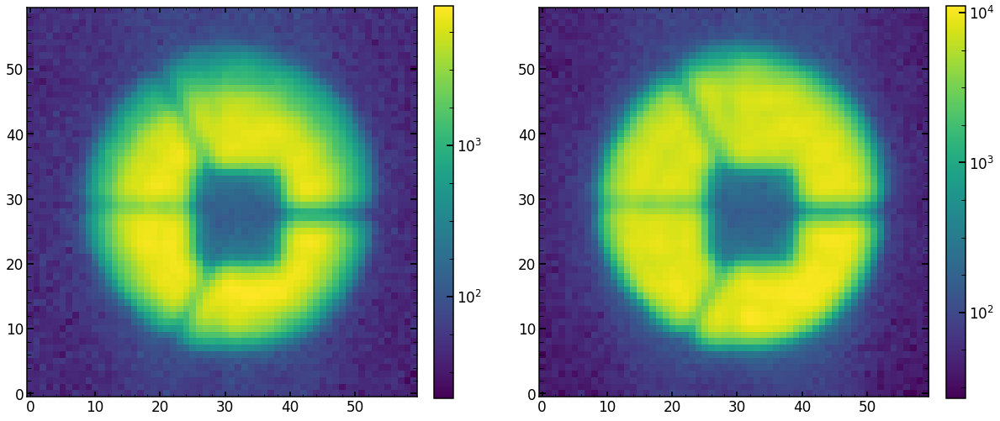

In [1029]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.imshow(sci_data_old_cutout,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


plt.subplot(122)
plt.imshow(sci_data_new_cutout,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

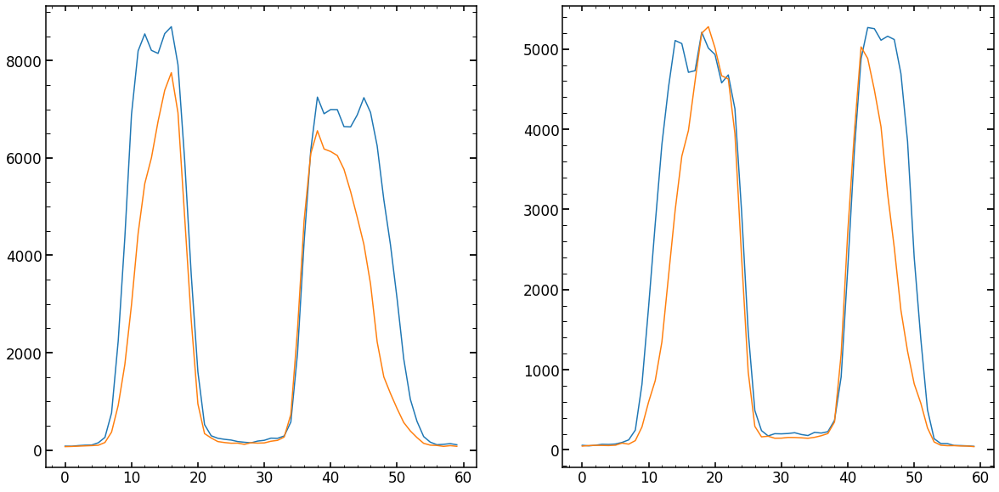

In [1160]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.plot(sci_data_new_cutout[:,30])
plt.plot(sci_data_old_cutout[:,30])

plt.subplot(122)
plt.plot(sci_data_new_cutout[30])
plt.plot(sci_data_old_cutout[30])

In [1031]:
np.save('/Users/nevencaplar/Documents/PFS/ReducedData/MAY1/Testing/sci_data_new_cutout',sci_data_new_cutout)
np.save('/Users/nevencaplar/Documents/PFS/ReducedData/MAY1/Testing/var_data_new_cutout',var_data_new_cutout)

In [1032]:
columns22

['z4',
 'z5',
 'z6',
 'z7',
 'z8',
 'z9',
 'z10',
 'z11',
 'z12',
 'z13',
 'z14',
 'z15',
 'z16',
 'z17',
 'z18',
 'z19',
 'z20',
 'z21',
 'z22',
 'hscFrac',
 'strutFrac',
 'dxFocal',
 'dyFocal',
 'slitFrac',
 'slitFrac_dy',
 'radiometricEffect',
 'radiometricExponent',
 'x_ilum',
 'y_ilum',
 'x_fiber',
 'y_fiber',
 'effective_radius_illumination',
 'frd_sigma',
 'frd_lorentz_factor',
 'det_vert',
 'slitHolder_frac_dx',
 'grating_lines',
 'scattering_slope',
 'scattering_amplitude',
 'pixel_effect',
 'fiber_r',
 'flux']

In [1033]:
all_data_old_full_focus=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonFeb_2019/rerun/Apr30_2019/detrend/calExp/2019-02-16/v0012356/calExp-LA012356r1.fits')
all_data_new_full_focus=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/detrend/calExp/2019-04-17/v0016294/calExp-LA016294r1.fits')

In [1034]:
print(all_data_old_full_focus[0].header['W_ENFCAX'])
print(all_data_new_full_focus[0].header['W_ENFCAX'])
assert (np.abs(all_data_old_full_focus[0].header['W_ENFCAX']-all_data_new_full_focus[0].header['W_ENFCAX'])<0.05)

-0.0
-0.0


In [1035]:
sci_data_old_full_focus=all_data_old_full_focus[1].data
sci_data_new_full_focus=all_data_new_full_focus[1].data

var_data_old_full_focus=all_data_old_full_focus[3].data
var_data_new_full_focus=all_data_new_full_focus[3].data

In [1036]:
sci_data_old_cutout_focus=sci_data_old_full_focus[1076-10+3:1076+10+3,2443-10+7-2:2443+10+7-2]
sci_data_new_cutout_focus=sci_data_new_full_focus[1076-10:1076+10,2443-10-2:2443+10-2]

var_data_old_cutout_focus=var_data_old_full_focus[1076-10+3:1076+10+3,2443-10+7:2443+10+7]
var_data_new_cutout_focus=var_data_new_full_focus[1076-10:1076+10,2443-10:2443+10]

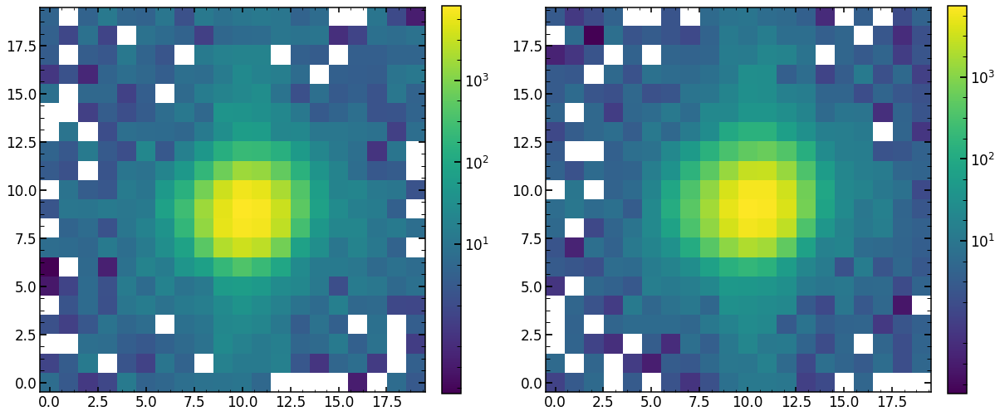

In [1144]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.imshow(sci_data_old_cutout_focus,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


plt.subplot(122)
plt.imshow(sci_data_new_cutout_focus*np.sum(sci_data_old_cutout_focus)/np.sum(sci_data_new_cutout_focus),origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [1145]:
sci_data_new_cutout_focus_renormalized=sci_data_new_cutout_focus*np.sum(sci_data_old_cutout_focus)/np.sum(sci_data_new_cutout_focus)

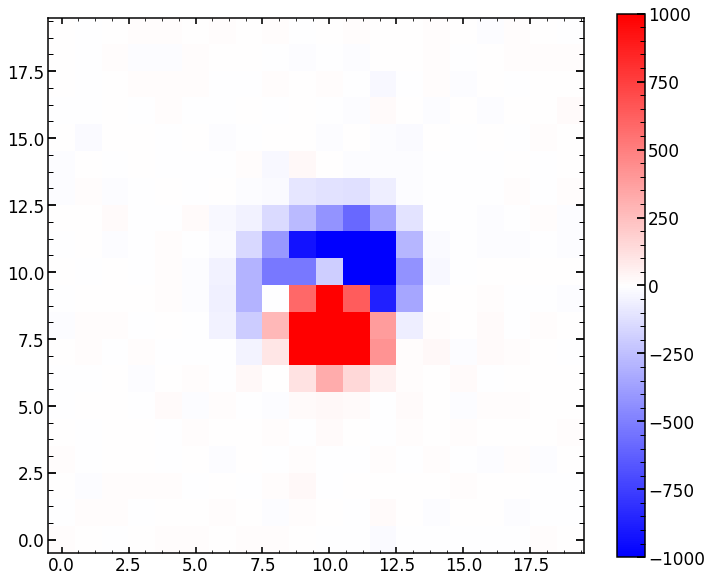

In [1038]:
plt.imshow(sci_data_old_cutout_focus*np.sum(sci_data_new_cutout_focus)/np.sum(sci_data_old_cutout_focus)-sci_data_new_cutout_focus,vmax=1000,vmin=-1000,cmap='bwr')
plt.colorbar()

In [1039]:
print(find_centroid_of_flux(sci_data_old_cutout_focus))
print(find_centroid_of_flux(sci_data_new_cutout_focus))

(10.222454216524927, 8.831648119411886)
(10.287725463486185, 9.199931971779678)


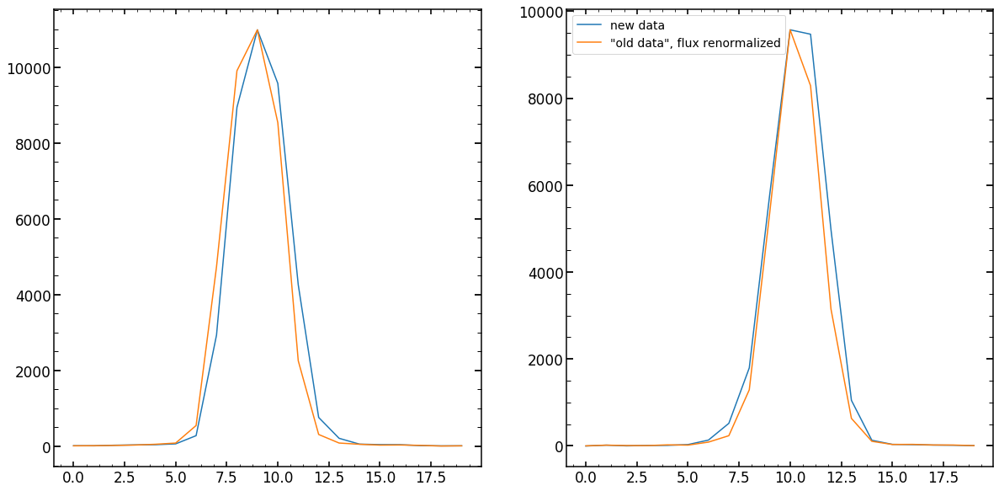

In [1040]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.plot(sci_data_new_cutout_focus[:,10],label='new data')
plt.plot(sci_data_old_cutout_focus[:,10]*(np.max(sci_data_new_cutout_focus[:,10])/np.max(sci_data_old_cutout_focus[:,10])),label='"old data", flux renormalized')

plt.subplot(122)
plt.plot(sci_data_new_cutout_focus[10],label='new data')
plt.plot(sci_data_old_cutout_focus[10]*(np.max(sci_data_new_cutout_focus[10])/np.max(sci_data_old_cutout_focus[10])),label='"old data", flux renormalized')

plt.legend()

### Fitting single cutout

In [1047]:
model_old = LN_PFS_single(sci_data_old_cutout,var_data_old_cutout,dithering=1,save=1,zmax=22)       
model_old(minchain_12403_96)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_old_michain_to_old_data=optPsf_cut_fiber_convolved_downsampled

model_new = LN_PFS_single(sci_data_new_cutout,var_data_new_cutout,dithering=1,save=1,zmax=22)       
model_new(minchain_12403_96)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_old_michain_to_new_data=optPsf_cut_fiber_convolved_downsampled


extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42


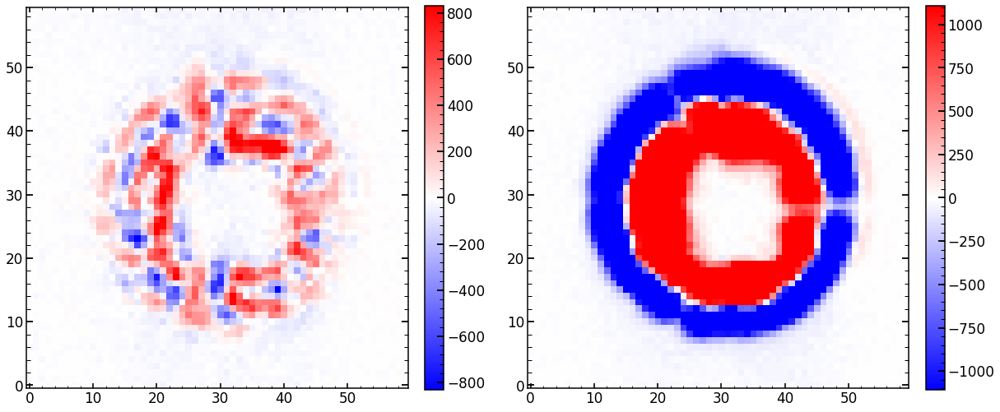

In [1055]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.imshow(res_iapetus_old_michain_to_old_data-sci_data_old_cutout+35,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_data_old_cutout))/10,vmax=np.max(np.abs(sci_data_old_cutout))/10)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)
plt.imshow(res_iapetus_old_michain_to_new_data-sci_data_new_cutout+35,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_data_new_cutout))/10,vmax=np.max(np.abs(sci_data_new_cutout))/10)
plt.colorbar(fraction=0.046, pad=0.04)

In [1049]:
minchain_16249_96=np.array([   29.48668207,     0.00326164  ,  -0.9600661,      0.6740385,
     0.22146978,    -0.06480767,    -0.38518289,    -0.26697268,
     0.05217206 ,   -0.00691053 ,   -0.03710959 ,   -0.02492236,
    -0.03292478  ,   0.03407291  ,   0.04033863  ,   0.00241916,
    -0.01044722   ,  0.03418758   ,  0.10594647   ,  0.68919922,
     0.08324638,    -0.04817597,    -0.07481081    , 0.06124287,
     0.02100885 ,    0.00001728 ,    0.00001728,     0.9734256,
     0.94833397  ,  -0.1475817   ,  -0.03451894 ,    0.91350706,
     0.0138321    ,  0.56203485   ,  1.03304884  ,   0.15104478,
 46589.83724444    , 2.39138636    , 0.01164293   ,  0.60087405,
     1.78332658     ,0.98907768])

In [1050]:
minchain_16249_96

array([   29.48668207,     0.00326164,    -0.9600661 ,     0.6740385 ,
           0.22146978,    -0.06480767,    -0.38518289,    -0.26697268,
           0.05217206,    -0.00691053,    -0.03710959,    -0.02492236,
          -0.03292478,     0.03407291,     0.04033863,     0.00241916,
          -0.01044722,     0.03418758,     0.10594647,     0.68919922,
           0.08324638,    -0.04817597,    -0.07481081,     0.06124287,
           0.02100885,     0.00001728,     0.00001728,     0.9734256 ,
           0.94833397,    -0.1475817 ,    -0.03451894,     0.91350706,
           0.0138321 ,     0.56203485,     1.03304884,     0.15104478,
       46589.83724444,     2.39138636,     0.01164293,     0.60087405,
           1.78332658,     0.98907768])

In [1051]:
model_new = LN_PFS_single(sci_data_new_cutout,var_data_new_cutout,dithering=1,save=1,zmax=22)       
model_new(minchain_16249_96)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_new_michain_to_new_data=optPsf_cut_fiber_convolved_downsampled

extraZernike: None
zmax: 22
42


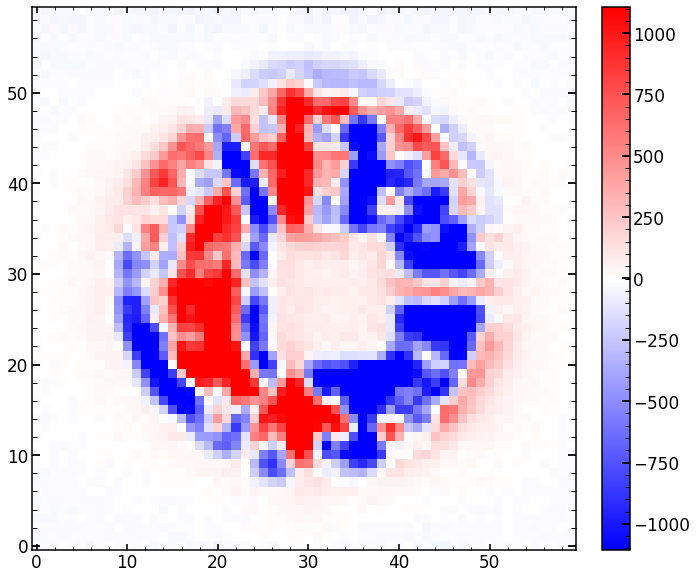

In [1056]:
plt.imshow(res_iapetus_new_michain_to_new_data-sci_data_new_cutout,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_data_new_cutout))/10,vmax=np.max(np.abs(sci_data_new_cutout))/10)
plt.colorbar(fraction=0.046, pad=0.04)

In [1061]:
minchain_focus_96

array([   -0.74354796,    -0.42430045,    -0.63813864,     0.40265451,
          -0.13675253,    -0.0570049 ,    -0.20369127,    -0.43849012,
          -0.00213067,     0.02190102,     0.03424354,     0.00495228,
          -0.01218971,     0.01382538,     0.01350665,    -0.0083995 ,
          -0.02168872,     0.01285907,    -0.01991925,     0.68390882,
           0.07999443,     0.0299721 ,    -0.06555912,     0.06053127,
           0.00185584,     0.00000538,     0.00000536,     0.97250399,
           0.94834376,    -0.03325084,    -0.04090767,     0.81963335,
           0.0863966 ,     0.99961223,     1.02097138,    -0.1309579 ,
       55867.04440362,     2.3902808 ,     0.00247407,     0.3855805 ,
           1.78000129,     0.99735123])

In [1062]:
minchain_focus_96

minchain_16294_96_prediction=np.copy(minchain_focus_96)
minchain_16294_96_prediction[29:34]=minchain_16249_96[29:34]
minchain_16294_96_prediction

array([   -0.74354796,    -0.42430045,    -0.63813864,     0.40265451,
          -0.13675253,    -0.0570049 ,    -0.20369127,    -0.43849012,
          -0.00213067,     0.02190102,     0.03424354,     0.00495228,
          -0.01218971,     0.01382538,     0.01350665,    -0.0083995 ,
          -0.02168872,     0.01285907,    -0.01991925,     0.68390882,
           0.07999443,     0.0299721 ,    -0.06555912,     0.06053127,
           0.00185584,     0.00000538,     0.00000536,     0.97250399,
           0.94834376,    -0.1475817 ,    -0.03451894,     0.91350706,
           0.0138321 ,     0.56203485,     1.02097138,    -0.1309579 ,
       55867.04440362,     2.3902808 ,     0.00247407,     0.3855805 ,
           1.78000129,     0.99735123])

In [1110]:
model_old = LN_PFS_single(sci_data_old_cutout_focus,var_data_old_cutout_focus,dithering=1,save=1,zmax=22)       
model_old(minchain_focus_96)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_old_michain_to_old_data=optPsf_cut_fiber_convolved_downsampled

model_old = LN_PFS_single(sci_data_old_cutout_focus,var_data_old_cutout_focus,dithering=1,save=1,zmax=22) 
model_old(minchain_16294_96_prediction)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_predicted_michain_to_old_data=optPsf_cut_fiber_convolved_downsampled

model_new = LN_PFS_single(sci_data_new_cutout_focus,var_data_new_cutout_focus,dithering=1,save=1,zmax=22)       
model_new(minchain_16294_96_prediction)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_predicted_michain_to_new_data=optPsf_cut_fiber_convolved_downsampled

extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42
extraZernike: None
zmax: 22
42


In [1111]:
np.sum(res_iapetus_old_michain_to_old_data)

89473.00980791848

In [1112]:
np.sum(res_iapetus_predicted_michain_to_old_data)

89473.00980791848

In [1113]:
minchain_focus_96-minchain_16294_96_prediction

array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.11433086,
       -0.00638873, -0.09387371,  0.0725645 ,  0.43757738,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ])

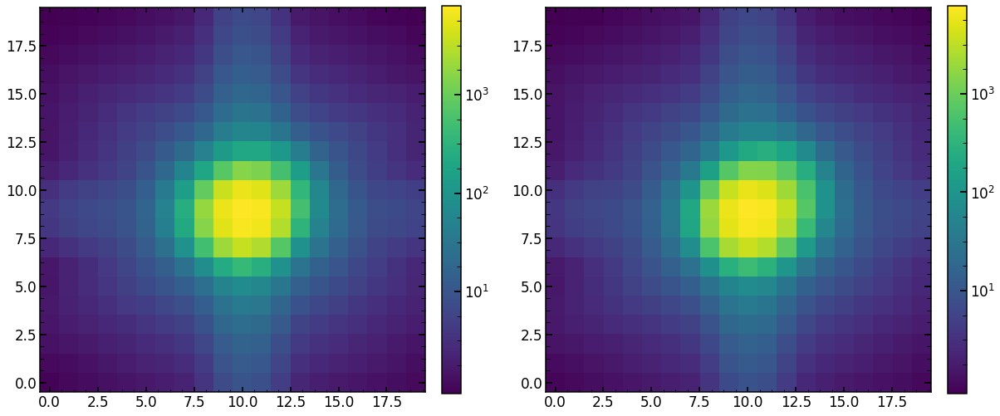

In [1114]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.imshow(res_iapetus_old_michain_to_old_data,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


plt.subplot(122)
plt.imshow(res_iapetus_predicted_michain_to_old_data,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

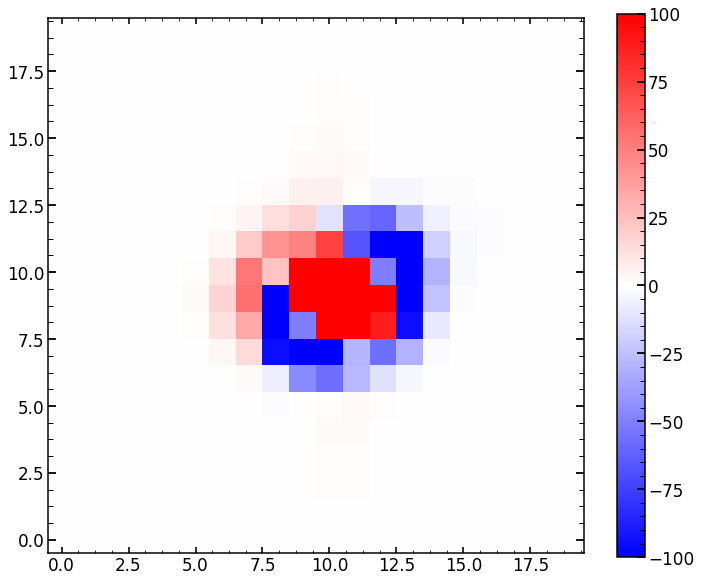

In [1115]:
plt.imshow(res_iapetus_old_michain_to_old_data-res_iapetus_predicted_michain_to_old_data,cmap='bwr',vmin=-100,vmax=100)
plt.colorbar()

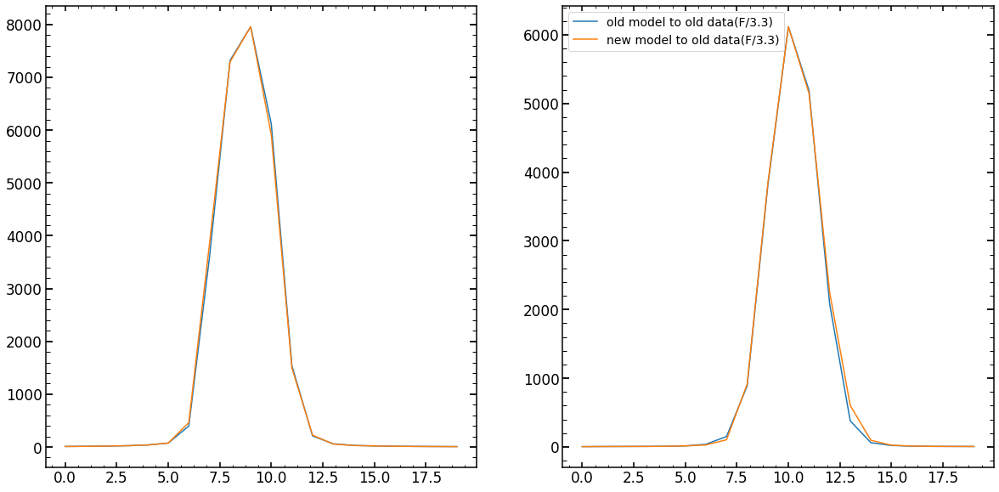

In [1116]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.plot(res_iapetus_old_michain_to_old_data[:,10],label='old model to old data(F/3.3)')
plt.plot(res_iapetus_predicted_michain_to_old_data[:,10]*(np.max(res_iapetus_old_michain_to_old_data[:,10])/np.max(res_iapetus_predicted_michain_to_old_data[:,10])),label='new model to old data(F/3.3)')

plt.subplot(122)
plt.plot(res_iapetus_old_michain_to_old_data[10],label='old model to old data(F/3.3)')
plt.plot(res_iapetus_predicted_michain_to_old_data[10]*(np.max(res_iapetus_old_michain_to_old_data[10])/np.max(res_iapetus_predicted_michain_to_old_data[10])),label='new model to old data(F/3.3)')

plt.legend()

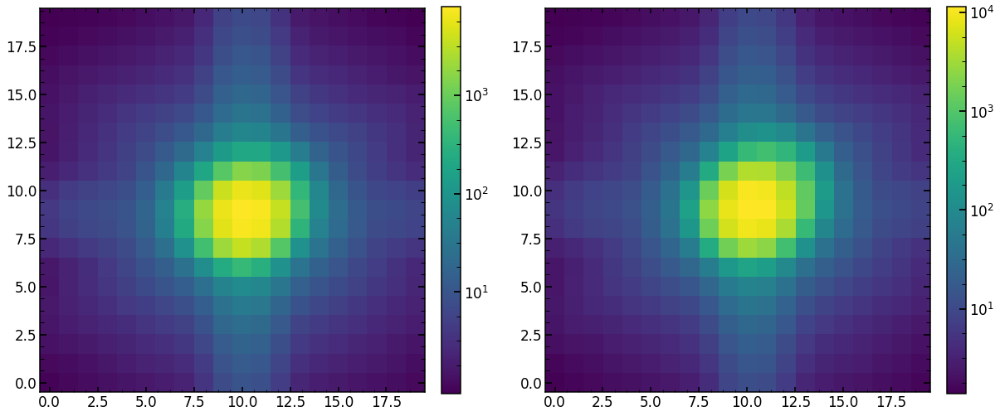

In [1117]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.imshow(res_iapetus_old_michain_to_old_data,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


plt.subplot(122)
plt.imshow(res_iapetus_predicted_michain_to_new_data,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

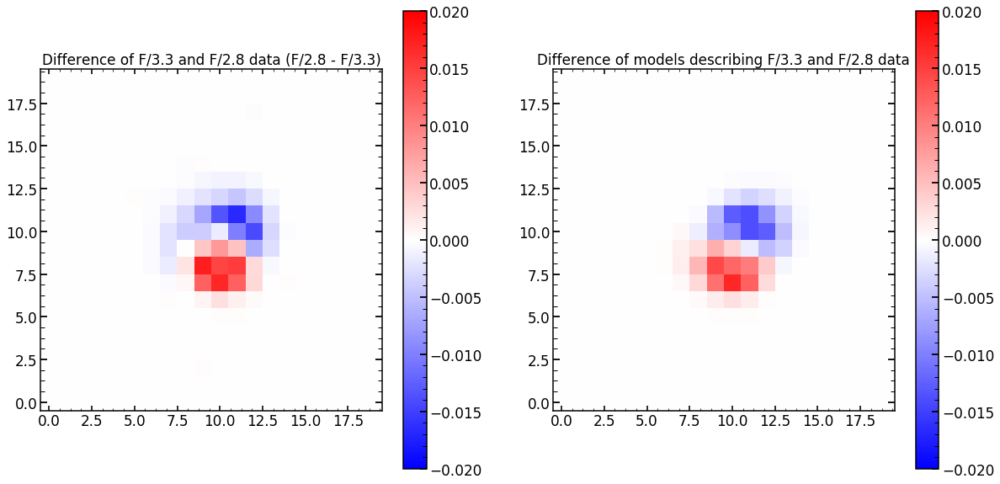

In [1143]:
plt.figure(figsize=(20,10))

plt.subplot(121)
plt.title('Difference of F/3.3 and F/2.8 data (F/2.8 - F/3.3)')
plt.imshow(sci_data_old_cutout_focus/np.sum(sci_data_old_cutout_focus)-sci_data_new_cutout_focus/np.sum(sci_data_new_cutout_focus),origin='lower',cmap='bwr',vmin=-0.02,vmax=0.02)
plt.colorbar()


plt.subplot(122)
plt.title('Difference of models describing F/3.3 and F/2.8 data')
plt.imshow(res_iapetus_old_michain_to_old_data/np.sum(res_iapetus_old_michain_to_old_data)-
           res_iapetus_predicted_michain_to_new_data/np.sum(res_iapetus_predicted_michain_to_new_data),origin='lower',cmap='bwr',vmin=-0.02,vmax=0.02)
plt.colorbar()

In [1129]:
find_centroid_of_flux(sci_data_old_cutout_focus)

(10.222454216524927, 8.831648119411886)

In [1130]:
find_centroid_of_flux(sci_data_new_cutout_focus)

(10.287725463486185, 9.199931971779678)

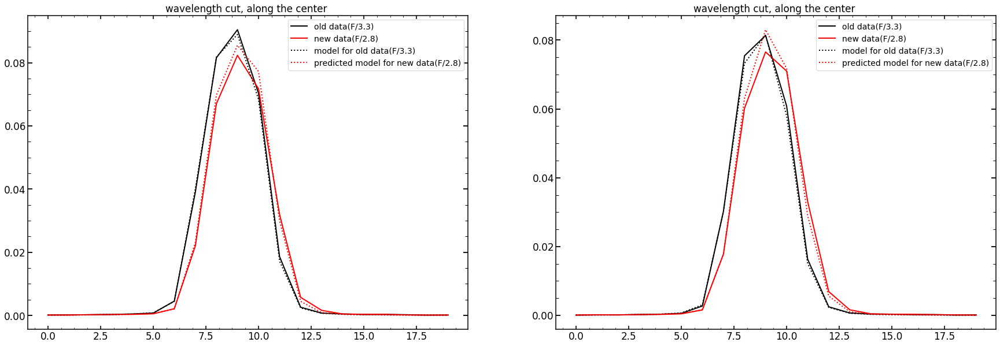

In [1159]:
plt.figure(figsize=(30,10))

plt.subplot(121)
plt.title('wavelength cut, along the center ')
plt.plot(sci_data_old_cutout_focus[:,10]/np.sum(sci_data_old_cutout_focus),label='old data(F/3.3)',color='black',lw=2)
plt.plot(sci_data_new_cutout_focus[:,10]/np.sum(sci_data_new_cutout_focus),label='new data(F/2.8)',color='red',lw=2)
plt.plot(res_iapetus_old_michain_to_old_data[:,10]/np.sum(res_iapetus_old_michain_to_old_data),label='model for old data(F/3.3)',color='black',lw=2,ls=':')
plt.plot(res_iapetus_predicted_michain_to_new_data[:,10]/np.sum(res_iapetus_predicted_michain_to_new_data),label='predicted model for new data(F/2.8)',color='red',lw=2,ls=':')
plt.legend()

plt.subplot(122)
plt.title('wavelength cut, along the center ')
plt.plot(sci_data_old_cutout_focus[:,11]/np.sum(sci_data_old_cutout_focus),label='old data(F/3.3)',color='black',lw=2)
plt.plot(sci_data_new_cutout_focus[:,11]/np.sum(sci_data_new_cutout_focus),label='new data(F/2.8)',color='red',lw=2)
plt.plot(res_iapetus_old_michain_to_old_data[:,11]/np.sum(res_iapetus_old_michain_to_old_data),label='model for old data(F/3.3)',color='black',lw=2,ls=':')
plt.plot(res_iapetus_predicted_michain_to_new_data[:,11]/np.sum(res_iapetus_predicted_michain_to_new_data),label='predicted model for new data(F/2.8)',color='red',lw=2,ls=':')
plt.legend()

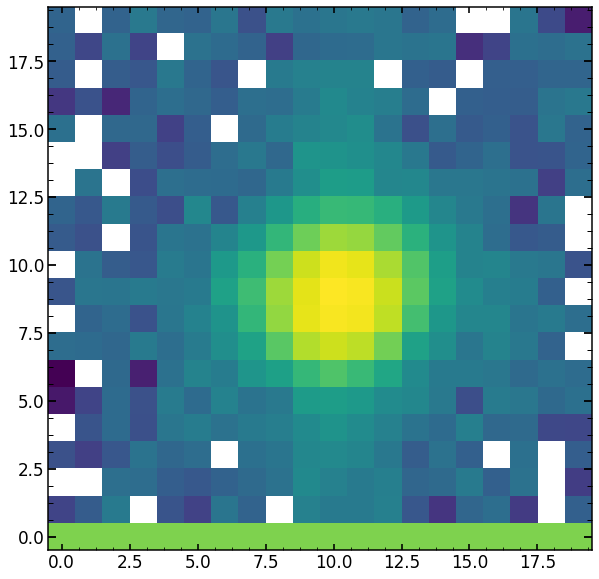

In [1136]:

sci_data_old_cutout_focus_test=np.copy(sci_data_old_cutout_focus)
sci_data_old_cutout_focus_test[0]=1000
plt.imshow(sci_data_old_cutout_focus_test,origin='lower',norm=LogNorm())


# Plot or two for May LAM talk

In [1163]:
DATA_FOLDER='/Users/nevencaplar/Documents/PFS/ReducedData/2017-12-15-Rerun/Stamps_cleaned/'

In [1164]:
obs='8576'
single_number='55'
sci_image_8576 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8576 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8579'
sci_image_8579 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8579 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8582'
sci_image_8582 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8582 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8585'
sci_image_8585 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8585 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8588'
sci_image_8588 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8588 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')


obs='8591'
sci_image_8591 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8591 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8594'
sci_image_8594 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8594 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8597'
sci_image_8597 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8597 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8600'
sci_image_8600 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8600 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

obs='8603'
sci_image_8603 =np.load(DATA_FOLDER+'sci'+str(obs)+str(single_number)+'StackedLarge.npy')
var_image_8603 =np.load(DATA_FOLDER+'var'+str(obs)+str(single_number)+'StackedLarge.npy')

In [1165]:
sci_image_55_pp_large=np.zeros((220,220))
sci_image_55_pp_large[::2,1::2] = sci_image_8588
sci_image_55_pp_large[1::2,::2] = sci_image_8600
sci_image_55_pp_large[::2,::2] = sci_image_8591
sci_image_55_pp_large[1::2,1::2] = sci_image_8597

var_image_55_pp_large=np.zeros((220,220))
var_image_55_pp_large[::2,1::2] = var_image_8588
var_image_55_pp_large[1::2,::2] = var_image_8600
var_image_55_pp_large[::2,::2] = var_image_8591
var_image_55_pp_large[1::2,1::2] = var_image_8597

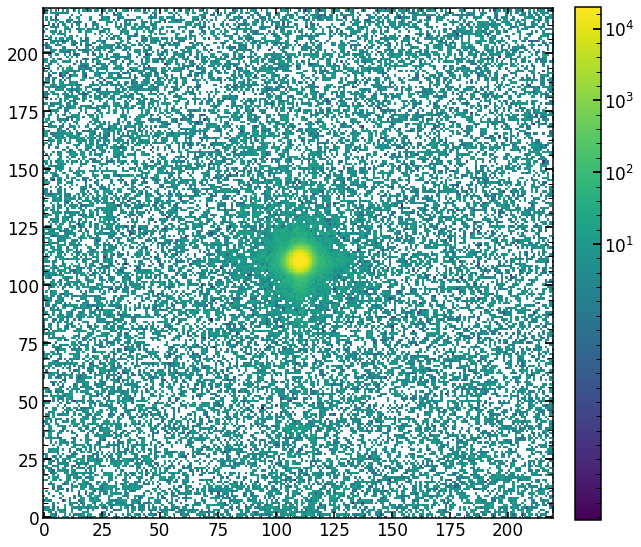

In [1180]:
plt.figure(figsize=(10,10))
plt.imshow(sci_image_55_pp_large,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [1174]:
points = np.linspace(-1650/2,1650/2,num=220)
xs, ys = np.meshgrid(points, points)
r0 = np.sqrt((xs-0)** 2 + (ys-0)** 2)

distances_large=range(300)


res_data_large=[]
for r in distances_large:
    res_data_large.append((np.sum(sci_image_55_pp_large[r0<(r+7.5)])-np.sum(sci_image_55_pp_large[r0<(r)]))/(len(sci_image_55_pp_large[r0<(r+7.5)])-len(sci_image_55_pp_large[r0<(r)])))

Text(0.5,0,'distance from center in micrometers')

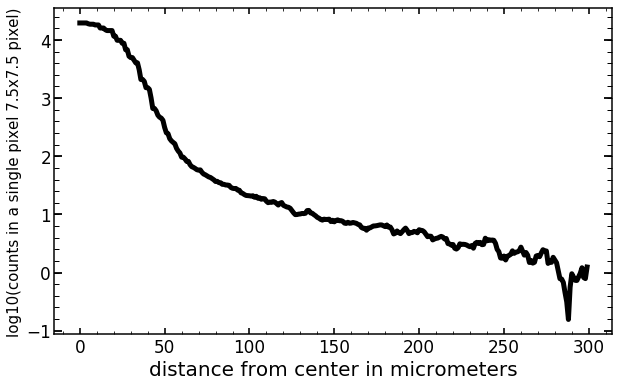

In [1186]:
plt.figure(figsize=(10,6))
plt.plot(distances_large,np.log10(res_data_large),color='black',label='real data',lw=5)
plt.ylabel('log10(counts in a single pixel 7.5x7.5 pixel)',fontsize=15)
plt.xlabel('distance from center in micrometers',fontsize=20)

In [7]:
def func(x, a, b, c,d):
    return a+b*(x/100)+c*(x/100)**2+d*(x/100)**3

# Input/output times

In [14]:
p2

poly1d([ 2.67750812, -0.22915717,  1.        ])

In [132]:
import numpy as np
from scipy.optimize import fmin

def func_att_diff(x,x_target):
    a=1
    b=-0.337
    c=-0.159
    d=0.054
    return np.abs(a+b*(x/100)+c*(x/100)**2+d*(x/100)**3-x_target)

def func_att(x):
    a=1
    b=-0.337
    c=-0.159
    d=0.054
    return a+b*(x/100)+c*(x/100)**2+d*(x/100)**3

list_of_defocus_exposure_times=np.array([-4.5, -4. , -3.5, -3. , -2.5, -2. , -1.5, -1. , -0.5,  0. ,  0.5,
        1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5])
p2=np.poly1d([ 2.67750812, -0.22915717,  1.        ])


# objective function
lamda_f = lambda x: func_att_diff(x,x_target)
x0 = 0 # start search from x = 0
value_att = fmin(lamda_f,x0)



def defocused_exposure_times(exp_time_0,att_value_0):
    defocused_exposure_times=[]
    att_values=[]
    
    if att_value_0==0:
        effective_exp_time_0=exp_time_0
    else:
        effective_exp_time_0=exp_time_0*(func_att(att_value_0))
    
    
    for i in list_of_defocus_exposure_times:
        time_without_att=p2(i)*effective_exp_time_0
        if time_without_att <15:
            how_much_too_bright=15/time_without_att
            
            lamda_f = lambda x: func_att_diff(x,1/how_much_too_bright)
            
            value_att = fmin(lamda_f,0)
            time_without_att=15
            att_values.append(value_att[0])
        else:
            att_values.append(0)
        defocused_exposure_times.append(time_without_att)
        
        
        
    return(np.round(defocused_exposure_times).astype(int),np.round(att_values).astype(int))


def defocused_exposure_times_single_position(exp_time_0,att_value_0,defocused_value):
    defocused_exposure_times=[]
    att_values=[]
    
    if att_value_0==0:
        effective_exp_time_0=exp_time_0
    else:
        effective_exp_time_0=exp_time_0*(func_att(att_value_0))
    
    
    i=defocused_value
    time_without_att=p2(i)*effective_exp_time_0
    print(time_without_att)
    
    if time_without_att <15:
        how_much_too_bright=15/time_without_att

        lamda_f = lambda x: func_att_diff(x,1/how_much_too_bright)

        value_att = fmin(lamda_f,0)
        time_without_att=15
        att_values.append(value_att[0])
    else:
        att_values.append(0)
    defocused_exposure_times.append(time_without_att)
    return(np.round(defocused_exposure_times[0]).astype(int),np.round(att_values[0]).astype(int))


#example
test=defocused_exposure_times(5,200)
defocused_exposure_times_single_position(15,200,-10)

Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 36
         Function evaluations: 72


In [114]:
func_att(200)

0.12199999999999994

In [148]:
test=defocused_exposure_times(5,200)
defocused_exposure_times_single_position(15,190,-4.5)

Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 37
         Function evaluations: 74
Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 38
         Function evaluations: 76
Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 39
         Function evaluations: 78
Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 40
         Function evaluations: 80
Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 40
         Function evaluations: 80
Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 42
         Function evaluations: 85
Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 42
         Function evaluations: 84
Optimization terminated successful

(132, 0)

In [130]:
np.round(test[0]).astype(int)

array([34, 27, 21, 16, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 20,
       26, 33])

In [93]:
from scipy.optimize import least_squares
>>> x0_rosenbrock = np.array([0.4])
>>> res_1 = least_squares(func_att, x0_rosenbrock)

In [88]:


def func_att(x):
    a=1
    b=-0.337
    c=-0.159
    d=0.054
    return a+b*(x/100)+c*(x/100)**2+d*(x/100)**3

func_att(50)

0.7985000000000001

In [77]:
from scipy.optimize import fmin
x_target=0.8
# objective function
rsinc = lambda x: func_att_diff(x,x_target)
x0 = 0 # start from x = -5
xmin0 = fmin(rsinc,x0)
xmin0

Optimization terminated successfully.
         Current function value: 0.000000
         Iterations: 36
         Function evaluations: 72


array([49.6705])

In [64]:
func_att_diff(0.2)

NameError: name 'x' is not defined

In [145]:
finalHgAr_Feb2019[finalHgAr_Feb2019['superold_index_approx']=='55.0']

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
102,8,2133,1955,795.0522,1,HgAr,2202,66,55.0
114,9,2249,1956,795.0522,1,HgAr,2318,66,55.0


In [146]:
finalHgAr_Feb2019[finalHgAr_Feb2019['superold_index_approx']=='35.0']

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
104,8,2131,2621,852.4029,0.5,HgAr,2200,68,35.0
116,9,2247,2622,852.4029,0.5,HgAr,2316,68,35.0
